In [23]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperature
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperature
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperature
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    #print("Agg:")
    agg.columns = names
    #print(type(agg))
    #print(agg)

    #print("Test columns:")
    #print(agg.iloc[:, -36]) # Column containing response actual values (temperature) at time t

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    print(n_vars)
    print(len(data))
    print(type(data))

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    #print("Diff values:")
    #print(len(diff_values))
    #print(len(diff_values[0]))
    #print(len(diff_values_for_training))
    #print(len(diff_values_for_training[0]))
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    #print("Scaled values rows:")
    #print(len(scaled_values))

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        #print("Batch "+str(ws+1)+":")
        #print("Range: "+str(first)+"-"+str(last))
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
        #print("Supervised count:")
        #print(len(supervised_values))
        #print(len(supervised_values[0]))
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    print(n_vars)
    print(len(data))
    print(type(data))

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    #print("Diff values:")
    #print(len(diff_values))
    #print(len(diff_values[0]))
    #print(len(diff_values_for_training))
    #print(len(diff_values_for_training[0]))
    
    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        #print("Batch "+str(ws+1)+":")
        #print("Range: "+str(first)+"-"+str(last))
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
        #print("Supervised count:")
        #print(len(supervised_values))
        #print(len(supervised_values[0]))
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 47
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1
    
# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['temperatures'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
    #print("Train_X Fold "+str(i)+":")
    #print(len(train_X[i]))
    #print(len(train_X[i][0]))
    #print(len(train_X[i][0][0])) 
    #print("Train_y Fold "+str(i)+":")
    #print(len(train_y[i]))
    #print(len(train_y[i][0]))
    #print(train_y[i][0][0])
    #print("Validation_X Fold "+str(i)+":")
    #print(len(val_X[i]))
    #print(len(val_X[i][0]))
    #print(len(val_X[i][0][0]))
    #print("Validation_y Fold "+str(i)+":")
    #print(len(val_y[i]))
    #print(len(val_y[i][0]))
    #print(val_y[i][0][0])
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_scaling = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)
    dataset_scaling = list(itertools.chain(*dataset)) # Holds all 84 weather station rows to train the scaling function

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(vl_X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)    
    dataset_testing = list(itertools.chain(*dataset_test)) # Holds remaining 21 weather station rows for testing and validation

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + 12*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]


C:\Users\User
C:\Users\User\Modeling\
Fold 1
Fold 2
Fold 3
Fold 4
Fold 5
Fold 1:
12
84
<class 'list'>
12
21
<class 'list'>
(84, 1, 1, 2183)
(11, 1, 1, 2183)
(10, 1, 1, 2183)
(84, 1, 2183)
(11, 1, 2183)
(10, 1, 2183)
(84, 2183)
(11, 2183)
(10, 2183)
[[0.39307412 0.69695044 0.32924264 ... 0.45808019 0.42952612 0.37788578]
 [0.45747266 0.51683609 0.42215989 ... 0.49422843 0.47691373 0.38882139]
 [0.38487242 0.62674714 0.3411641  ... 0.51032807 0.38244228 0.37363305]
 ...
 [0.54100851 0.46473952 0.46949509 ... 0.48025516 0.45504253 0.40583232]
 [0.44896719 0.51620076 0.3997195  ... 0.49696233 0.45170109 0.39611179]
 [0.46780073 0.52414231 0.42356241 ... 0.49301337 0.4881531  0.43772783]]
Fold 2:
12
168
<class 'list'>
12
42
<class 'list'>
(84, 1, 1, 2183)
(11, 1, 1, 2183)
(10, 1, 1, 2183)
(84, 1, 2183)
(11, 1, 2183)
(10, 1, 2183)
(84, 2183)
(11, 2183)
(10, 2183)
[[0.39307412 0.69695044 0.32924264 ... 0.45808019 0.42952612 0.37788578]
 [0.45747266 0.51683609 0.42215989 ... 0.49422843 0.47691

In [24]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

47
178
(84, 2183)
(11, 2183)


[I 2025-05-06 12:51:16,492] A new study created in memory with name: no-name-08f2dd07-976f-4af4-87c5-636f914ee09b


84
84
1


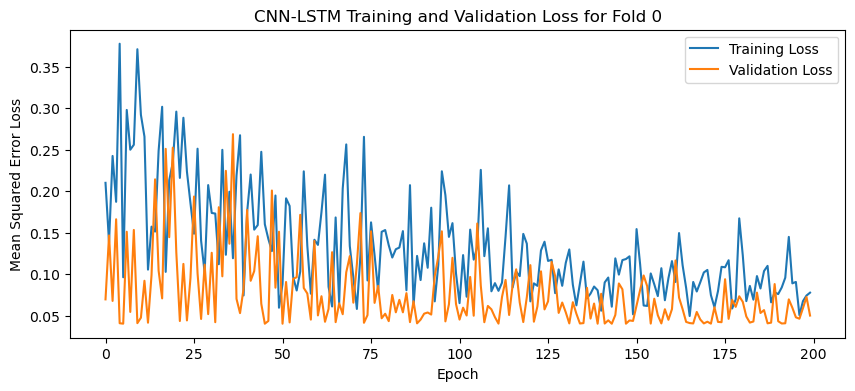

84
84
1


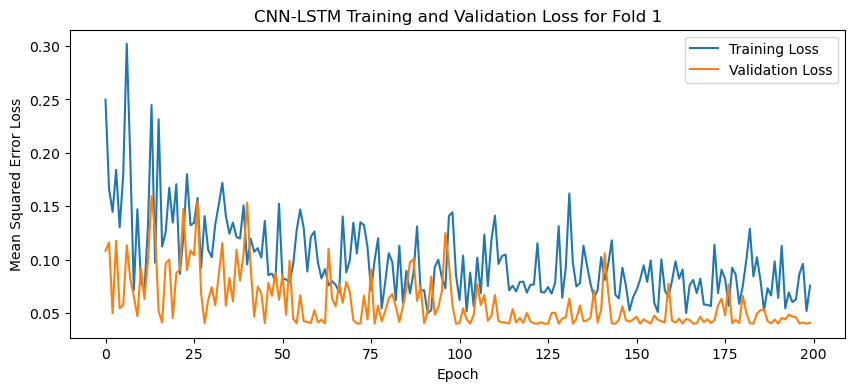

84
84
1


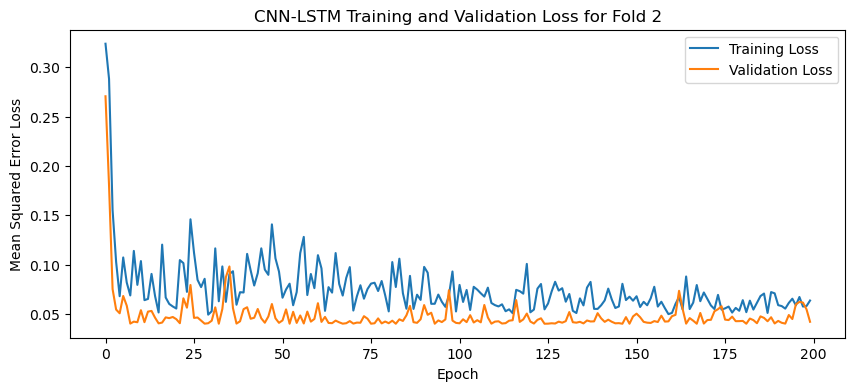

84
84
1


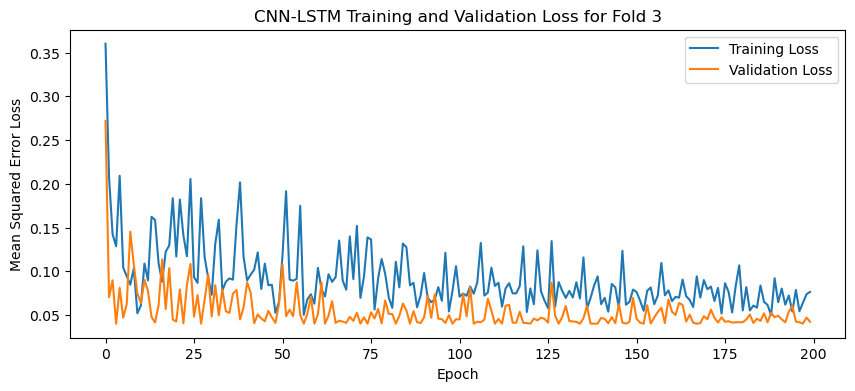

84
84
1


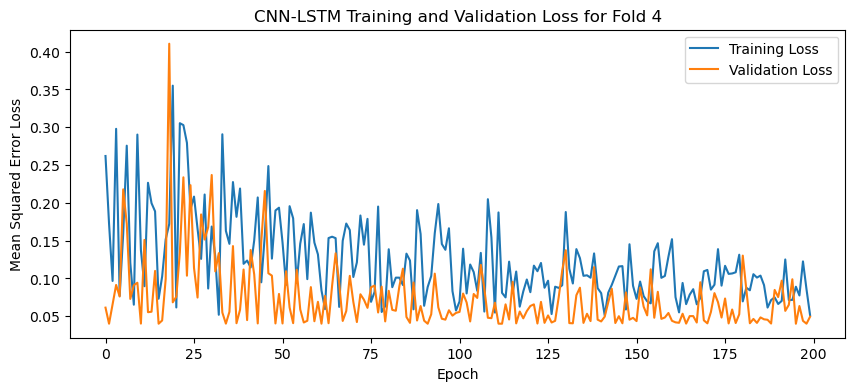

[I 2025-05-06 12:53:01,101] Trial 0 finished with value: 0.044927094131708145 and parameters: {'lr': 0.005746637783274995, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.4649989056135345}. Best is trial 0 with value: 0.044927094131708145.


84
84
1


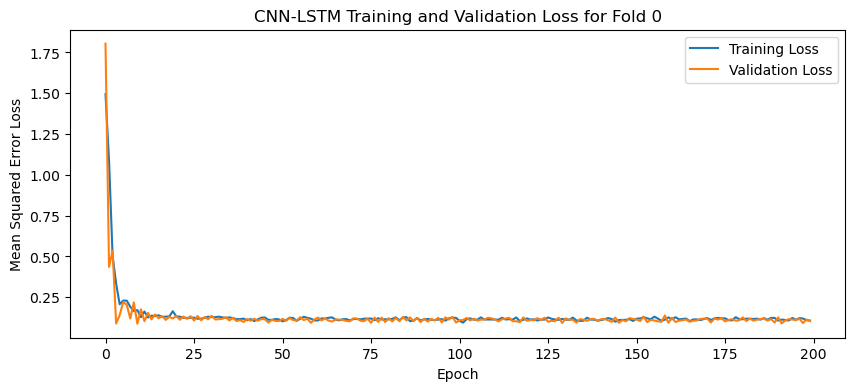

84
84
1


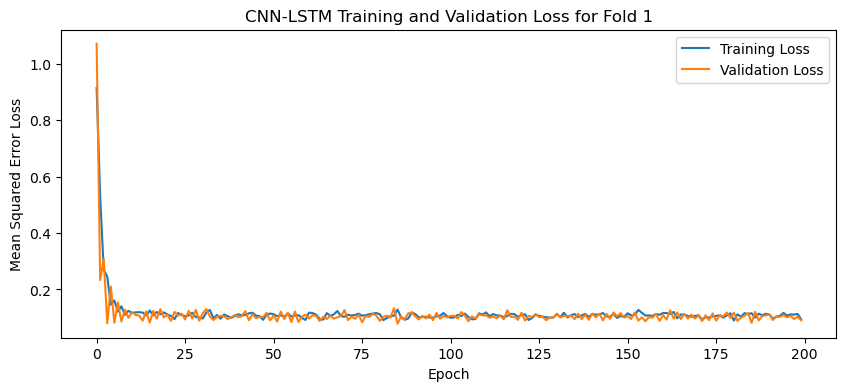

84
84
1


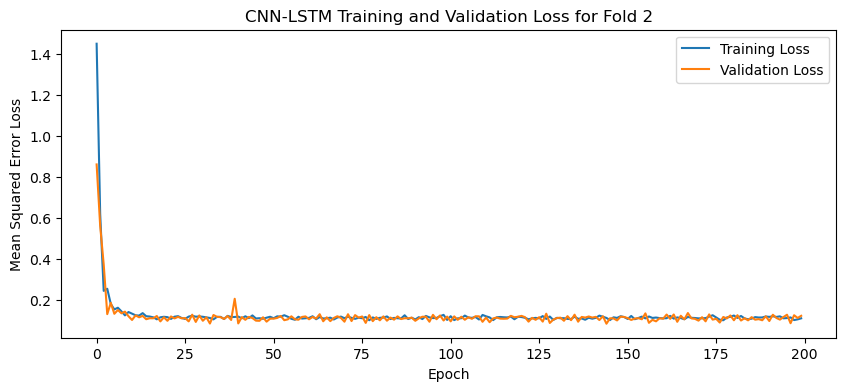

84
84
1


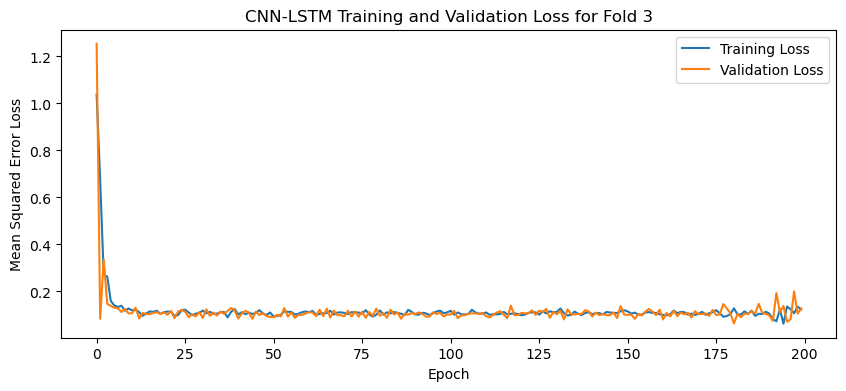

84
84
1


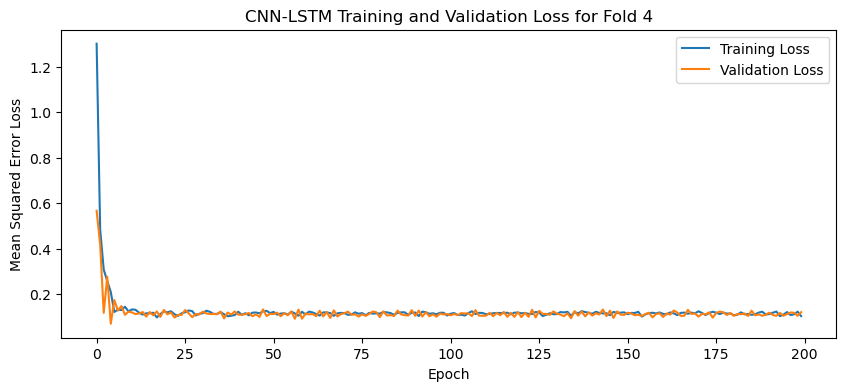

[I 2025-05-06 12:54:45,638] Trial 1 finished with value: 0.11362086087465287 and parameters: {'lr': 0.025144706642146974, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 128, 'dropout_rate': 0.377501378845866}. Best is trial 0 with value: 0.044927094131708145.


84
84
1


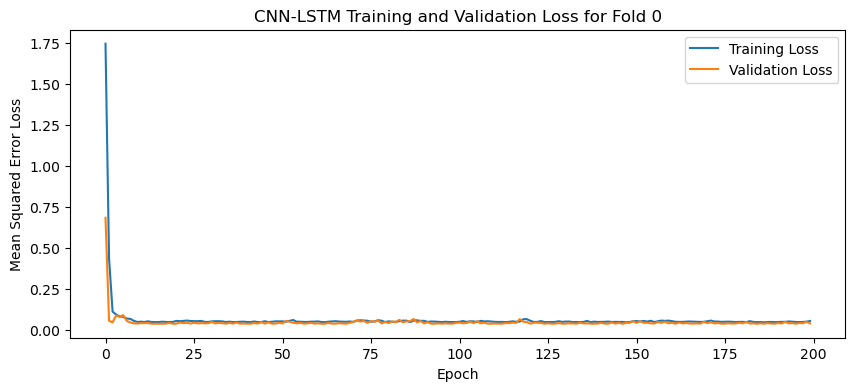

84
84
1


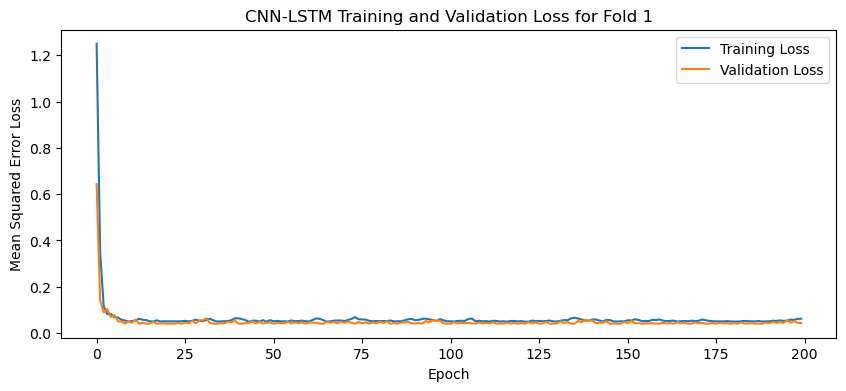

84
84
1


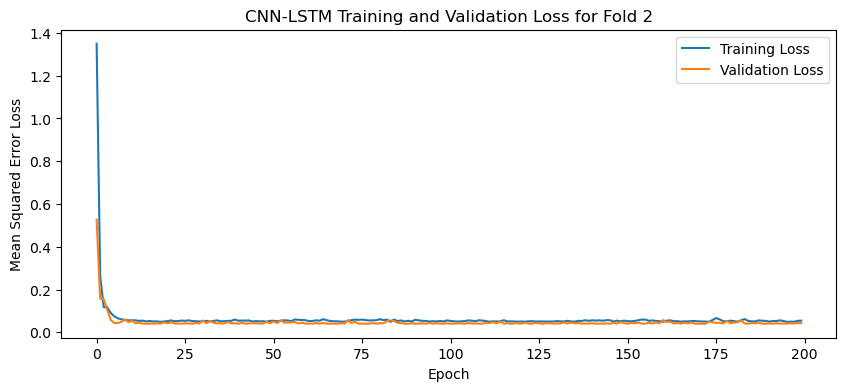

84
84
1


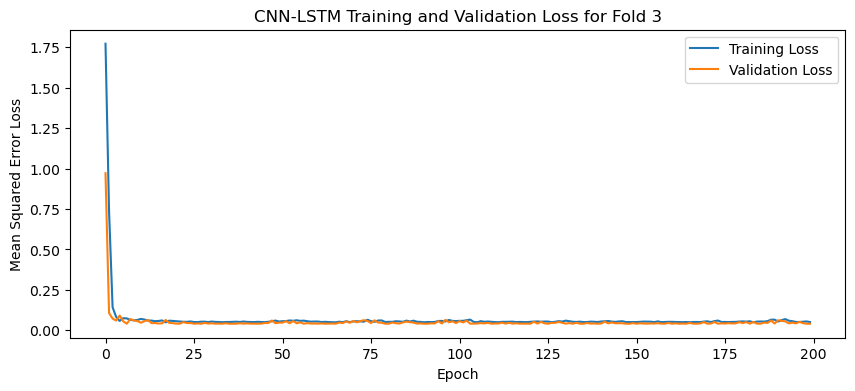

84
84
1


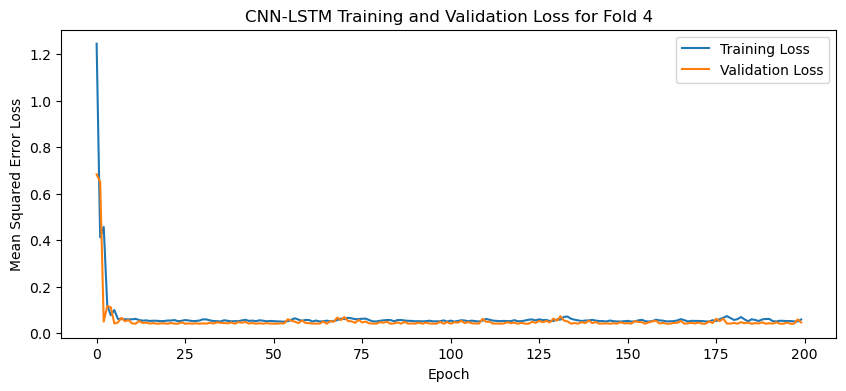

[I 2025-05-06 12:56:44,852] Trial 2 finished with value: 0.042604432255029676 and parameters: {'lr': 0.028322462026508725, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.18982467817841542}. Best is trial 2 with value: 0.042604432255029676.


84
84
1


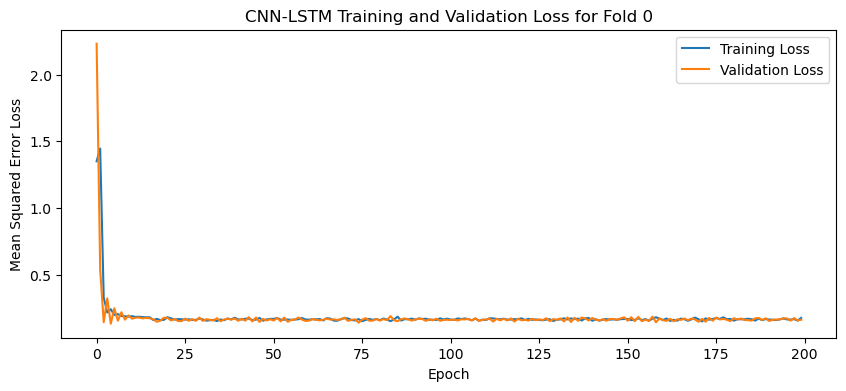

84
84
1


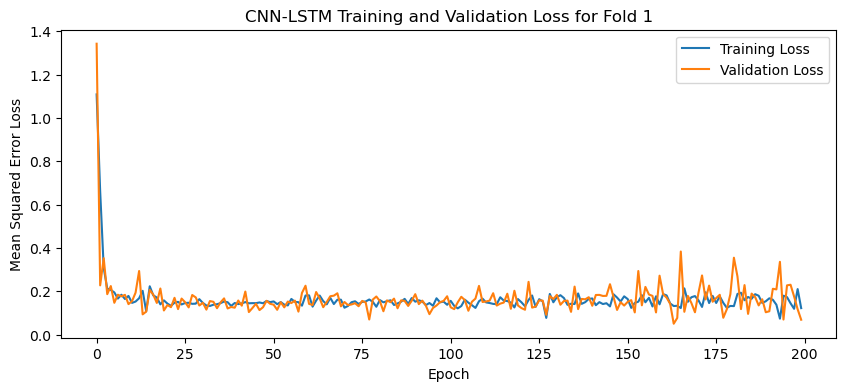

84
84
1


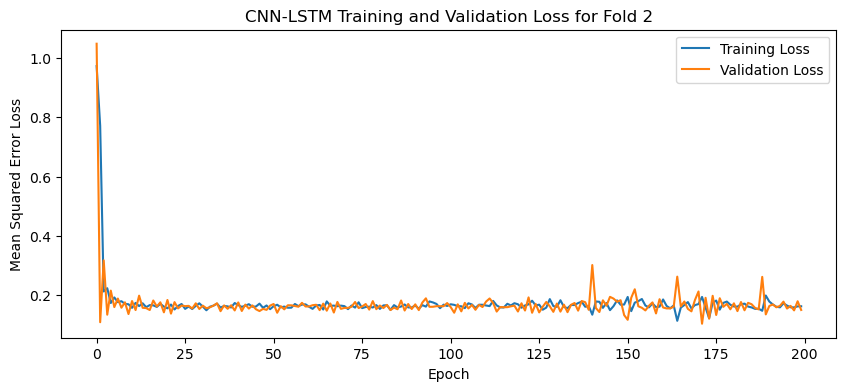

84
84
1


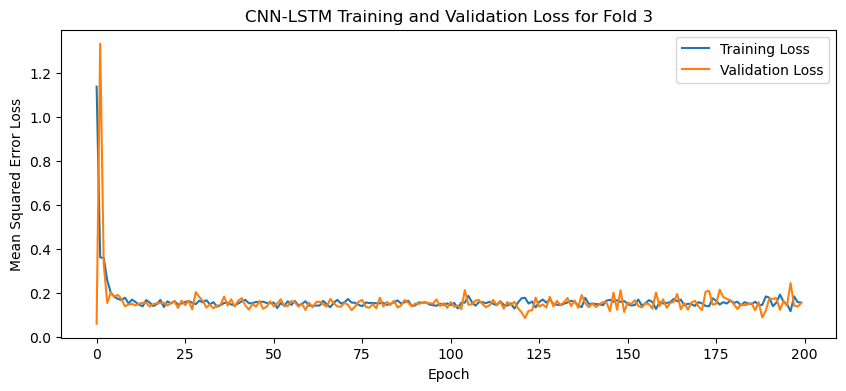

84
84
1


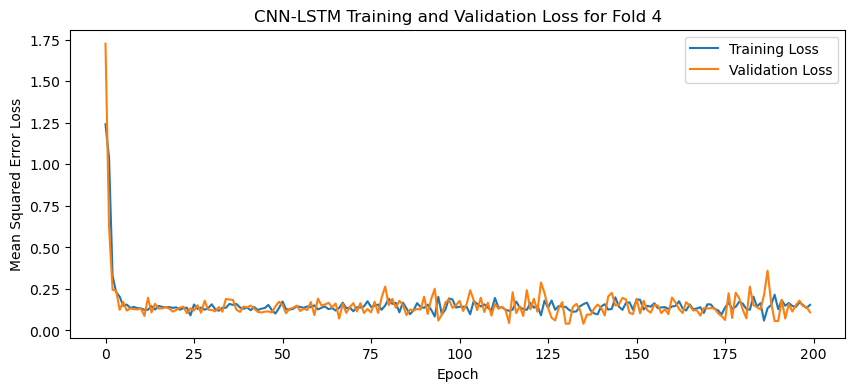

[I 2025-05-06 12:58:26,352] Trial 3 finished with value: 0.12866238951683046 and parameters: {'lr': 0.037112810466583955, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 128, 'dropout_rate': 0.4518959808690739}. Best is trial 2 with value: 0.042604432255029676.


84
84
1


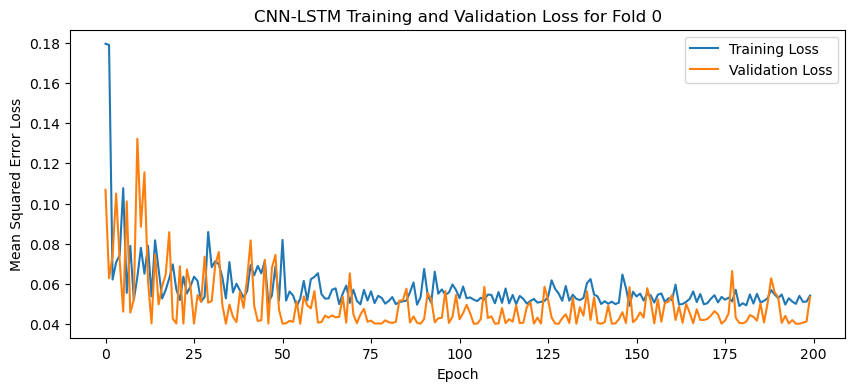

84
84
1


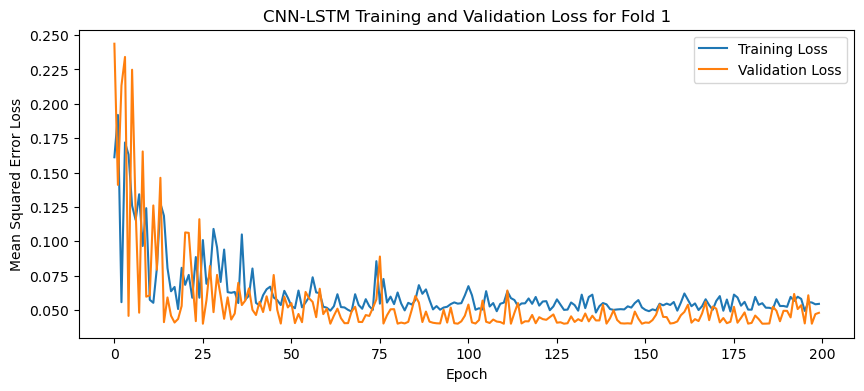

84
84
1


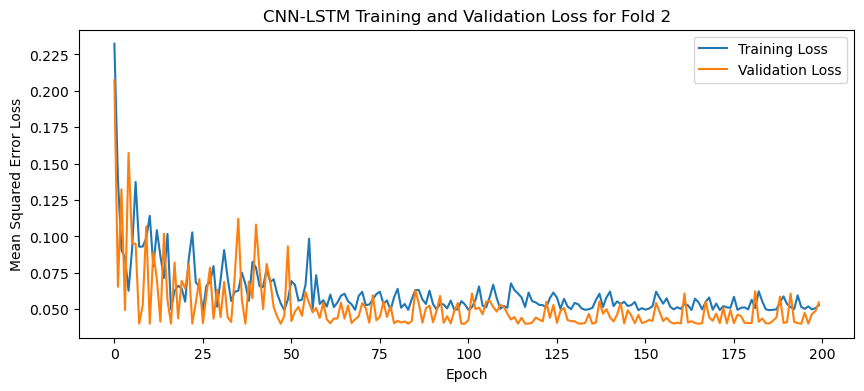

84
84
1


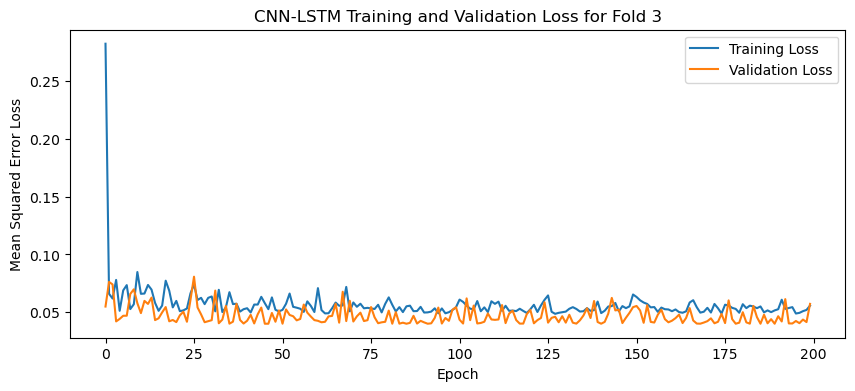

84
84
1


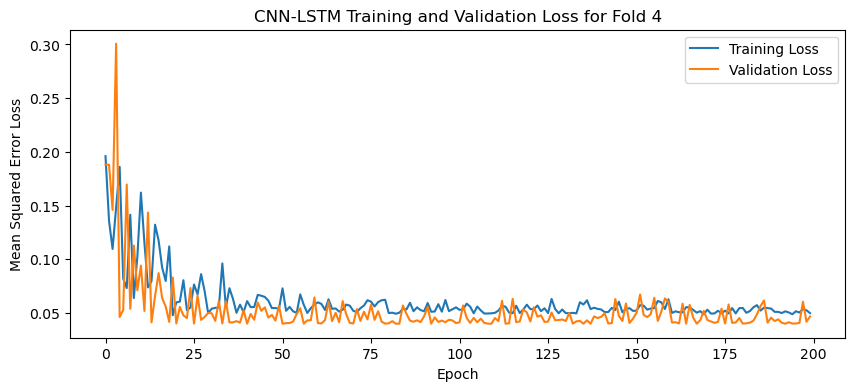

[I 2025-05-06 12:59:58,580] Trial 4 finished with value: 0.052023980766534805 and parameters: {'lr': 0.08161472834375053, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 64, 'dropout_rate': 0.4336512099608455}. Best is trial 2 with value: 0.042604432255029676.


84
84
1


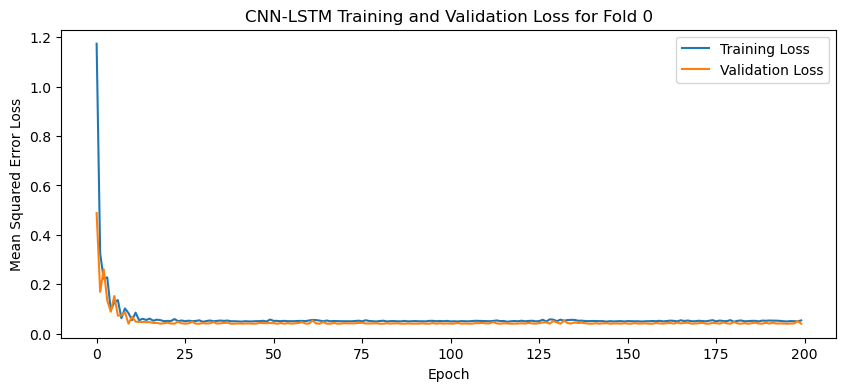

84
84
1


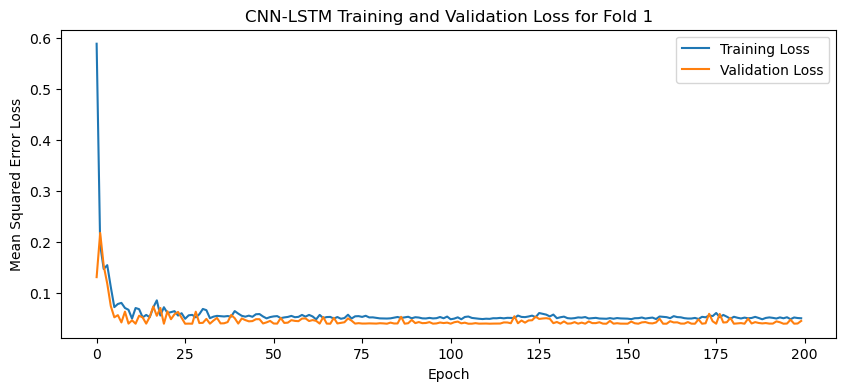

84
84
1


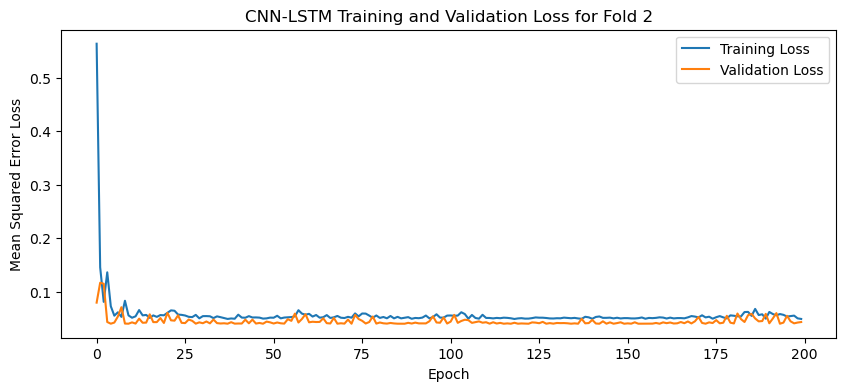

84
84
1


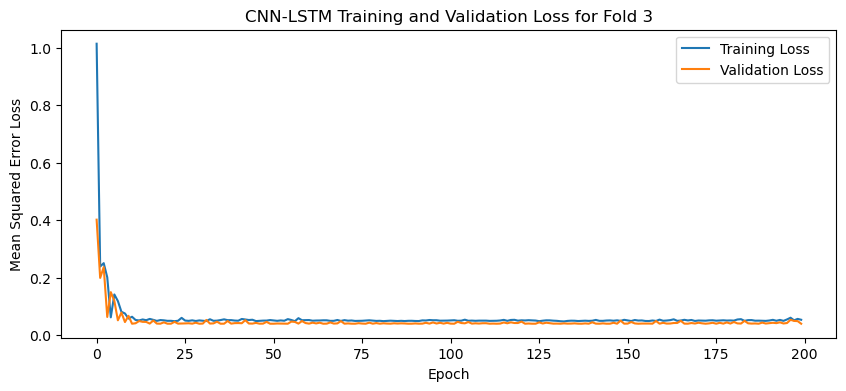

84
84
1


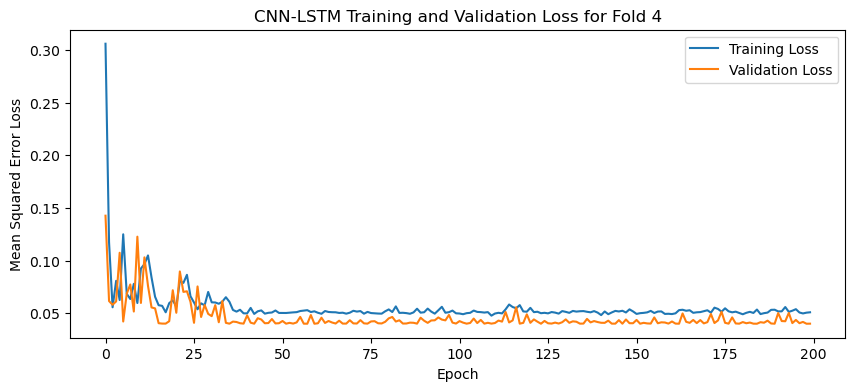

[I 2025-05-06 13:01:28,347] Trial 5 finished with value: 0.041863616555929184 and parameters: {'lr': 0.020675698048160197, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 64, 'dropout_rate': 0.4819794675599357}. Best is trial 5 with value: 0.041863616555929184.


84
84
1


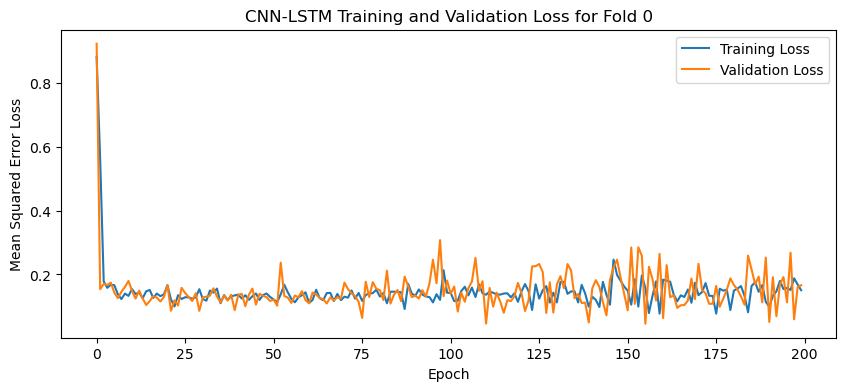

84
84
1


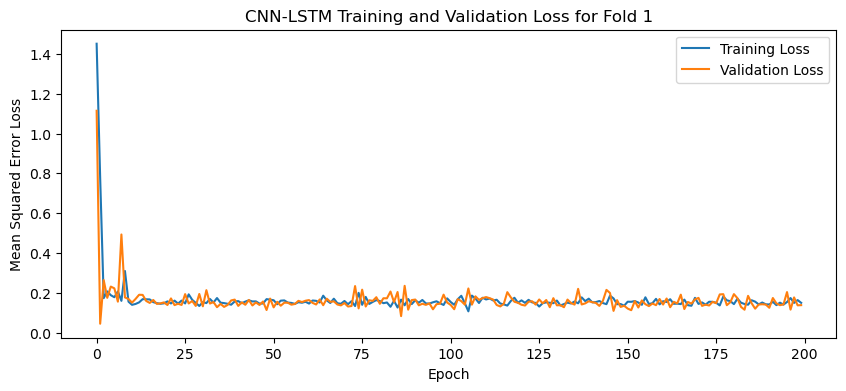

84
84
1


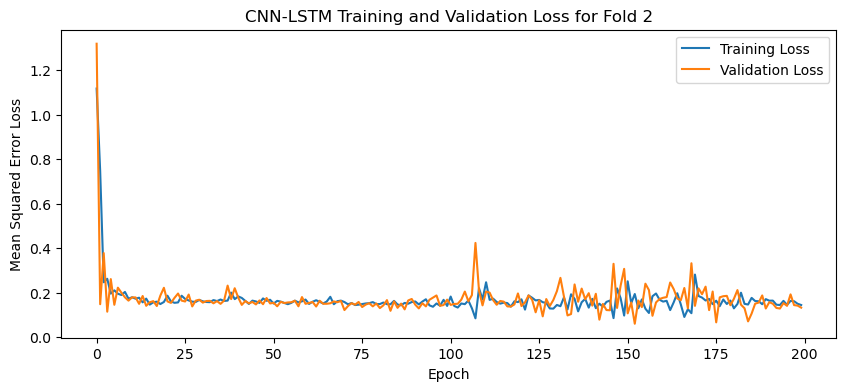

84
84
1


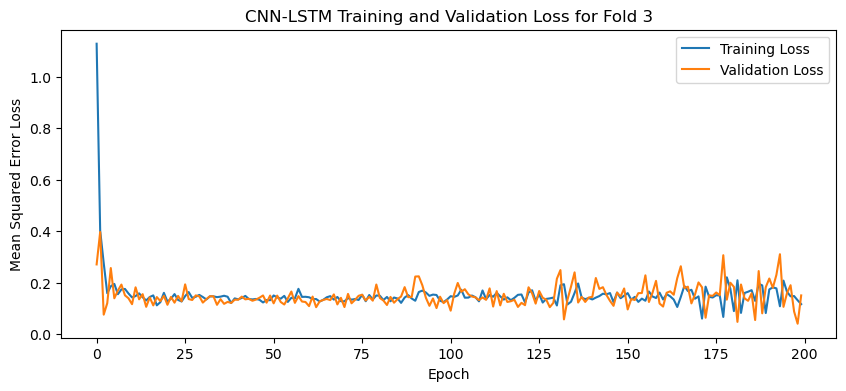

84
84
1


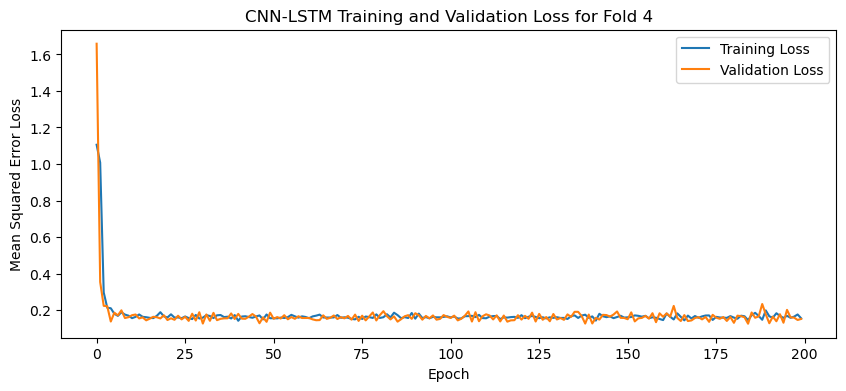

[I 2025-05-06 13:03:04,889] Trial 6 finished with value: 0.1477585256099701 and parameters: {'lr': 0.03628191713144657, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 128, 'dropout_rate': 0.48375398617782583}. Best is trial 5 with value: 0.041863616555929184.


84
84
1


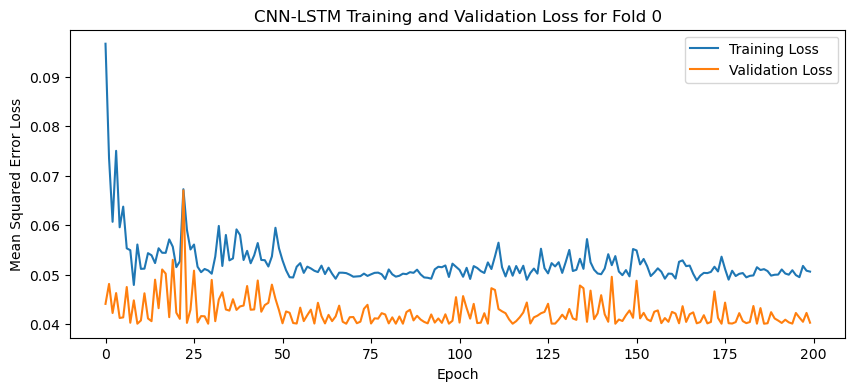

84
84
1


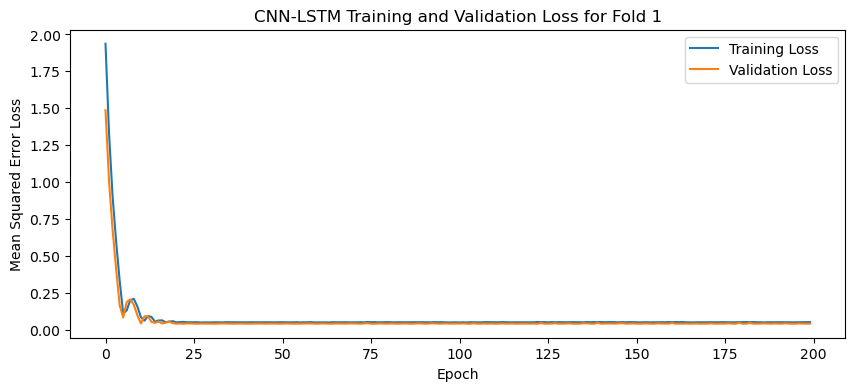

84
84
1


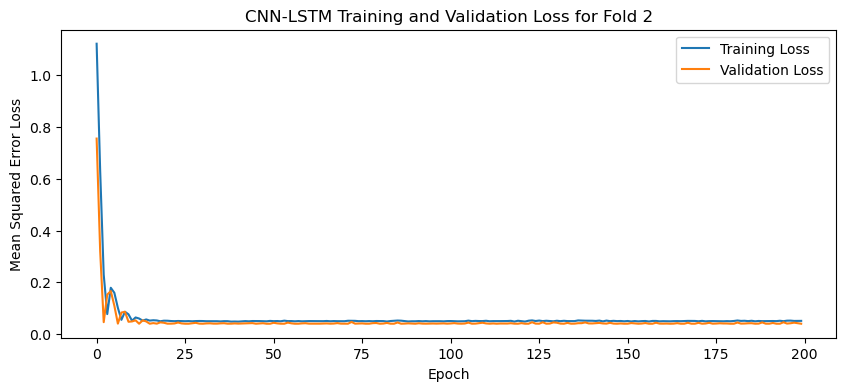

84
84
1


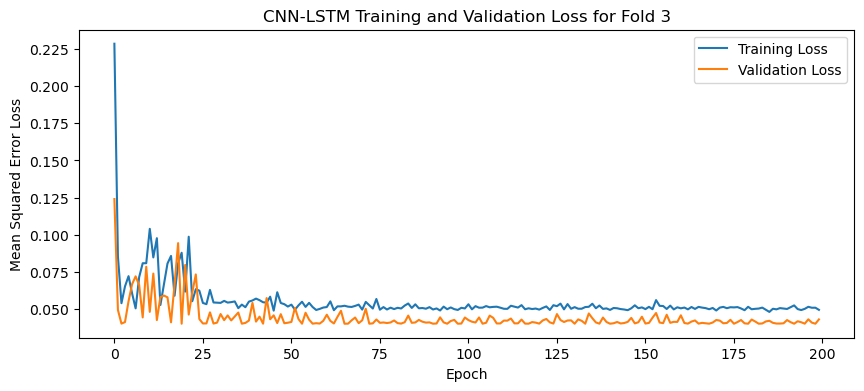

84
84
1


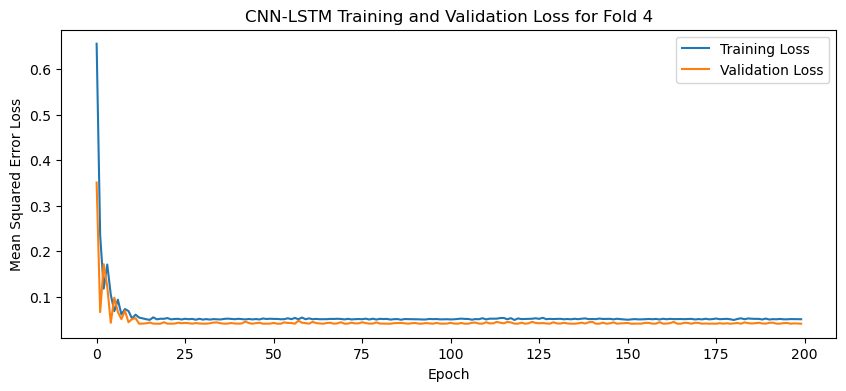

[I 2025-05-06 13:04:43,083] Trial 7 finished with value: 0.040941649675369264 and parameters: {'lr': 0.00805331745578421, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.3896786952628337}. Best is trial 7 with value: 0.040941649675369264.


84
84
1


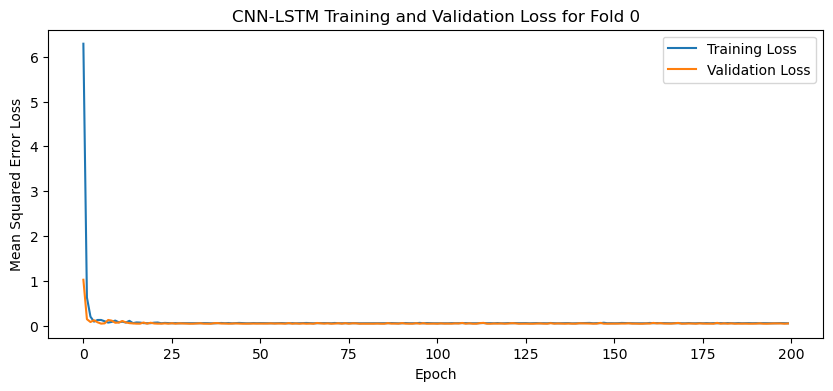

84
84
1


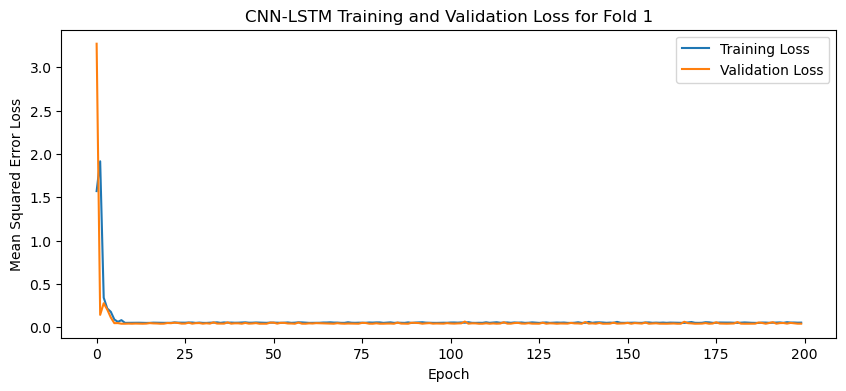

84
84
1


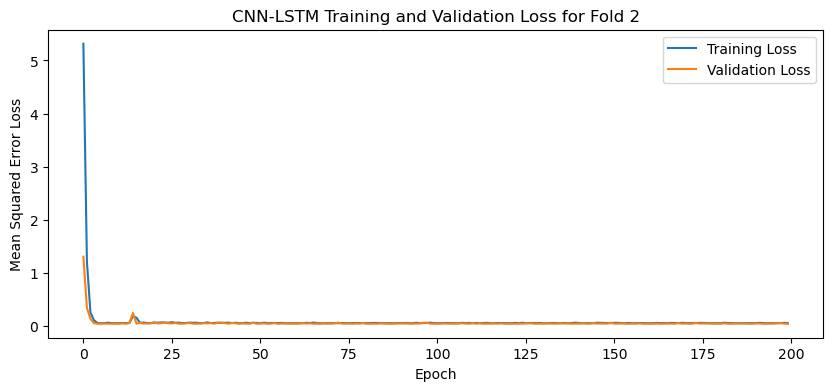

84
84
1


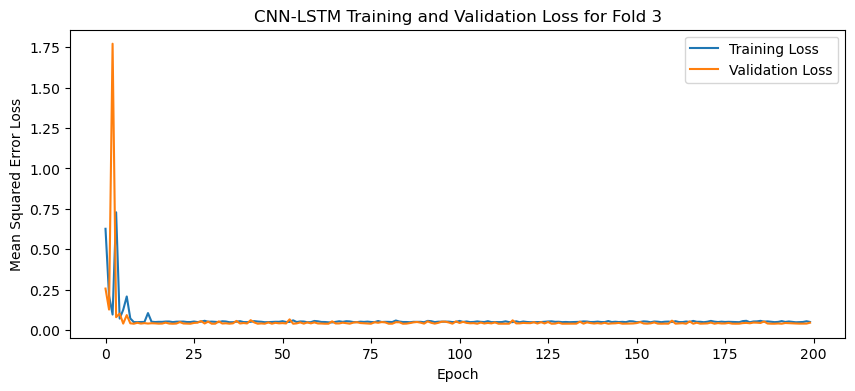

84
84
1


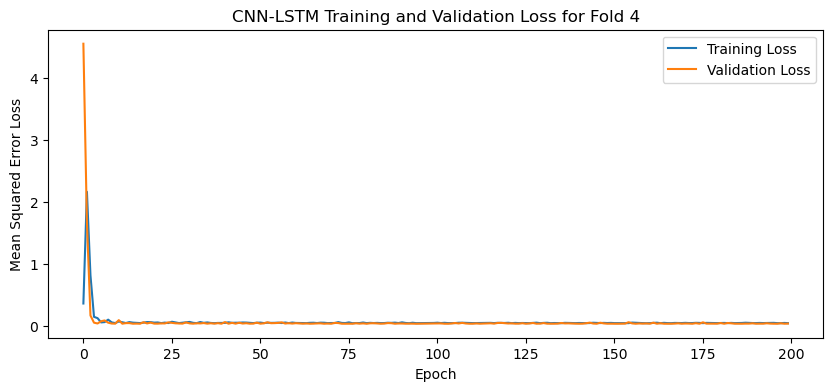

[I 2025-05-06 13:06:45,170] Trial 8 finished with value: 0.04311377555131912 and parameters: {'lr': 0.02855007212359845, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.26297556978970116}. Best is trial 7 with value: 0.040941649675369264.


84
84
1


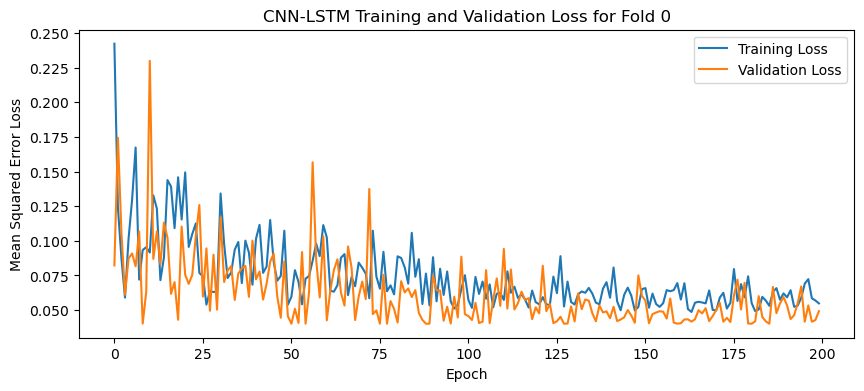

84
84
1


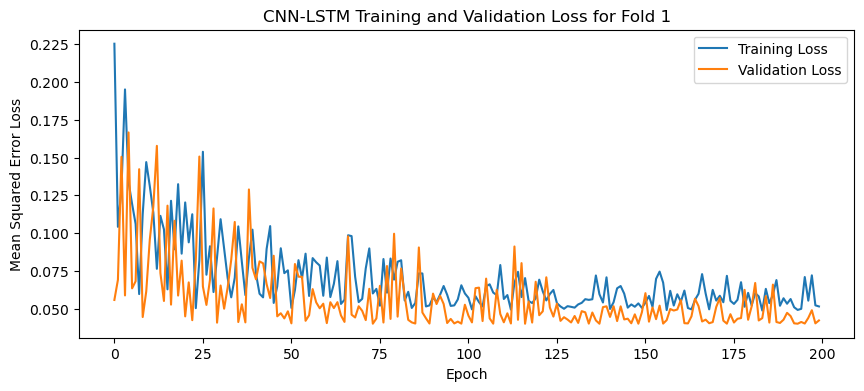

84
84
1


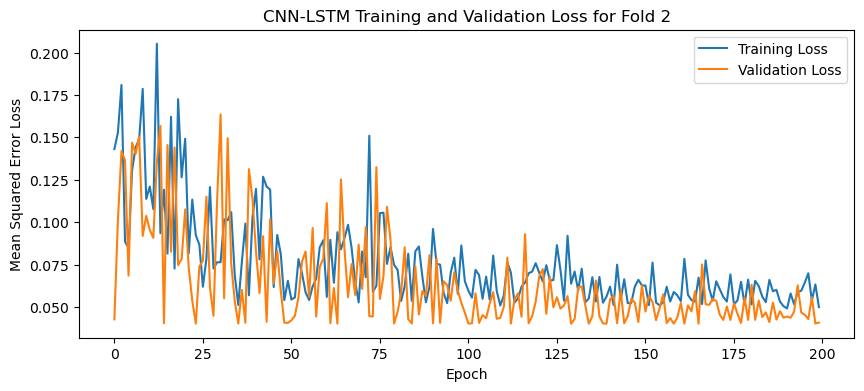

84
84
1


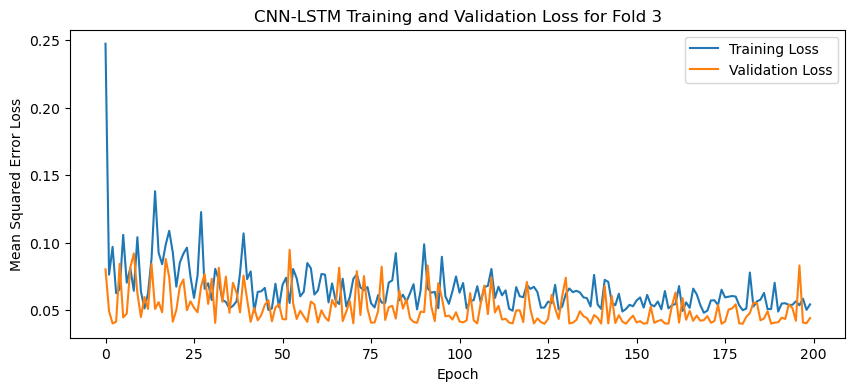

84
84
1


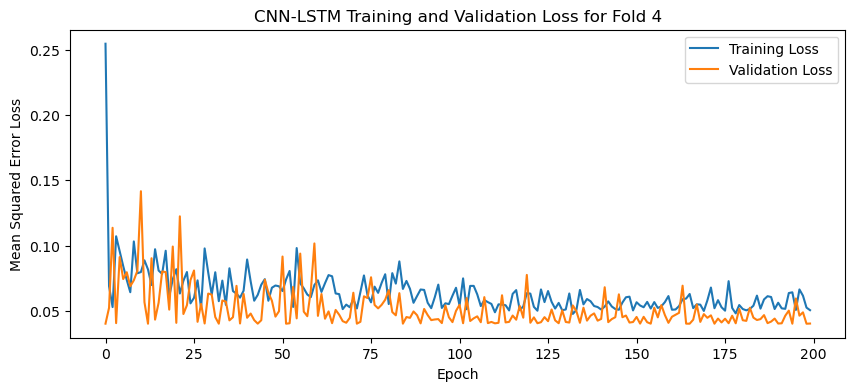

[I 2025-05-06 13:08:19,874] Trial 9 finished with value: 0.04352291449904442 and parameters: {'lr': 0.018788050761742753, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 128, 'dropout_rate': 0.13697736261668286}. Best is trial 7 with value: 0.040941649675369264.


84
84
1


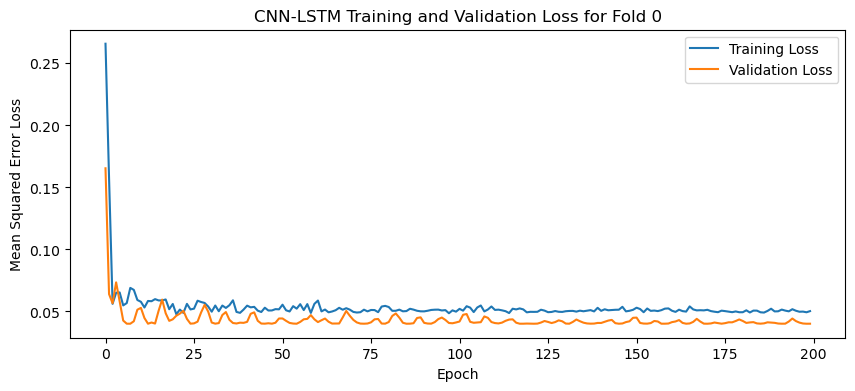

84
84
1


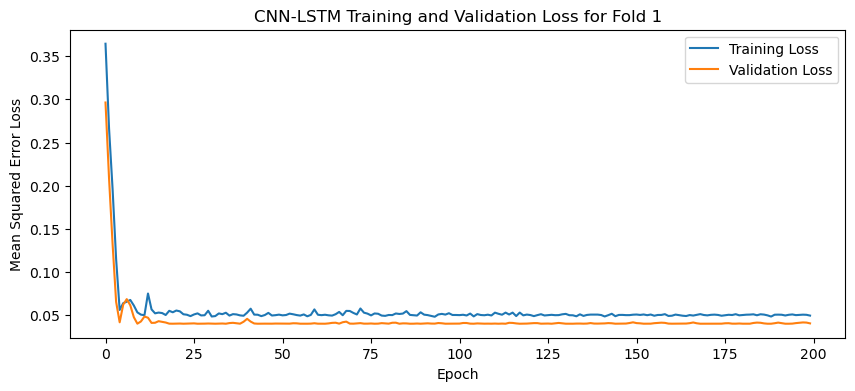

84
84
1


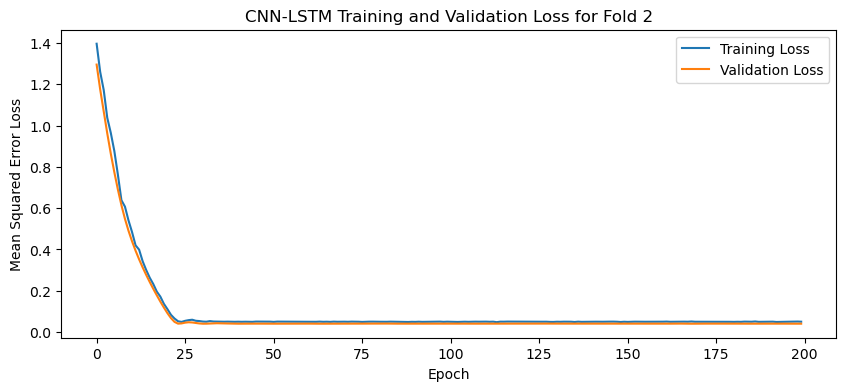

84
84
1


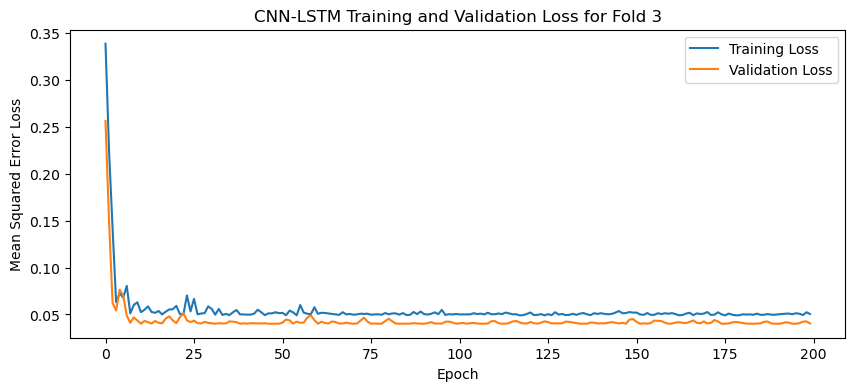

84
84
1


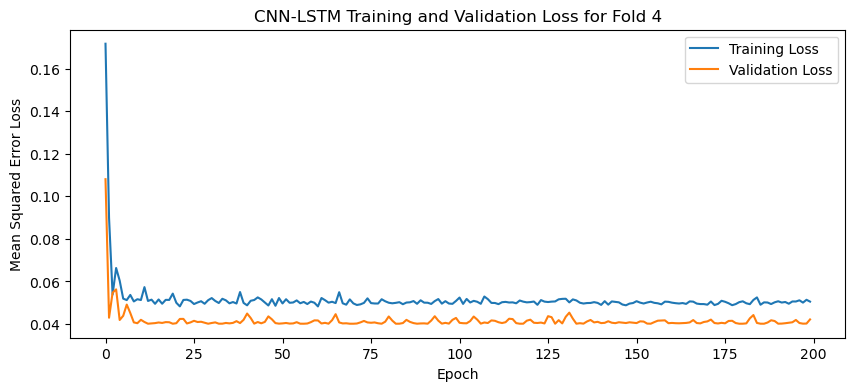

[I 2025-05-06 13:10:08,100] Trial 10 finished with value: 0.040675568580627444 and parameters: {'lr': 0.0011679261367111336, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.3240631207517907}. Best is trial 10 with value: 0.040675568580627444.


84
84
1


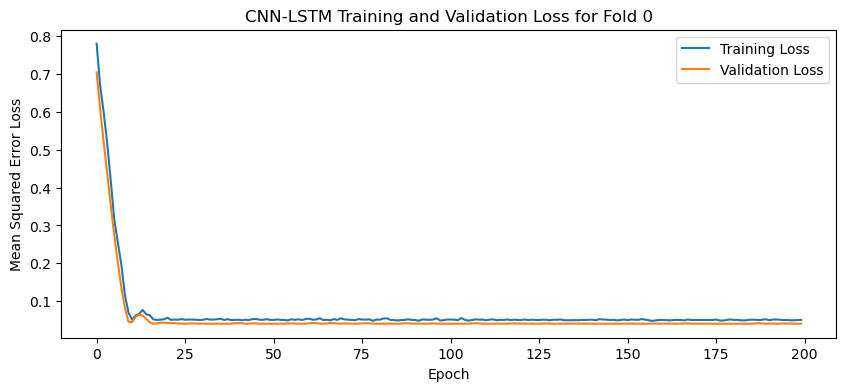

84
84
1


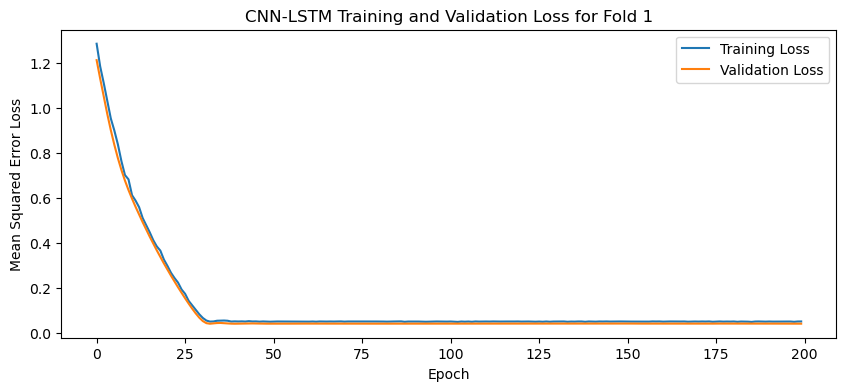

84
84
1


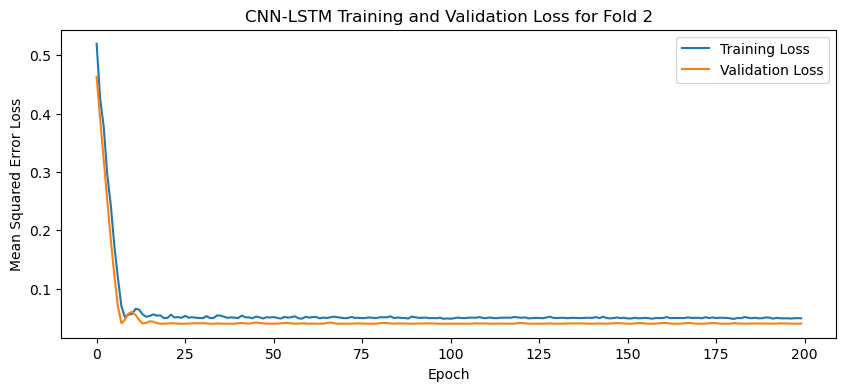

84
84
1


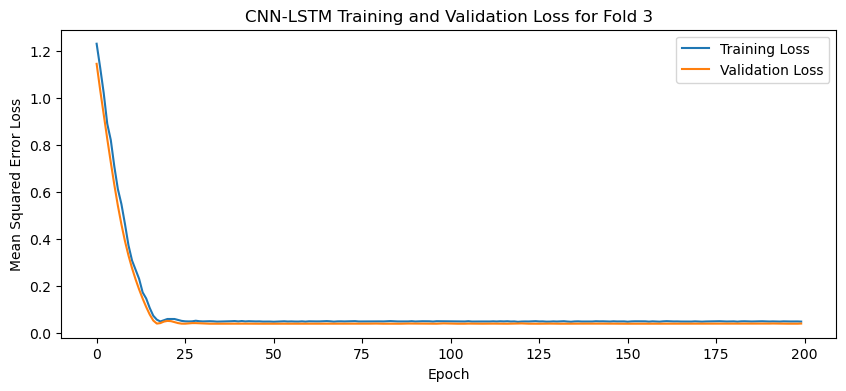

84
84
1


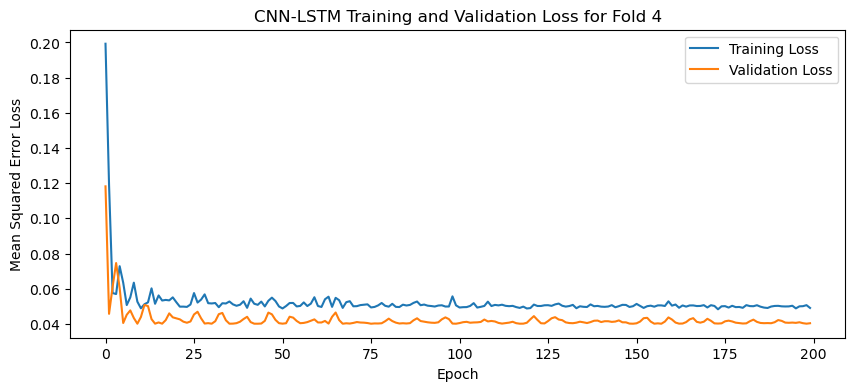

[I 2025-05-06 13:11:44,782] Trial 11 finished with value: 0.040387491881847384 and parameters: {'lr': 0.001003926743948801, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.33132711912054685}. Best is trial 11 with value: 0.040387491881847384.


84
84
1


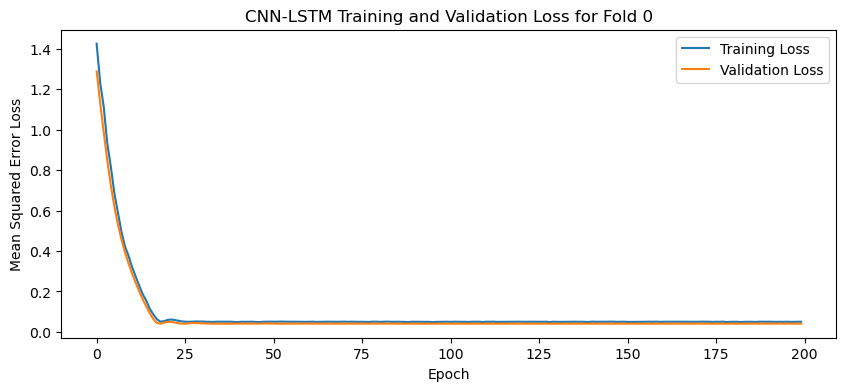

84
84
1


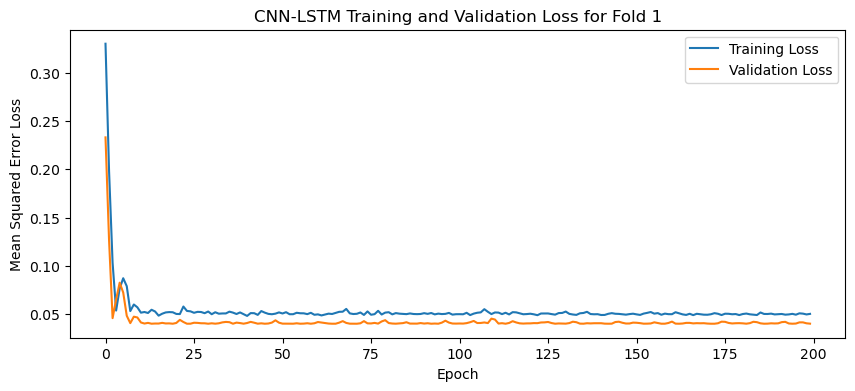

84
84
1


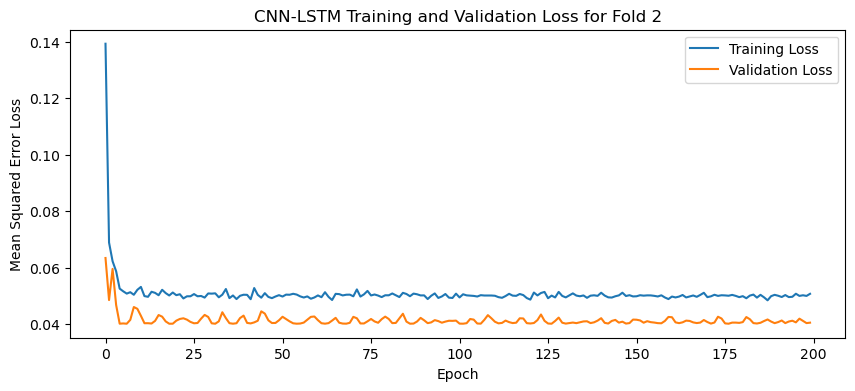

84
84
1


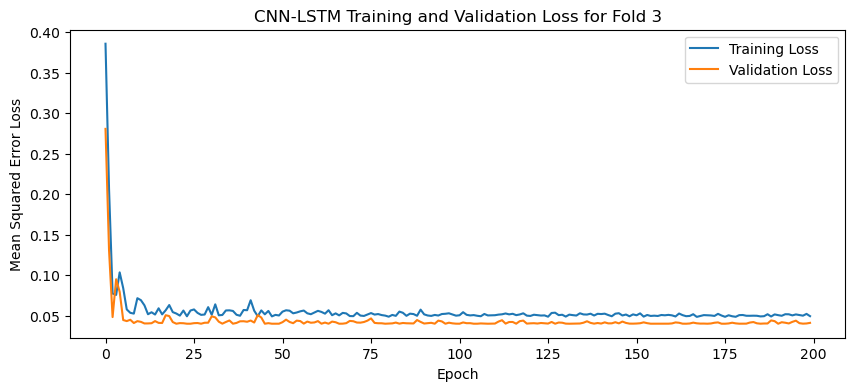

84
84
1


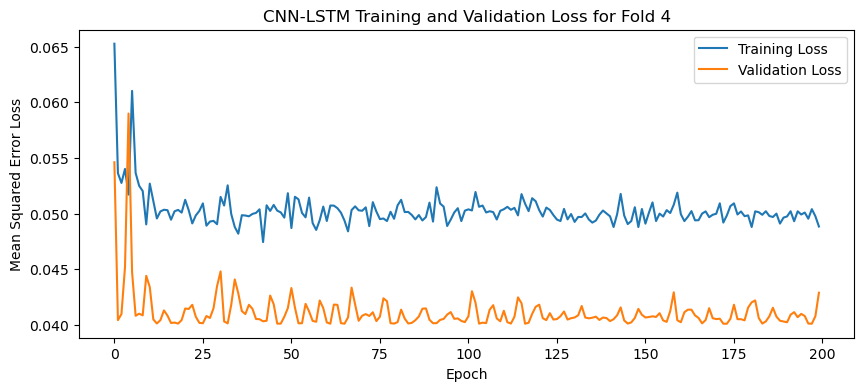

[I 2025-05-06 13:13:11,483] Trial 12 finished with value: 0.04107479900121689 and parameters: {'lr': 0.0015149806976691225, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.2908739152606319}. Best is trial 11 with value: 0.040387491881847384.


84
84
1


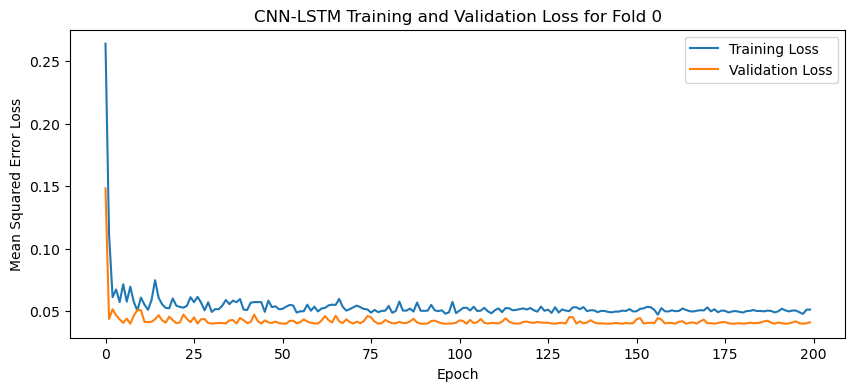

84
84
1


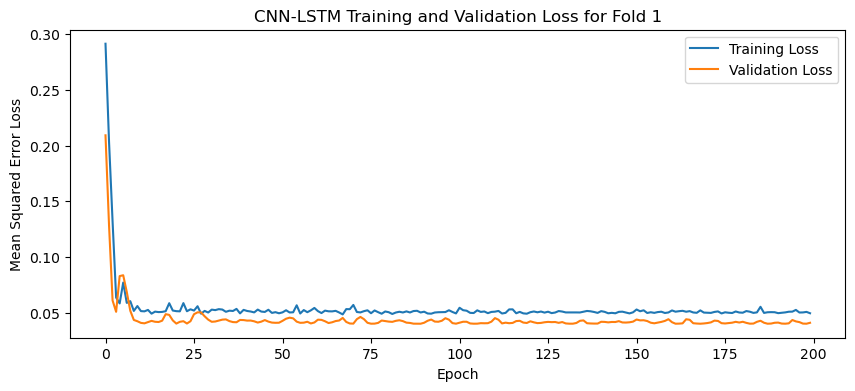

84
84
1


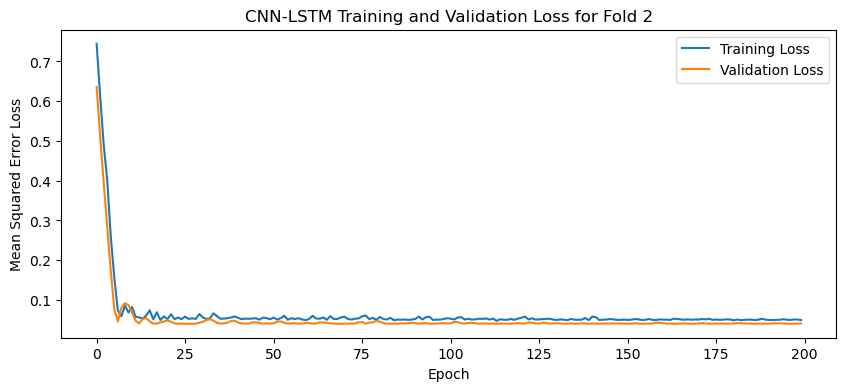

84
84
1


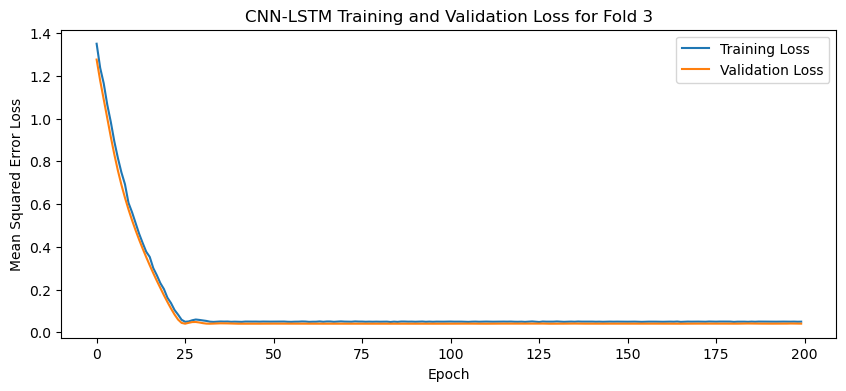

84
84
1


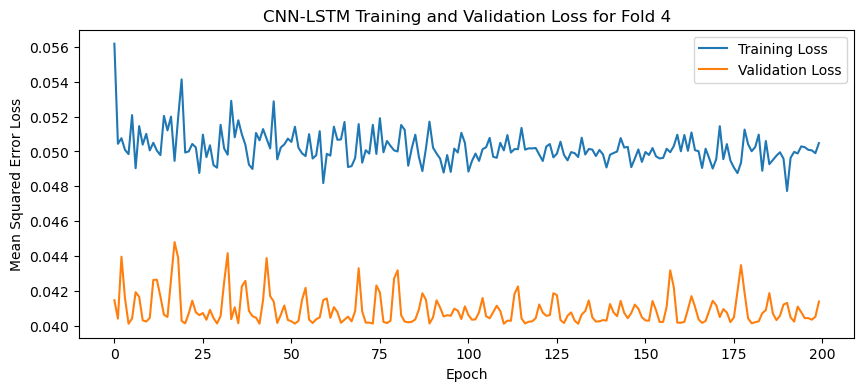

[I 2025-05-06 13:14:47,181] Trial 13 finished with value: 0.040982719510793686 and parameters: {'lr': 0.0010369888401812178, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.3446534251143066}. Best is trial 11 with value: 0.040387491881847384.


84
84
1


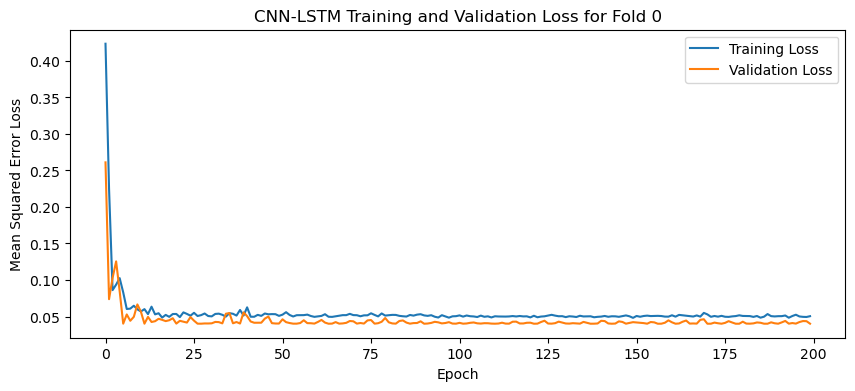

84
84
1


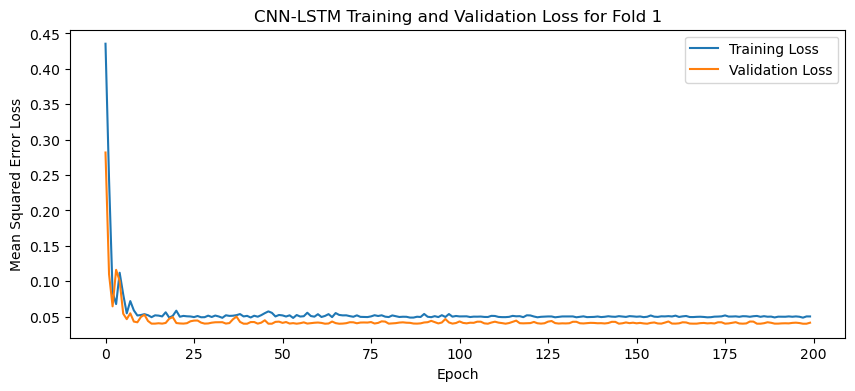

84
84
1


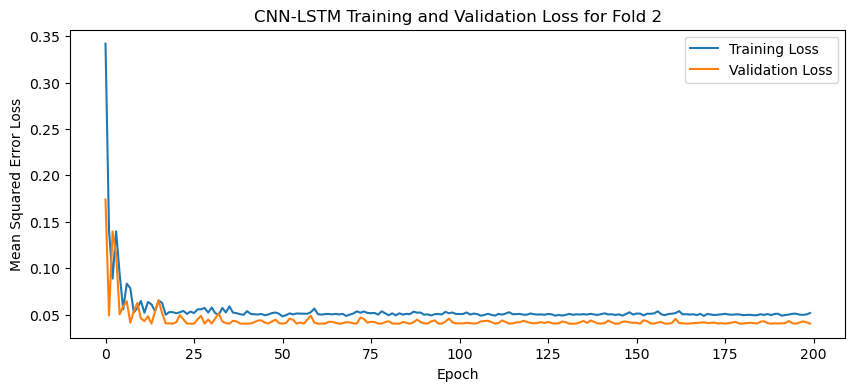

84
84
1


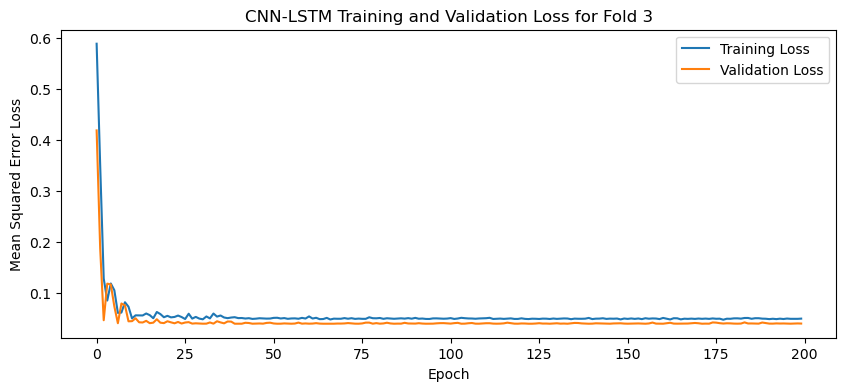

84
84
1


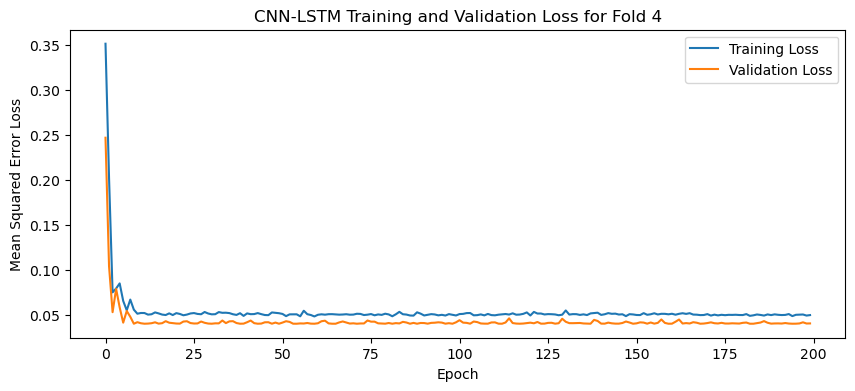

[I 2025-05-06 13:16:23,547] Trial 14 finished with value: 0.04057598635554314 and parameters: {'lr': 0.0024287706619992746, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.24168896847490273}. Best is trial 11 with value: 0.040387491881847384.


84
84
1


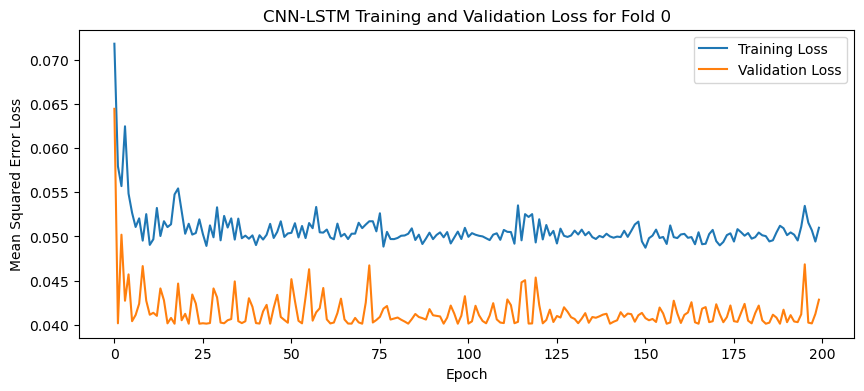

84
84
1


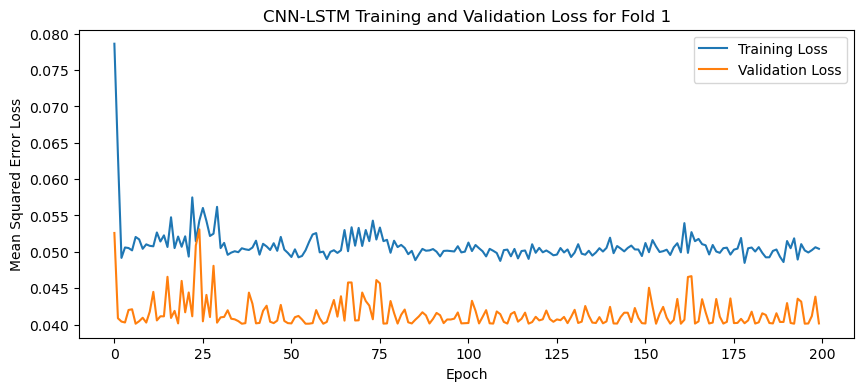

84
84
1


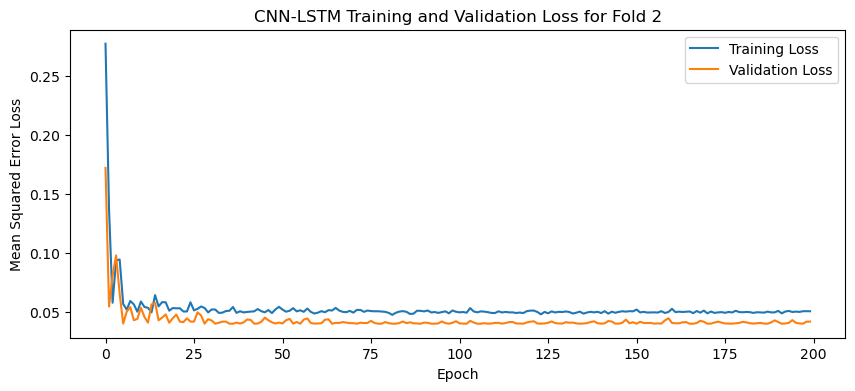

84
84
1


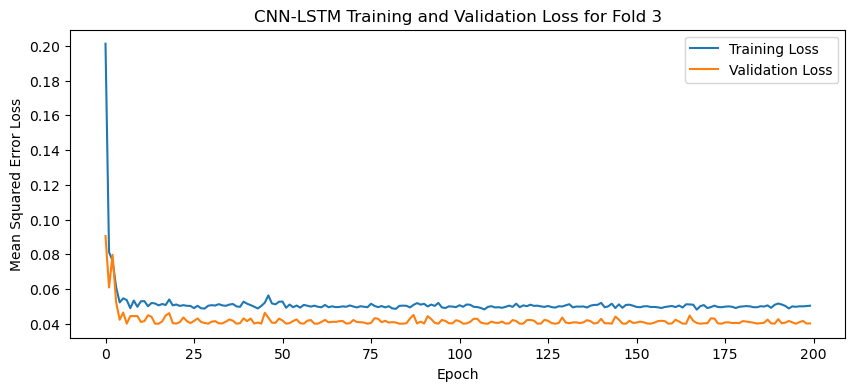

84
84
1


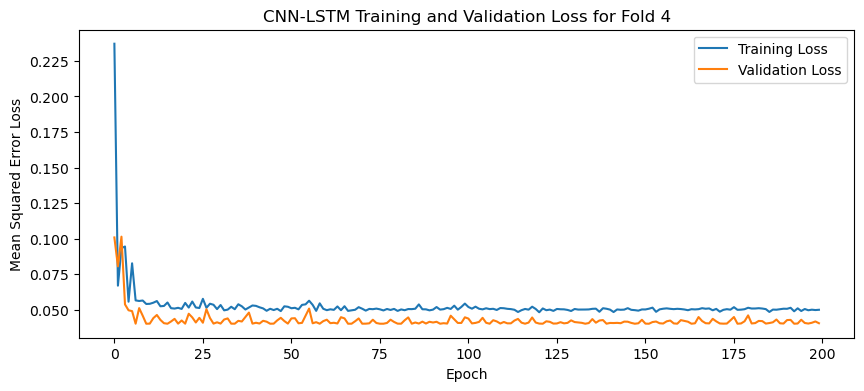

[I 2025-05-06 13:17:43,706] Trial 15 finished with value: 0.041131147742271425 and parameters: {'lr': 0.0026529911414333598, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 64, 'dropout_rate': 0.2300502502644323}. Best is trial 11 with value: 0.040387491881847384.


84
84
1


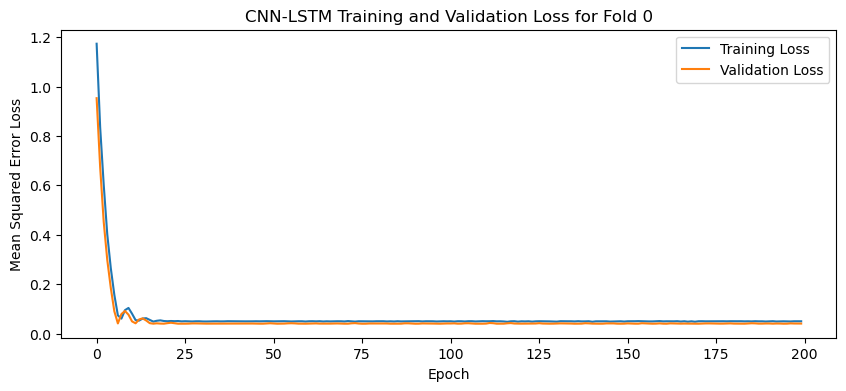

84
84
1


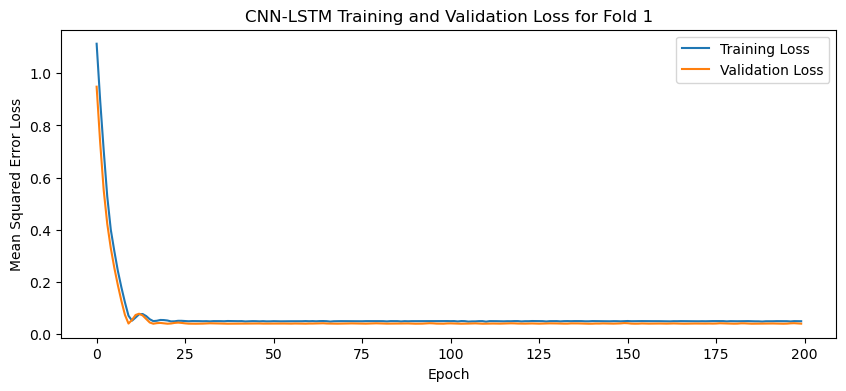

84
84
1


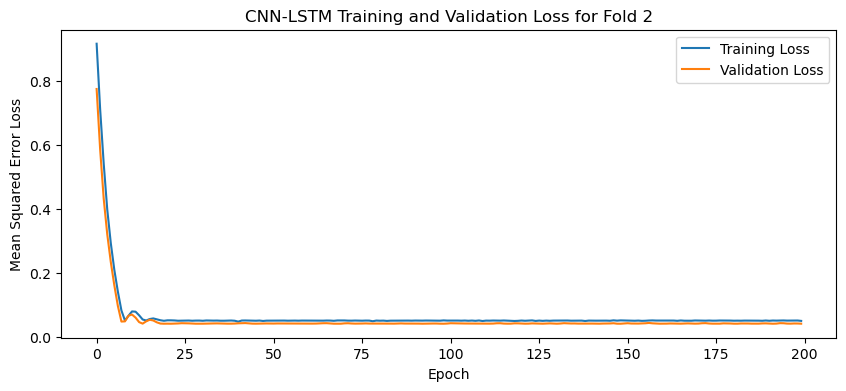

84
84
1


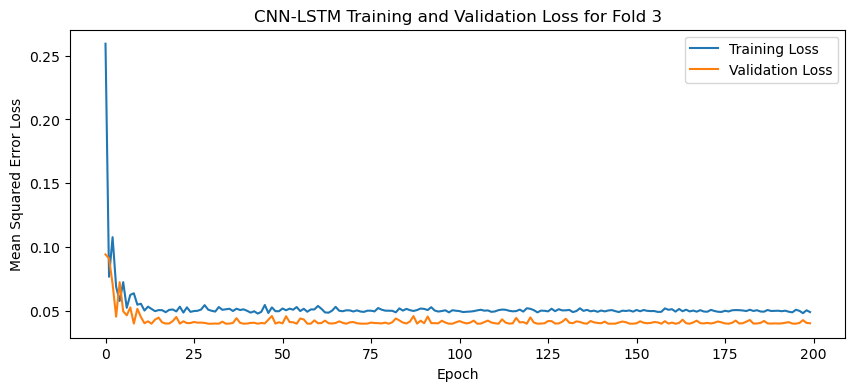

84
84
1


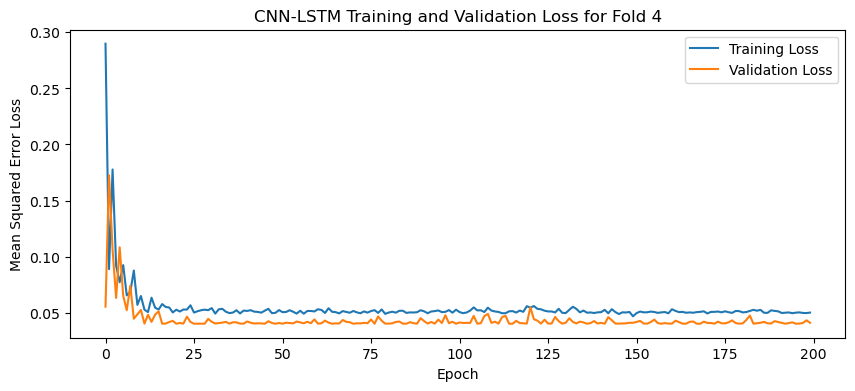

[I 2025-05-06 13:19:15,997] Trial 16 finished with value: 0.04057100489735603 and parameters: {'lr': 0.0029508723989616382, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.19807305610271486}. Best is trial 11 with value: 0.040387491881847384.


84
84
1


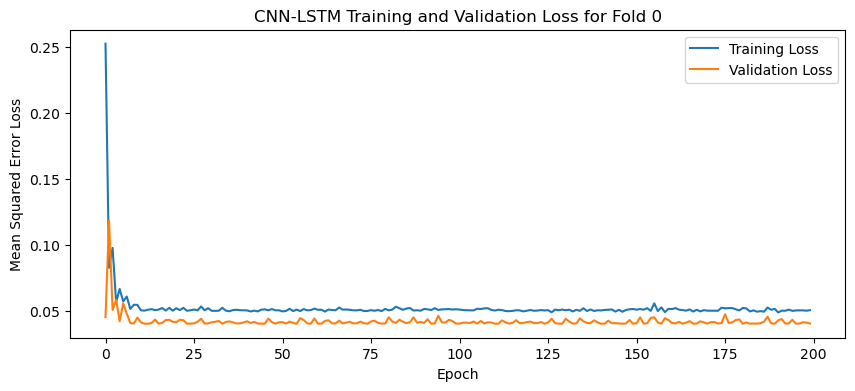

84
84
1


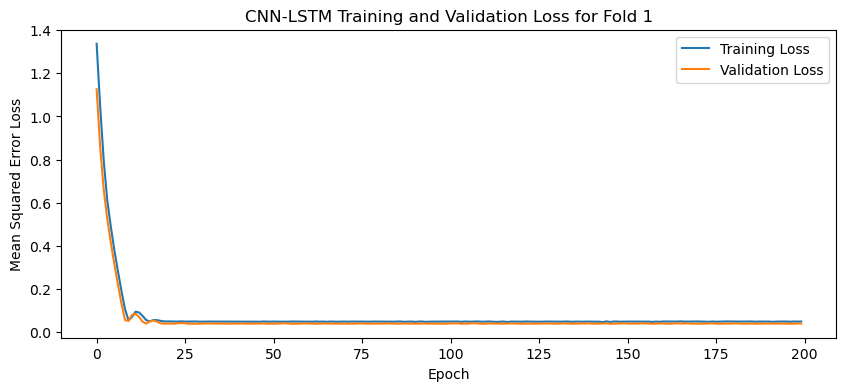

84
84
1


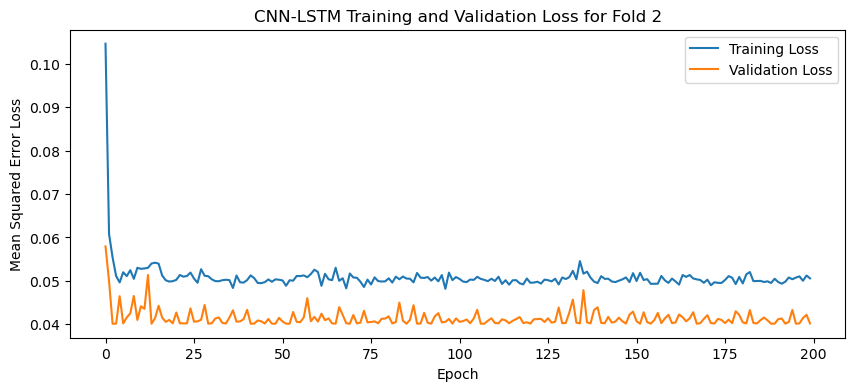

84
84
1


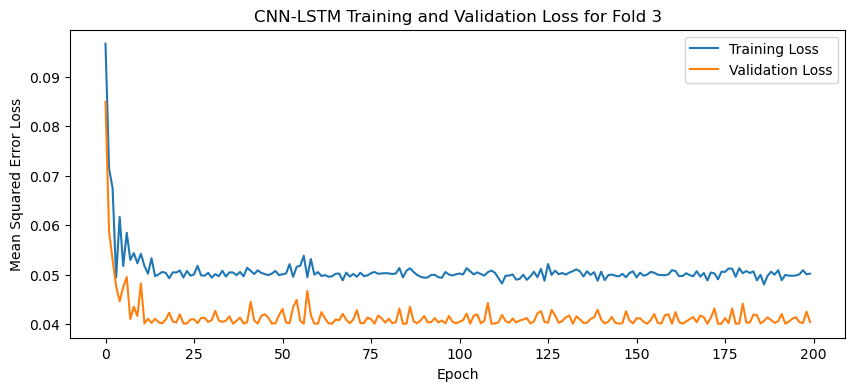

84
84
1


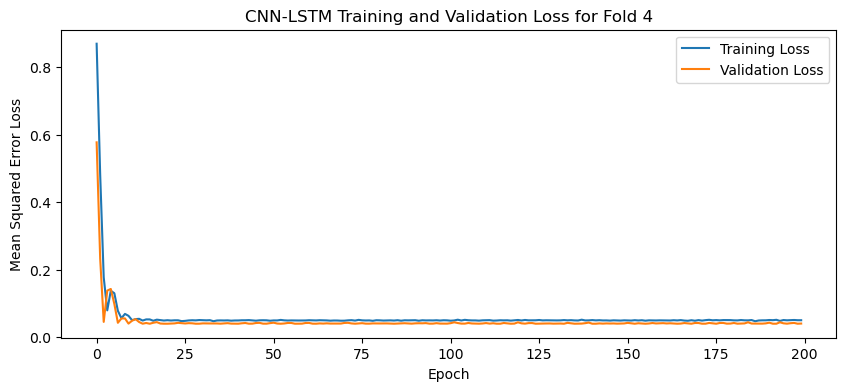

[I 2025-05-06 13:20:43,862] Trial 17 finished with value: 0.04050862714648247 and parameters: {'lr': 0.003926140595349634, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.12126368762739528}. Best is trial 11 with value: 0.040387491881847384.


84
84
1


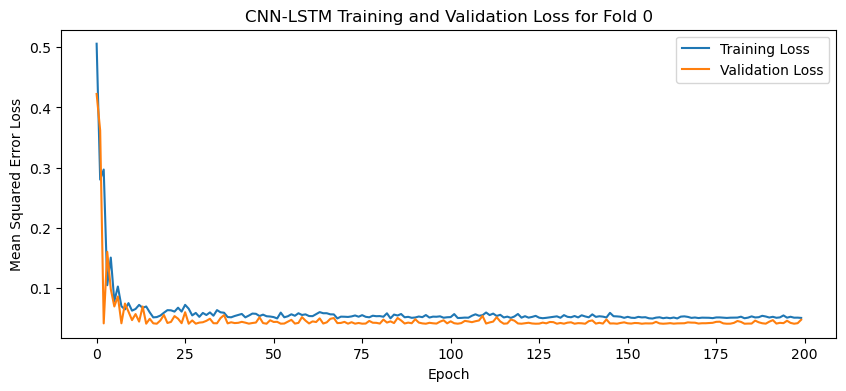

84
84
1


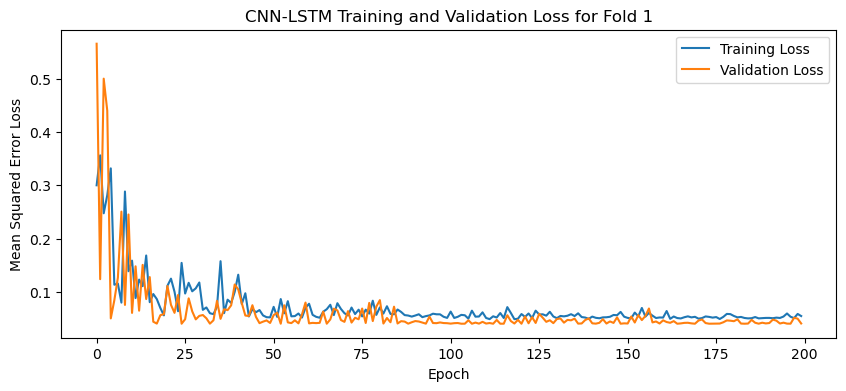

84
84
1


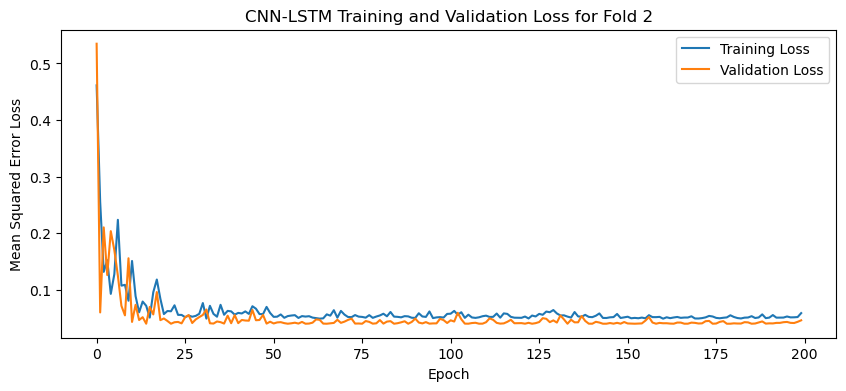

84
84
1


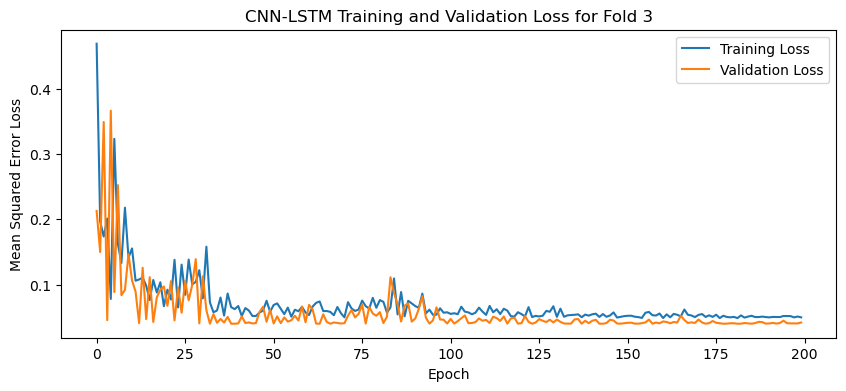

84
84
1


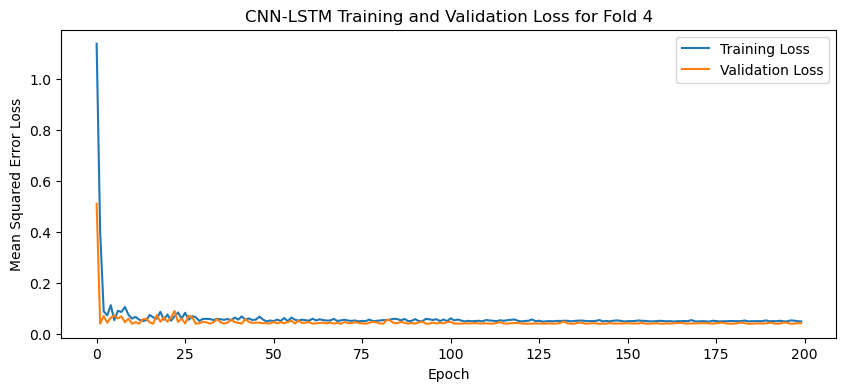

[I 2025-05-06 13:22:17,419] Trial 18 finished with value: 0.04351142793893814 and parameters: {'lr': 0.00618210982449165, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.10782400070967674}. Best is trial 11 with value: 0.040387491881847384.


84
84
1


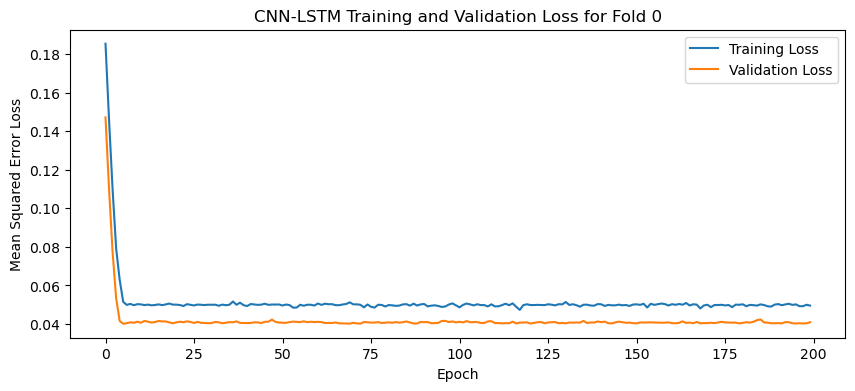

84
84
1


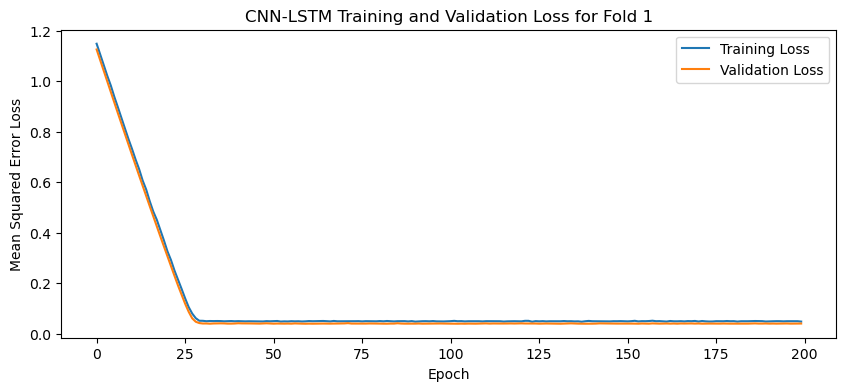

84
84
1


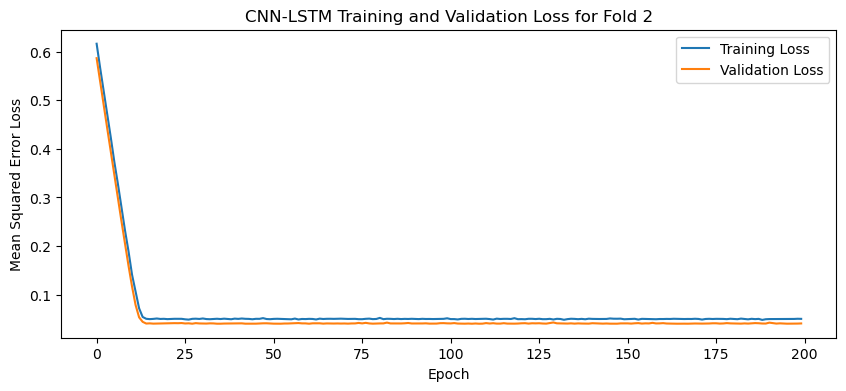

84
84
1


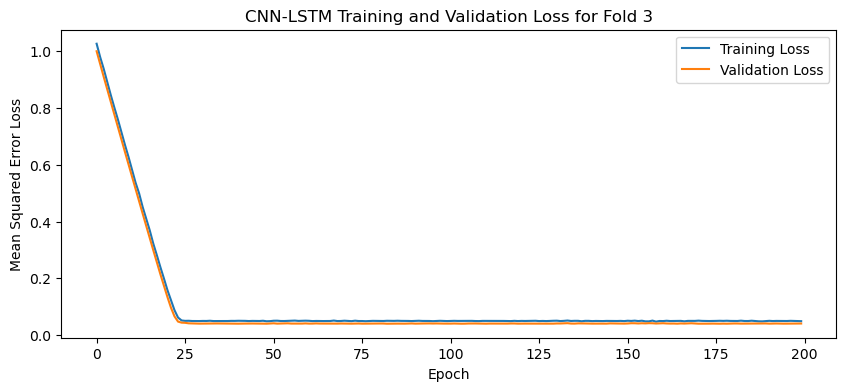

84
84
1


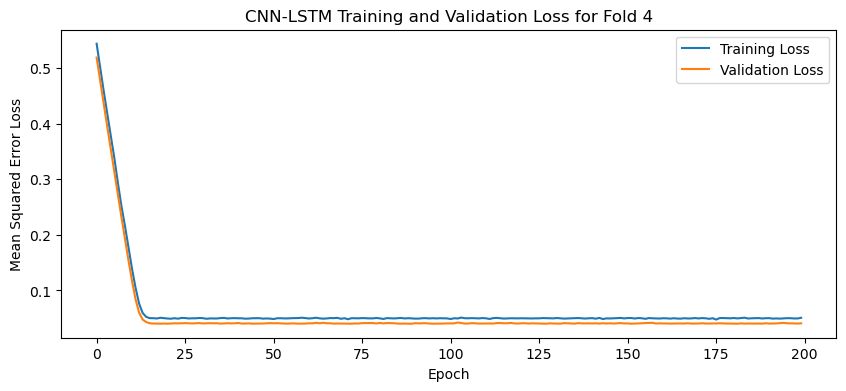

[I 2025-05-06 13:23:31,082] Trial 19 finished with value: 0.04084073528647423 and parameters: {'lr': 0.004052560122783446, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 64, 'dropout_rate': 0.14520097108263152}. Best is trial 11 with value: 0.040387491881847384.


84
84
1


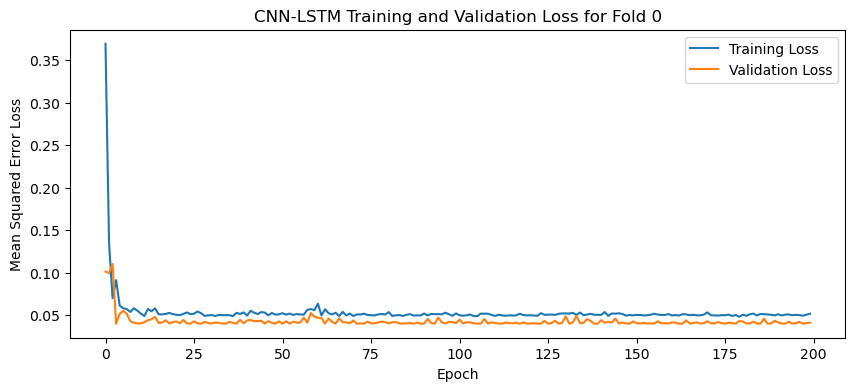

84
84
1


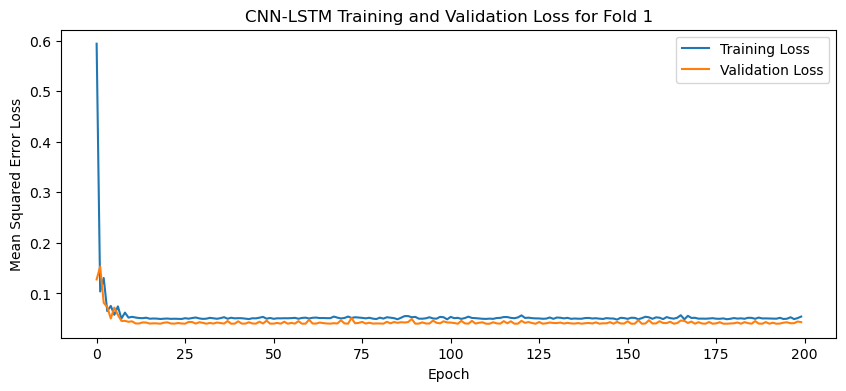

84
84
1


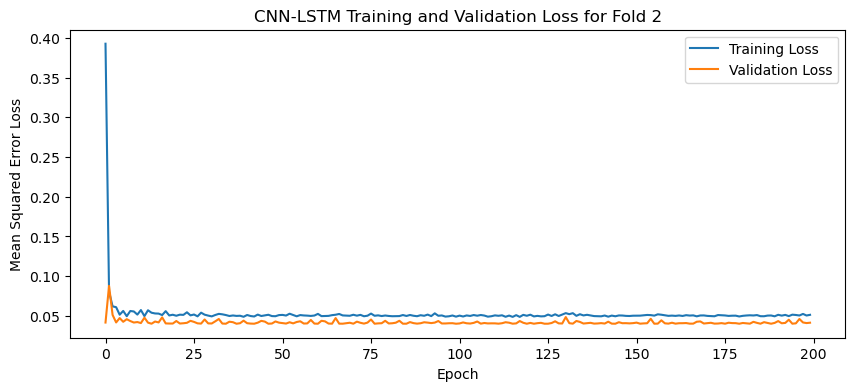

84
84
1


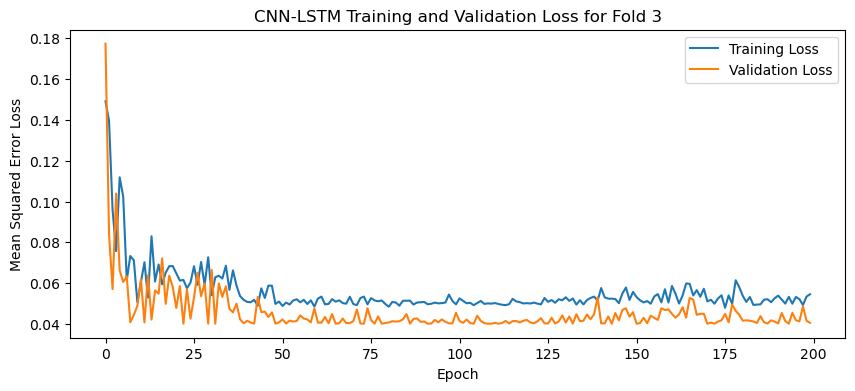

84
84
1


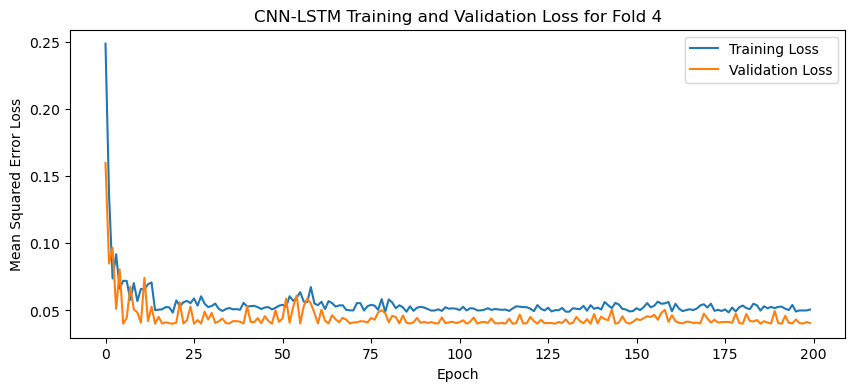

[I 2025-05-06 13:24:53,105] Trial 20 finished with value: 0.04142751023173332 and parameters: {'lr': 0.010976044898679626, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.2933699376056317}. Best is trial 11 with value: 0.040387491881847384.


84
84
1


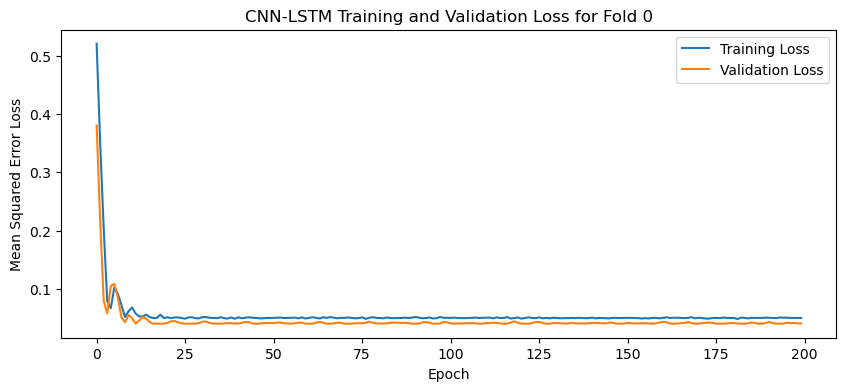

84
84
1


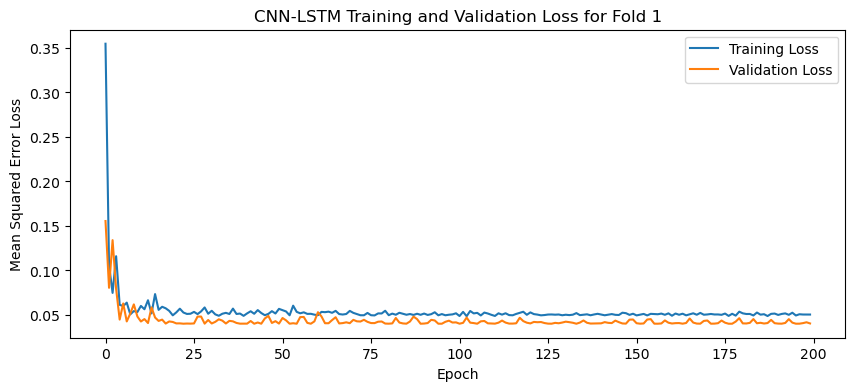

84
84
1


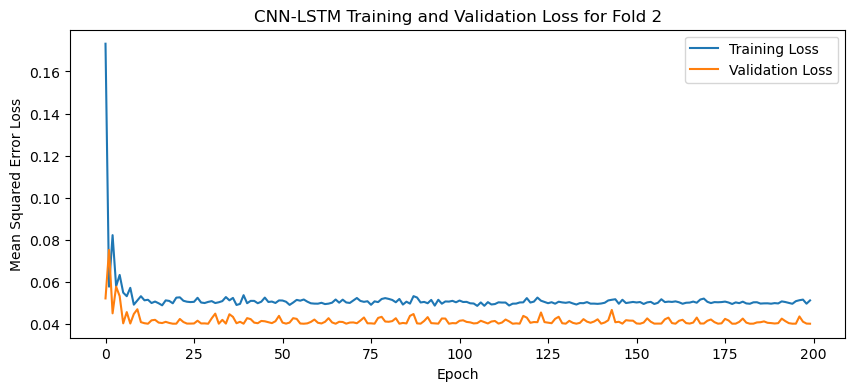

84
84
1


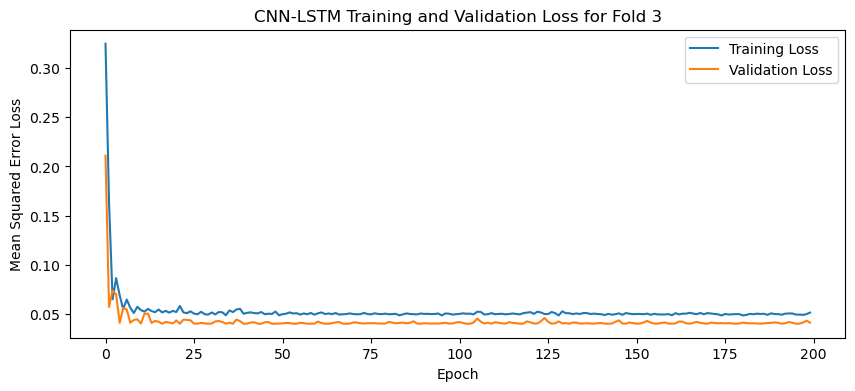

84
84
1


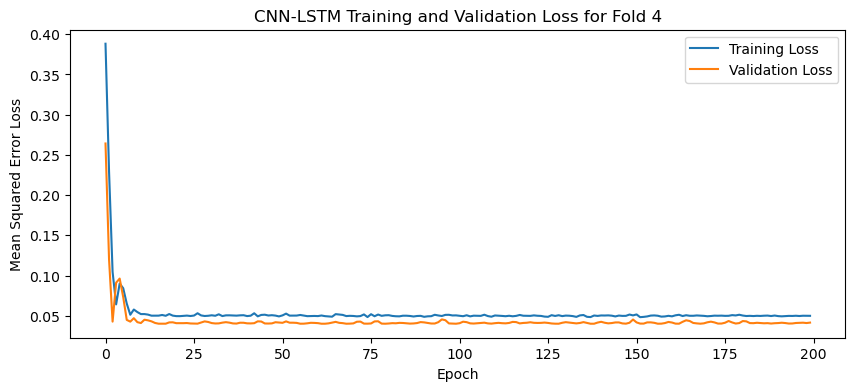

[I 2025-05-06 13:26:14,206] Trial 21 finished with value: 0.04081243500113487 and parameters: {'lr': 0.002084146445385111, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.20596763813630156}. Best is trial 11 with value: 0.040387491881847384.


84
84
1


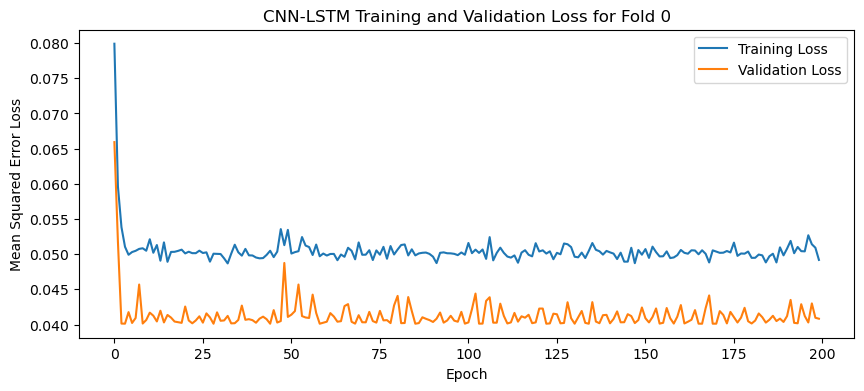

84
84
1


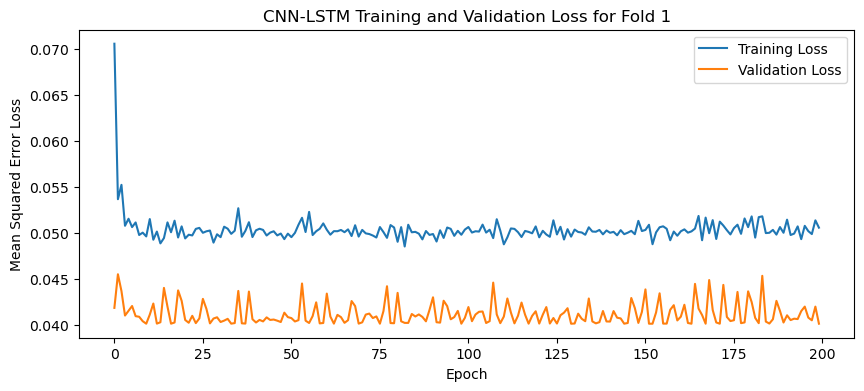

84
84
1


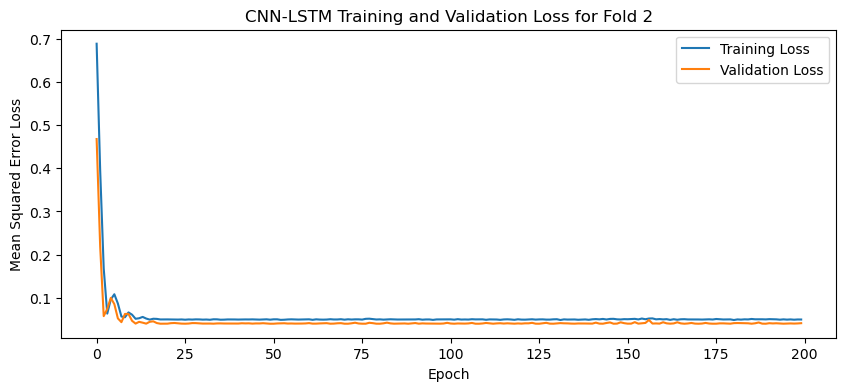

84
84
1


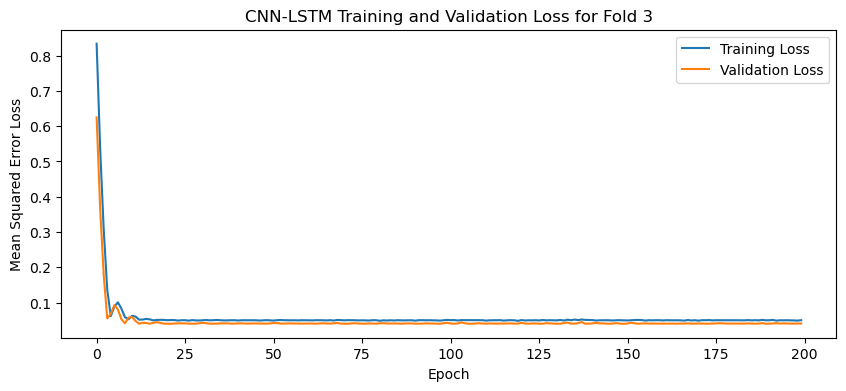

84
84
1


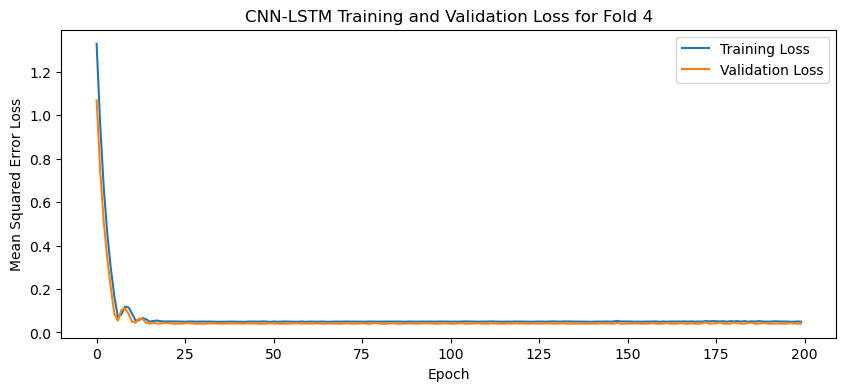

[I 2025-05-06 13:27:34,607] Trial 22 finished with value: 0.04082181677222252 and parameters: {'lr': 0.0033615655002405763, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.10350094134457982}. Best is trial 11 with value: 0.040387491881847384.


84
84
1


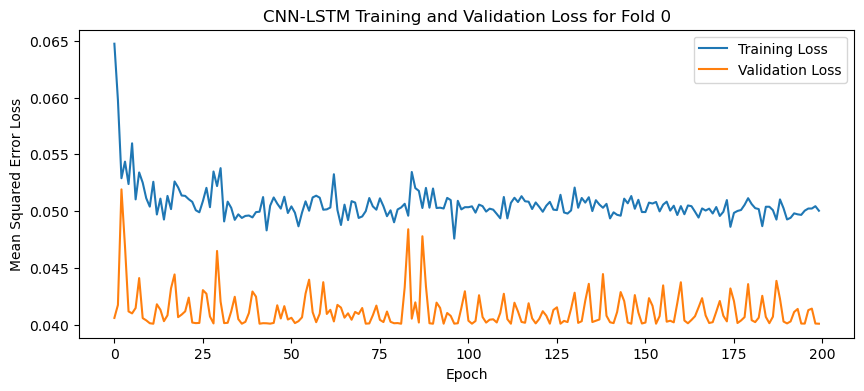

84
84
1


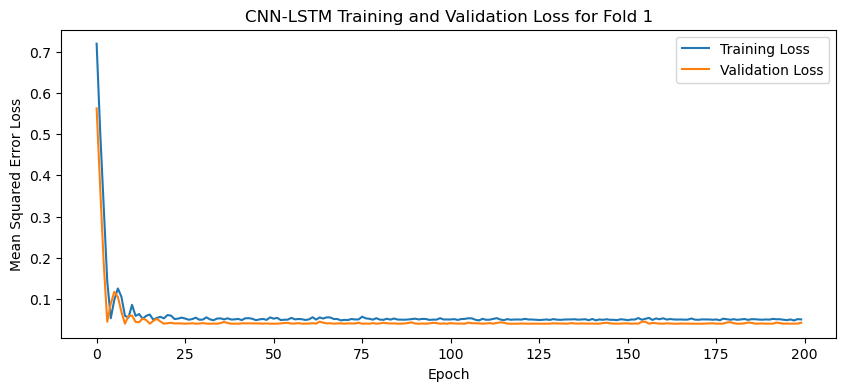

84
84
1


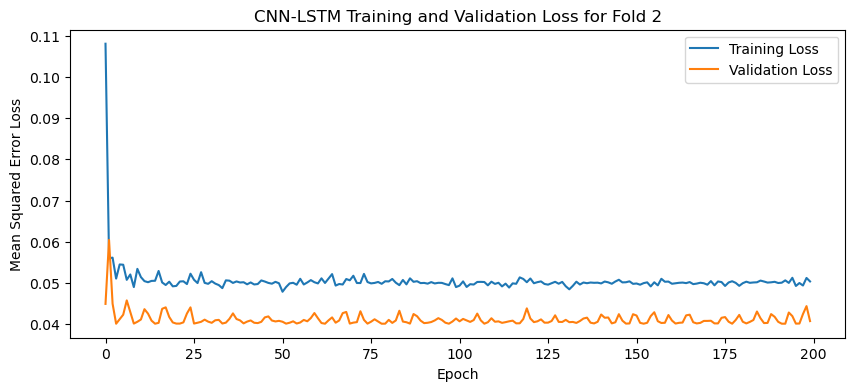

84
84
1


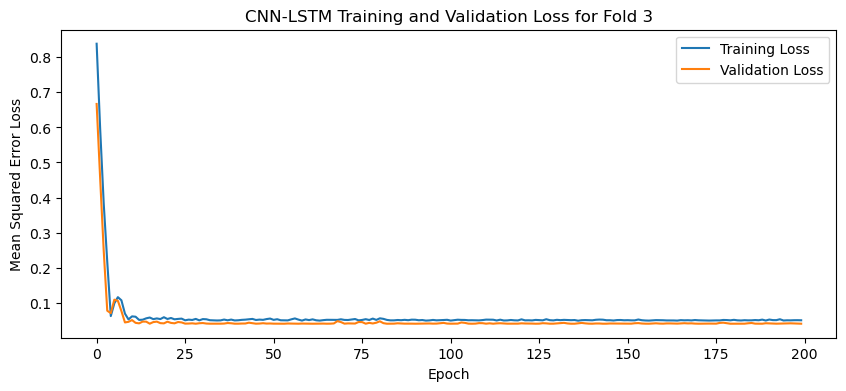

84
84
1


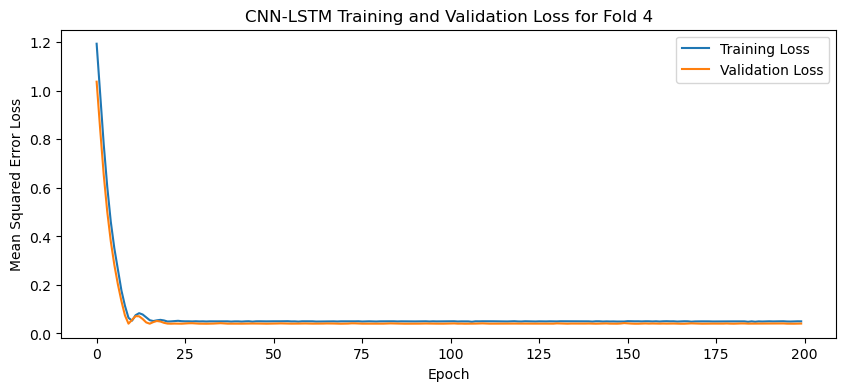

[I 2025-05-06 13:28:55,117] Trial 23 finished with value: 0.04085404872894287 and parameters: {'lr': 0.0016638003764634284, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.1694169546194441}. Best is trial 11 with value: 0.040387491881847384.


84
84
1


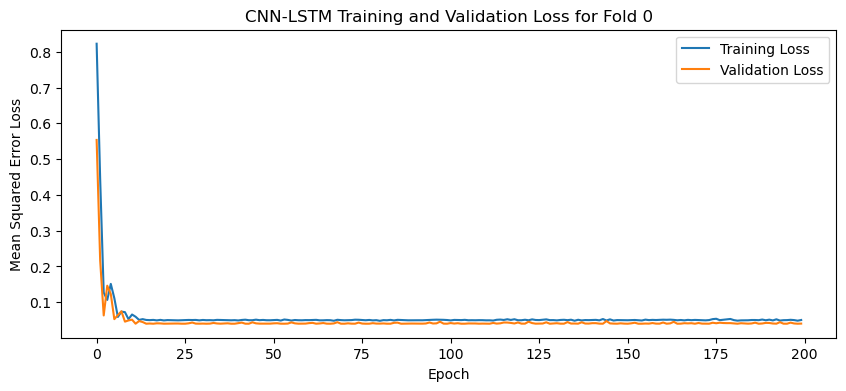

84
84
1


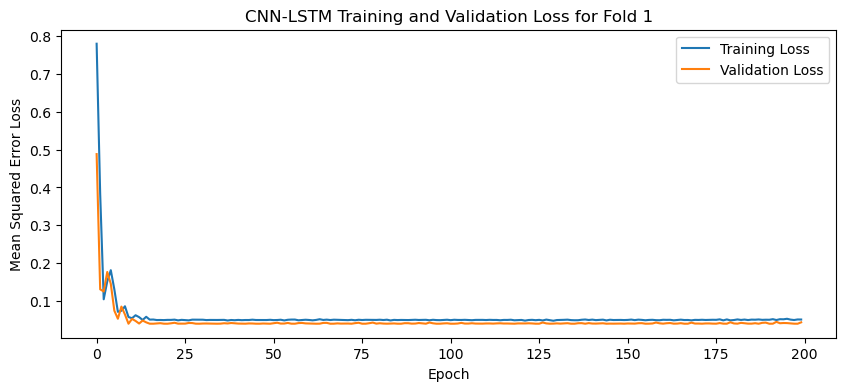

84
84
1


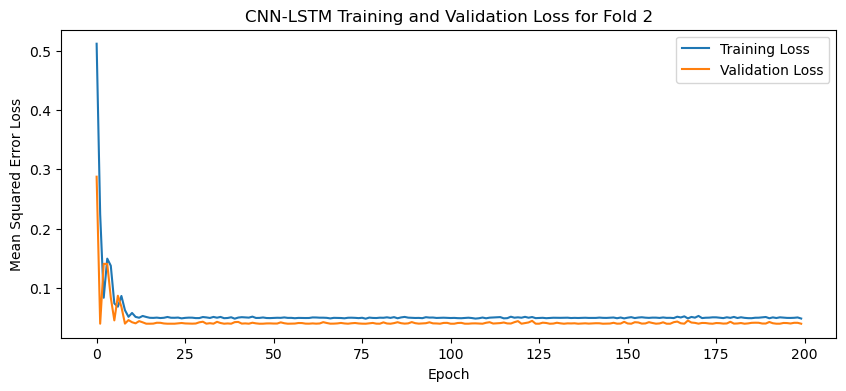

84
84
1


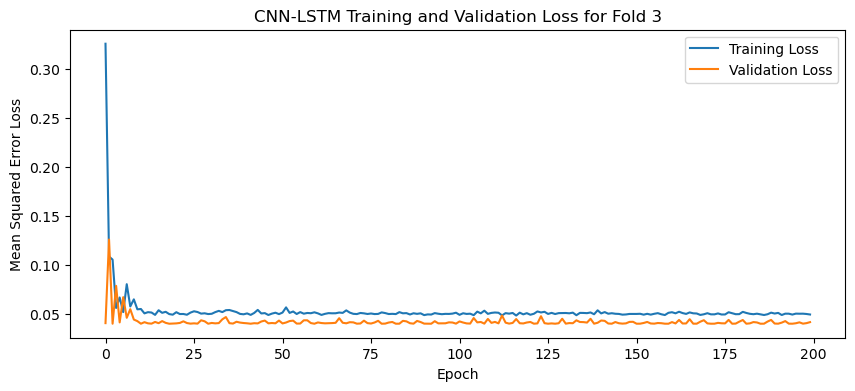

84
84
1


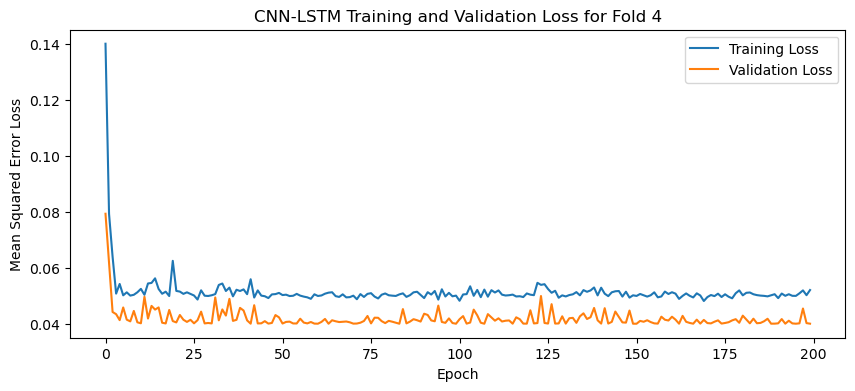

[I 2025-05-06 13:30:15,452] Trial 24 finished with value: 0.04124929830431938 and parameters: {'lr': 0.004077362558036364, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.1559606582247144}. Best is trial 11 with value: 0.040387491881847384.


84
84
1


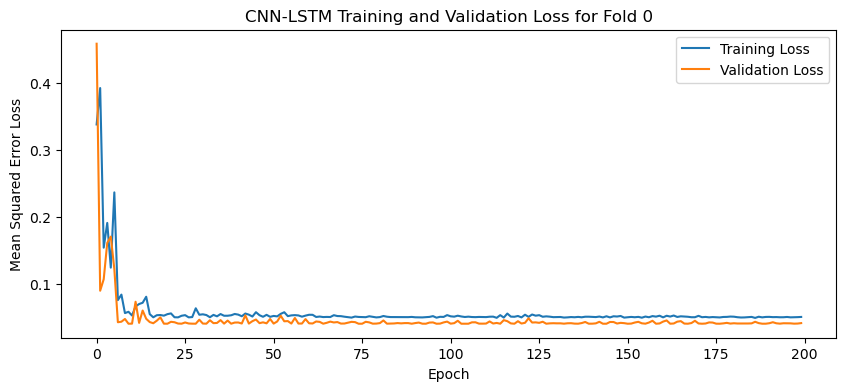

84
84
1


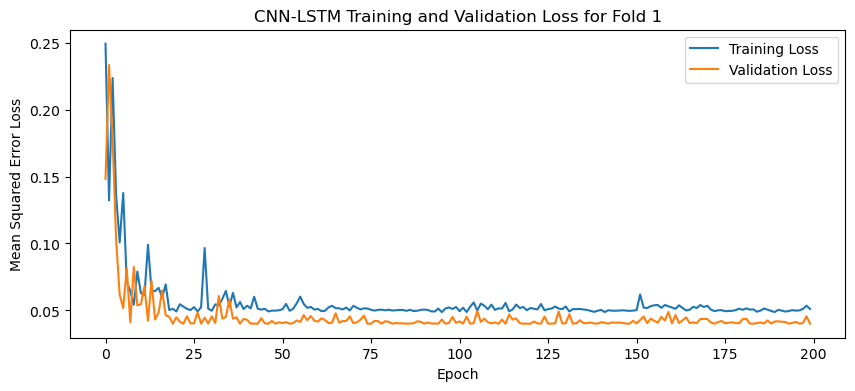

84
84
1


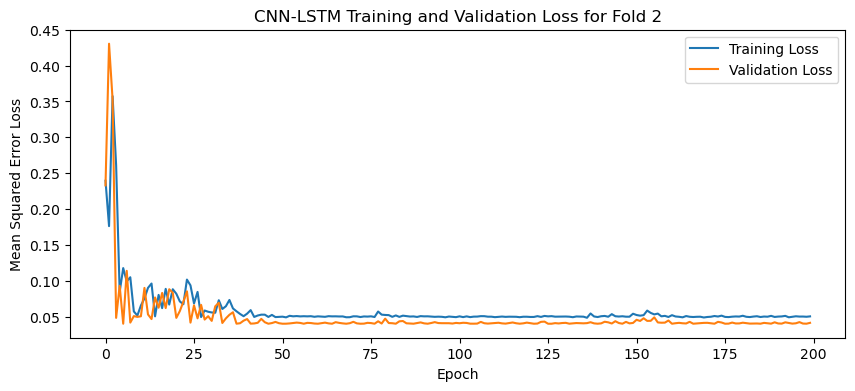

84
84
1


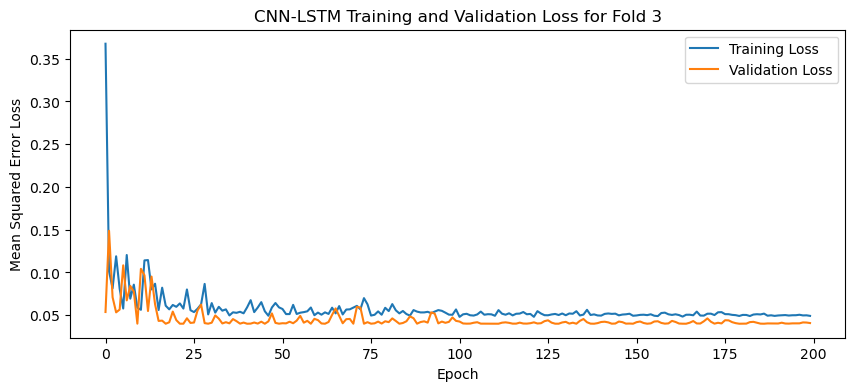

84
84
1


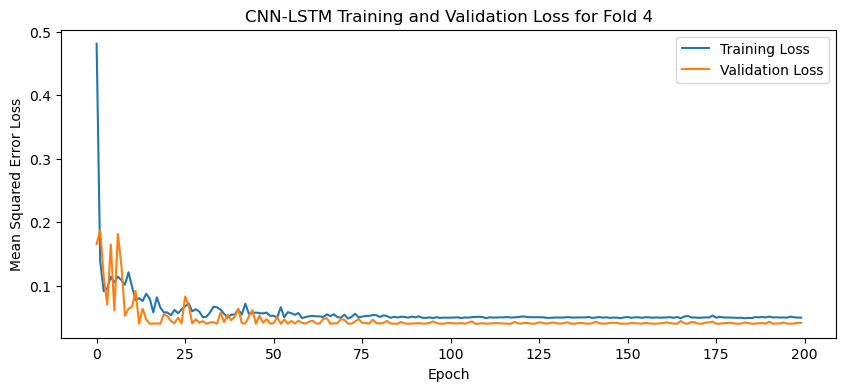

[I 2025-05-06 13:31:35,692] Trial 25 finished with value: 0.040974713116884234 and parameters: {'lr': 0.012706343250084457, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 128, 'dropout_rate': 0.2019411722812834}. Best is trial 11 with value: 0.040387491881847384.


84
84
1


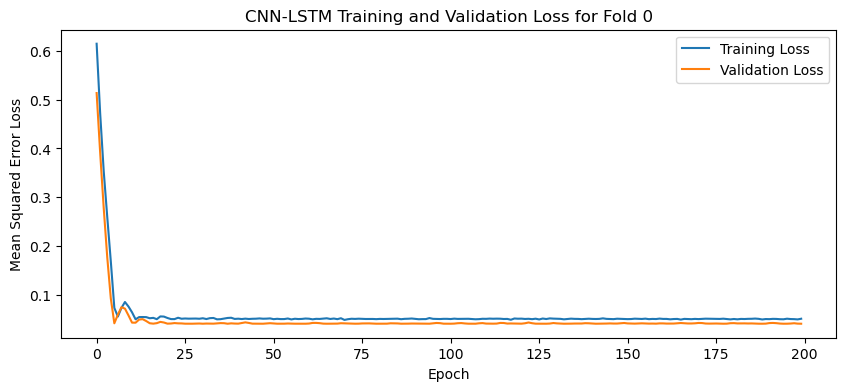

84
84
1


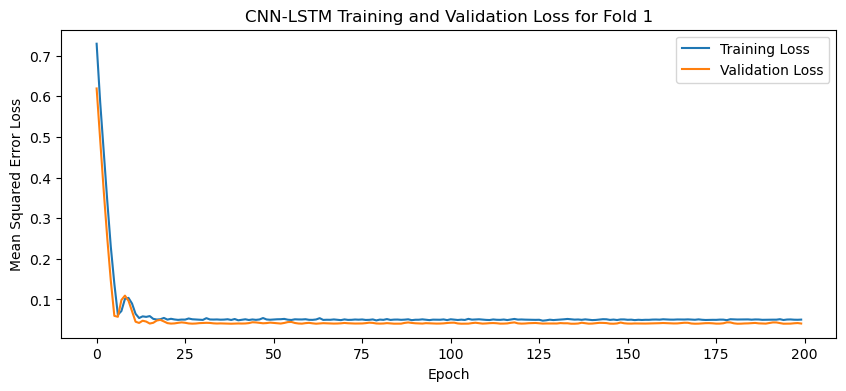

84
84
1


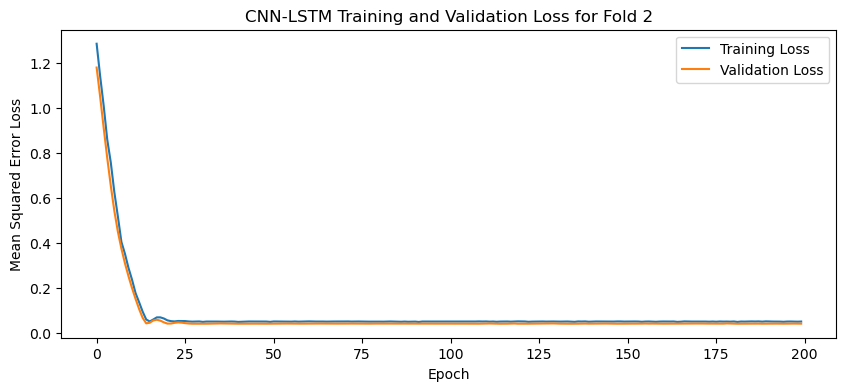

84
84
1


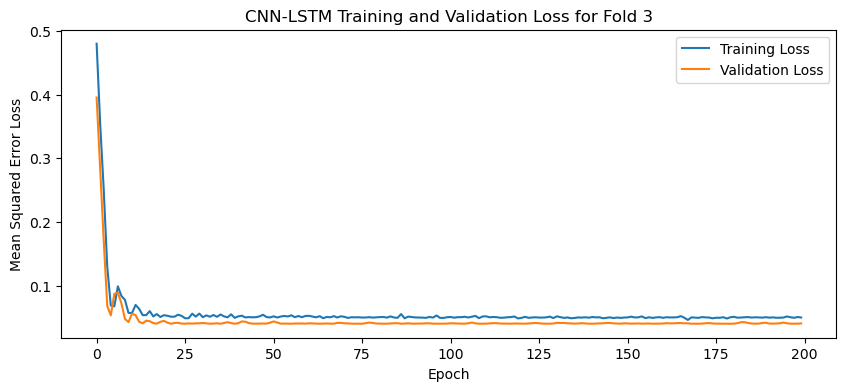

84
84
1


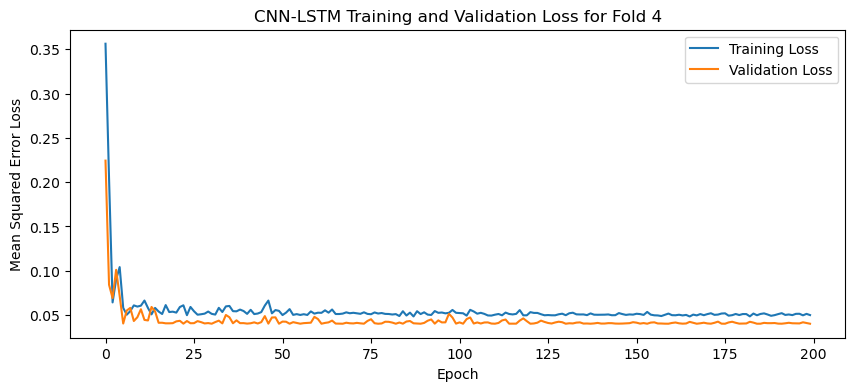

[I 2025-05-06 13:32:57,208] Trial 26 finished with value: 0.0403713583946228 and parameters: {'lr': 0.001478296188101363, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.26470687752828986}. Best is trial 26 with value: 0.0403713583946228.


84
84
1


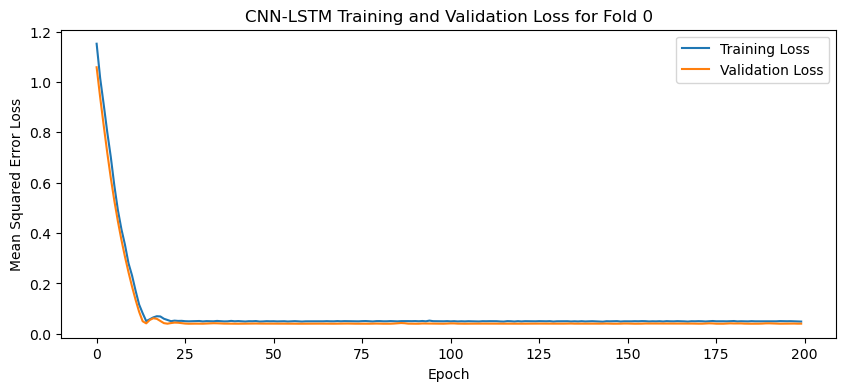

84
84
1


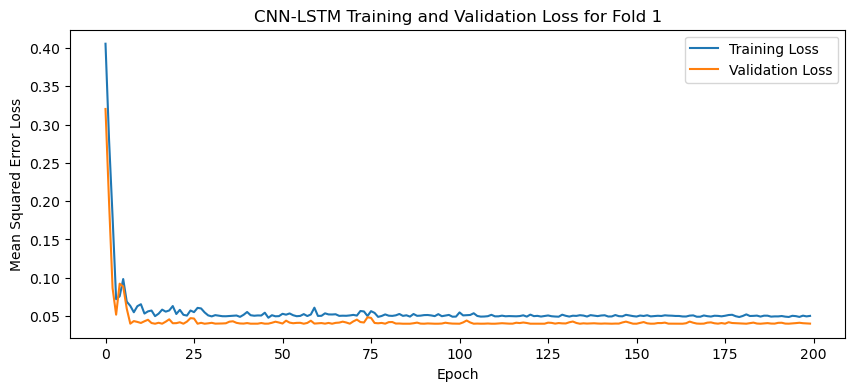

84
84
1


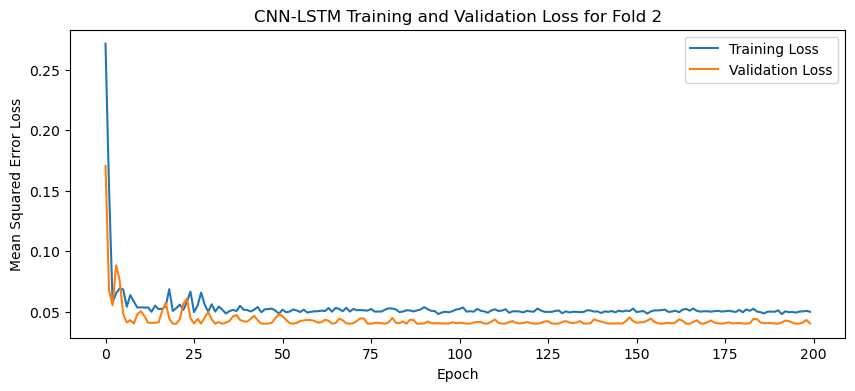

84
84
1


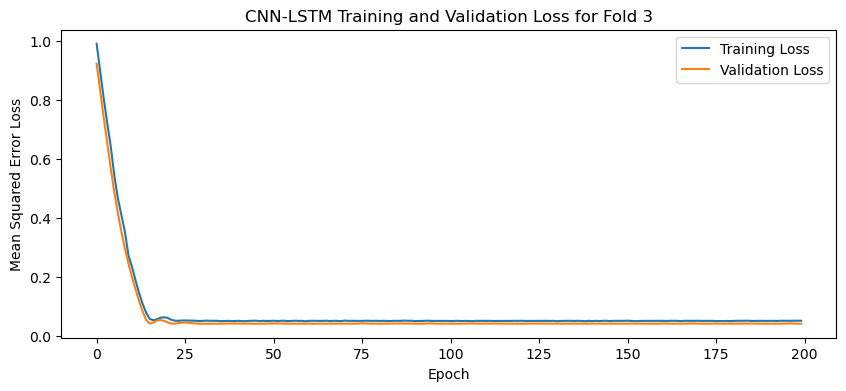

84
84
1


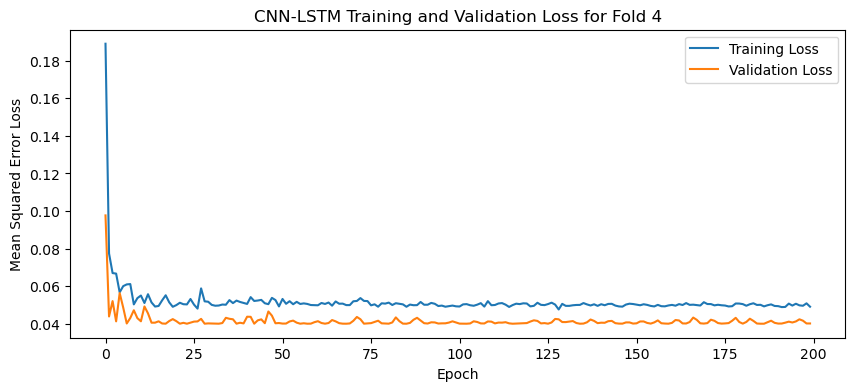

[I 2025-05-06 13:34:17,783] Trial 27 finished with value: 0.04027204588055611 and parameters: {'lr': 0.0015009658645577853, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.352363791134533}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


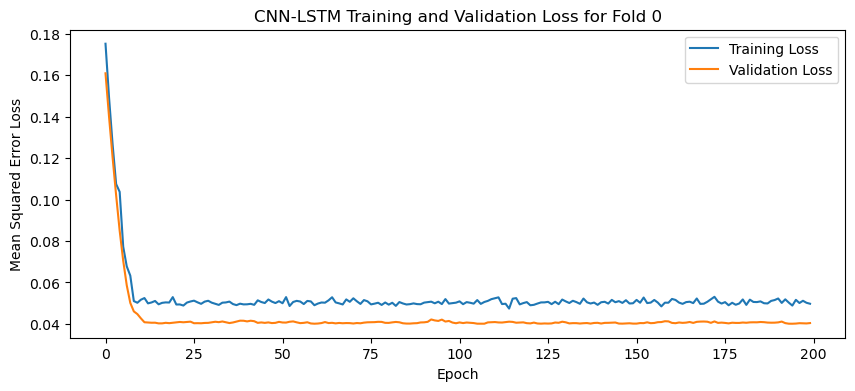

84
84
1


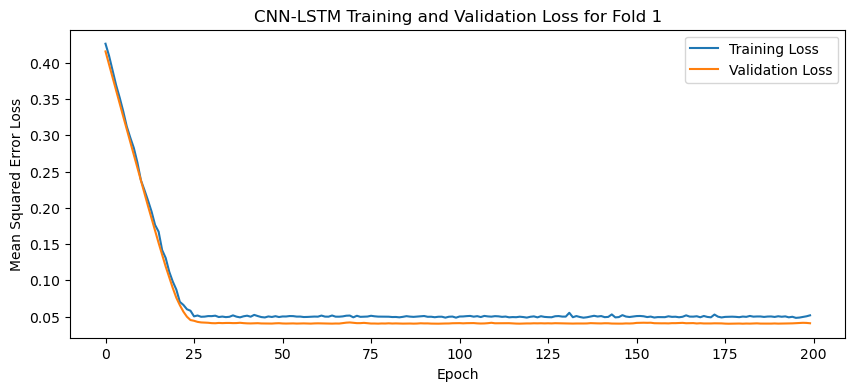

84
84
1


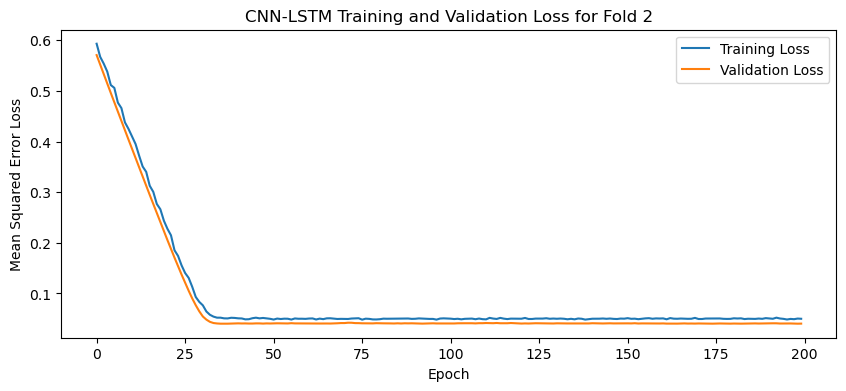

84
84
1


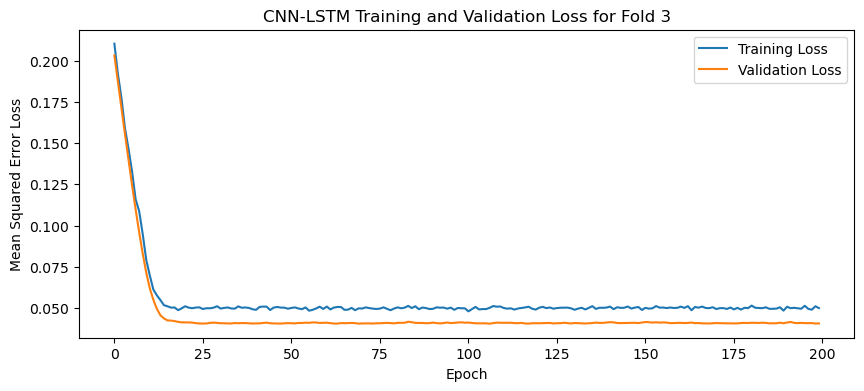

84
84
1


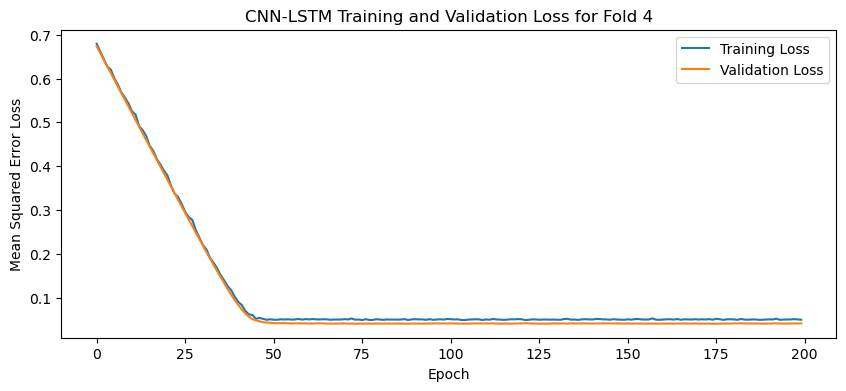

[I 2025-05-06 13:35:29,759] Trial 28 finished with value: 0.04060085713863373 and parameters: {'lr': 0.001623171454738516, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 64, 'dropout_rate': 0.3692356685447898}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


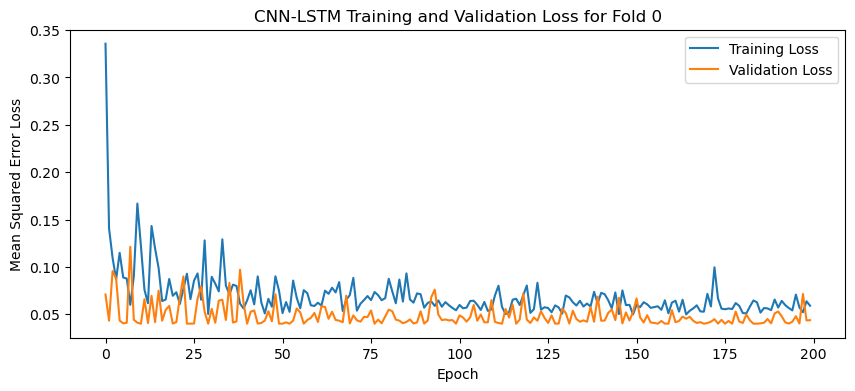

84
84
1


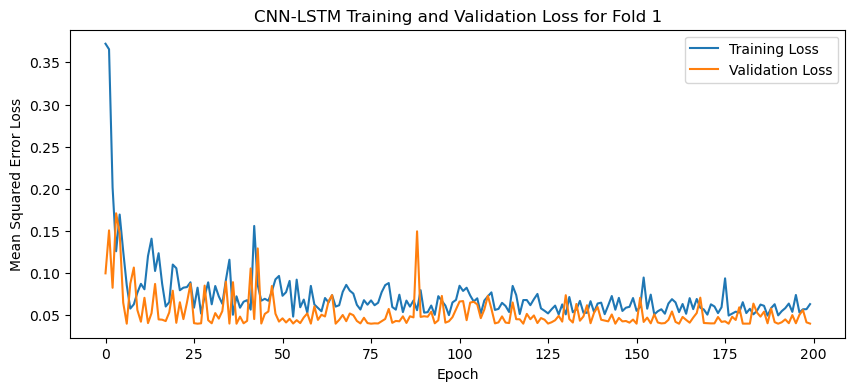

84
84
1


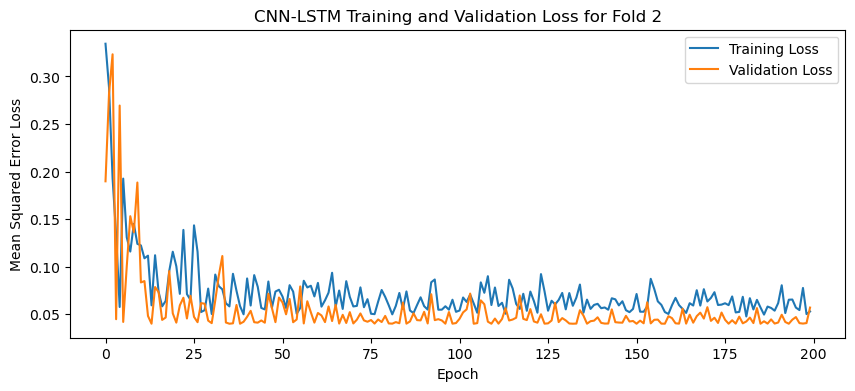

84
84
1


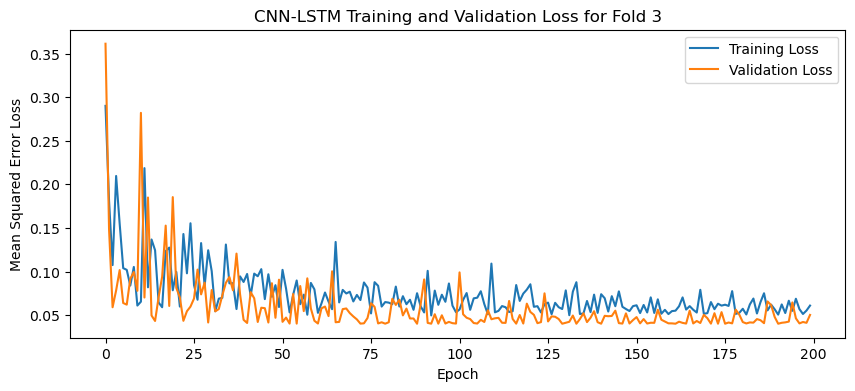

84
84
1


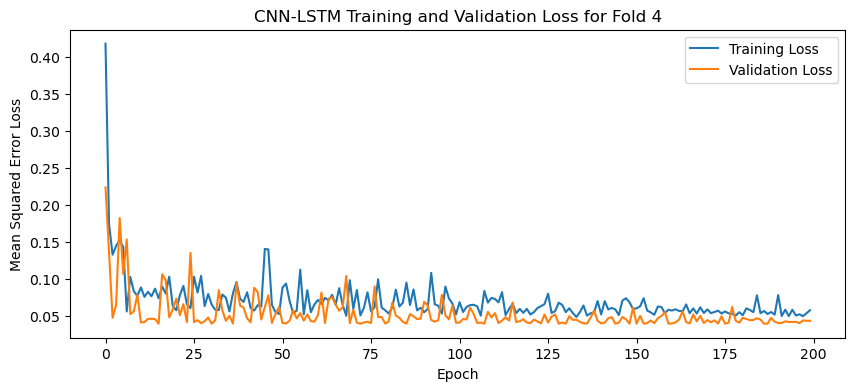

[I 2025-05-06 13:37:20,283] Trial 29 finished with value: 0.04708120599389076 and parameters: {'lr': 0.0011926922844793107, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4194125241906328}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


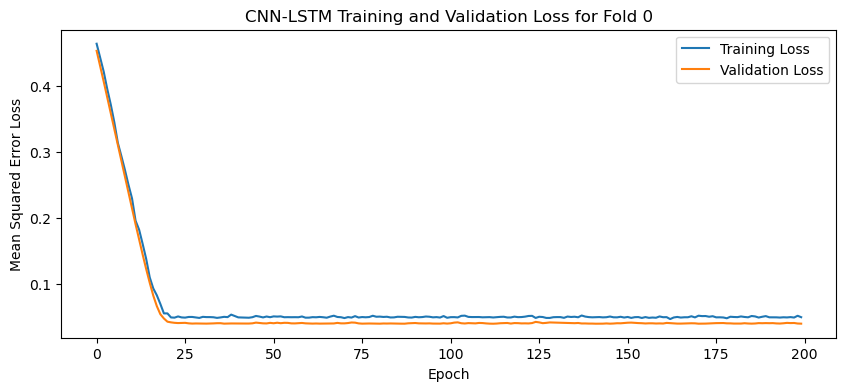

84
84
1


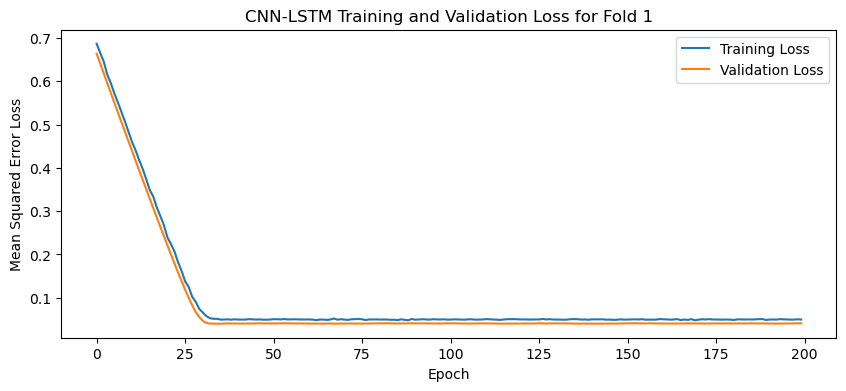

84
84
1


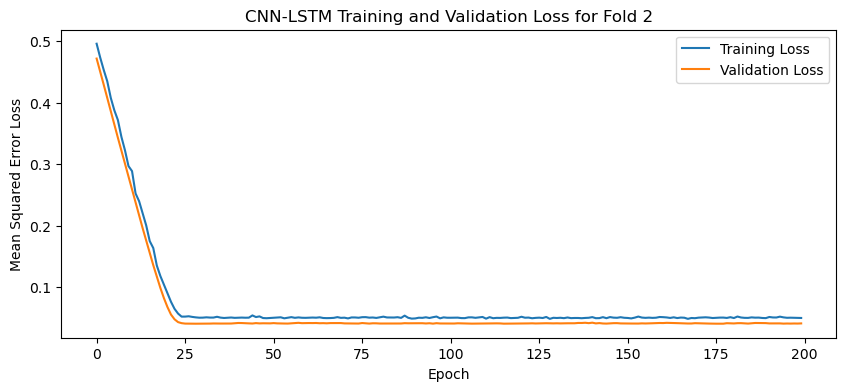

84
84
1


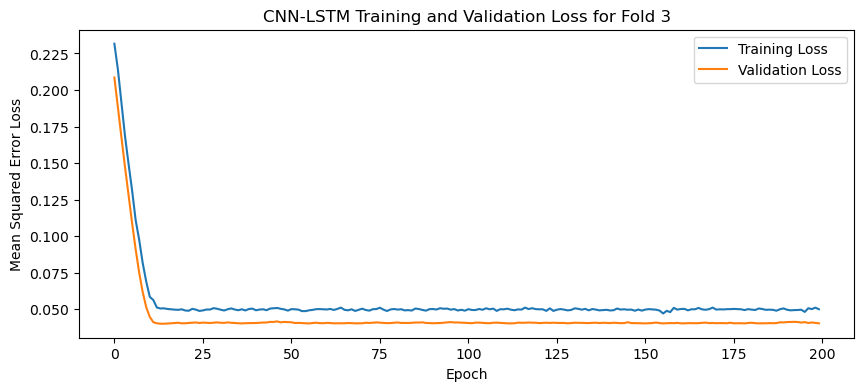

84
84
1


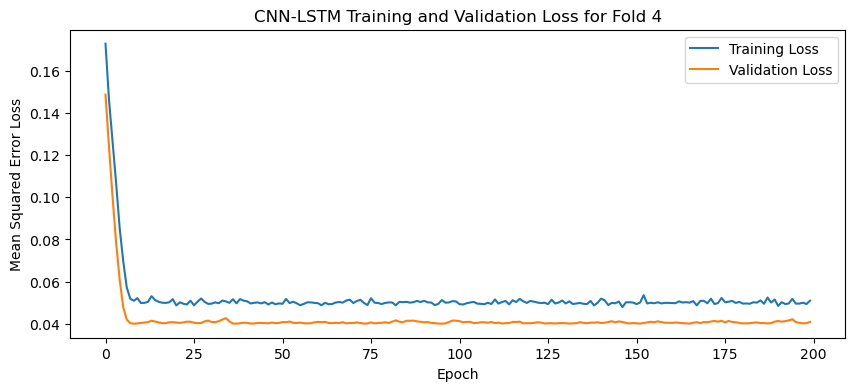

[I 2025-05-06 13:38:43,757] Trial 30 finished with value: 0.04065706059336662 and parameters: {'lr': 0.0020593709247654014, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3187721154209965}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


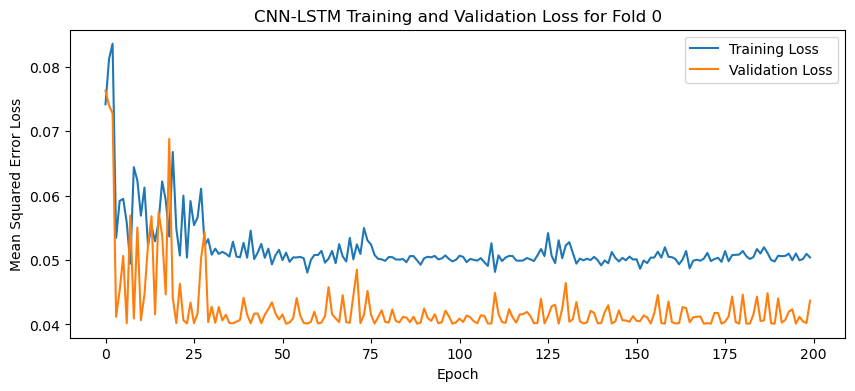

84
84
1


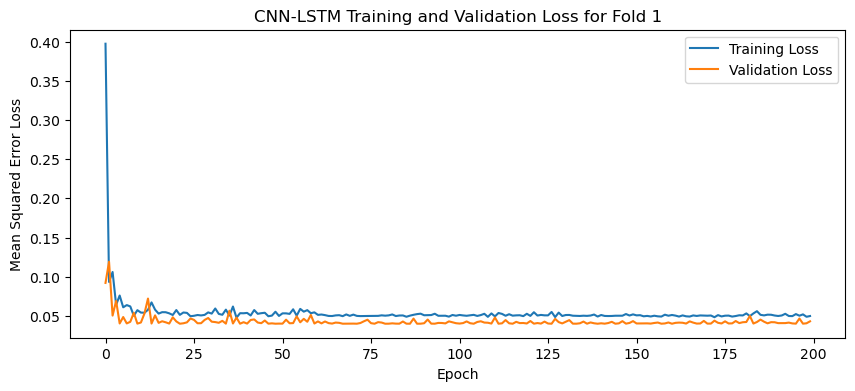

84
84
1


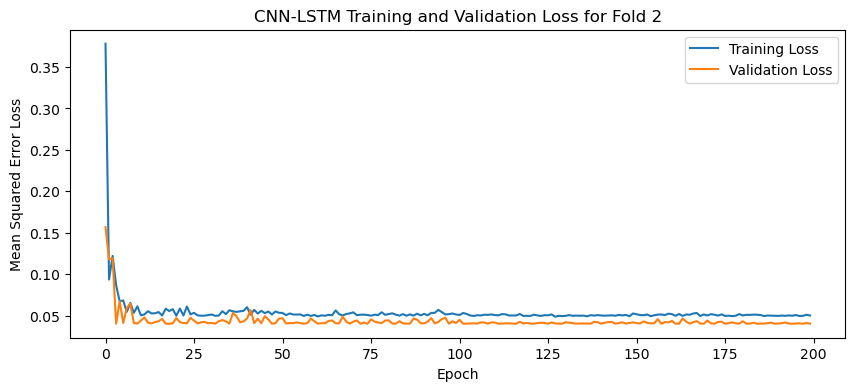

84
84
1


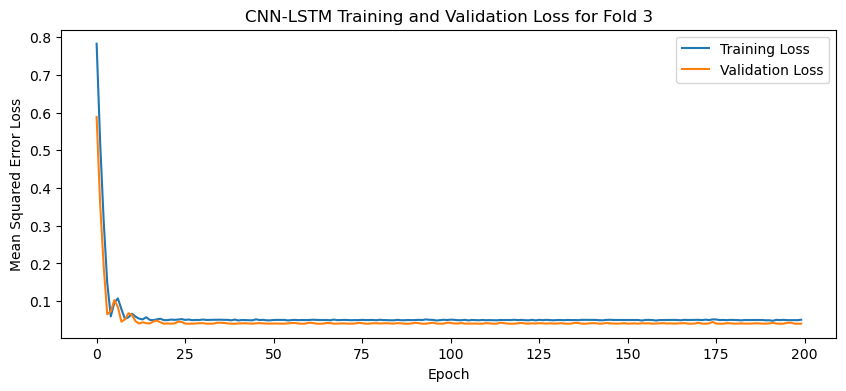

84
84
1


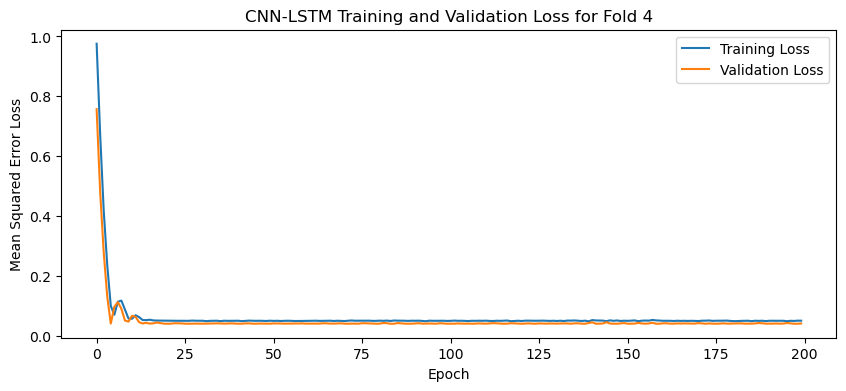

[I 2025-05-06 13:40:04,282] Trial 31 finished with value: 0.04166401252150535 and parameters: {'lr': 0.004776115871026269, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.3461991009288696}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


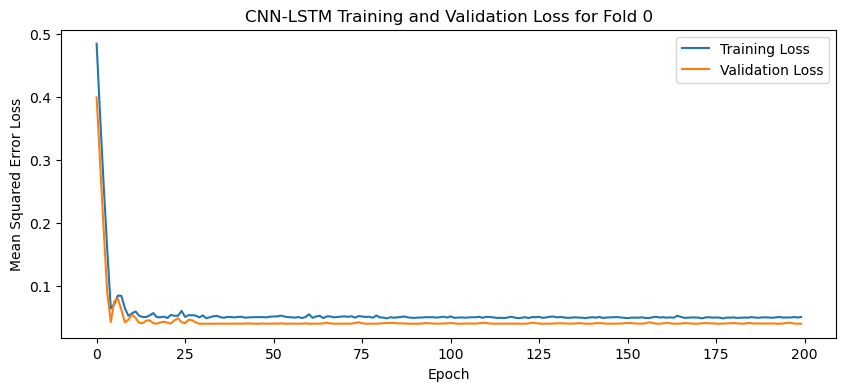

84
84
1


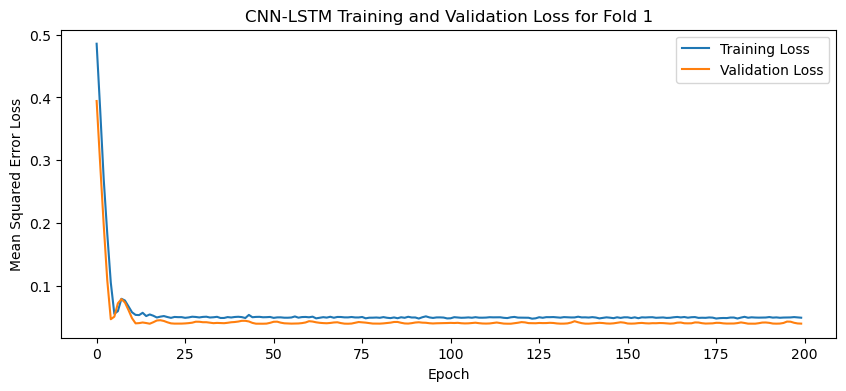

84
84
1


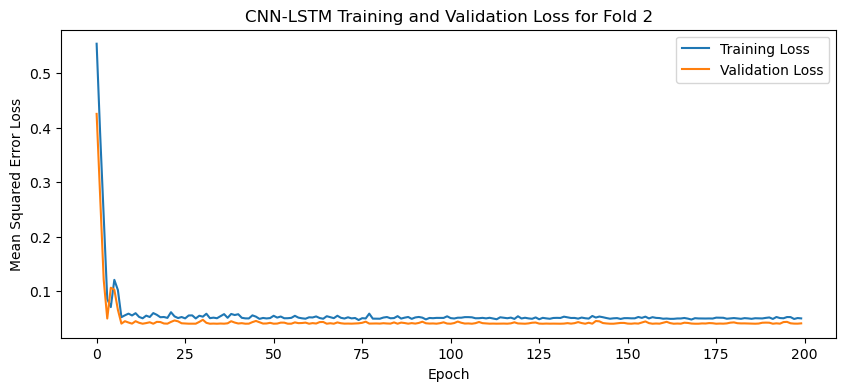

84
84
1


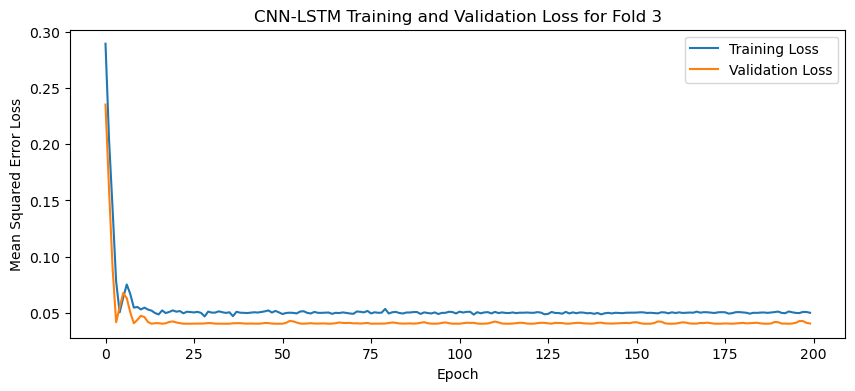

84
84
1


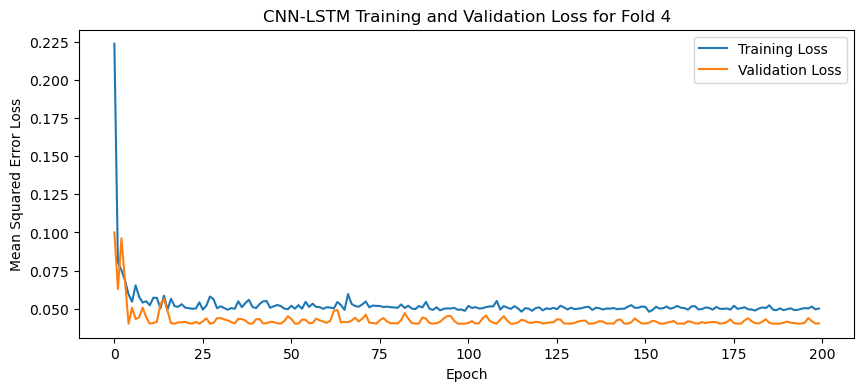

[I 2025-05-06 13:41:24,912] Trial 32 finished with value: 0.04037051275372505 and parameters: {'lr': 0.001488265505620209, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.26920103600783435}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


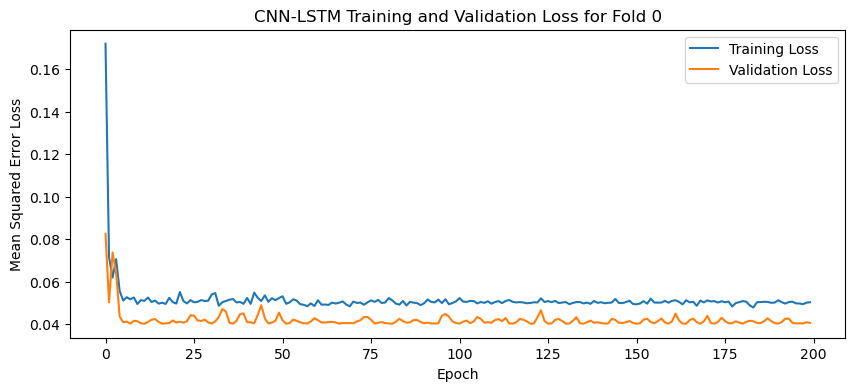

84
84
1


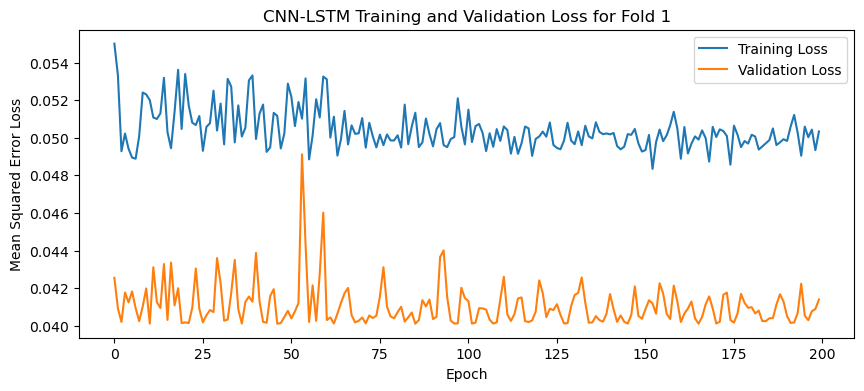

84
84
1


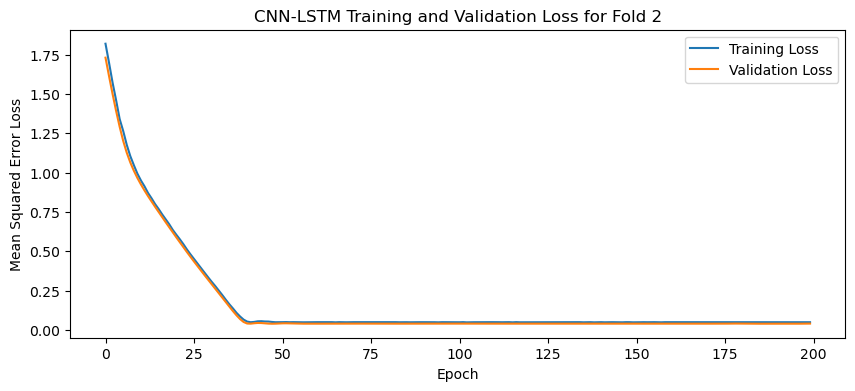

84
84
1


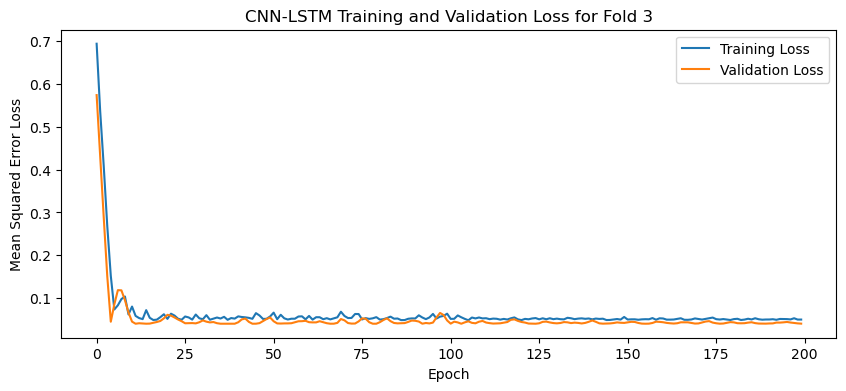

84
84
1


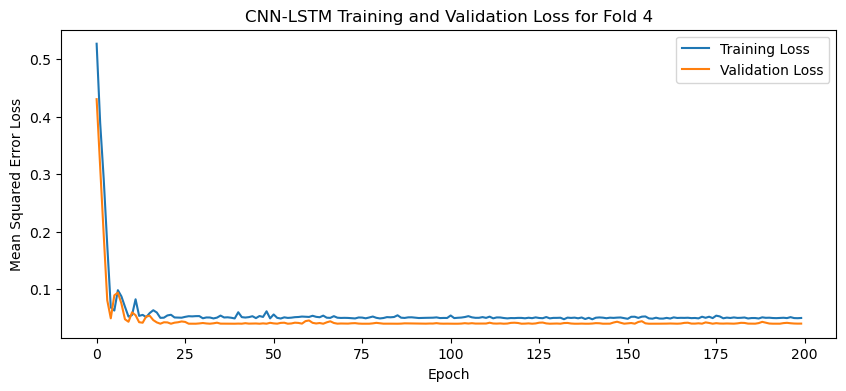

[I 2025-05-06 13:42:45,464] Trial 33 finished with value: 0.04070744290947914 and parameters: {'lr': 0.0012971930845259232, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.264210806339909}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


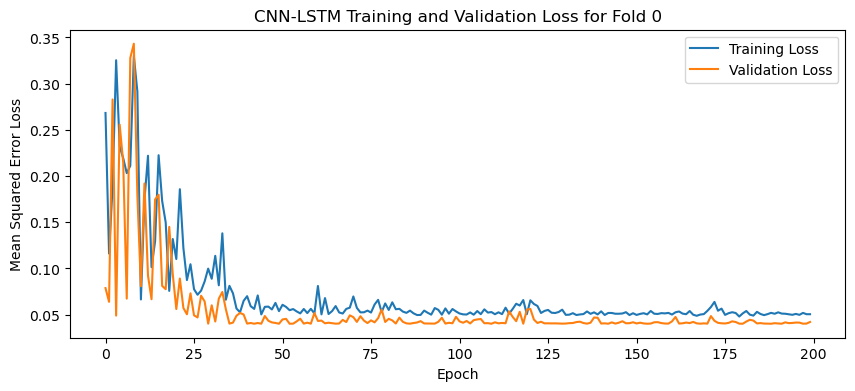

84
84
1


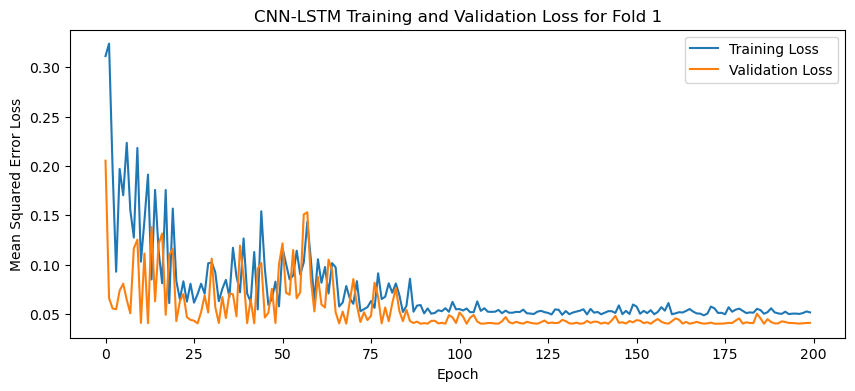

84
84
1


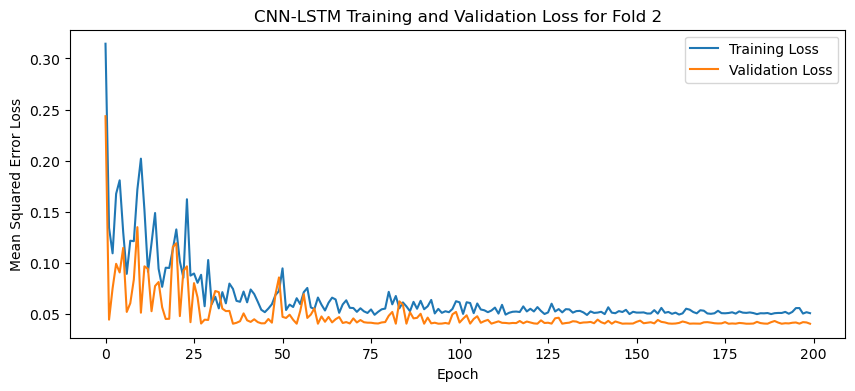

84
84
1


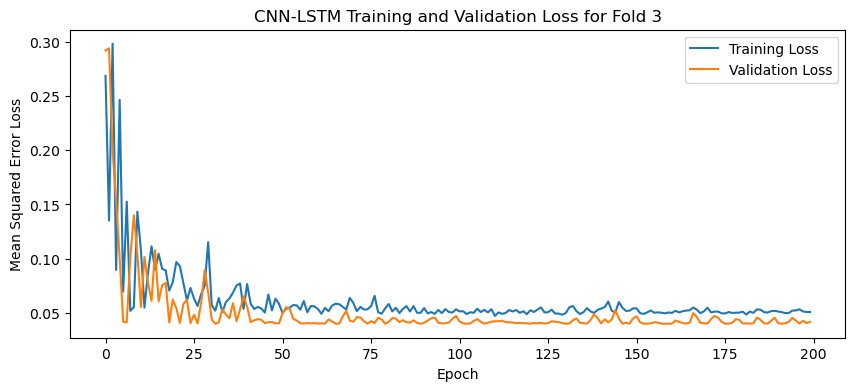

84
84
1


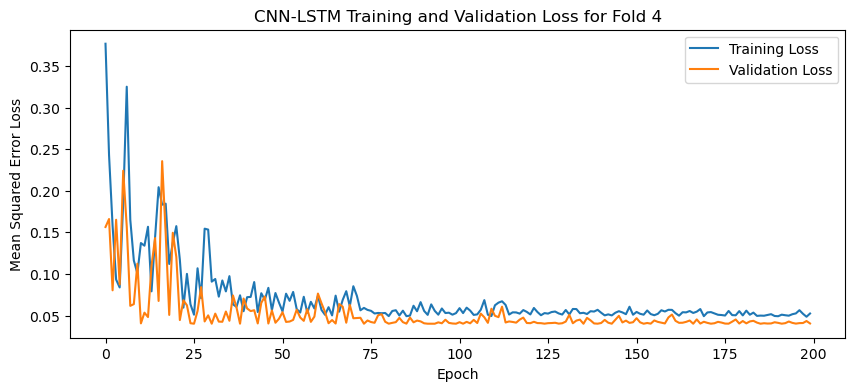

[I 2025-05-06 13:44:05,883] Trial 34 finished with value: 0.04105253592133522 and parameters: {'lr': 0.001847504258657377, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 128, 'dropout_rate': 0.274951834178675}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


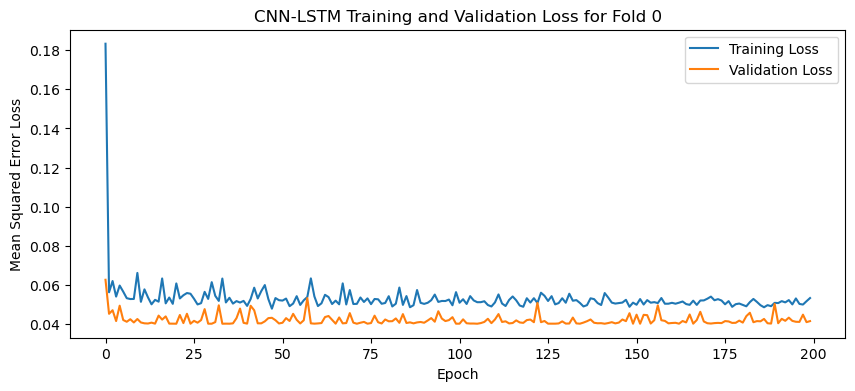

84
84
1


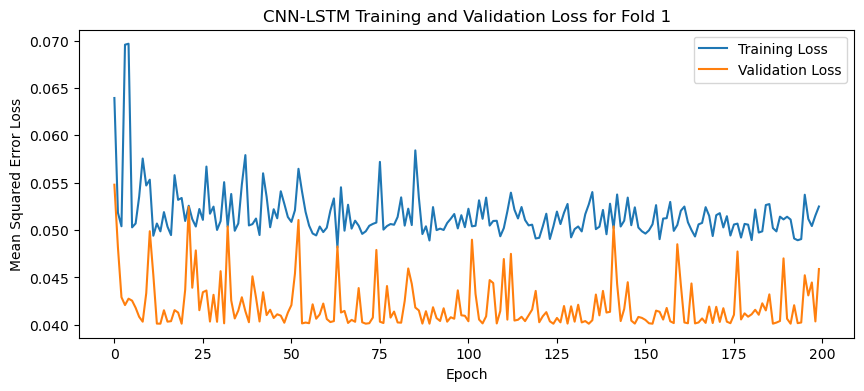

84
84
1


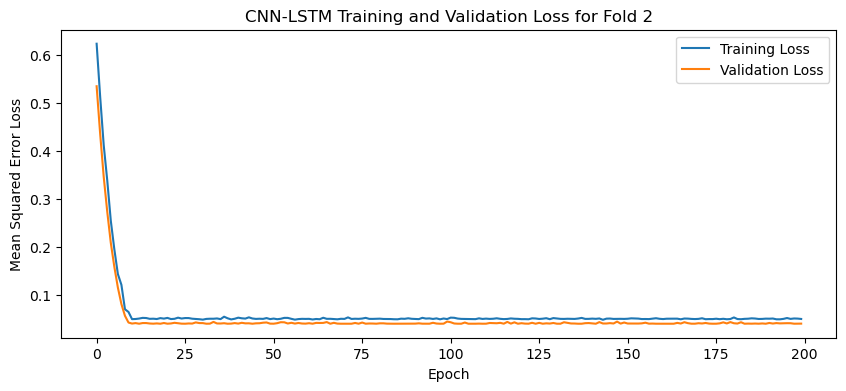

84
84
1


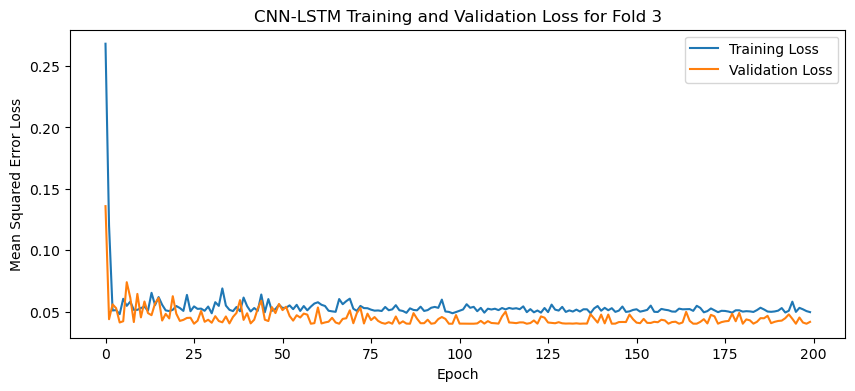

84
84
1


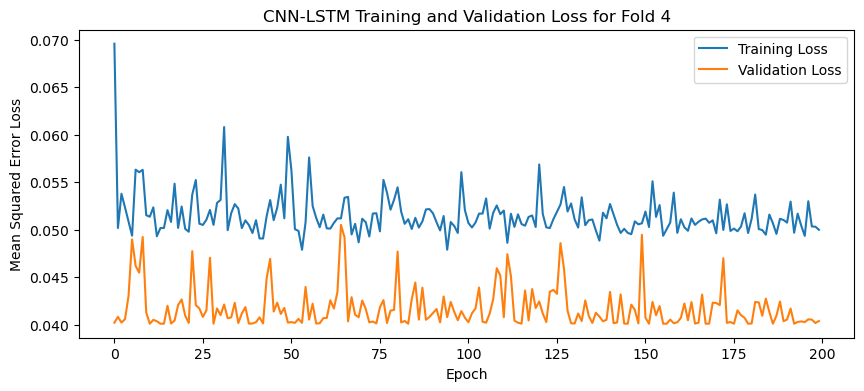

[I 2025-05-06 13:45:32,715] Trial 35 finished with value: 0.04193727970123291 and parameters: {'lr': 0.0010483249604810092, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.3957118814409763}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


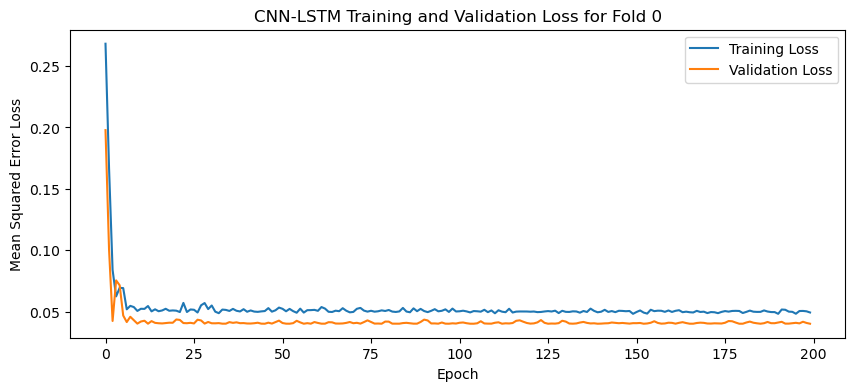

84
84
1


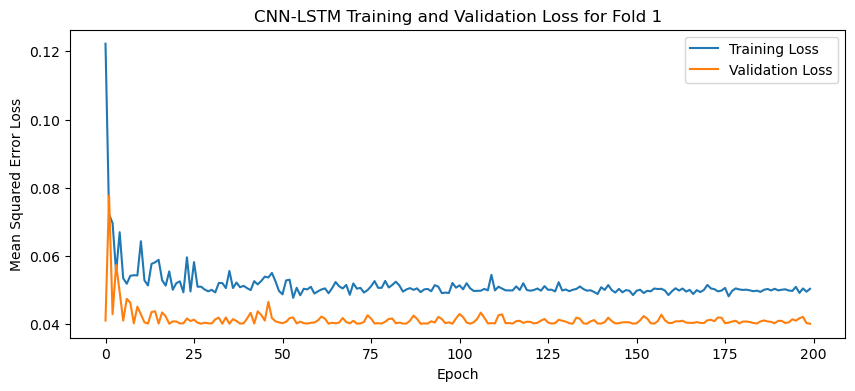

84
84
1


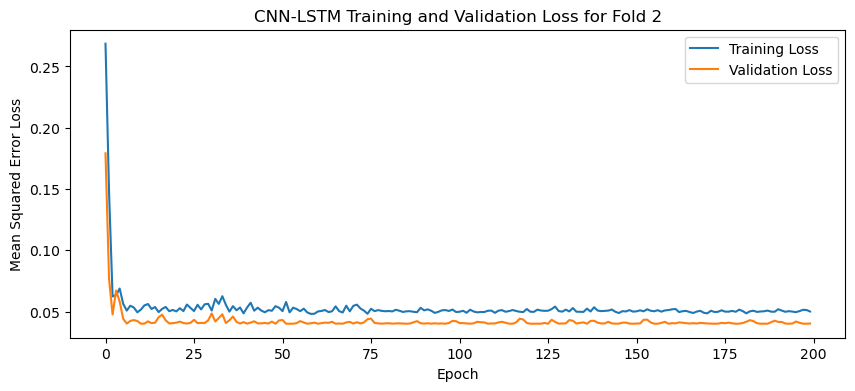

84
84
1


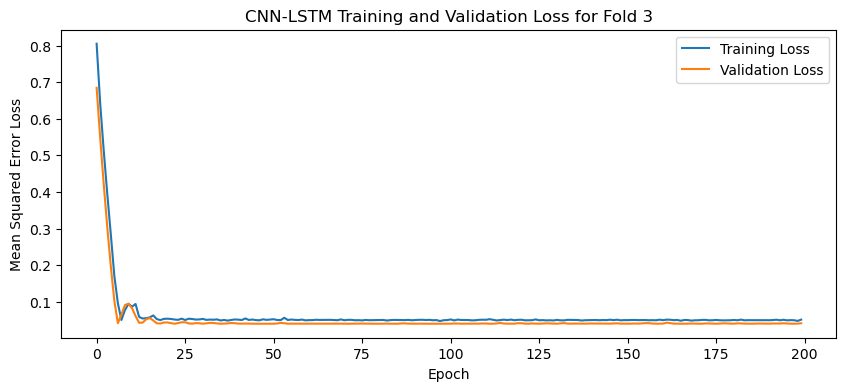

84
84
1


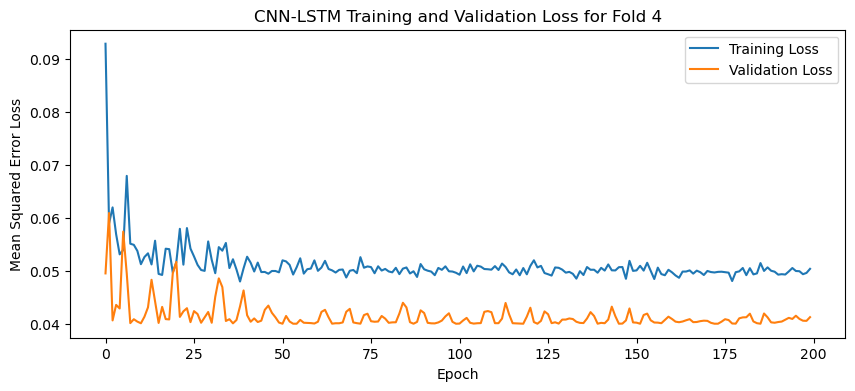

[I 2025-05-06 13:46:53,077] Trial 36 finished with value: 0.04065367877483368 and parameters: {'lr': 0.001442677314567662, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.31621278393004476}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


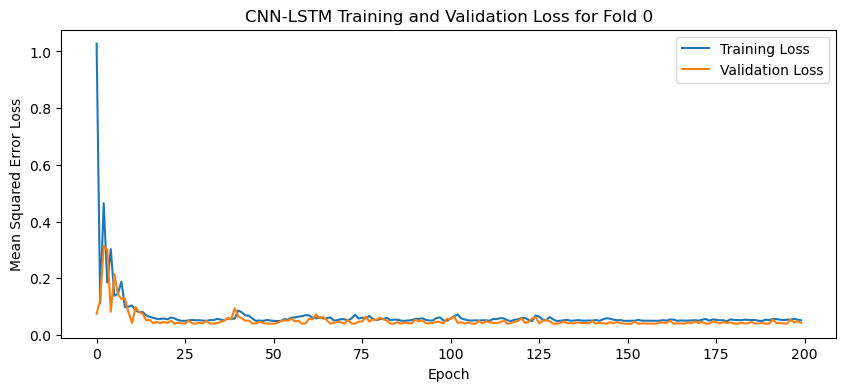

84
84
1


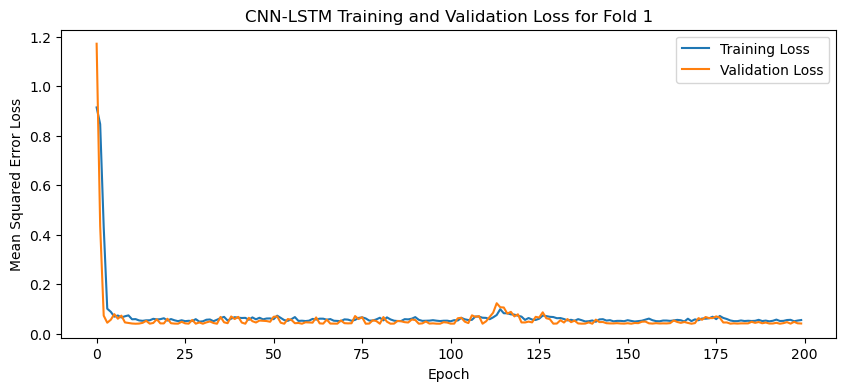

84
84
1


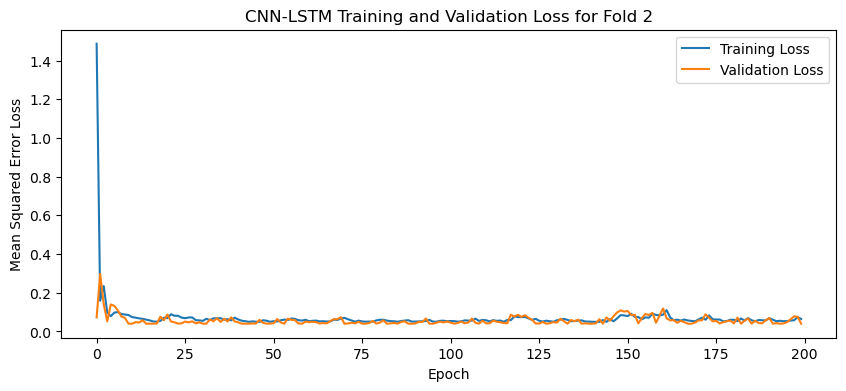

84
84
1


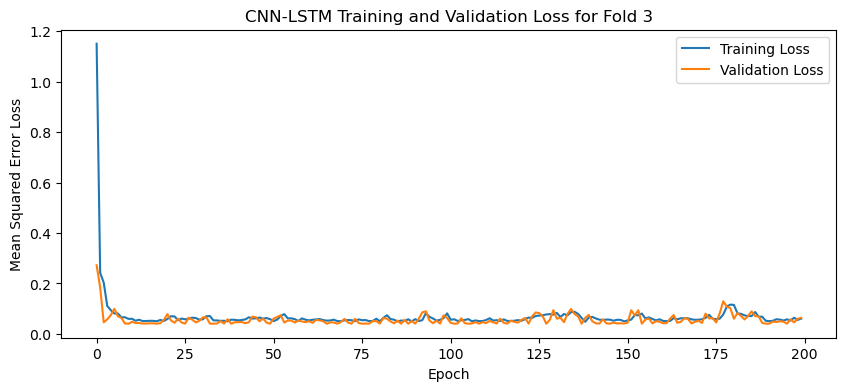

84
84
1


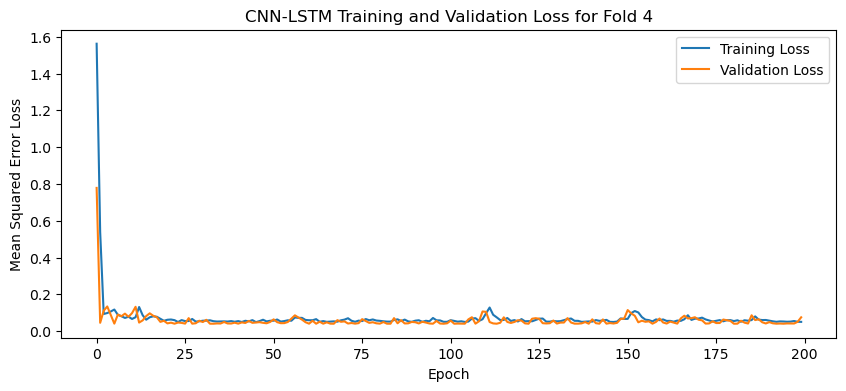

[I 2025-05-06 13:48:14,136] Trial 37 finished with value: 0.05247524529695511 and parameters: {'lr': 0.05880904617409828, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 128, 'dropout_rate': 0.3603406019012469}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


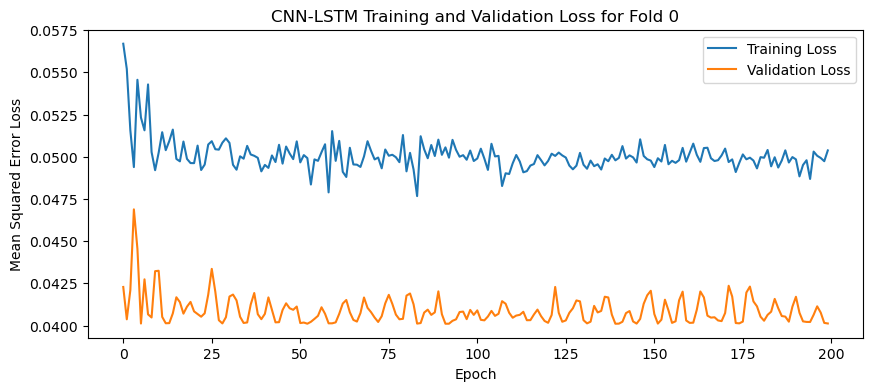

84
84
1


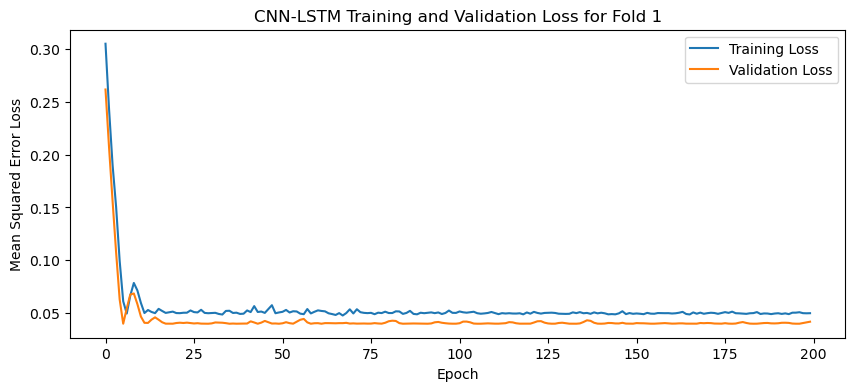

84
84
1


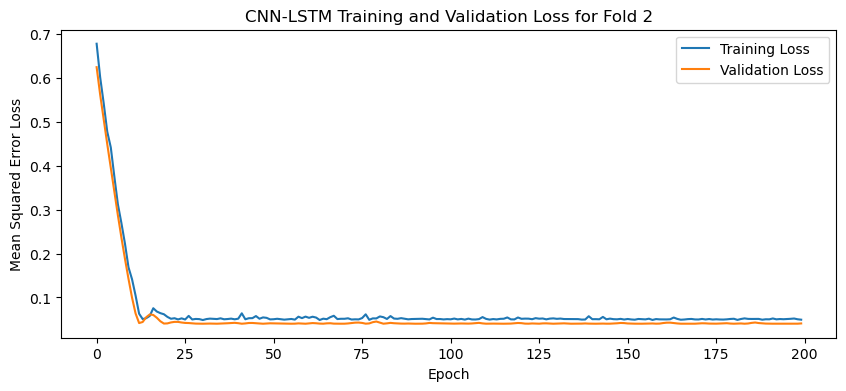

84
84
1


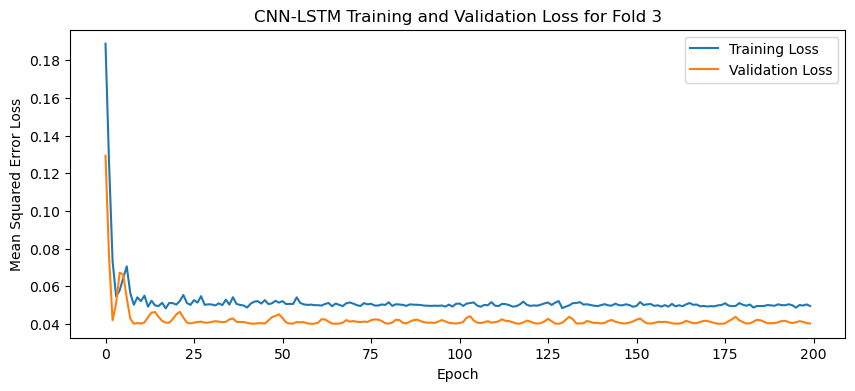

84
84
1


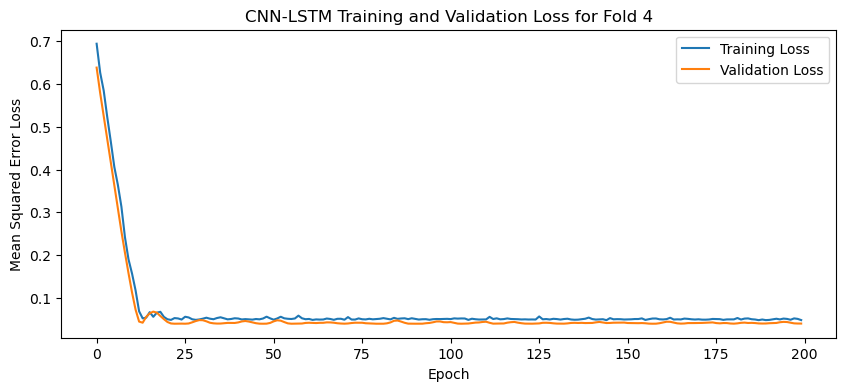

[I 2025-05-06 13:49:29,030] Trial 38 finished with value: 0.04073262810707092 and parameters: {'lr': 0.0010003398447176789, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 64, 'dropout_rate': 0.24364952007923937}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


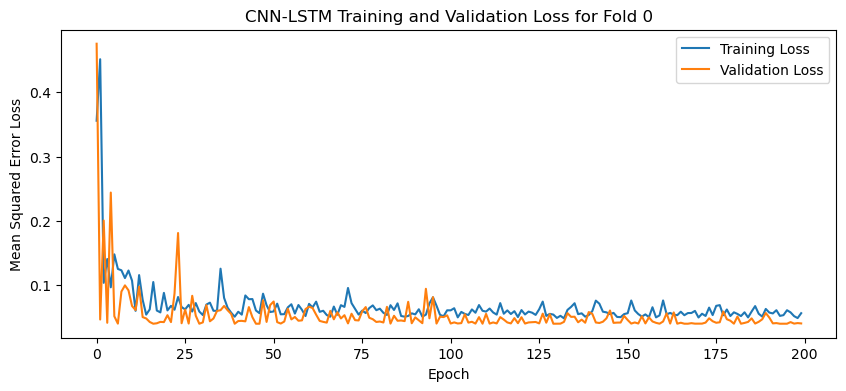

84
84
1


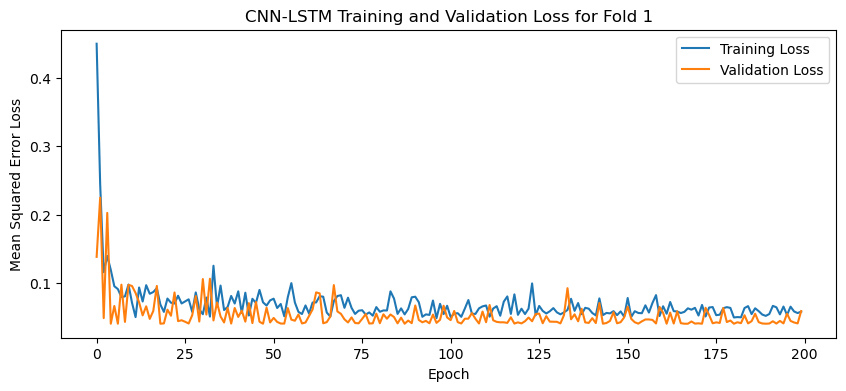

84
84
1


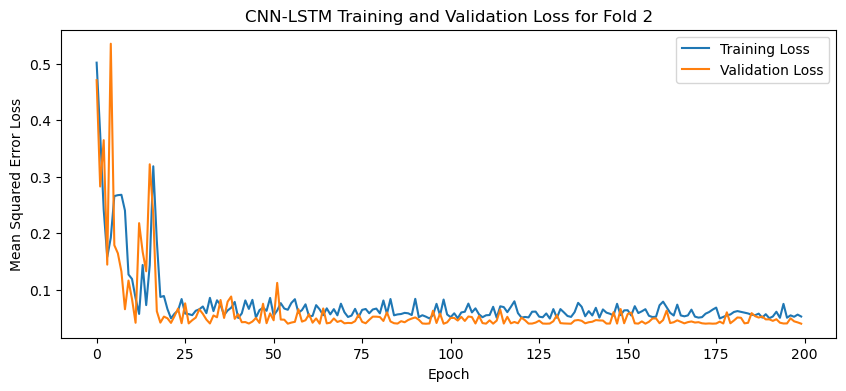

84
84
1


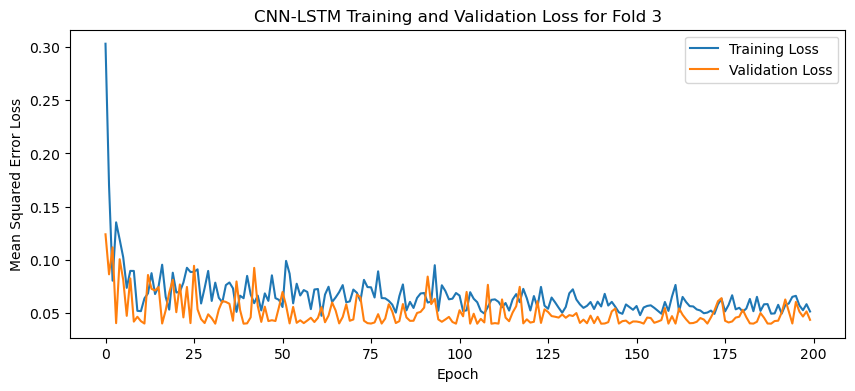

84
84
1


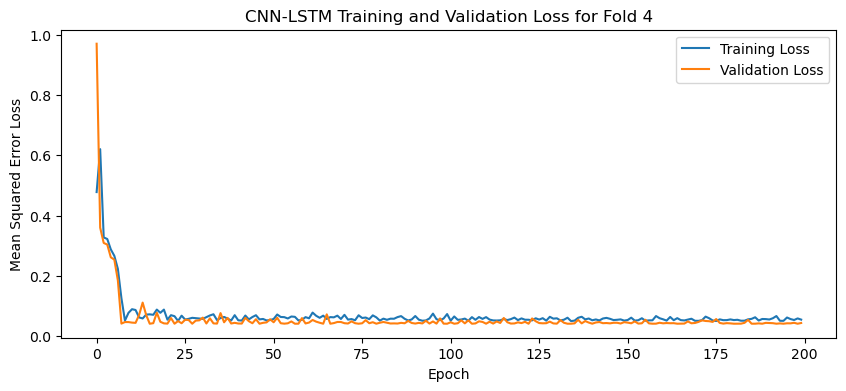

[I 2025-05-06 13:51:19,536] Trial 39 finished with value: 0.04513069316744804 and parameters: {'lr': 0.0023514998375389726, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3082532922928485}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


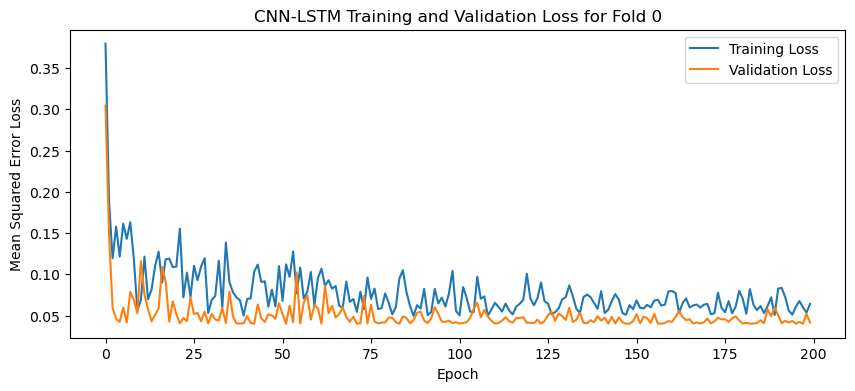

84
84
1


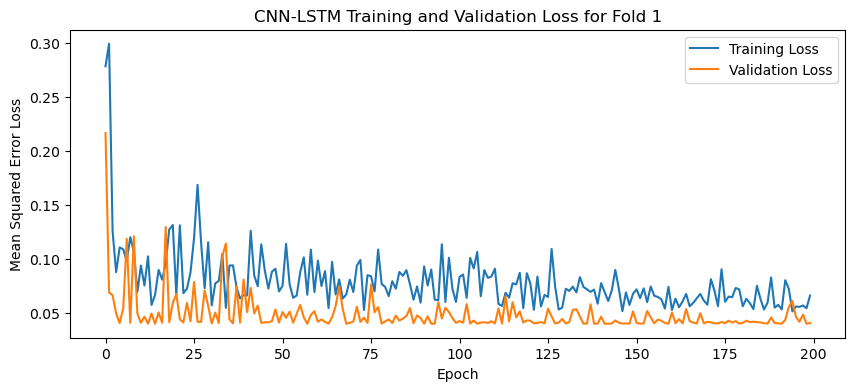

84
84
1


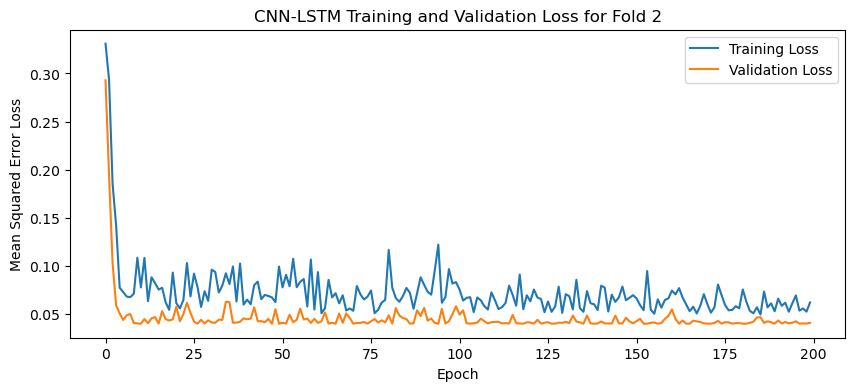

84
84
1


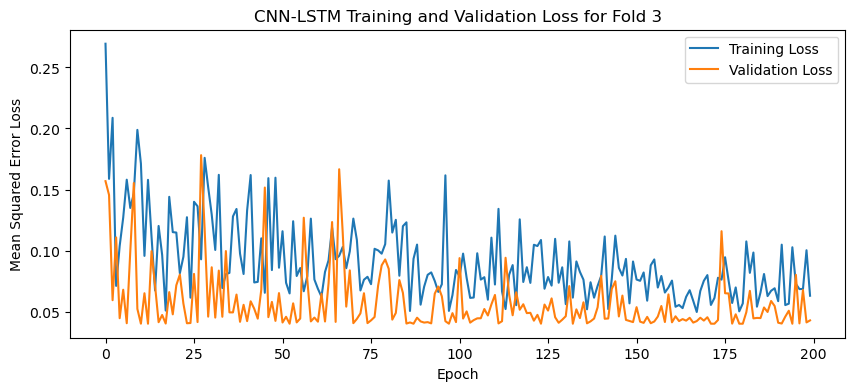

84
84
1


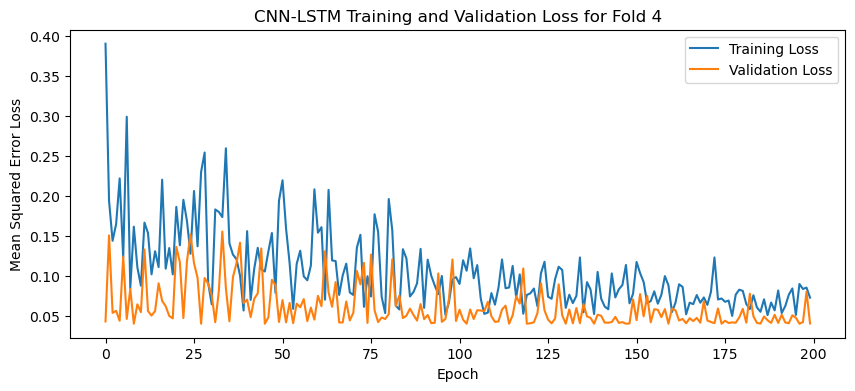

[I 2025-05-06 13:52:35,582] Trial 40 finished with value: 0.04130350723862648 and parameters: {'lr': 0.006302729720145403, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 128, 'dropout_rate': 0.4020165564584057}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


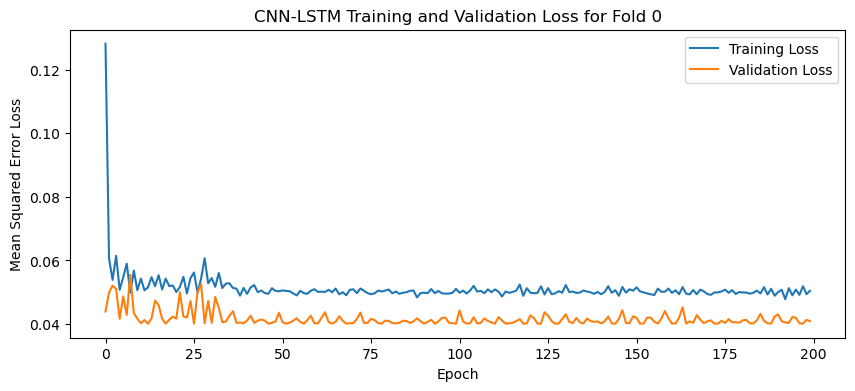

84
84
1


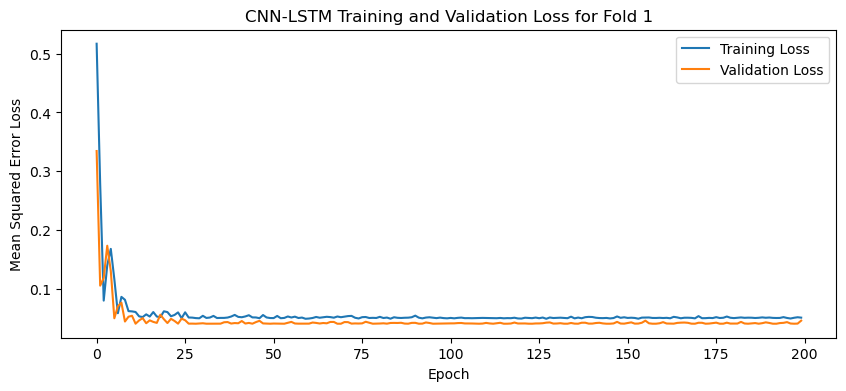

84
84
1


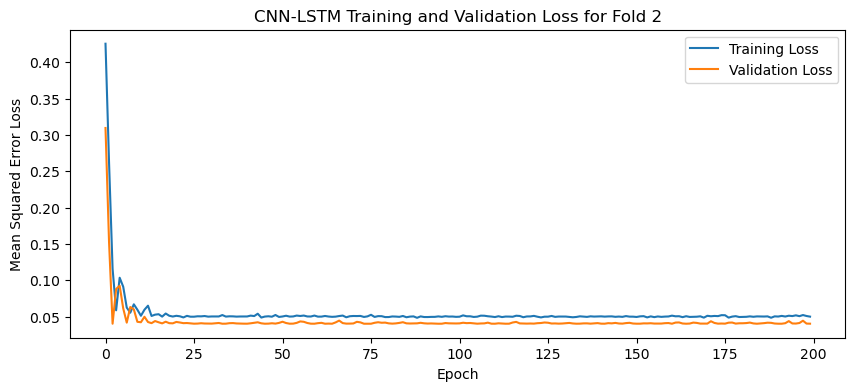

84
84
1


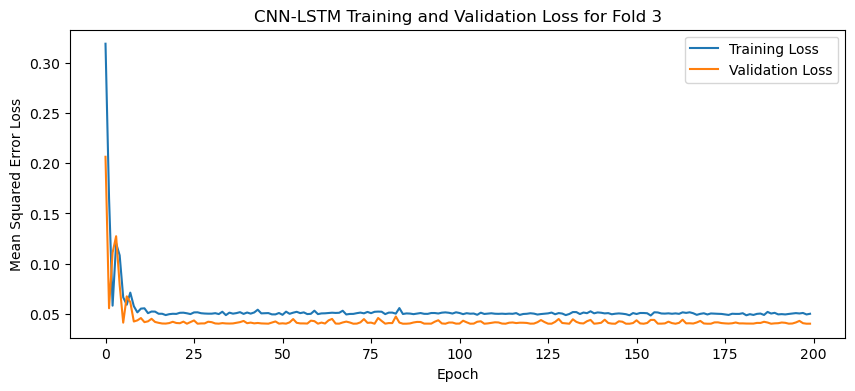

84
84
1


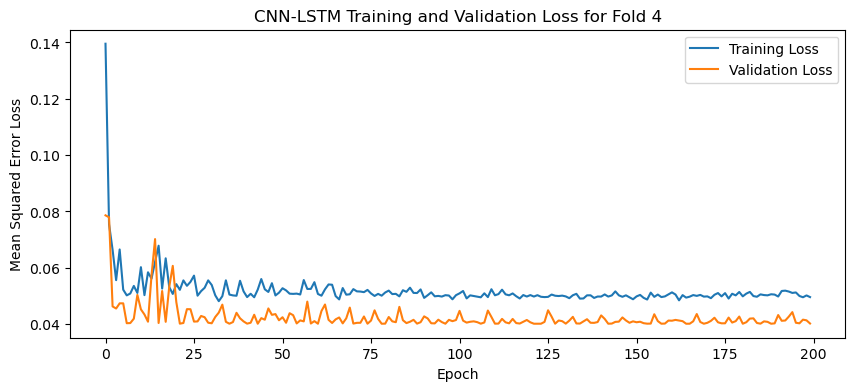

[I 2025-05-06 13:53:56,204] Trial 41 finished with value: 0.041350828111171724 and parameters: {'lr': 0.003253884320730575, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.33265635451915293}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


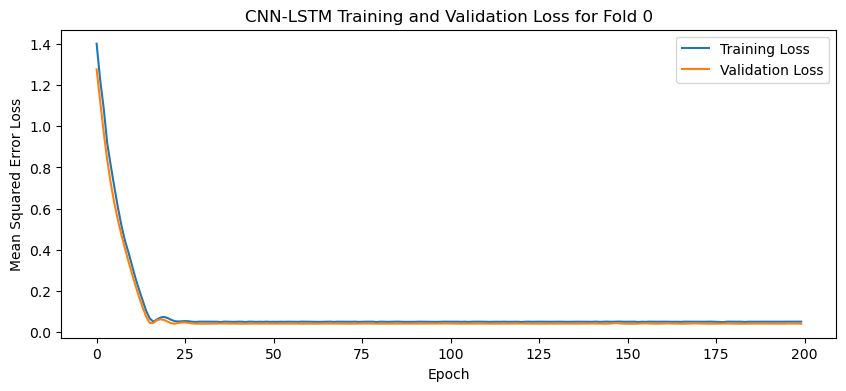

84
84
1


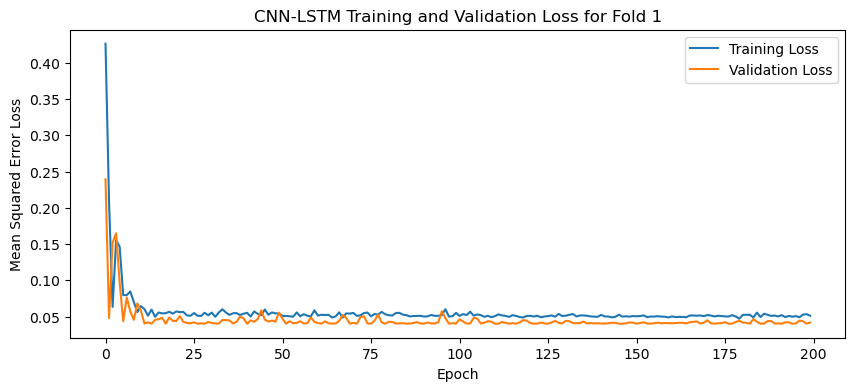

84
84
1


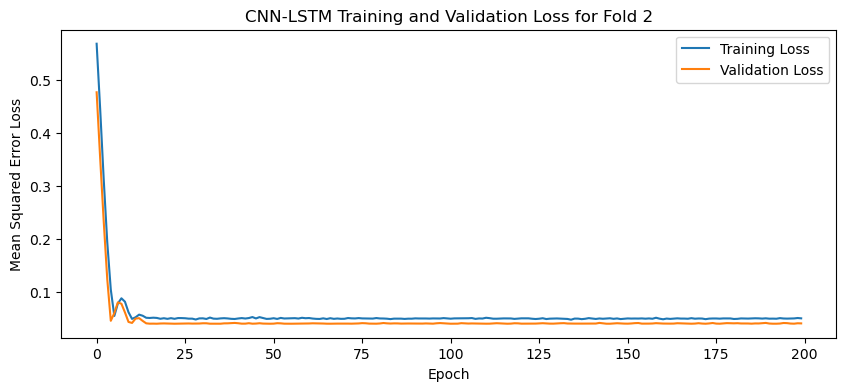

84
84
1


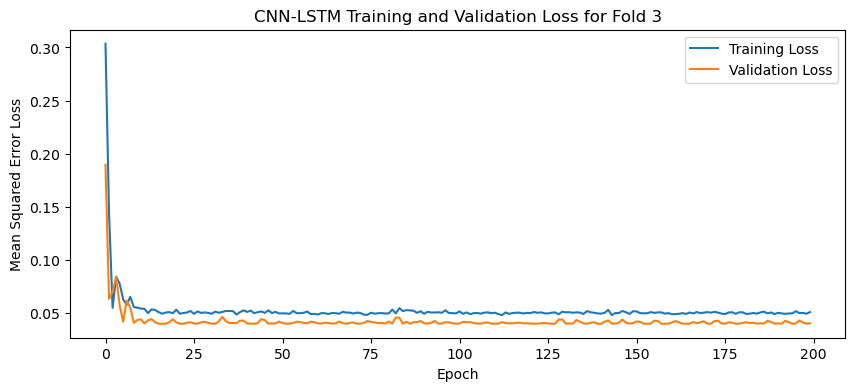

84
84
1


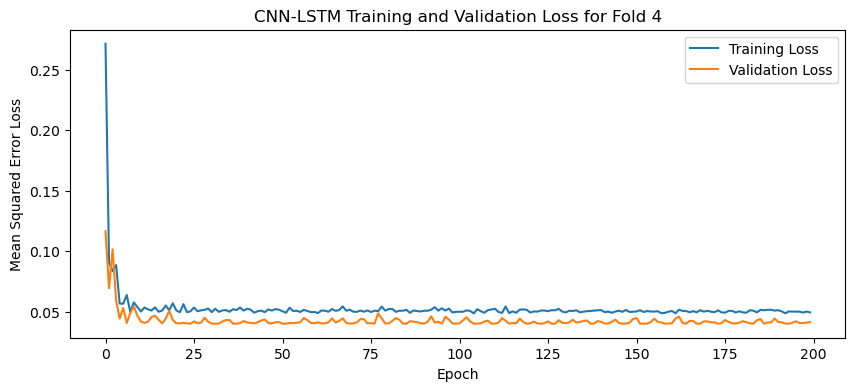

[I 2025-05-06 13:55:17,179] Trial 42 finished with value: 0.041021467000246045 and parameters: {'lr': 0.001854520467318066, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.2246993138047224}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


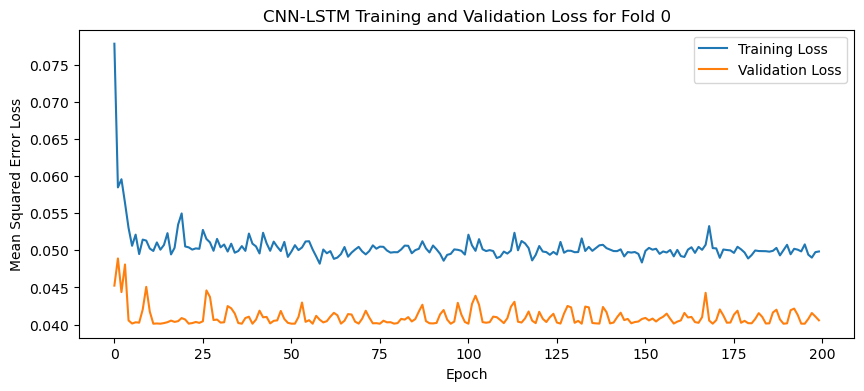

84
84
1


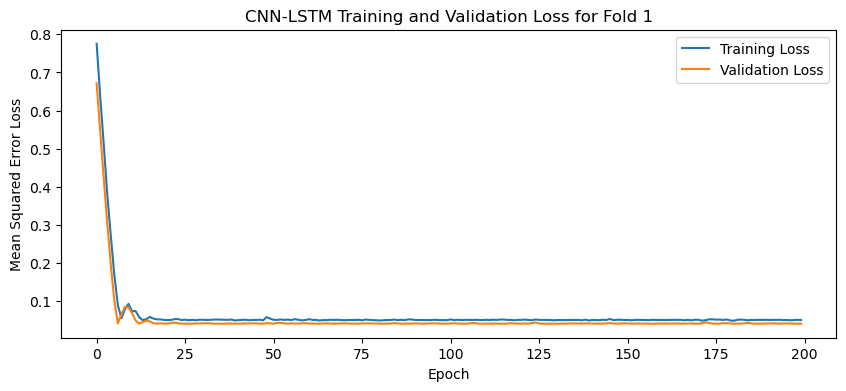

84
84
1


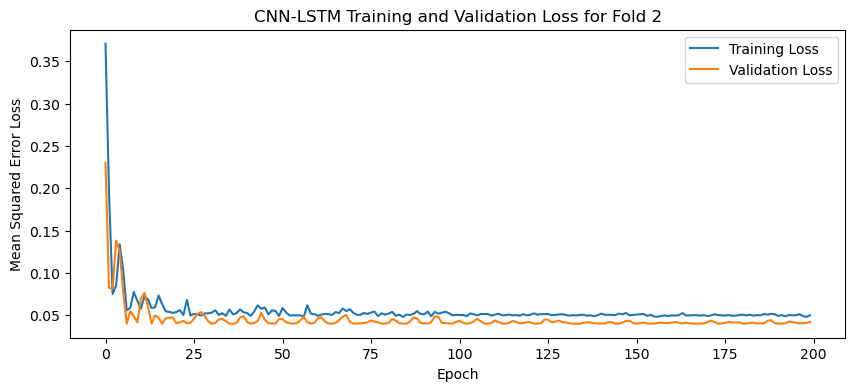

84
84
1


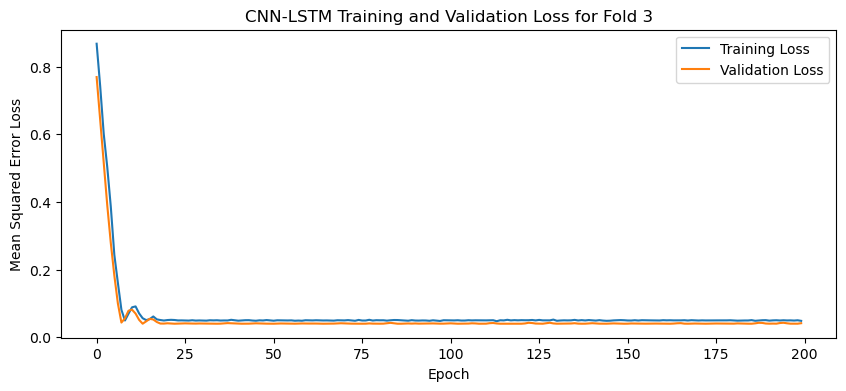

84
84
1


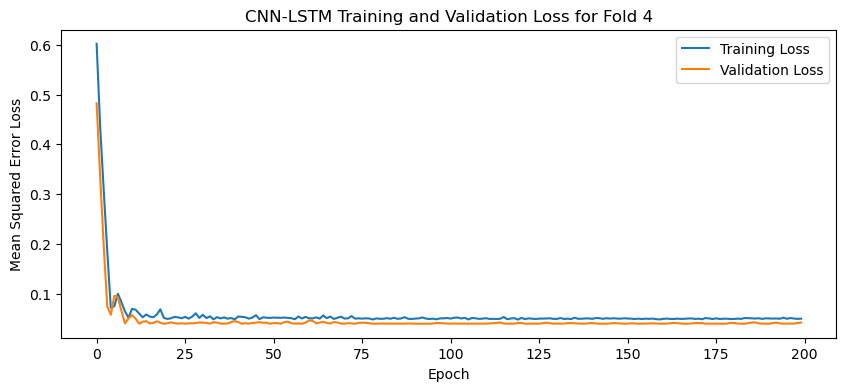

[I 2025-05-06 13:56:37,834] Trial 43 finished with value: 0.0414139449596405 and parameters: {'lr': 0.0015881673951552869, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.27220415930392255}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


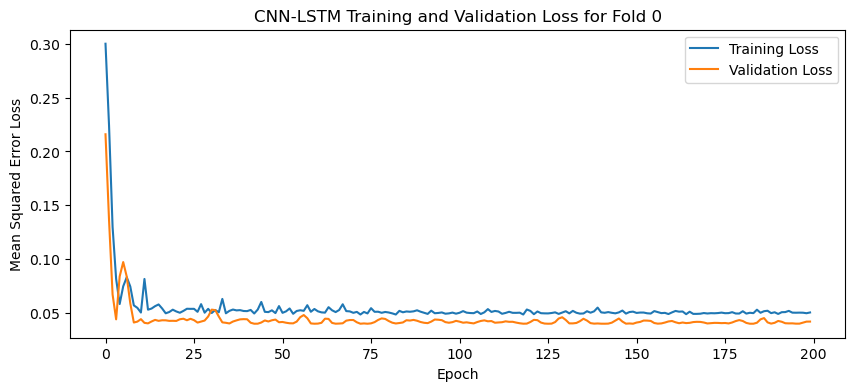

84
84
1


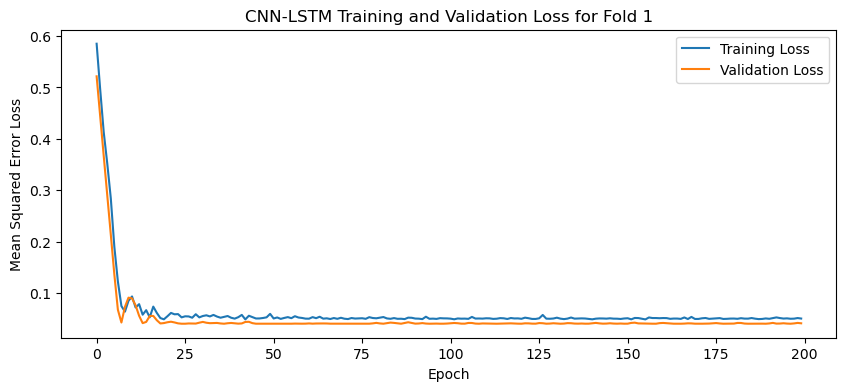

84
84
1


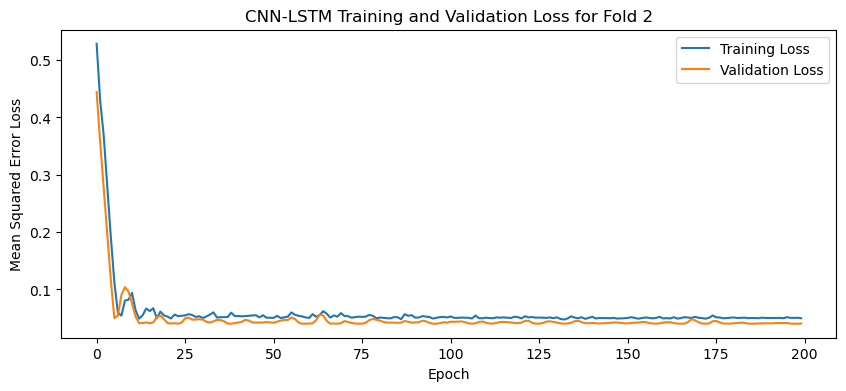

84
84
1


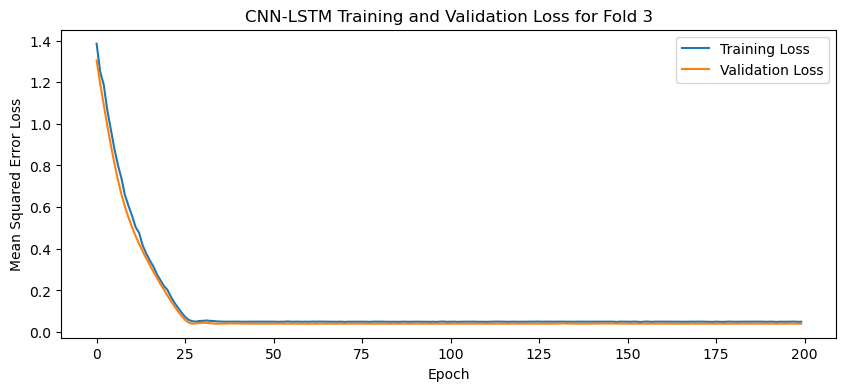

84
84
1


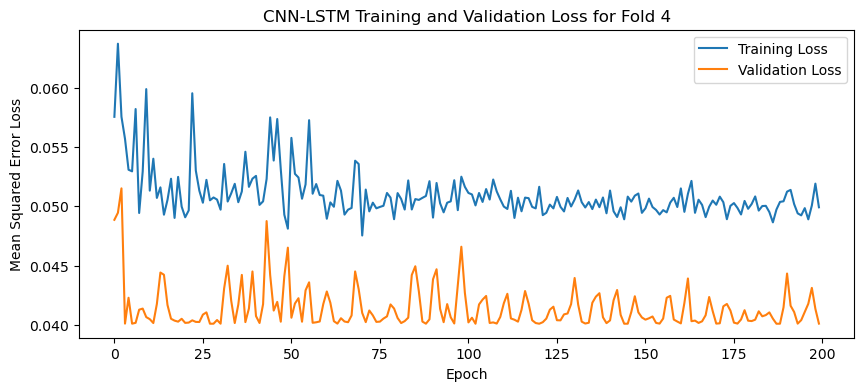

[I 2025-05-06 13:57:58,338] Trial 44 finished with value: 0.04075767546892166 and parameters: {'lr': 0.001266651918663597, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.44432486885433875}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


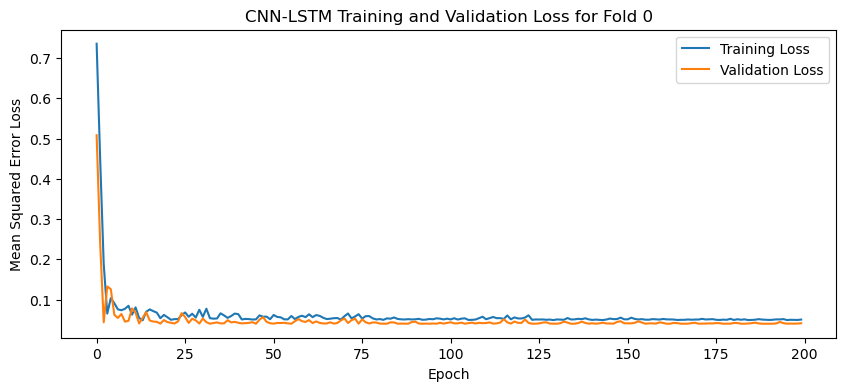

84
84
1


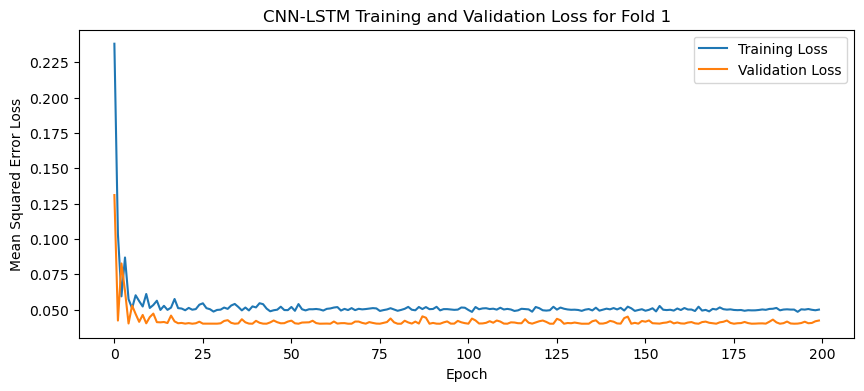

84
84
1


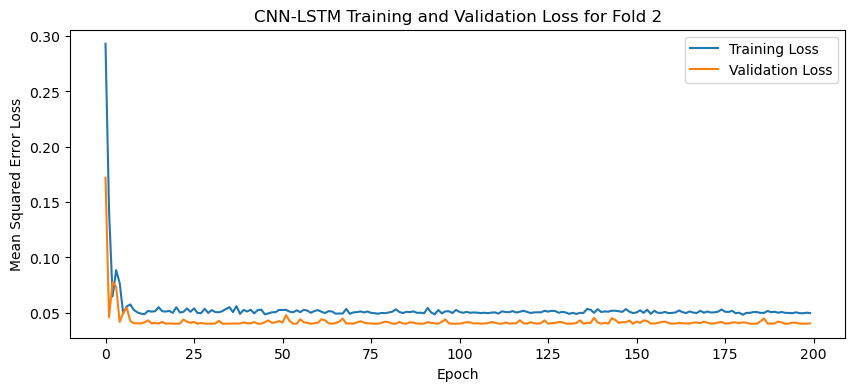

84
84
1


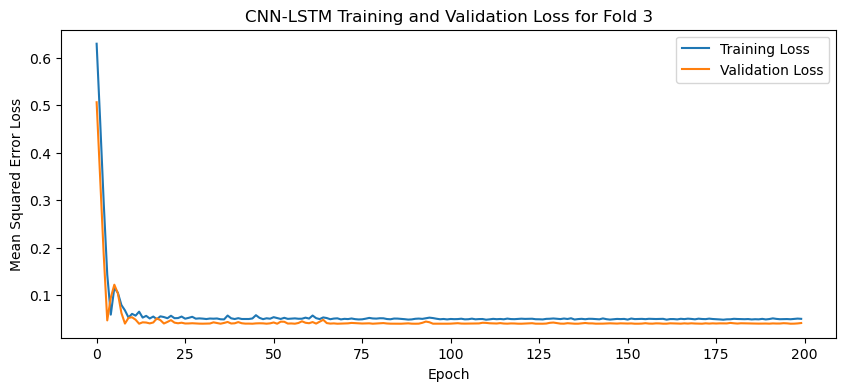

84
84
1


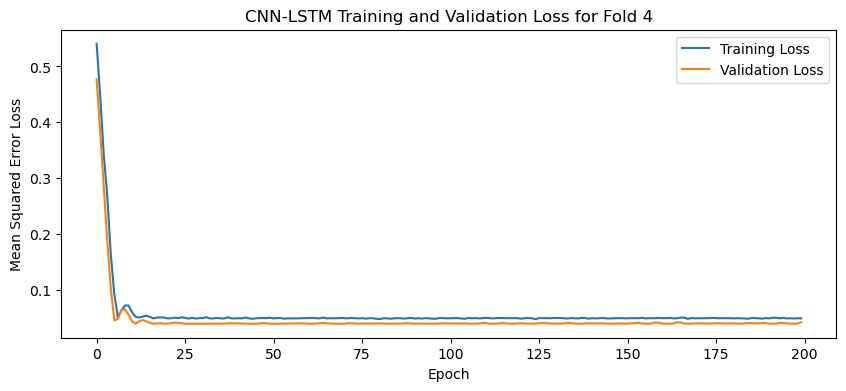

[I 2025-05-06 13:59:19,245] Trial 45 finished with value: 0.041703644394874576 and parameters: {'lr': 0.0022705587162109107, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.3542140387811694}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


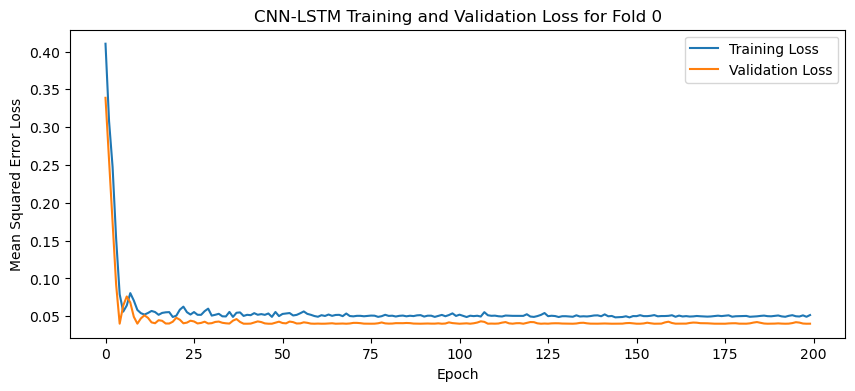

84
84
1


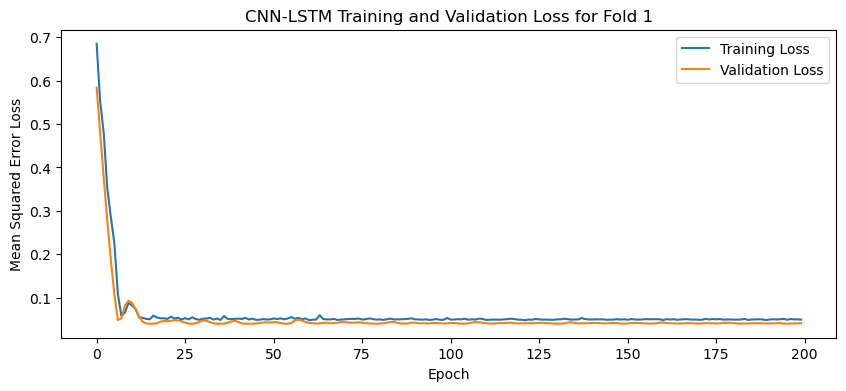

84
84
1


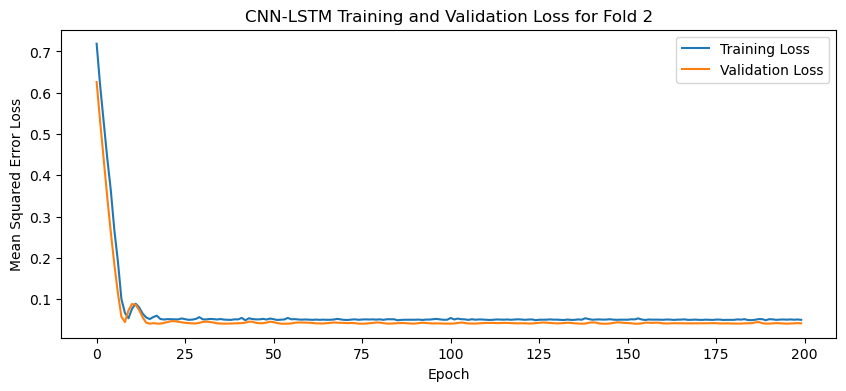

84
84
1


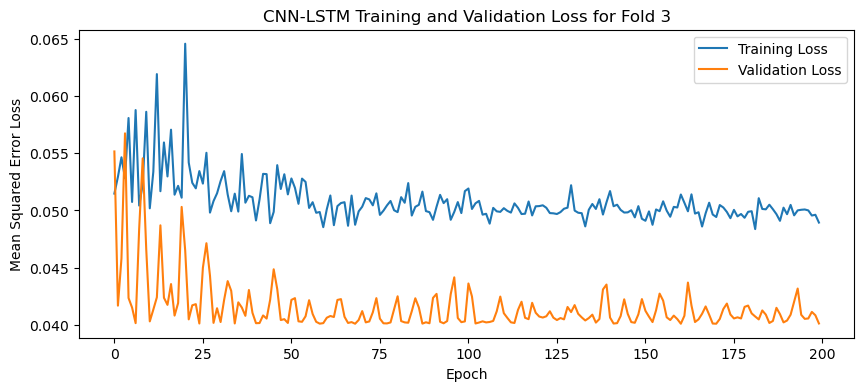

84
84
1


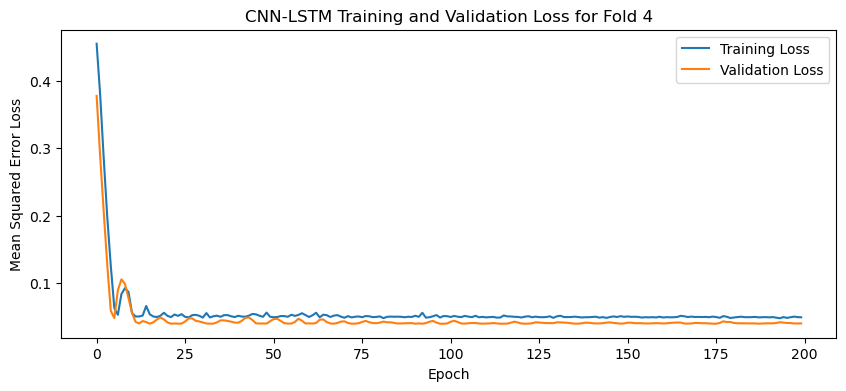

[I 2025-05-06 14:00:39,447] Trial 46 finished with value: 0.040580404549837114 and parameters: {'lr': 0.0013309774219422686, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.37629370210767976}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


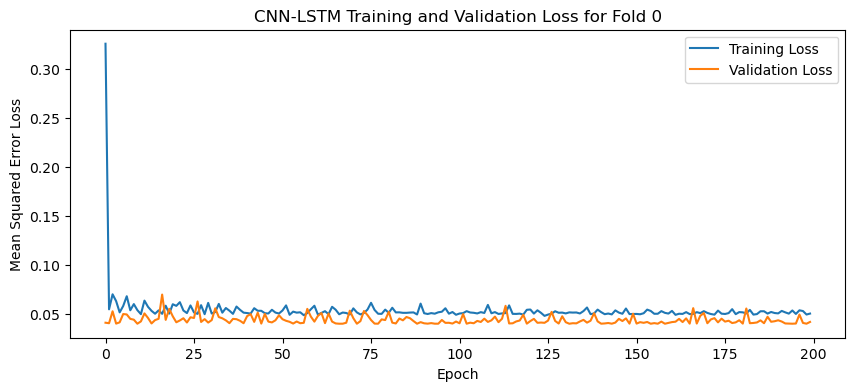

84
84
1


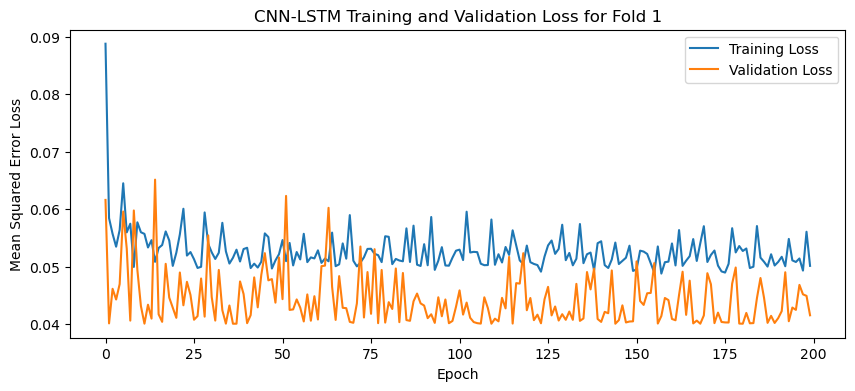

84
84
1


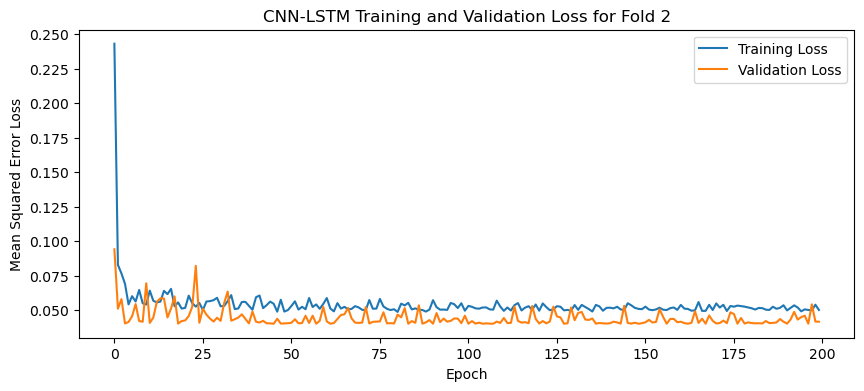

84
84
1


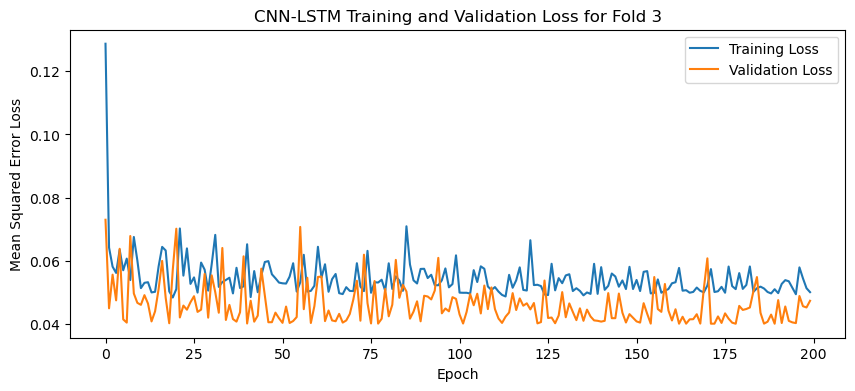

84
84
1


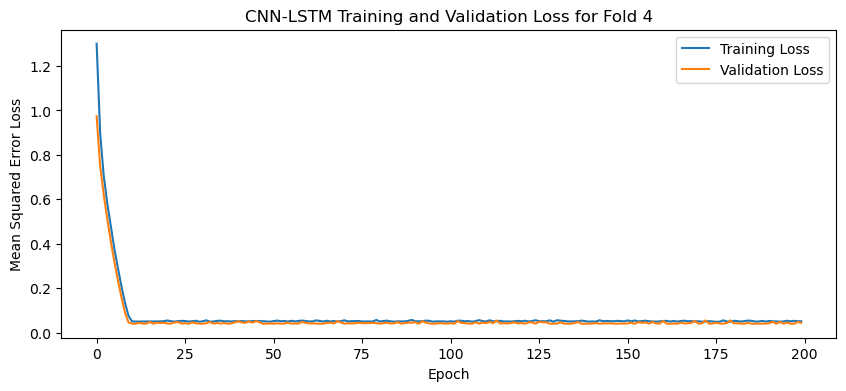

[I 2025-05-06 14:02:07,342] Trial 47 finished with value: 0.043285857886075974 and parameters: {'lr': 0.0027704877756415326, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.1820608636262498}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


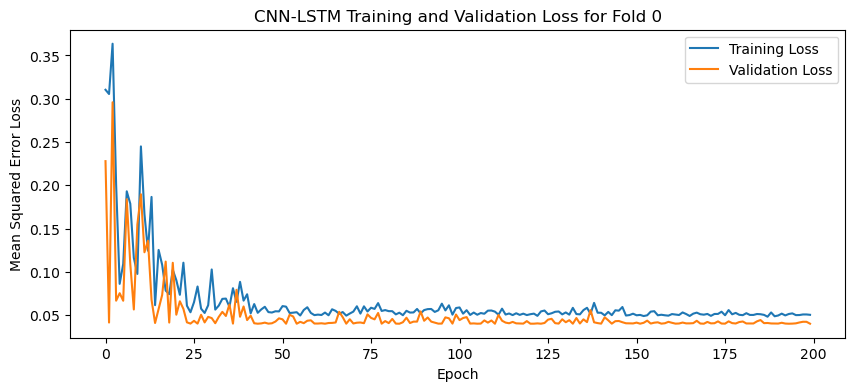

84
84
1


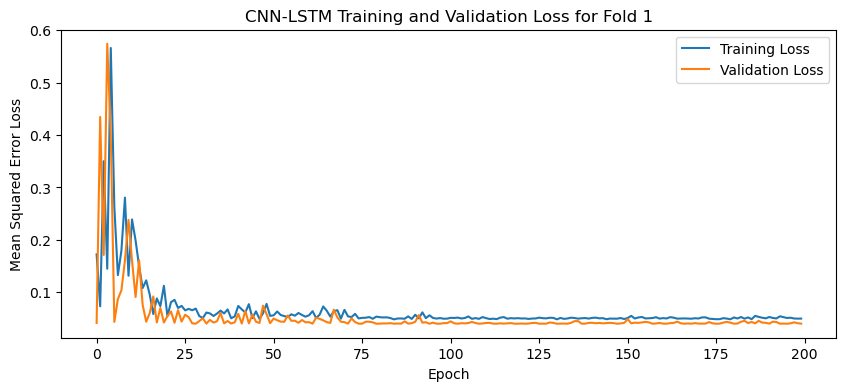

84
84
1


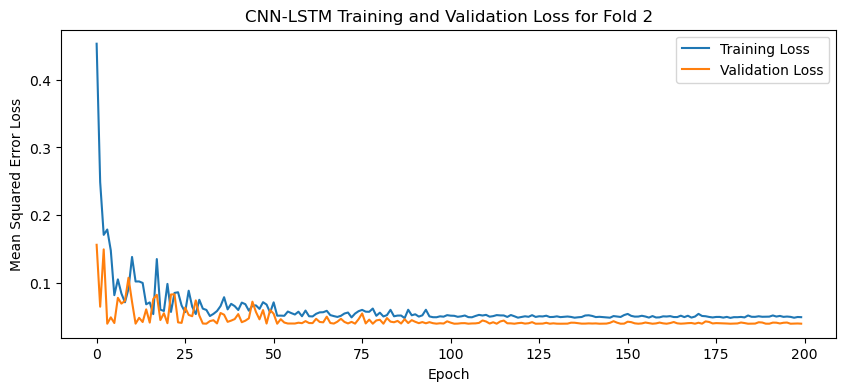

84
84
1


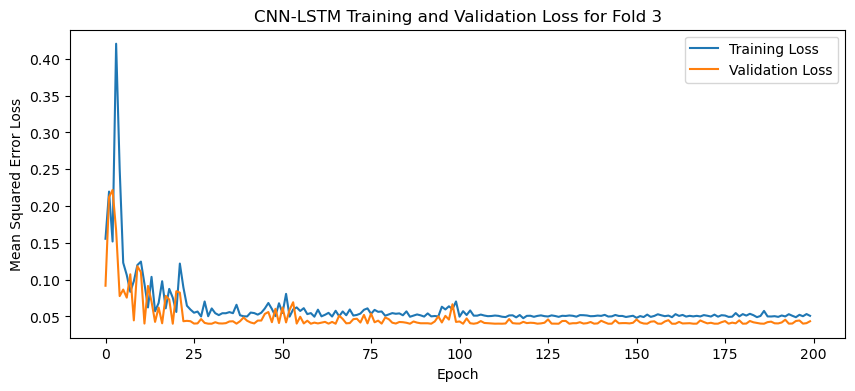

84
84
1


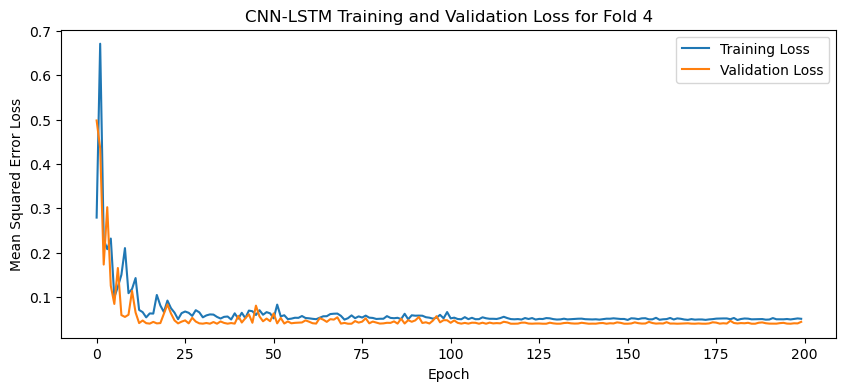

[I 2025-05-06 14:03:31,870] Trial 48 finished with value: 0.04167861267924309 and parameters: {'lr': 0.005029669576592367, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 64, 'dropout_rate': 0.3346886414363913}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


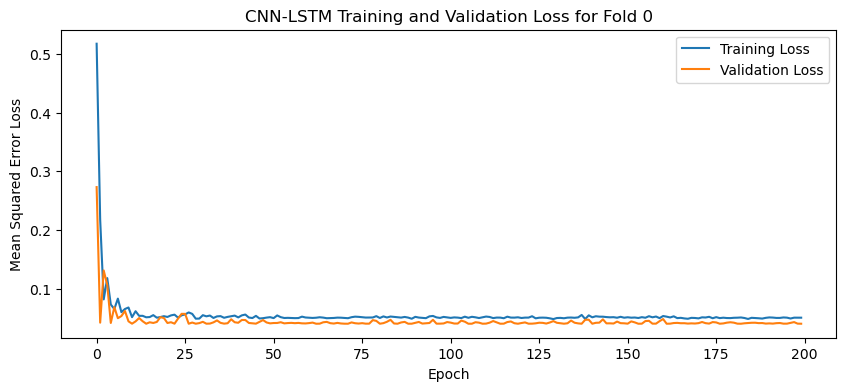

84
84
1


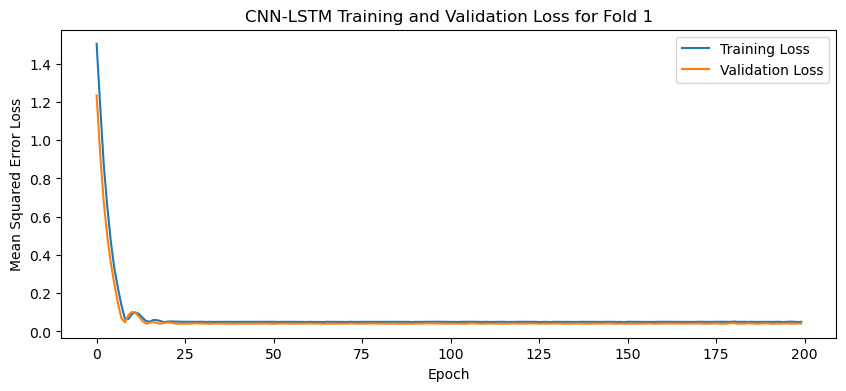

84
84
1


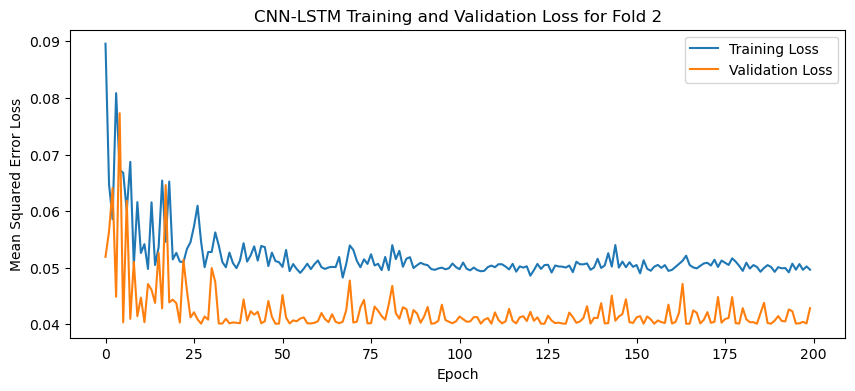

84
84
1


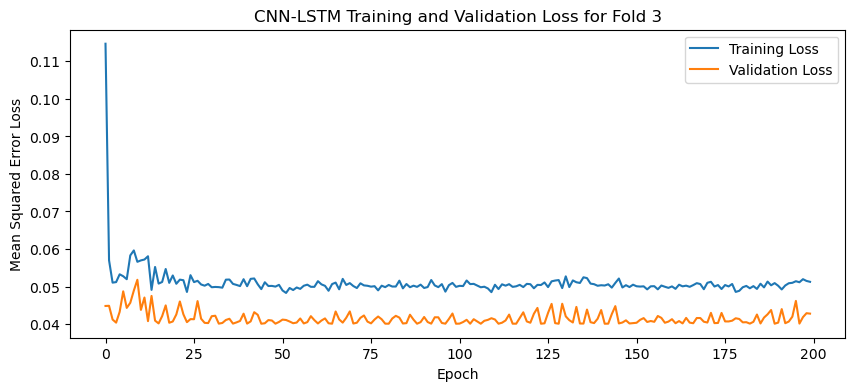

84
84
1


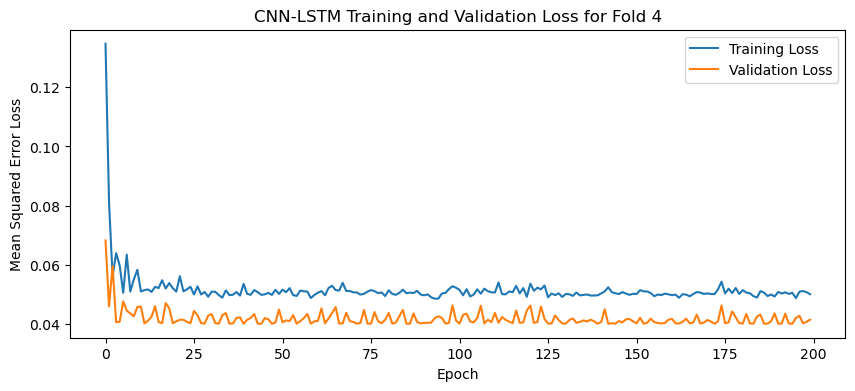

[I 2025-05-06 14:04:52,582] Trial 49 finished with value: 0.04170780330896377 and parameters: {'lr': 0.0036658255516853195, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.2943944038385637}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


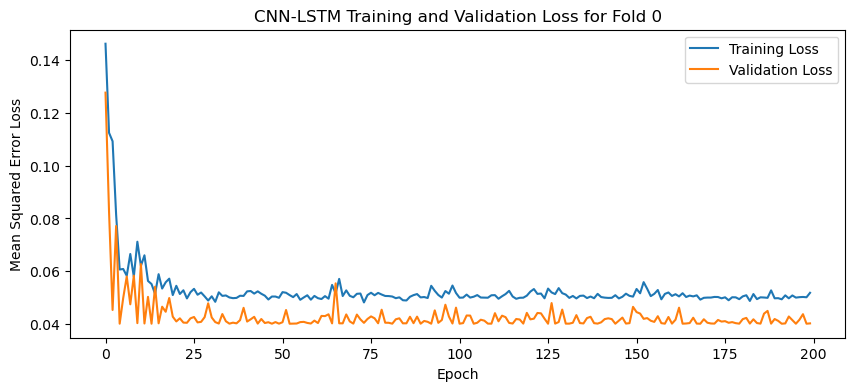

84
84
1


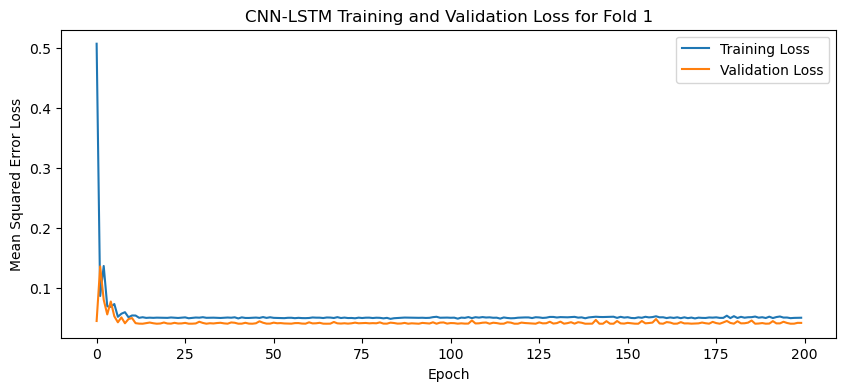

84
84
1


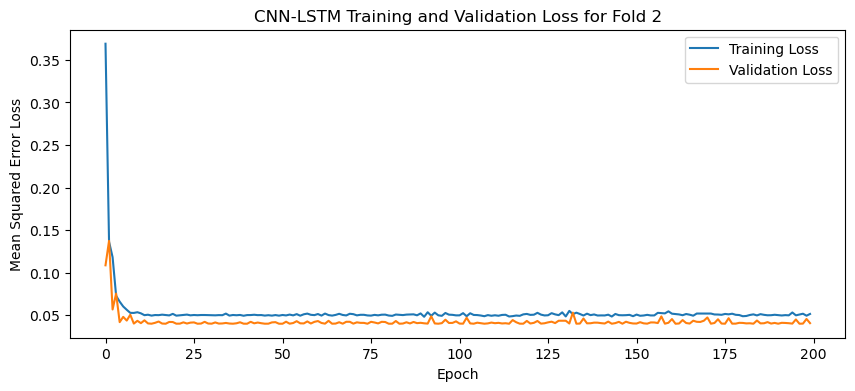

84
84
1


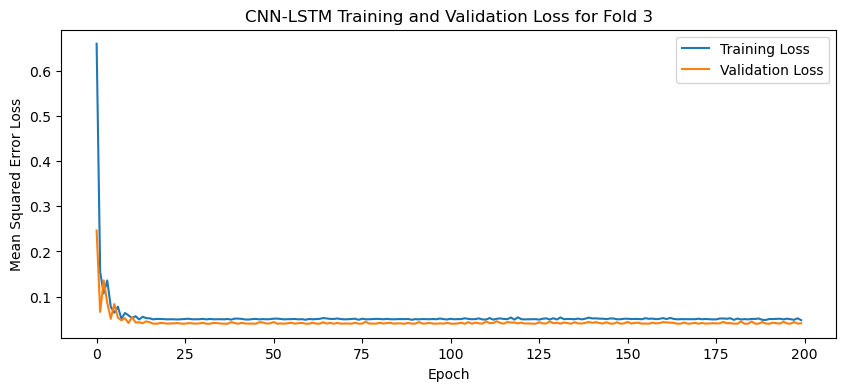

84
84
1


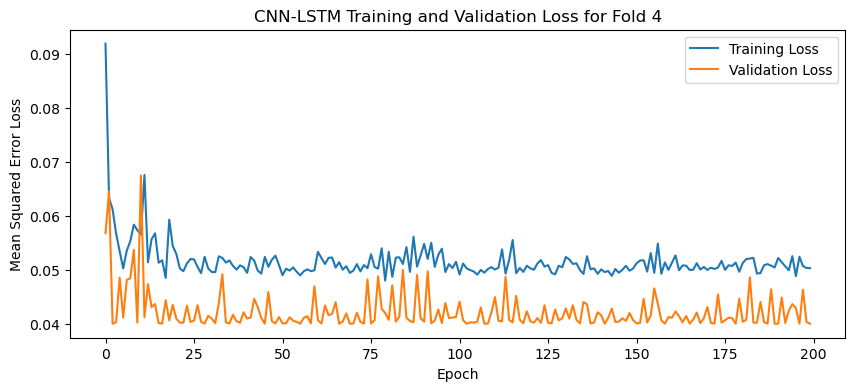

[I 2025-05-06 14:06:25,497] Trial 50 finished with value: 0.040724769979715345 and parameters: {'lr': 0.007839921283056274, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.24967644504191583}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


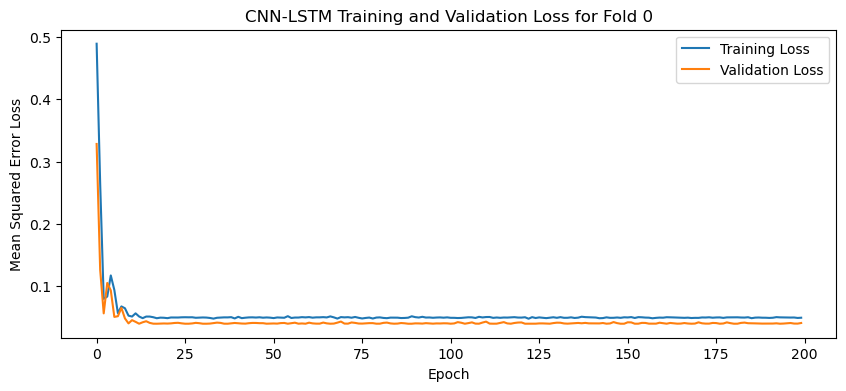

84
84
1


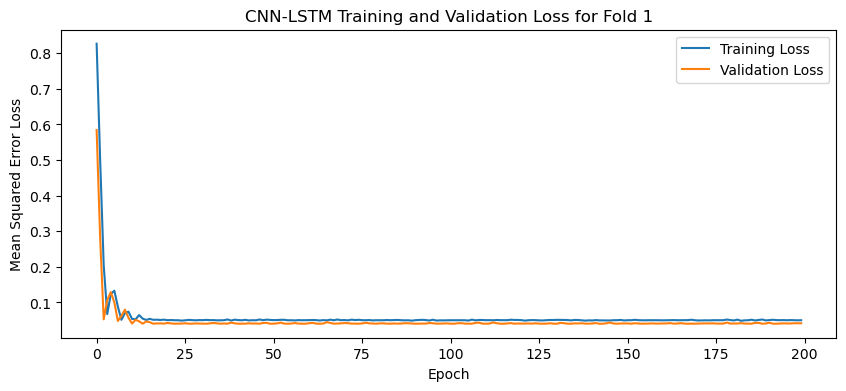

84
84
1


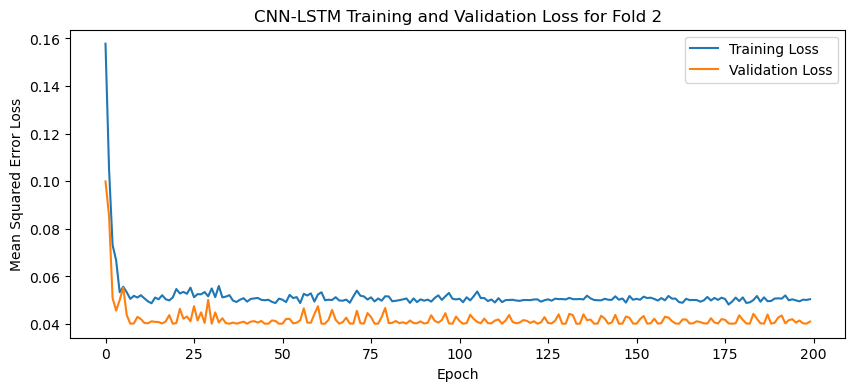

84
84
1


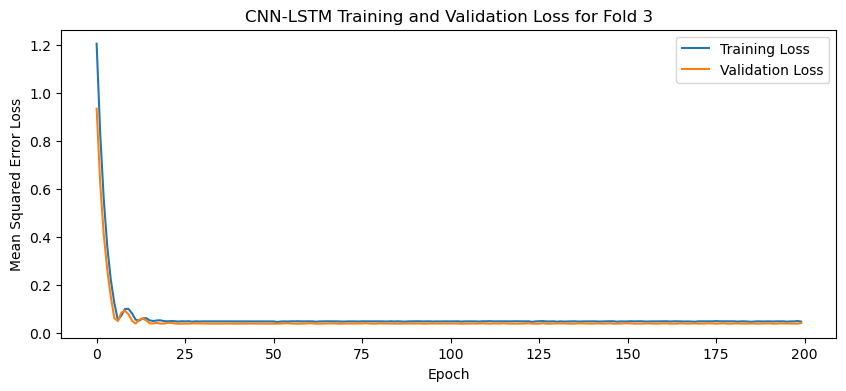

84
84
1


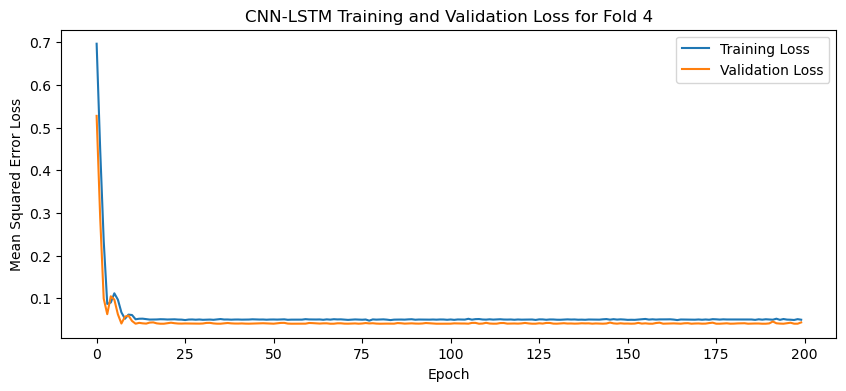

[I 2025-05-06 14:07:46,345] Trial 51 finished with value: 0.04192250892519951 and parameters: {'lr': 0.003135677742323854, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.12213761367176058}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


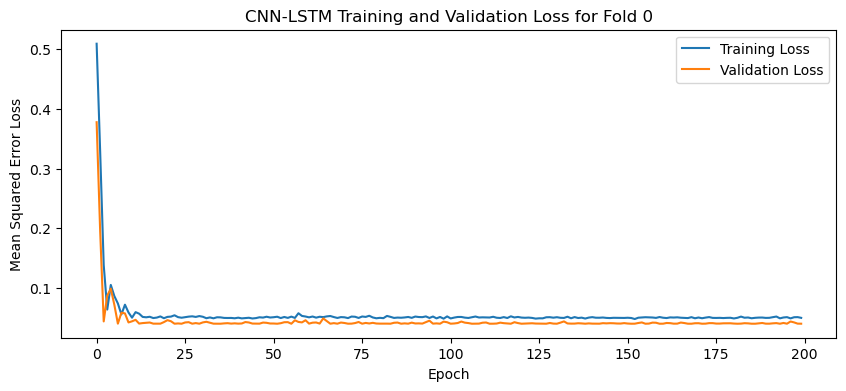

84
84
1


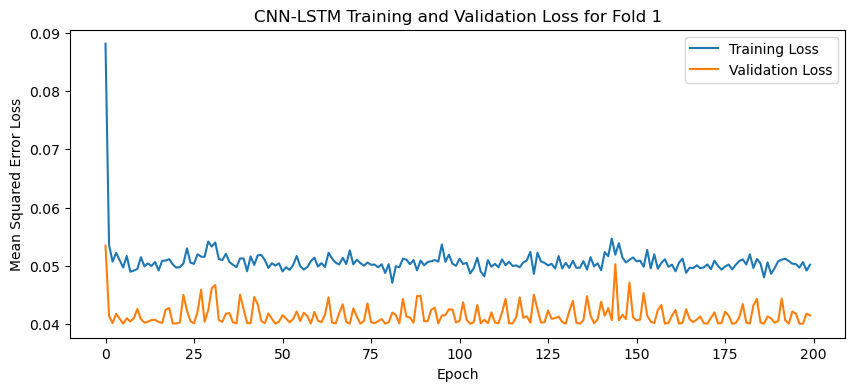

84
84
1


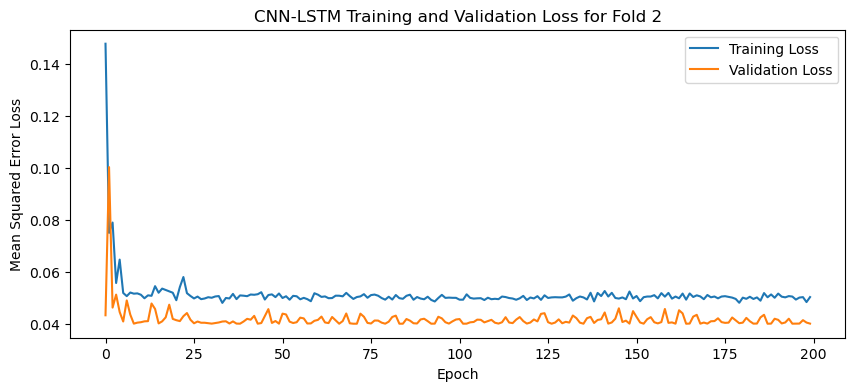

84
84
1


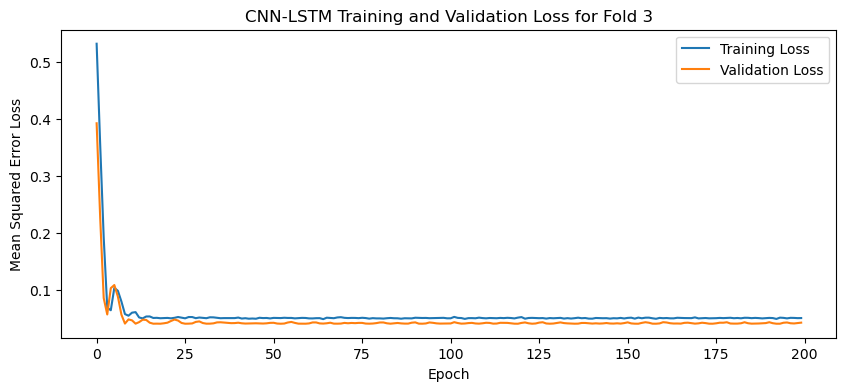

84
84
1


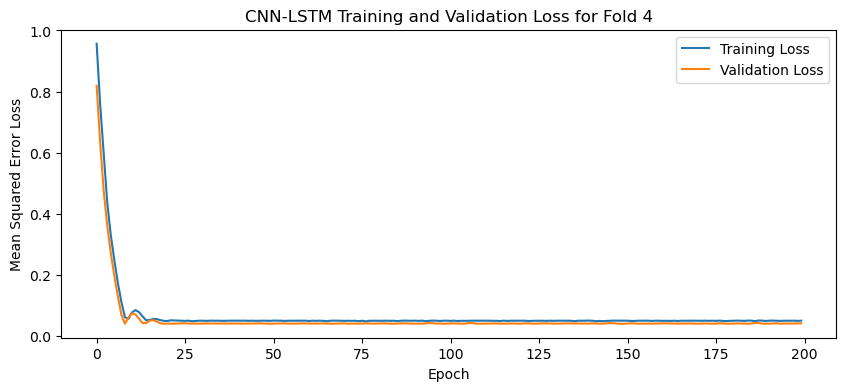

[I 2025-05-06 14:09:08,710] Trial 52 finished with value: 0.04101730063557625 and parameters: {'lr': 0.002767191448663068, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.21691575146082653}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


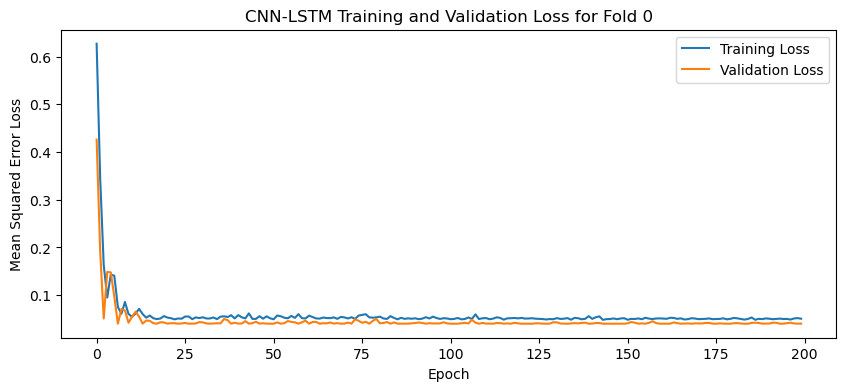

84
84
1


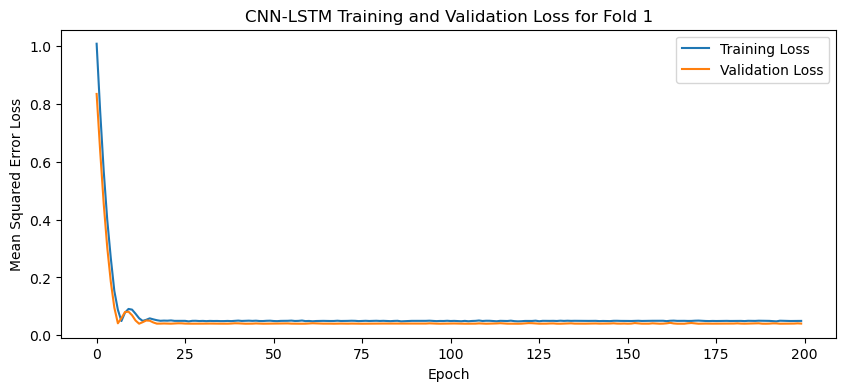

84
84
1


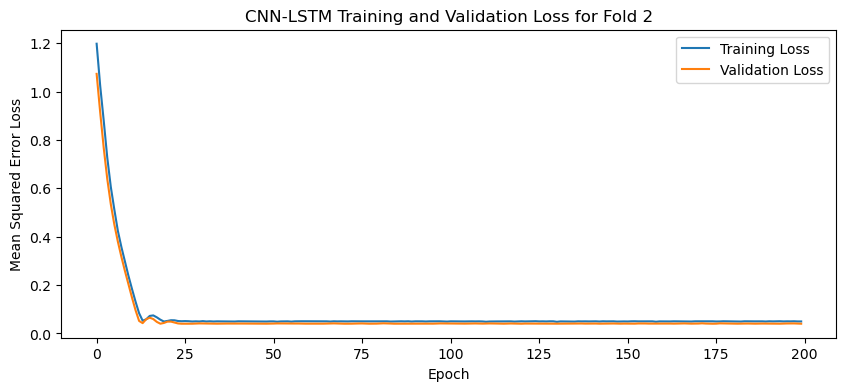

84
84
1


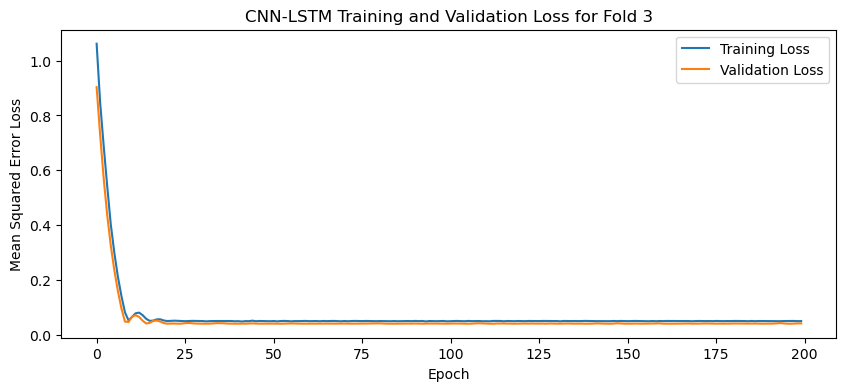

84
84
1


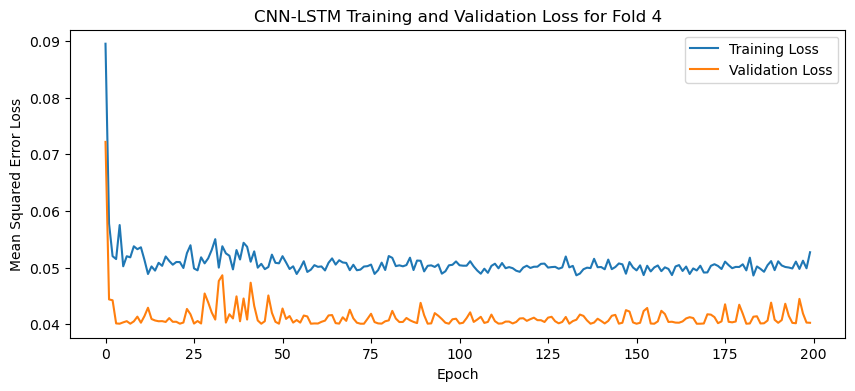

[I 2025-05-06 14:10:29,613] Trial 53 finished with value: 0.040555719286203384 and parameters: {'lr': 0.0018841419018363933, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.18591777709570032}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


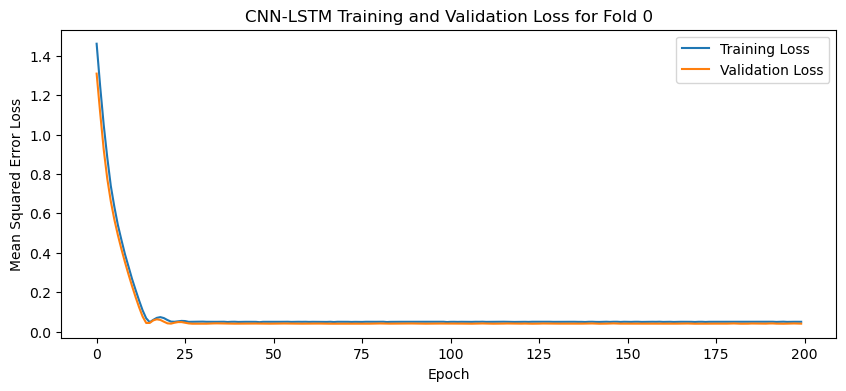

84
84
1


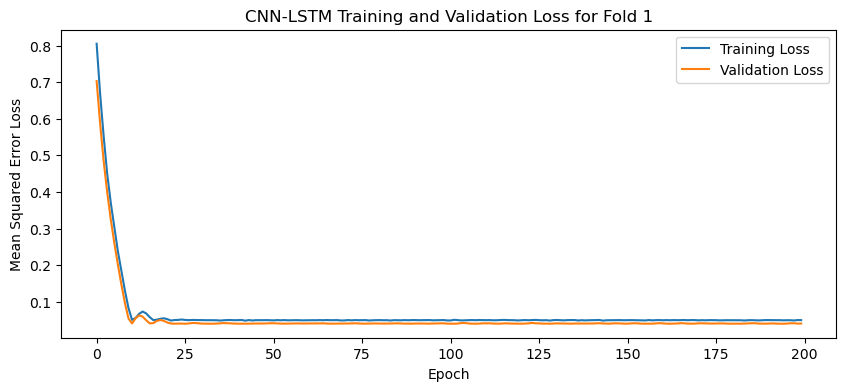

84
84
1


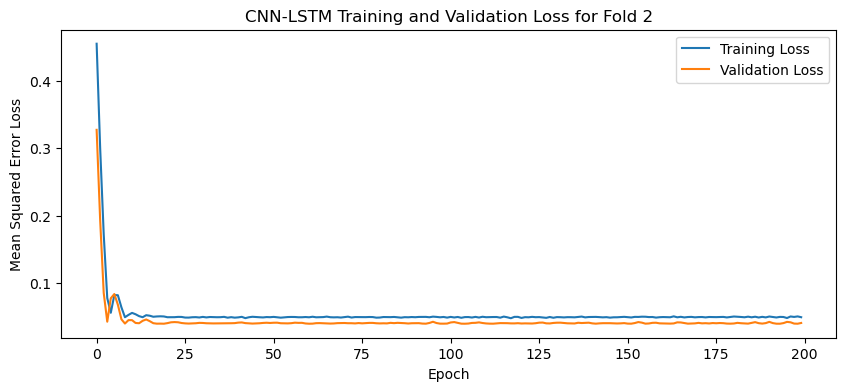

84
84
1


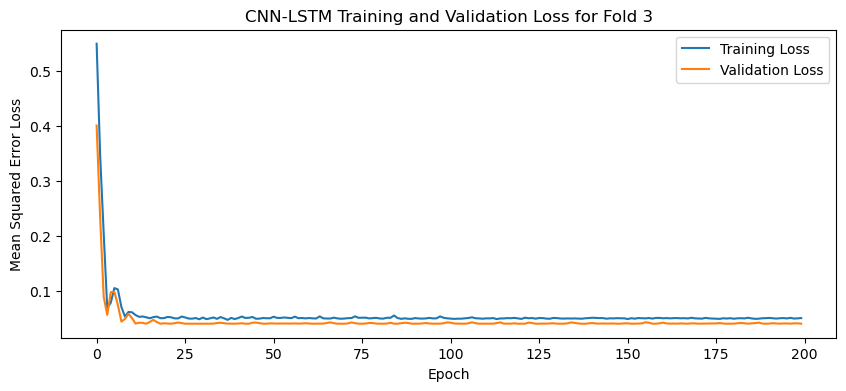

84
84
1


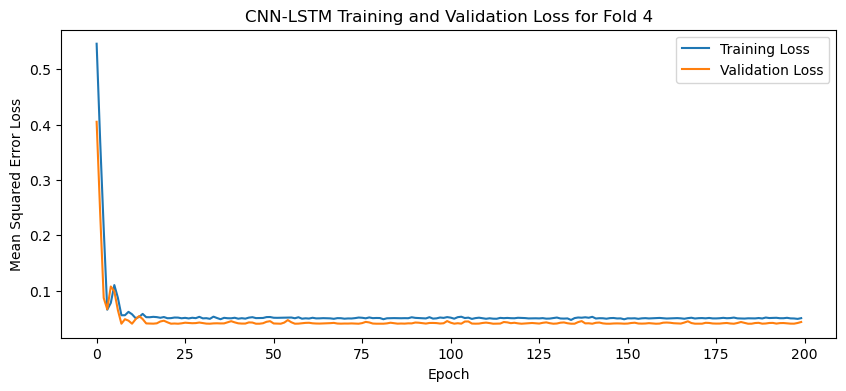

[I 2025-05-06 14:11:54,063] Trial 54 finished with value: 0.041142774373292924 and parameters: {'lr': 0.0018788840127967955, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.13599337020594784}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


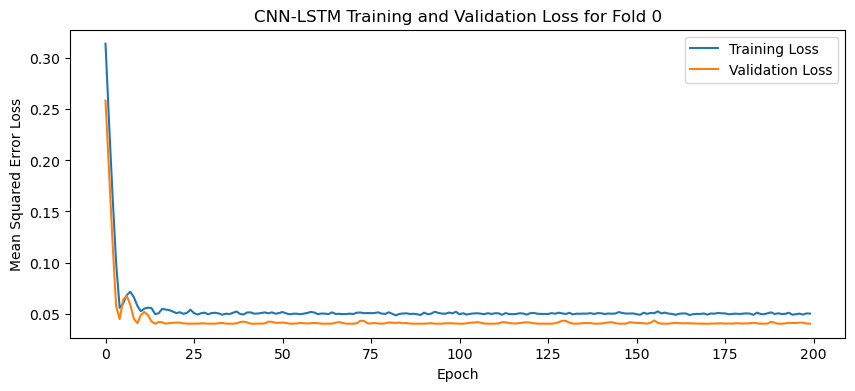

84
84
1


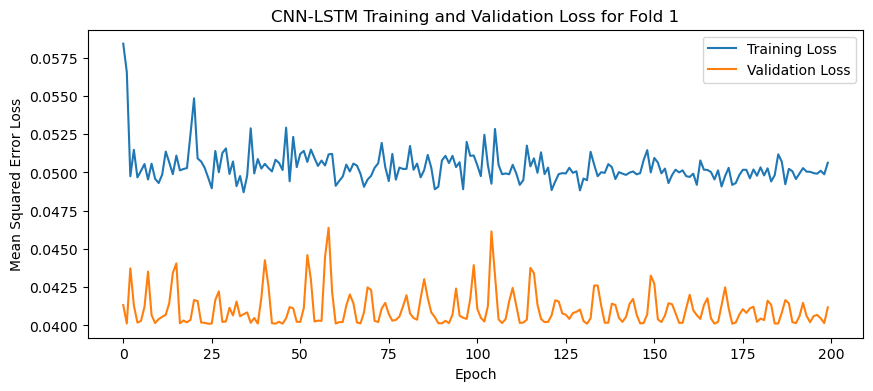

84
84
1


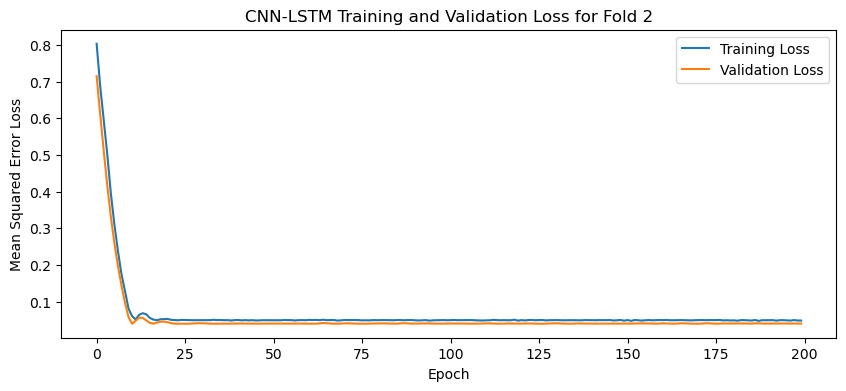

84
84
1


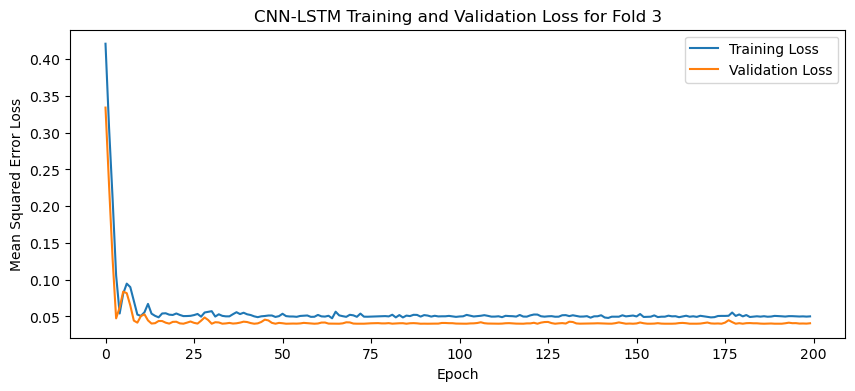

84
84
1


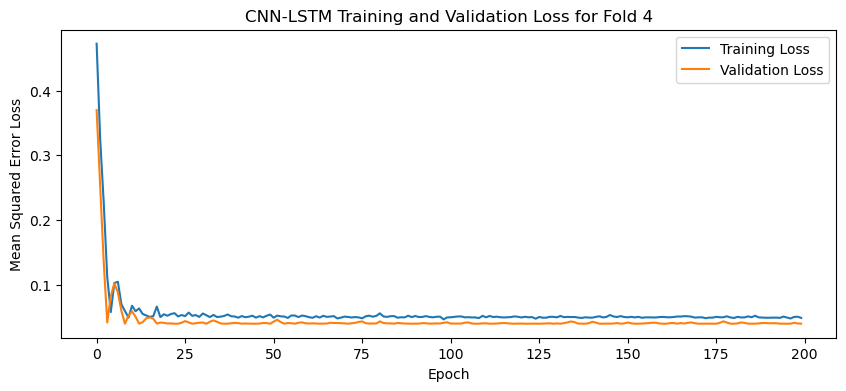

[I 2025-05-06 14:13:18,508] Trial 55 finished with value: 0.04055716469883919 and parameters: {'lr': 0.0014630560298644789, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.28195706634726864}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


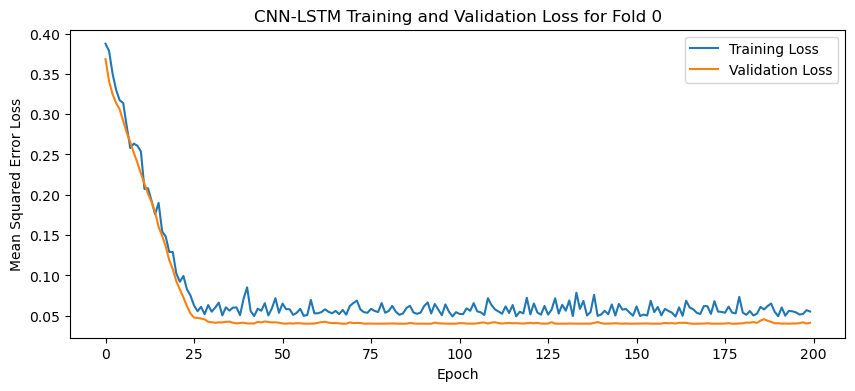

84
84
1


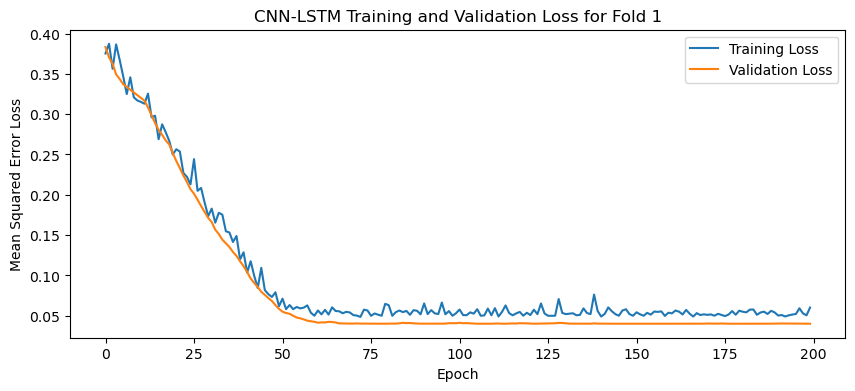

84
84
1


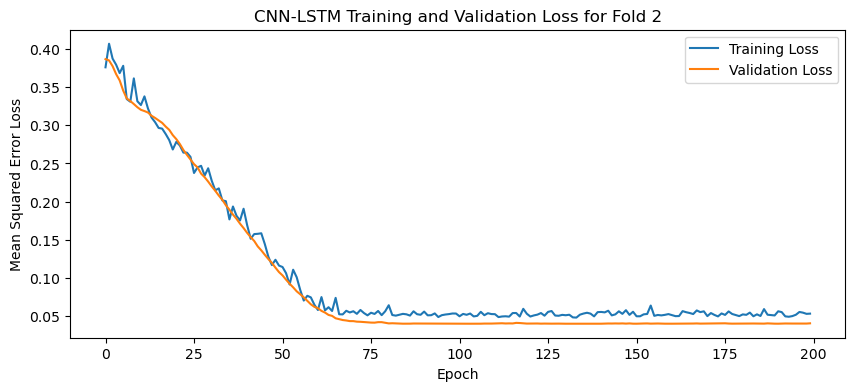

84
84
1


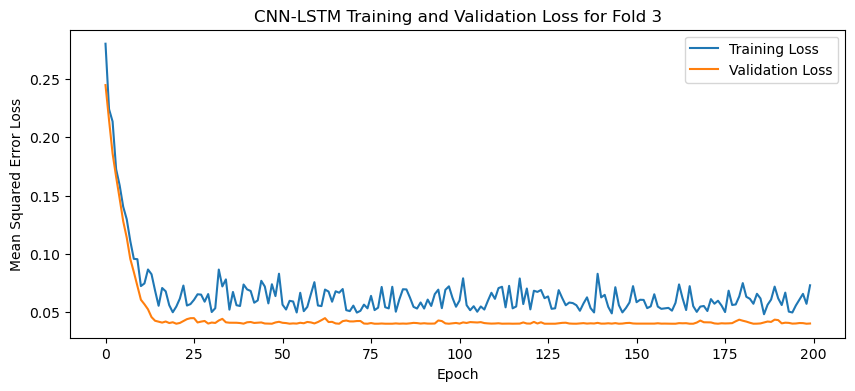

84
84
1


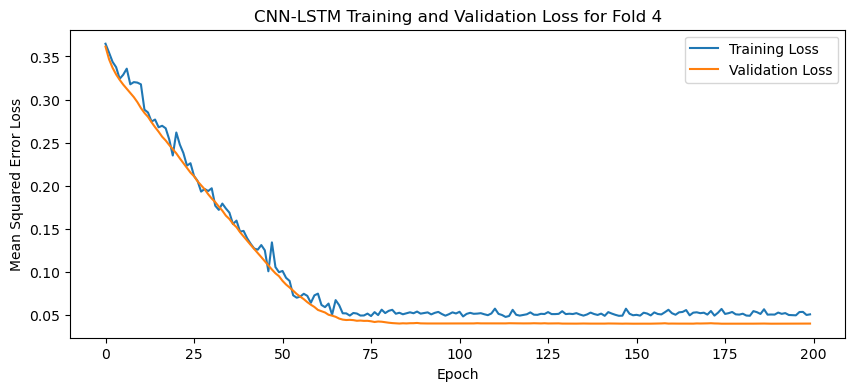

[I 2025-05-06 14:14:37,860] Trial 56 finished with value: 0.040629640221595764 and parameters: {'lr': 0.0011529615557261737, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 128, 'dropout_rate': 0.15576187222619134}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


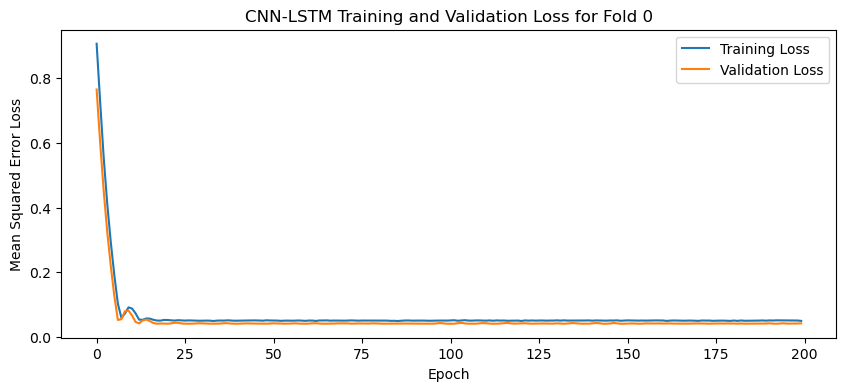

84
84
1


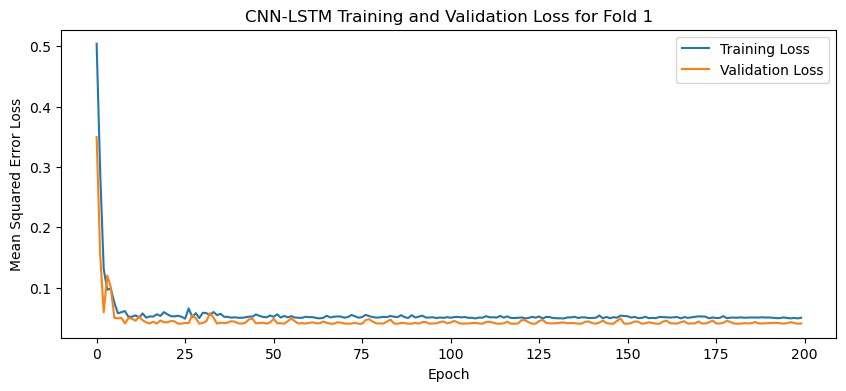

84
84
1


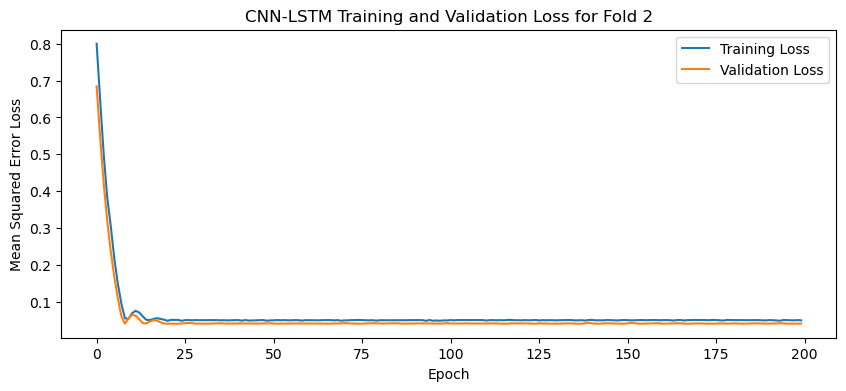

84
84
1


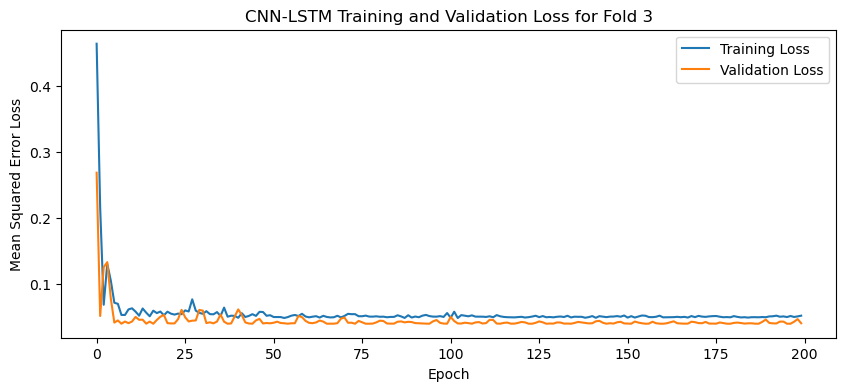

84
84
1


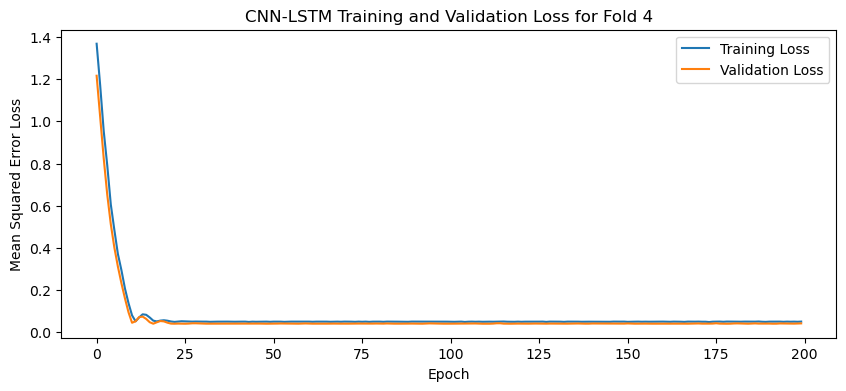

[I 2025-05-06 14:16:00,024] Trial 57 finished with value: 0.04093169644474983 and parameters: {'lr': 0.0023282446495005455, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.2549124756472676}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


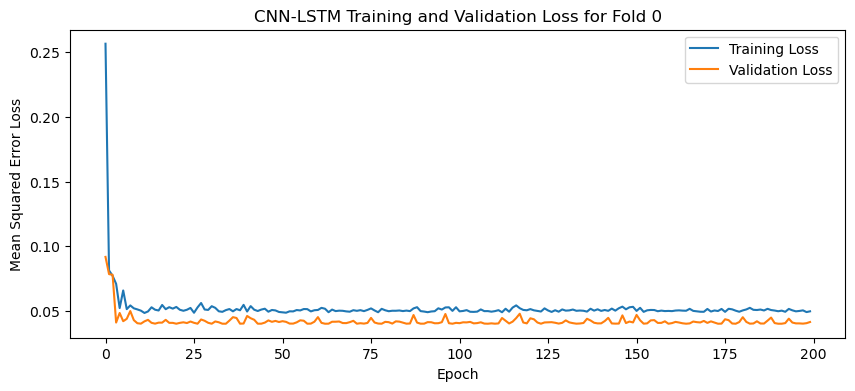

84
84
1


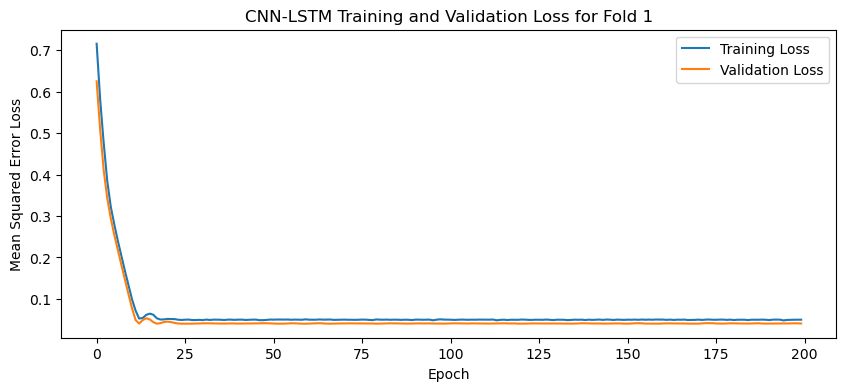

84
84
1


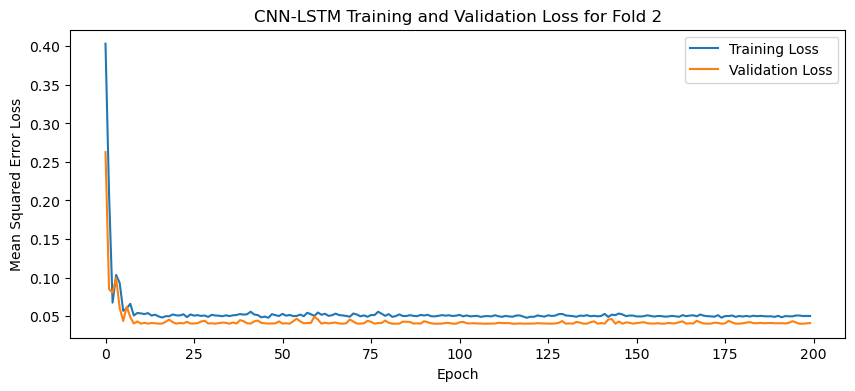

84
84
1


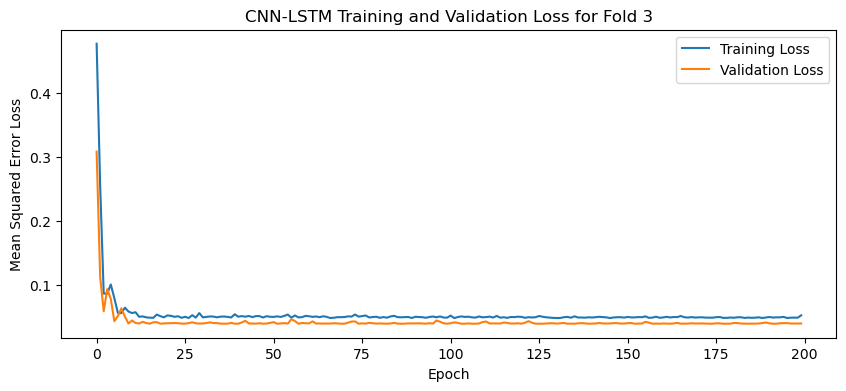

84
84
1


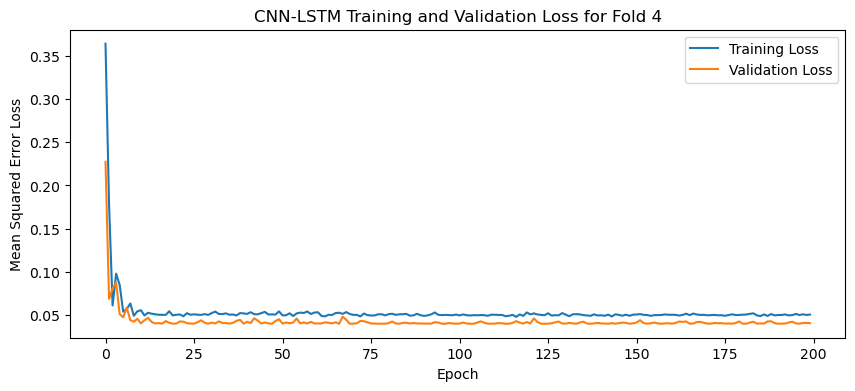

[I 2025-05-06 14:17:23,661] Trial 58 finished with value: 0.040824626386165616 and parameters: {'lr': 0.0017541312800402943, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.12179061701762467}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


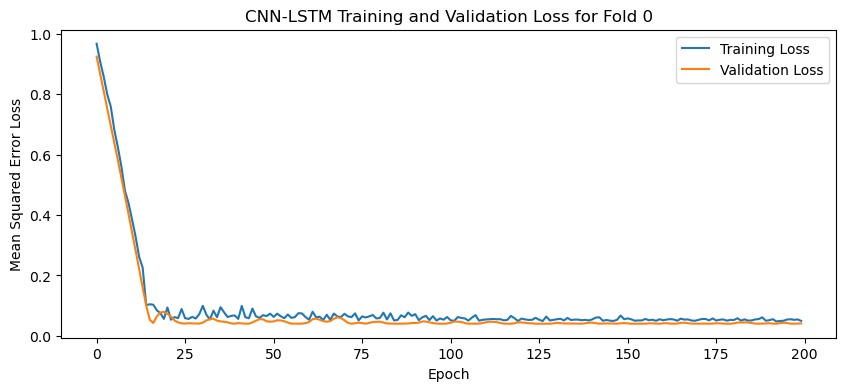

84
84
1


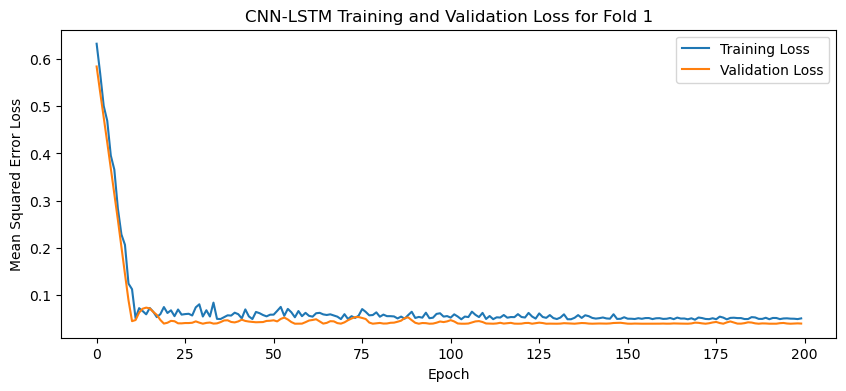

84
84
1


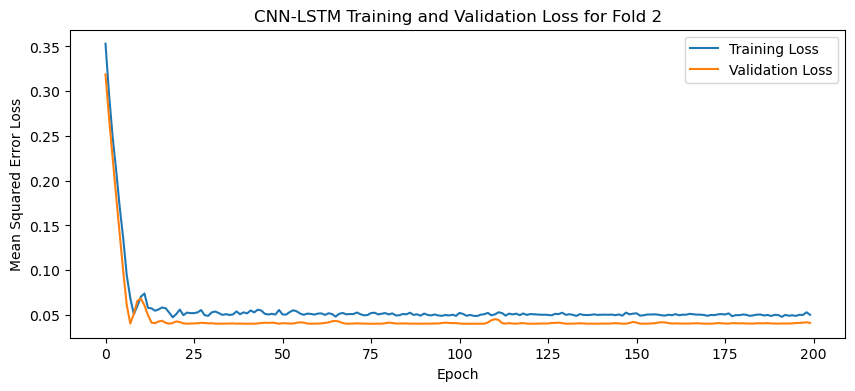

84
84
1


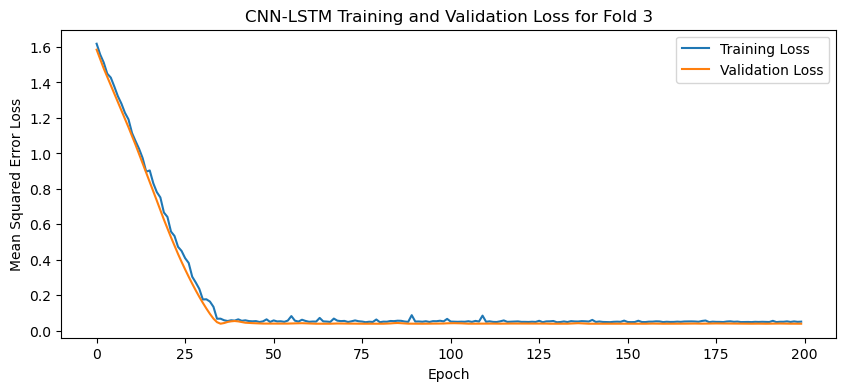

84
84
1


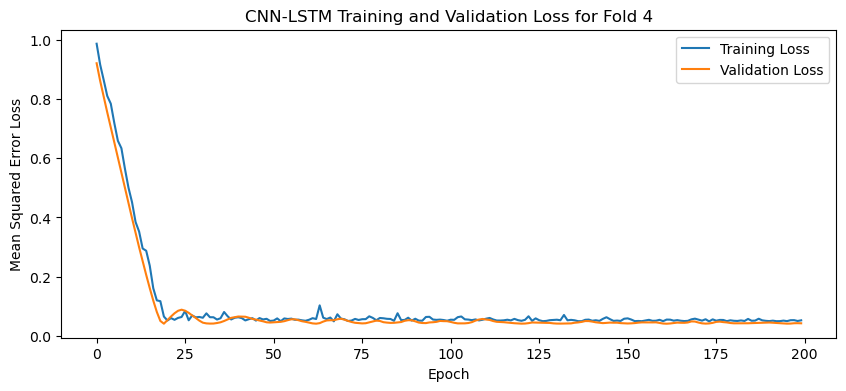

[I 2025-05-06 14:18:39,674] Trial 59 finished with value: 0.040932547301054 and parameters: {'lr': 0.0010090688218184094, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 64, 'dropout_rate': 0.49885779616587145}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


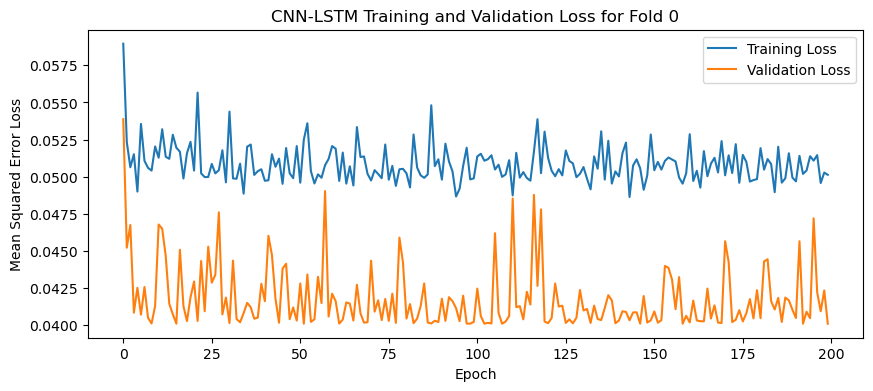

84
84
1


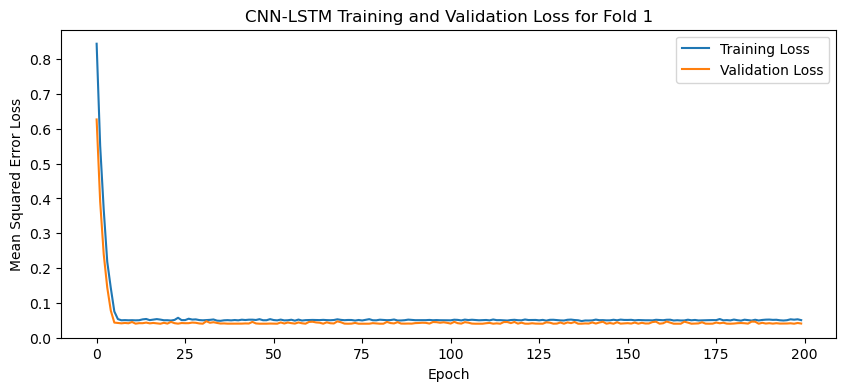

84
84
1


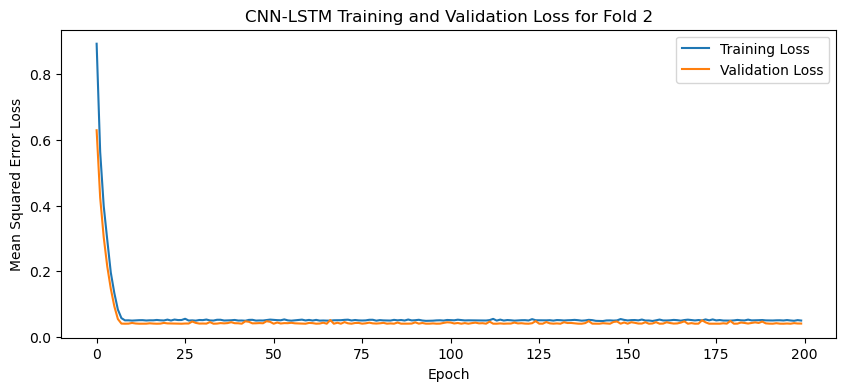

84
84
1


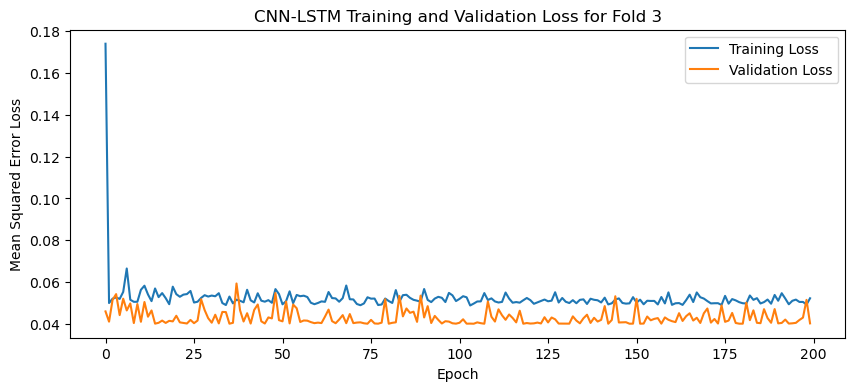

84
84
1


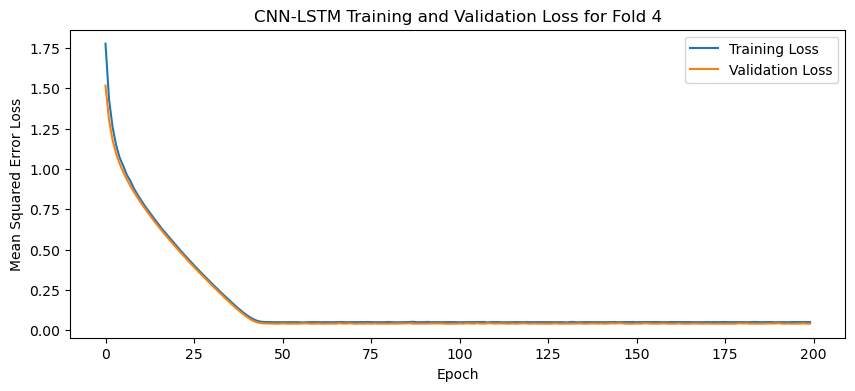

[I 2025-05-06 14:20:08,707] Trial 60 finished with value: 0.040373705327510834 and parameters: {'lr': 0.001462084504363724, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.18249473658219242}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


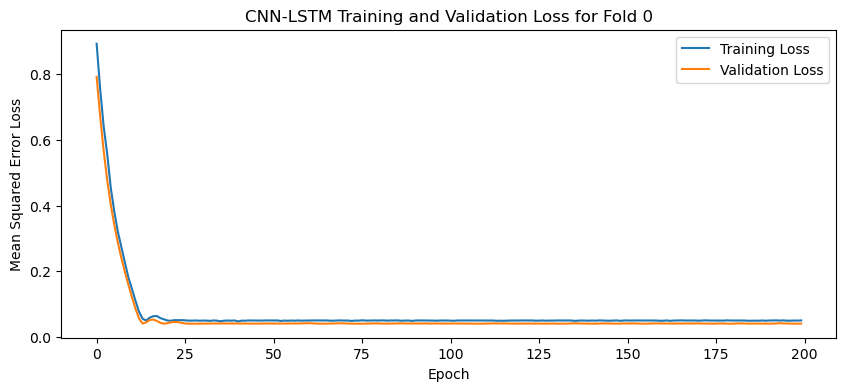

84
84
1


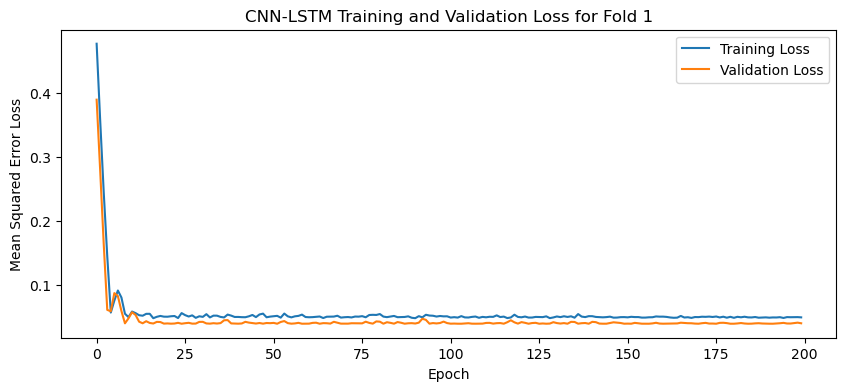

84
84
1


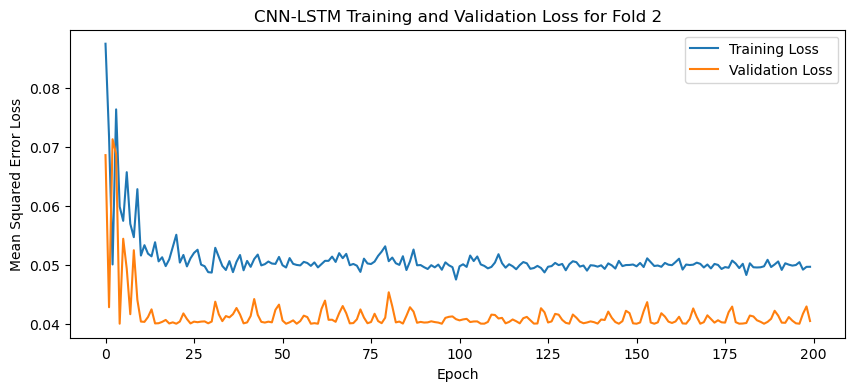

84
84
1


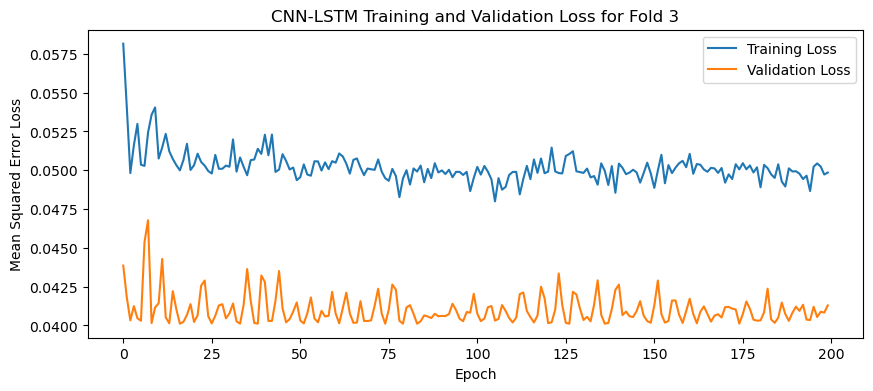

84
84
1


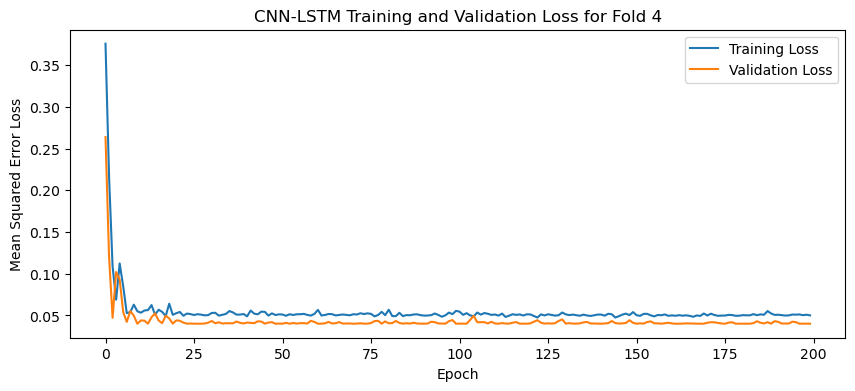

[I 2025-05-06 14:21:32,220] Trial 61 finished with value: 0.04064524844288826 and parameters: {'lr': 0.0014407718890063913, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.21173546393596146}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


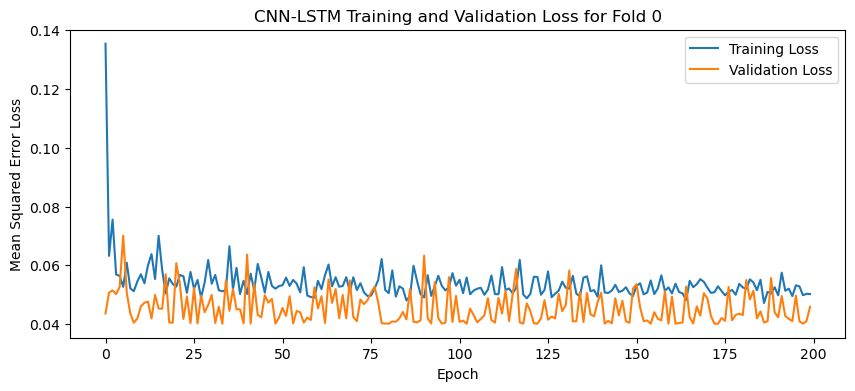

84
84
1


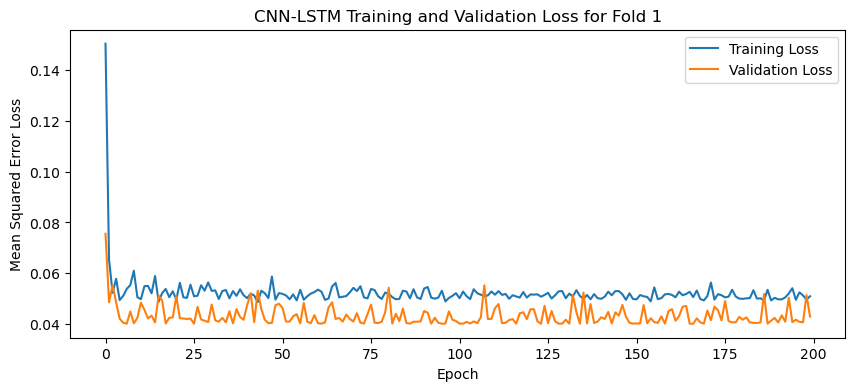

84
84
1


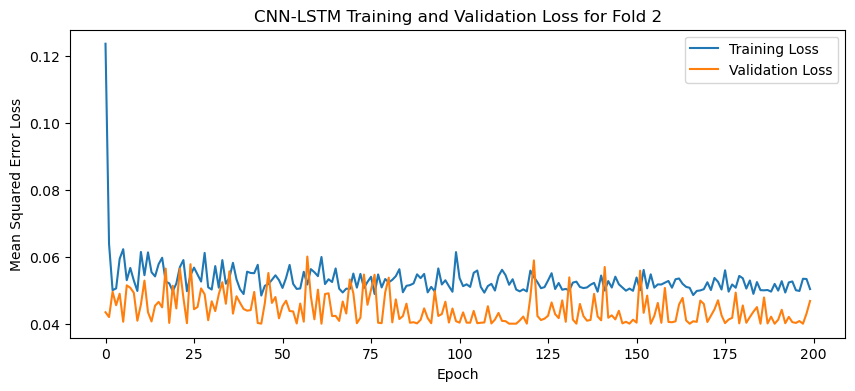

84
84
1


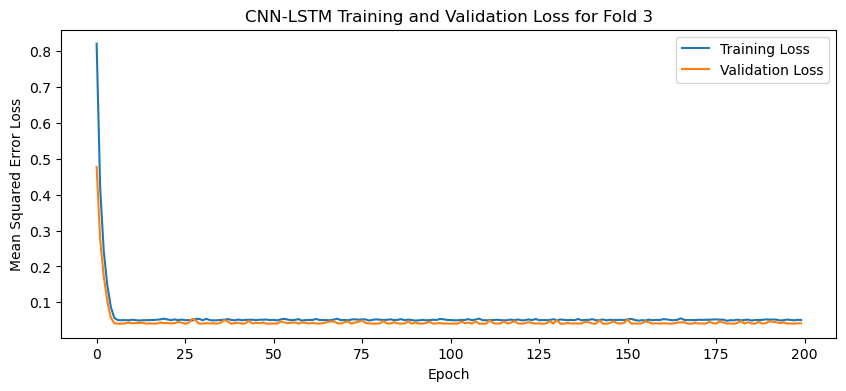

84
84
1


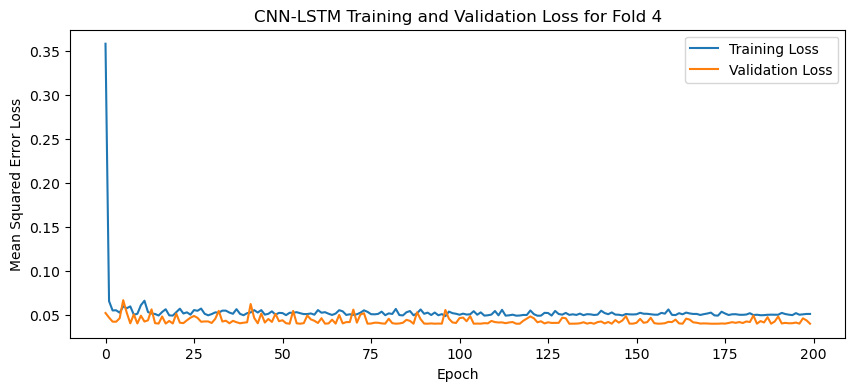

[I 2025-05-06 14:23:03,882] Trial 62 finished with value: 0.043389351665973665 and parameters: {'lr': 0.0020252524954155965, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.1661065010328855}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


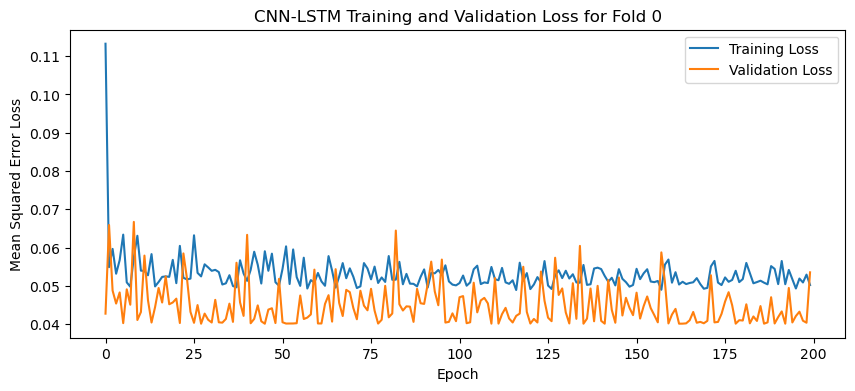

84
84
1


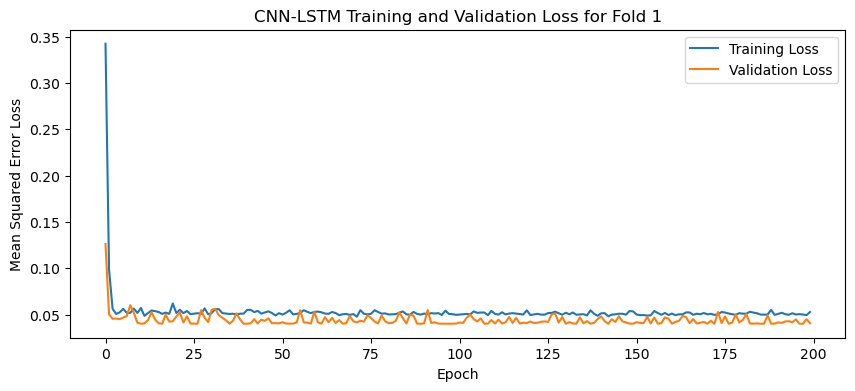

84
84
1


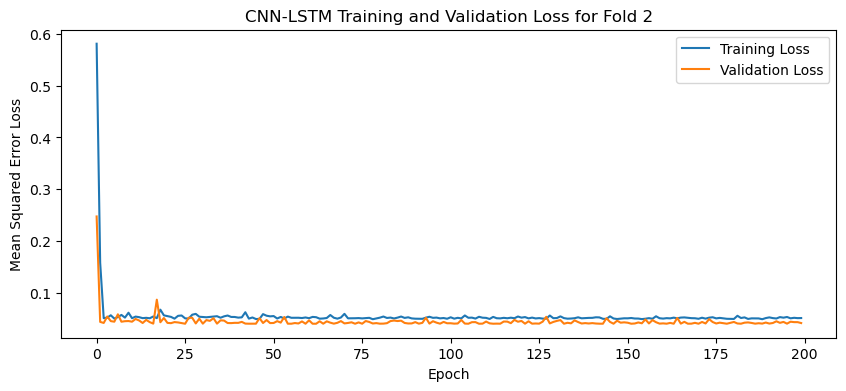

84
84
1


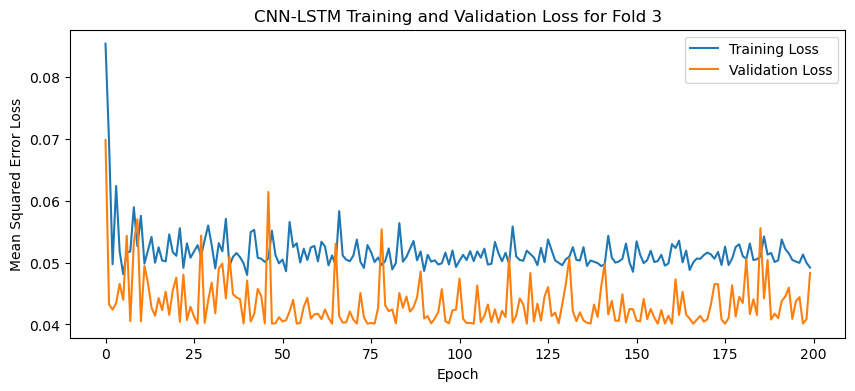

84
84
1


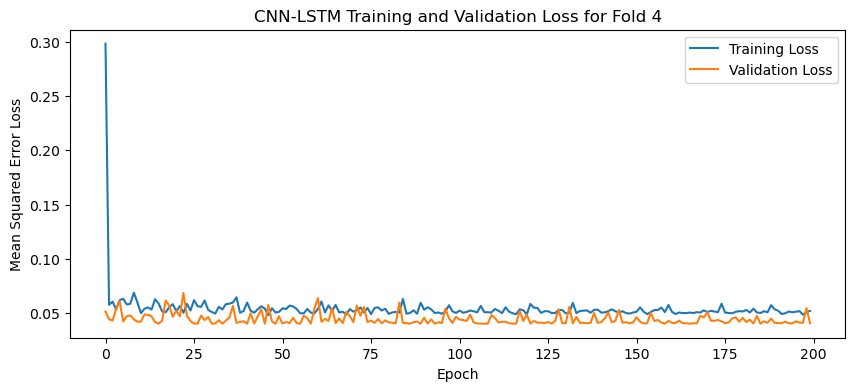

[I 2025-05-06 14:24:34,929] Trial 63 finished with value: 0.04489533603191376 and parameters: {'lr': 0.0016182183630740862, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.1742657096209747}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


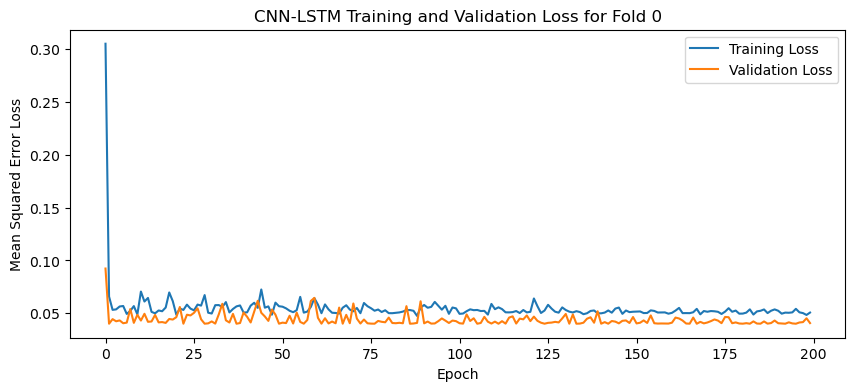

84
84
1


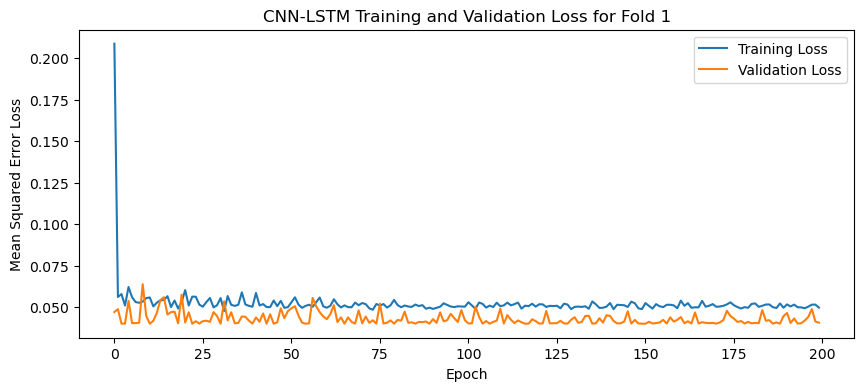

84
84
1


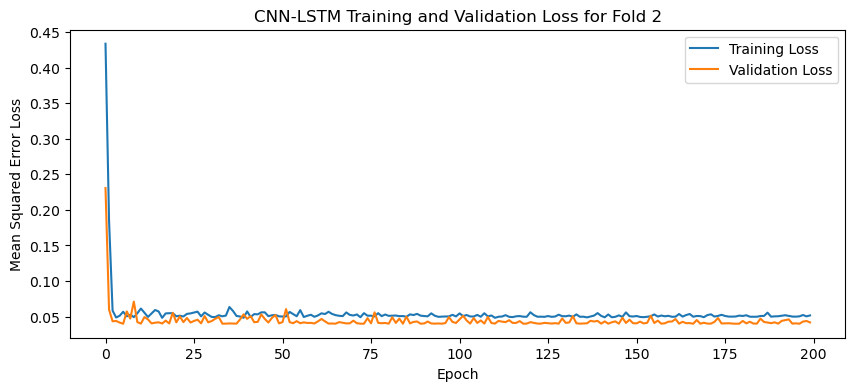

84
84
1


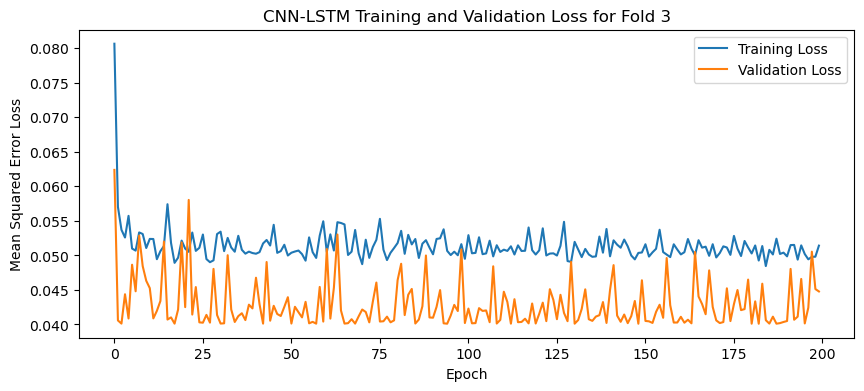

84
84
1


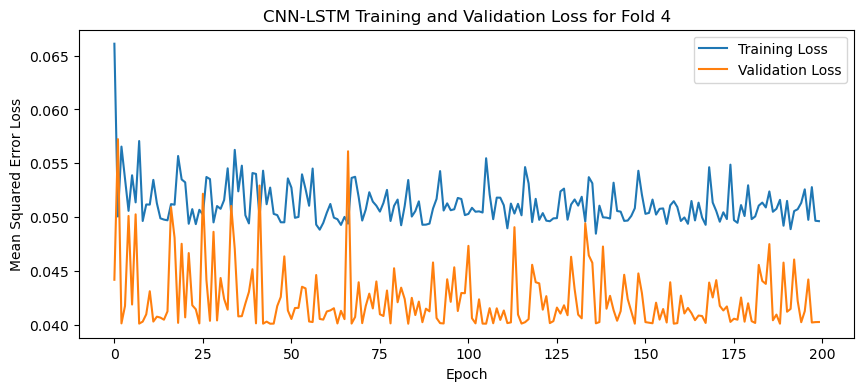

[I 2025-05-06 14:26:12,002] Trial 64 finished with value: 0.04168894961476326 and parameters: {'lr': 0.0013530865051550307, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.19431572418381618}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


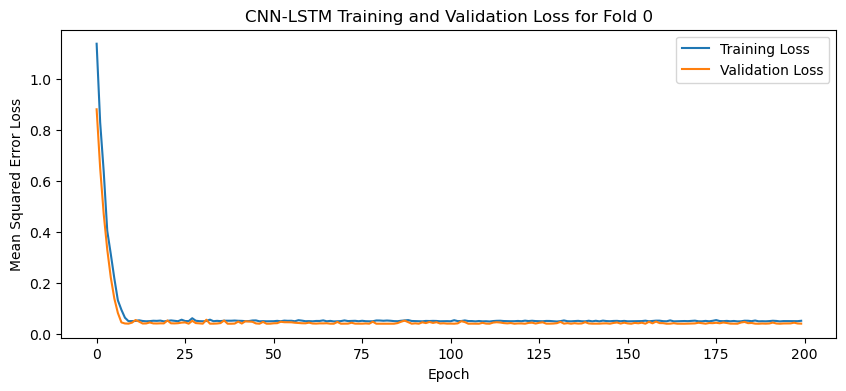

84
84
1


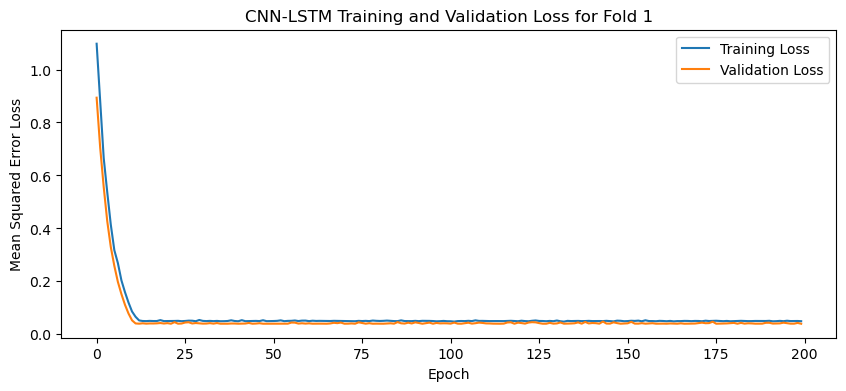

84
84
1


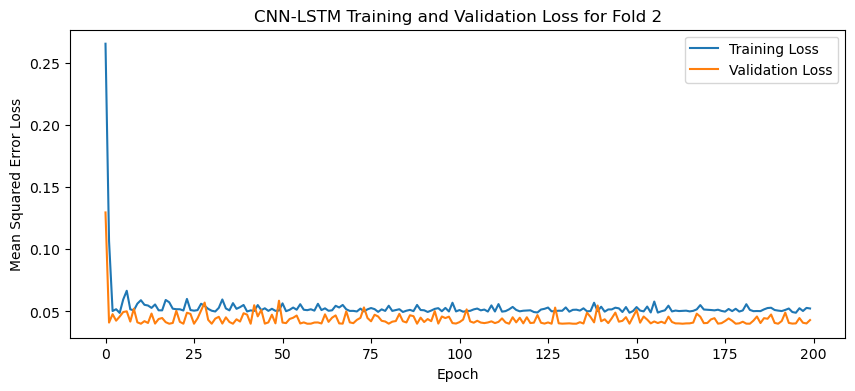

84
84
1


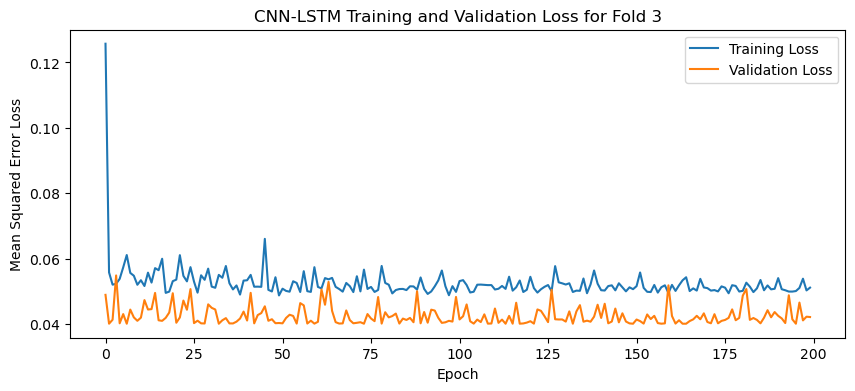

84
84
1


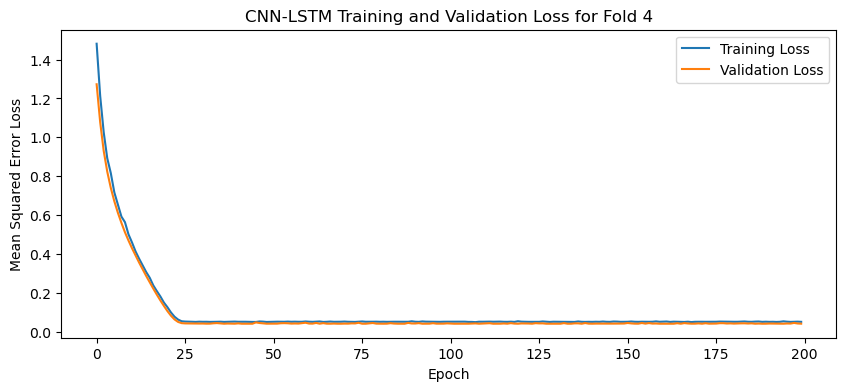

[I 2025-05-06 14:27:49,474] Trial 65 finished with value: 0.04123004153370857 and parameters: {'lr': 0.001186940424222973, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.3032915682148115}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


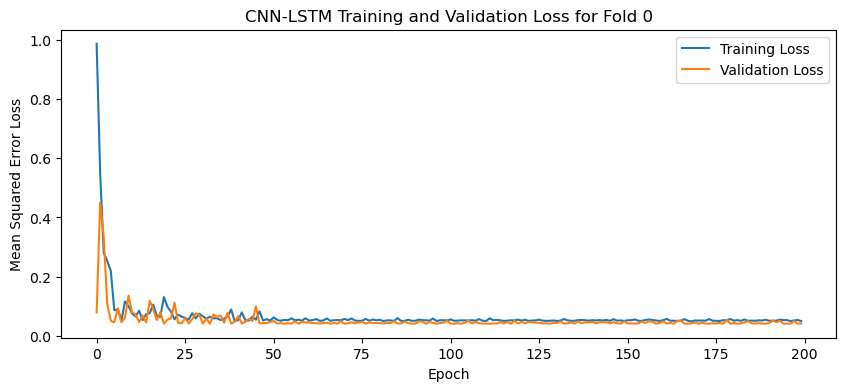

84
84
1


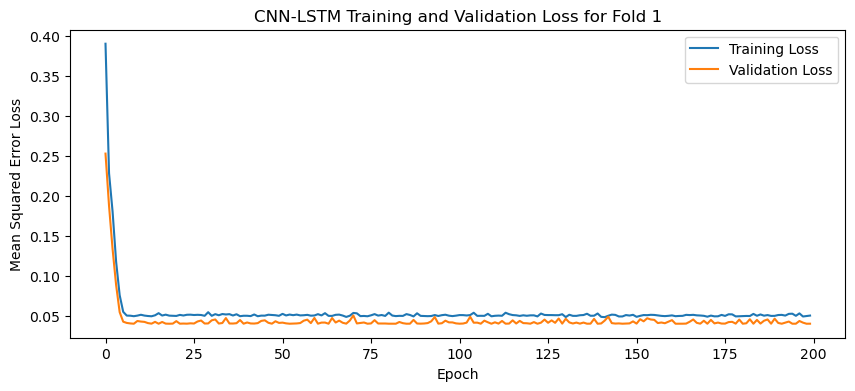

84
84
1


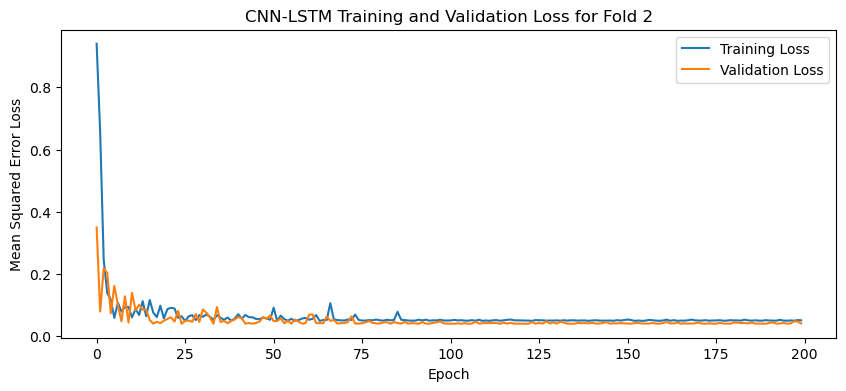

84
84
1


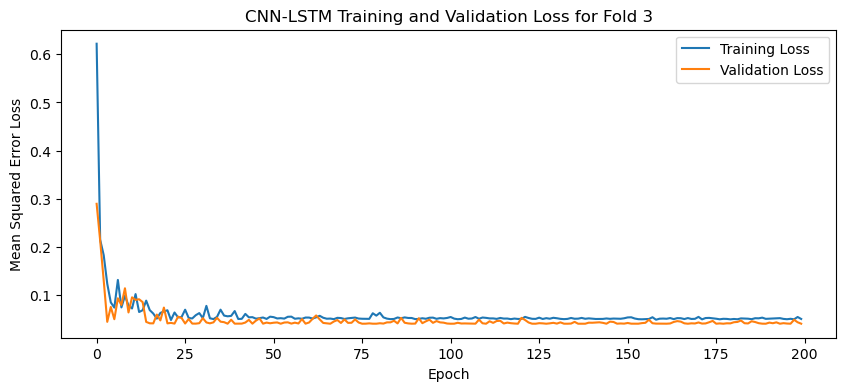

84
84
1


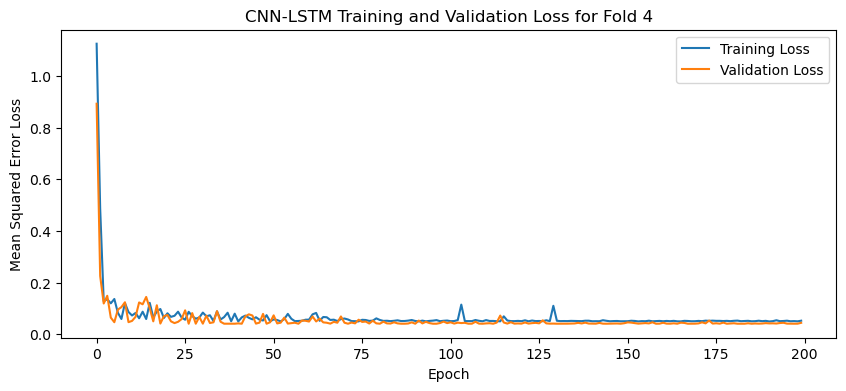

[I 2025-05-06 14:29:25,055] Trial 66 finished with value: 0.04124659970402718 and parameters: {'lr': 0.014275340799076297, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 128, 'dropout_rate': 0.22730026091128588}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


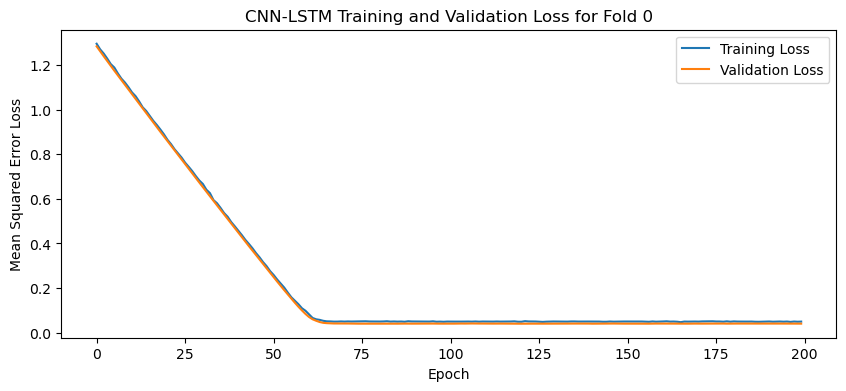

84
84
1


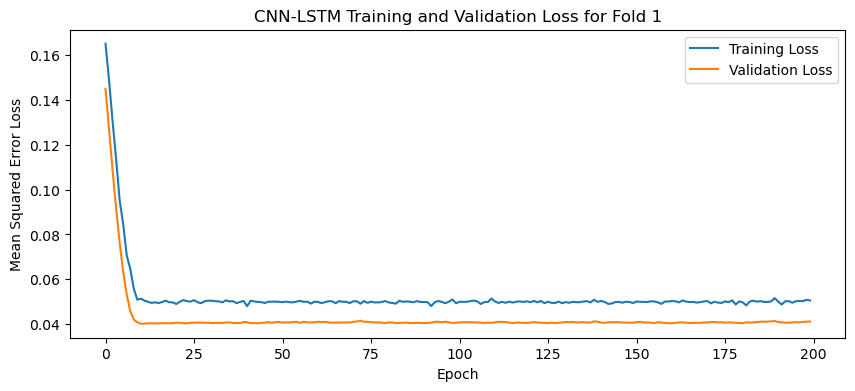

84
84
1


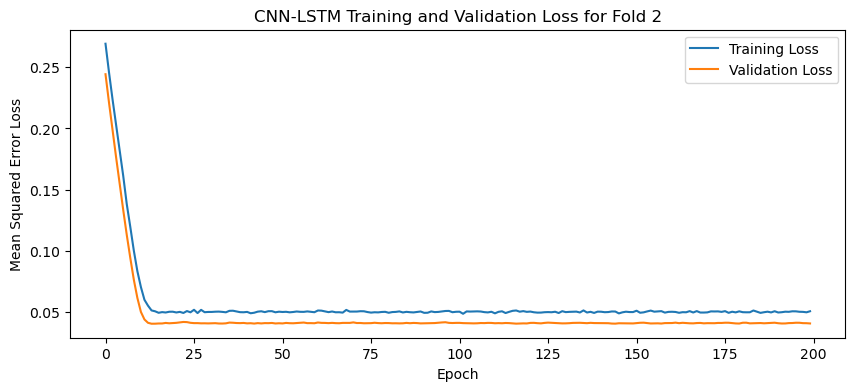

84
84
1


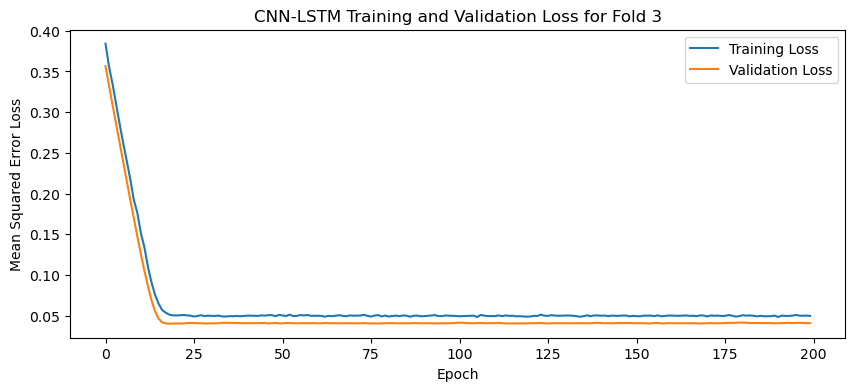

84
84
1


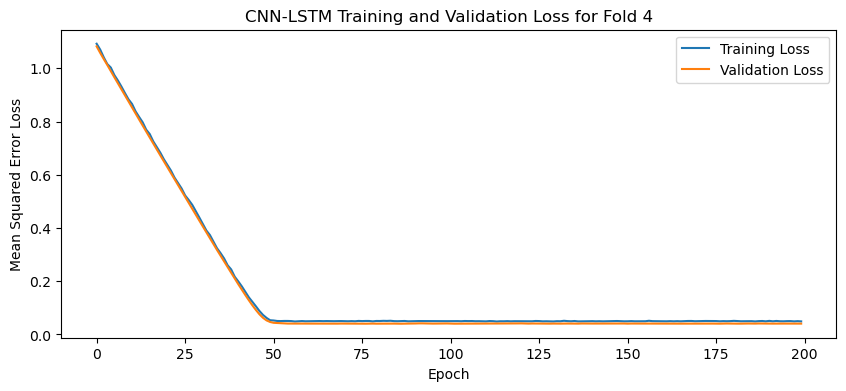

[I 2025-05-06 14:30:56,669] Trial 67 finished with value: 0.04068765863776207 and parameters: {'lr': 0.002063083778183155, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.13534767586118612}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


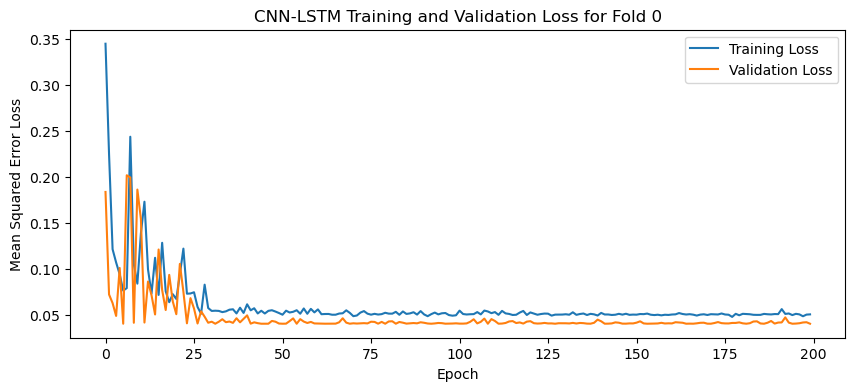

84
84
1


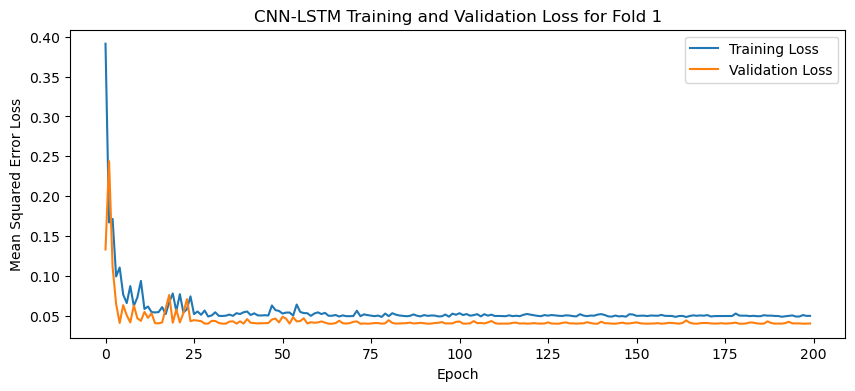

84
84
1


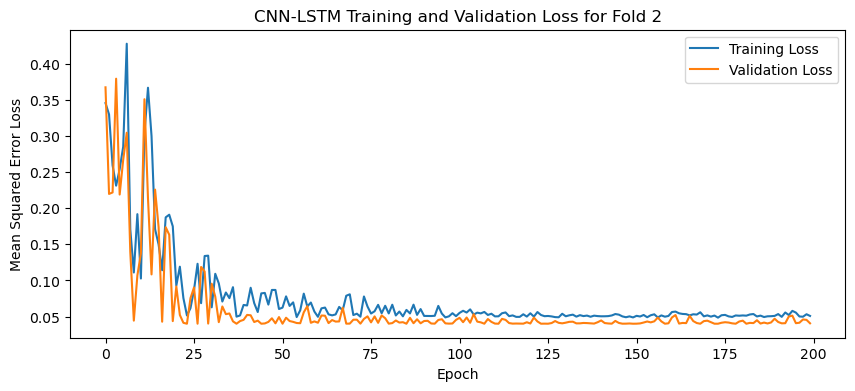

84
84
1


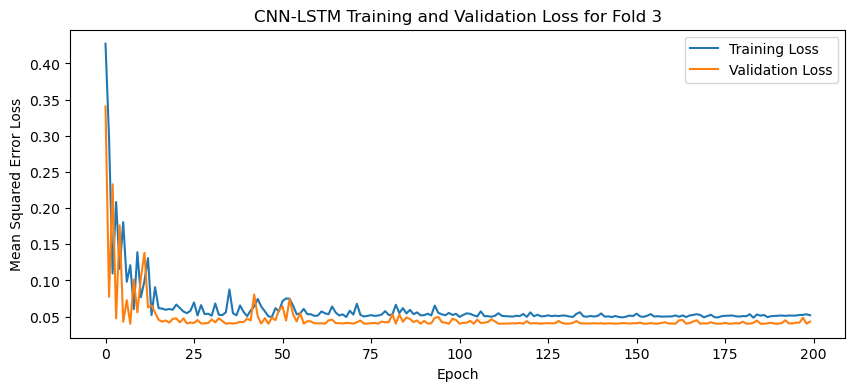

84
84
1


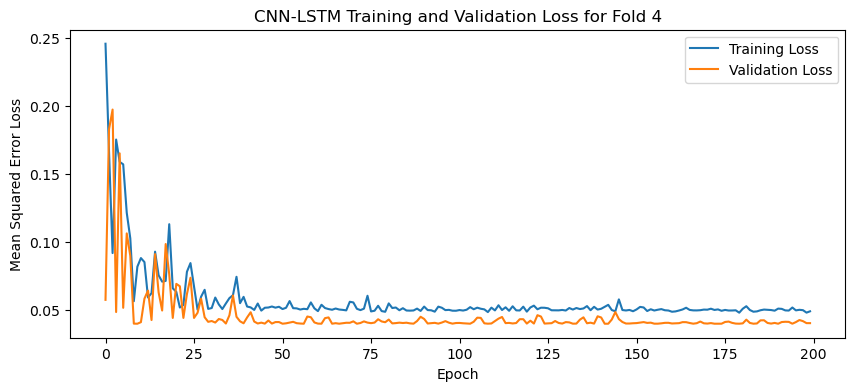

[I 2025-05-06 14:32:22,073] Trial 68 finished with value: 0.040938492864370346 and parameters: {'lr': 0.002433343819129099, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 128, 'dropout_rate': 0.23567234940436524}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


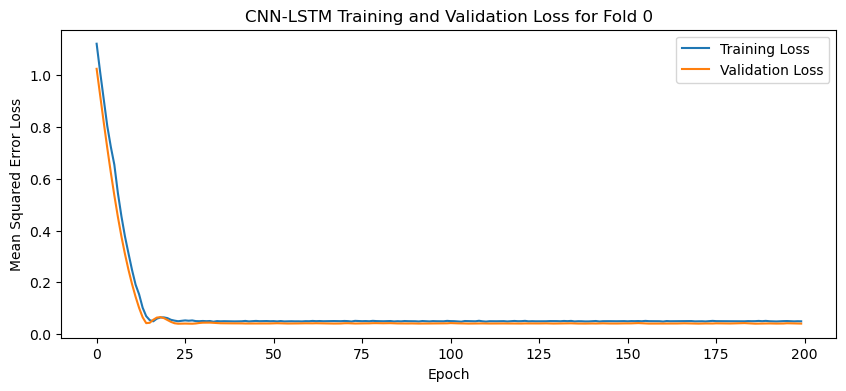

84
84
1


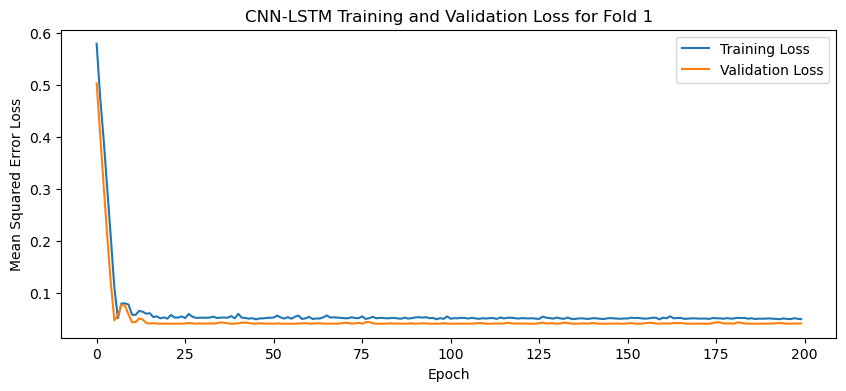

84
84
1


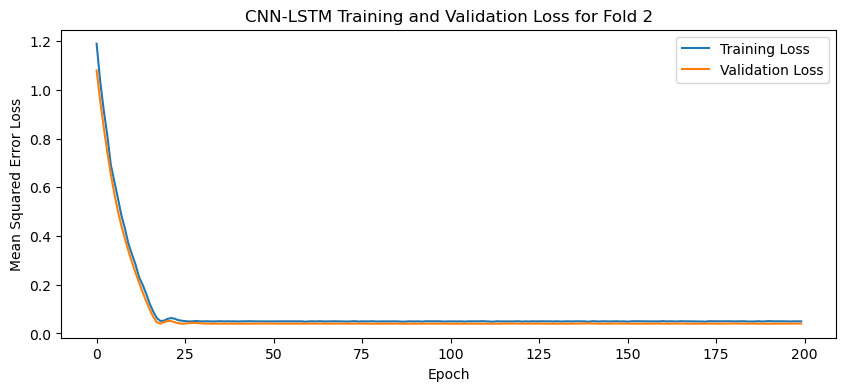

84
84
1


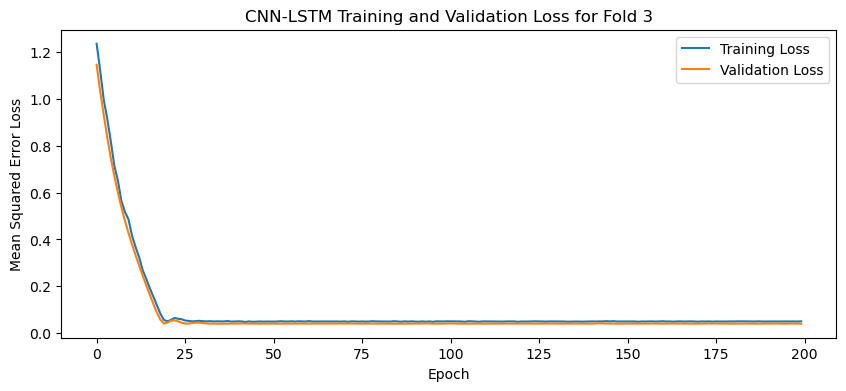

84
84
1


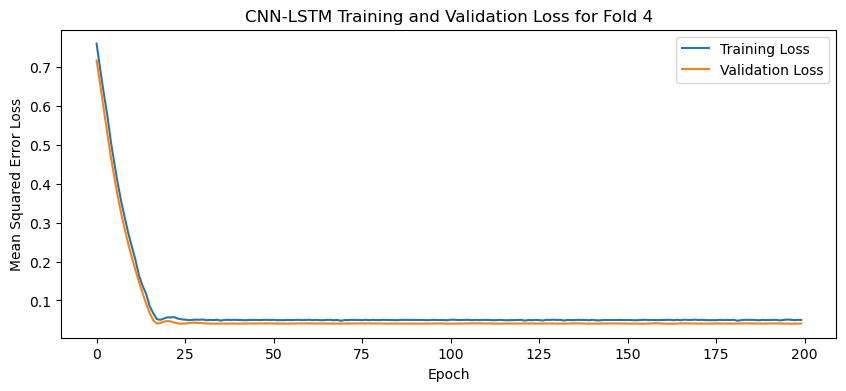

[I 2025-05-06 14:33:48,387] Trial 69 finished with value: 0.04061320349574089 and parameters: {'lr': 0.0011453450850433583, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.3353406530083405}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


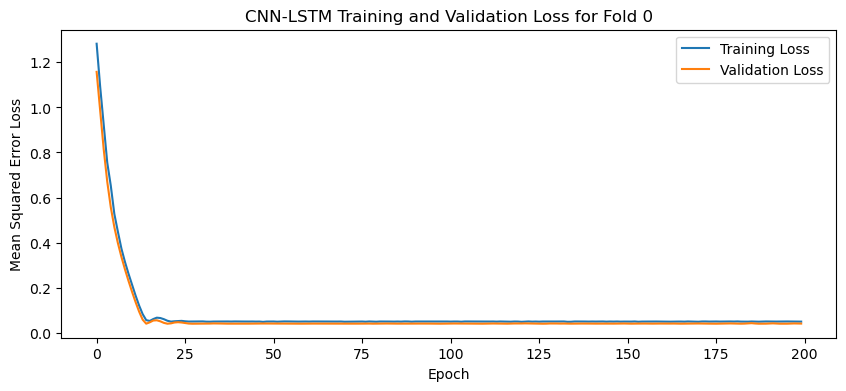

84
84
1


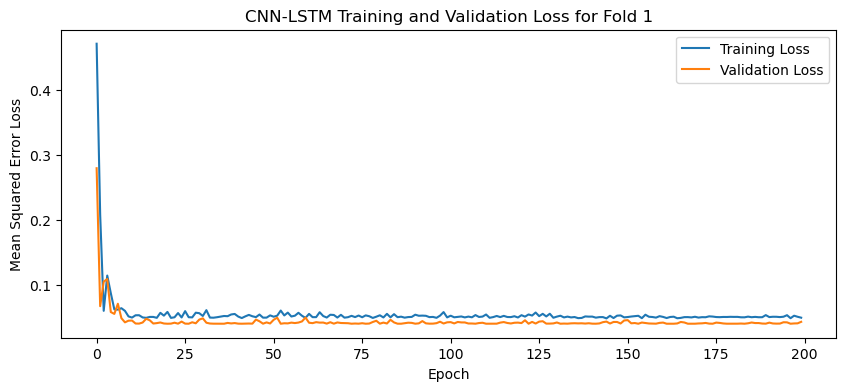

84
84
1


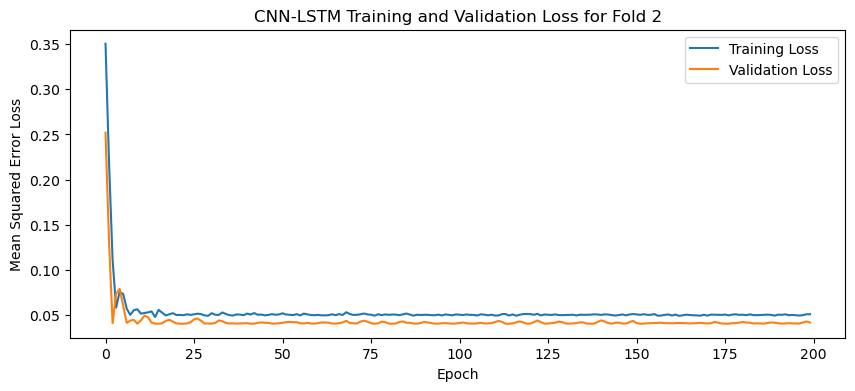

84
84
1


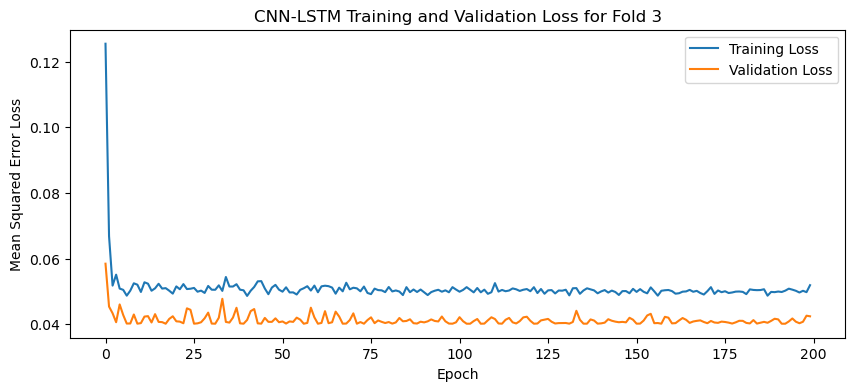

84
84
1


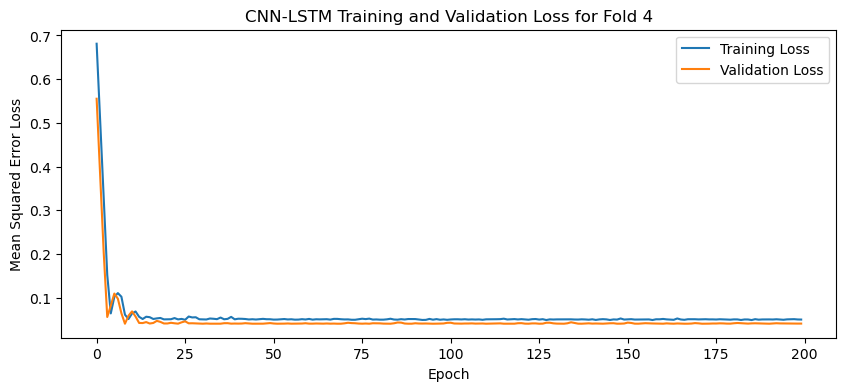

[I 2025-05-06 14:35:24,024] Trial 70 finished with value: 0.041610421240329744 and parameters: {'lr': 0.0016284211452283642, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.11543380434980488}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


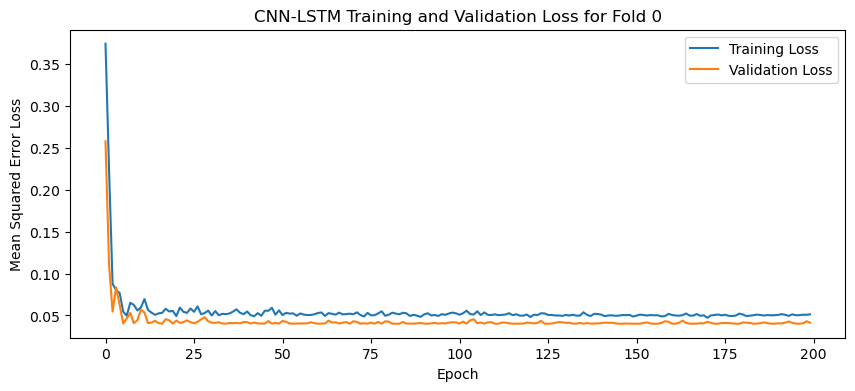

84
84
1


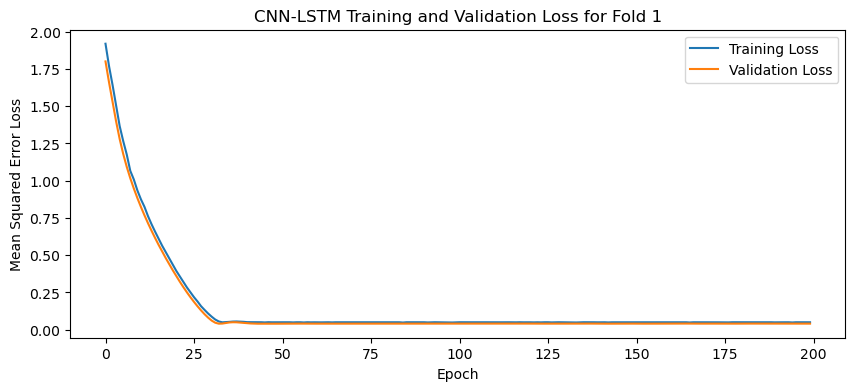

84
84
1


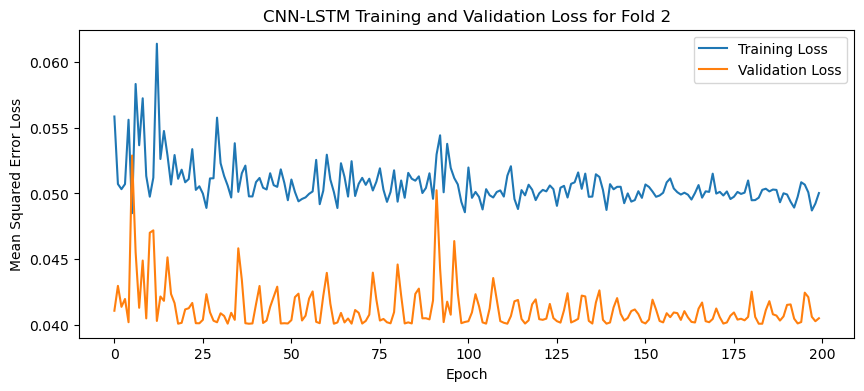

84
84
1


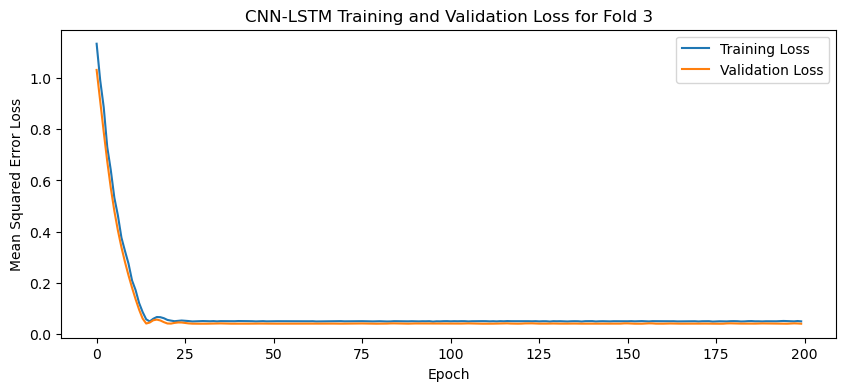

84
84
1


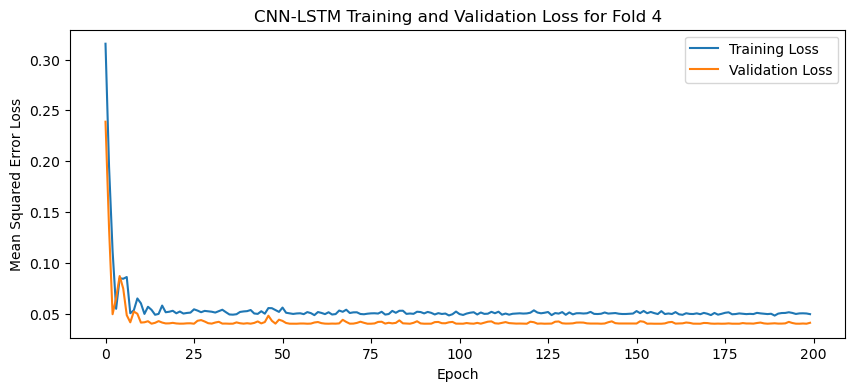

[I 2025-05-06 14:37:04,159] Trial 71 finished with value: 0.04075519666075707 and parameters: {'lr': 0.0014046858601932657, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.2599512061237443}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


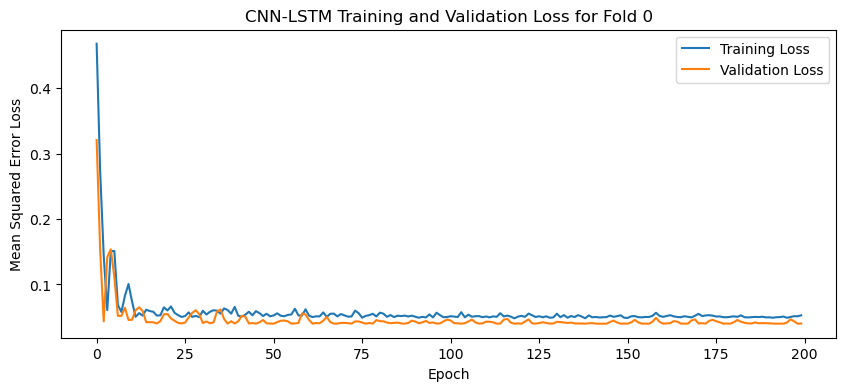

84
84
1


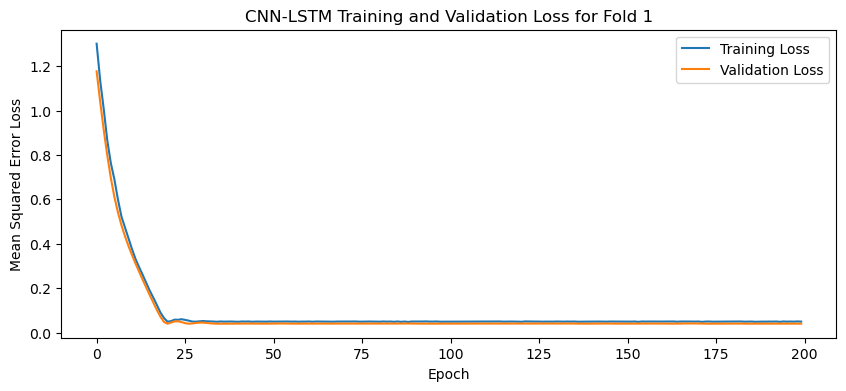

84
84
1


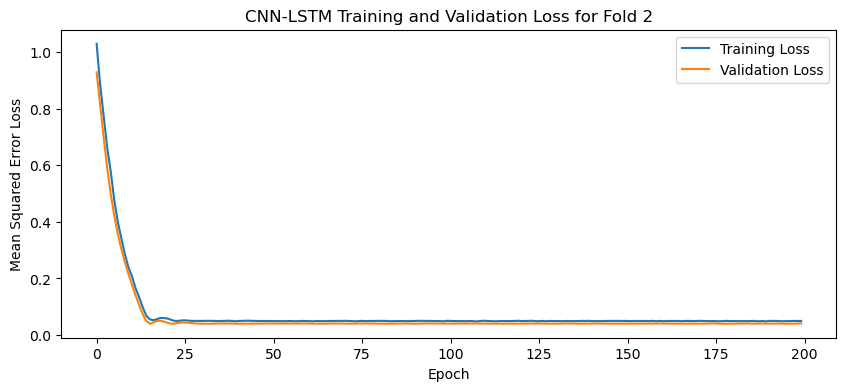

84
84
1


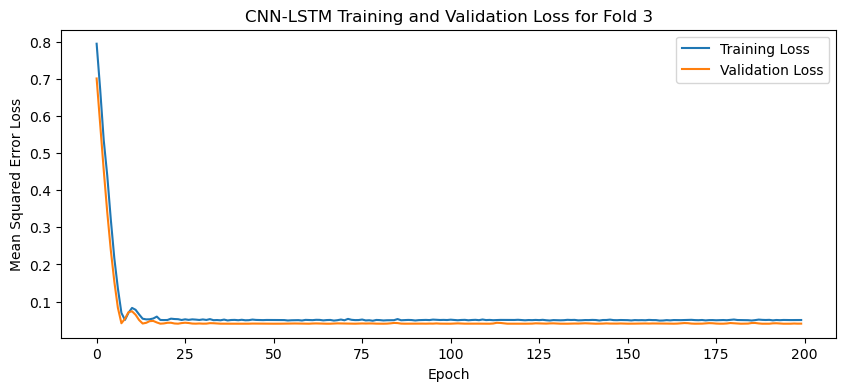

84
84
1


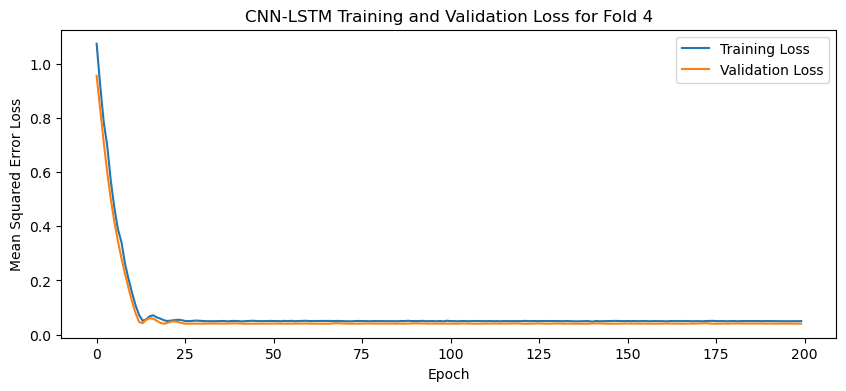

[I 2025-05-06 14:38:42,003] Trial 72 finished with value: 0.04055069237947464 and parameters: {'lr': 0.0014173612586015068, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.2771206150318891}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


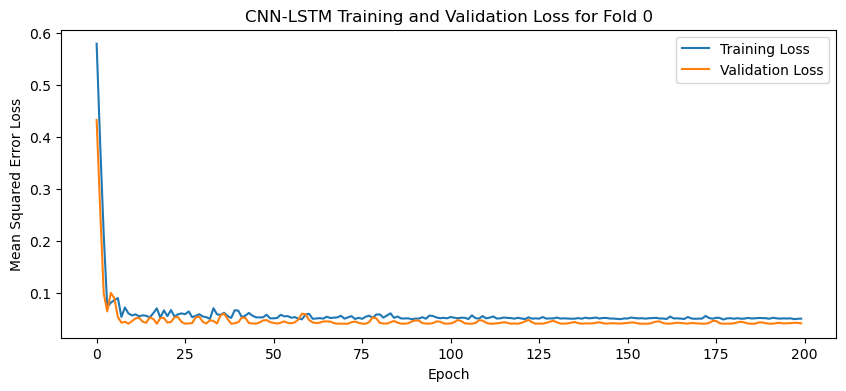

84
84
1


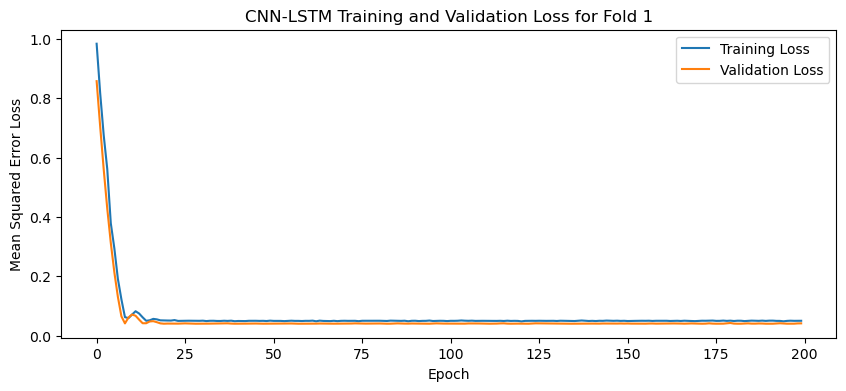

84
84
1


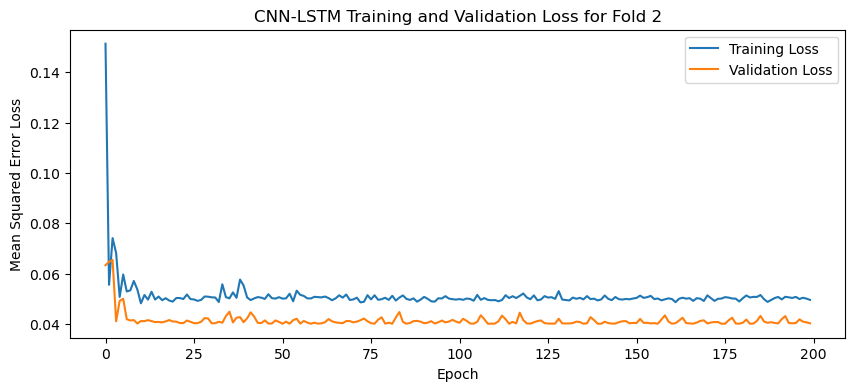

84
84
1


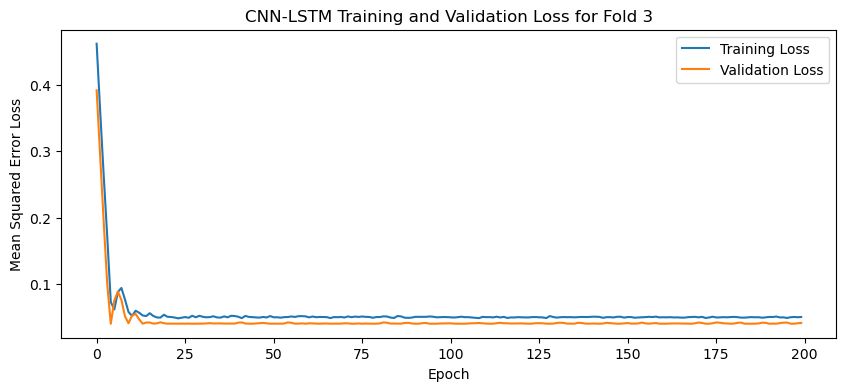

84
84
1


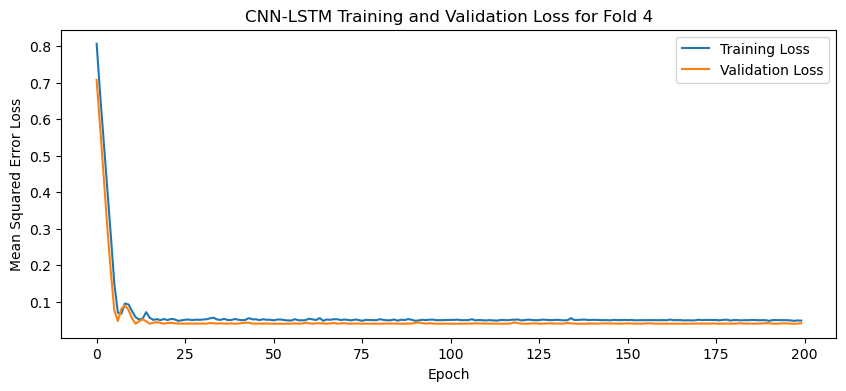

[I 2025-05-06 14:40:24,118] Trial 73 finished with value: 0.04104829952120781 and parameters: {'lr': 0.0018399343012361685, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.3130645918789154}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


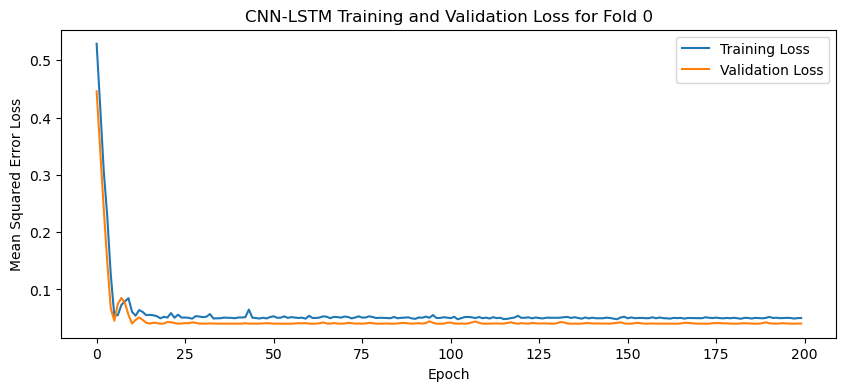

84
84
1


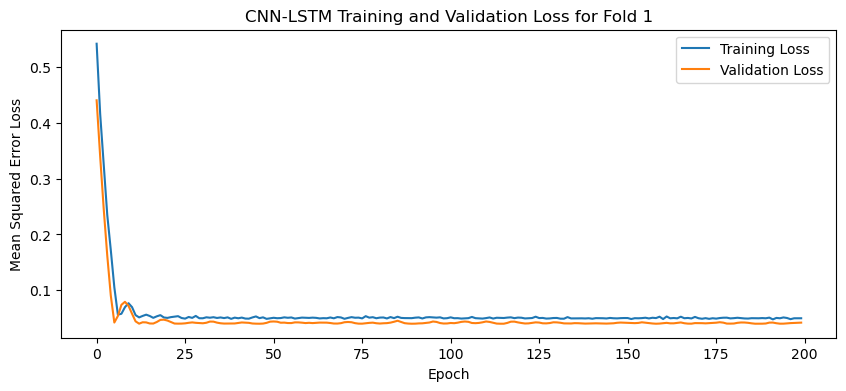

84
84
1


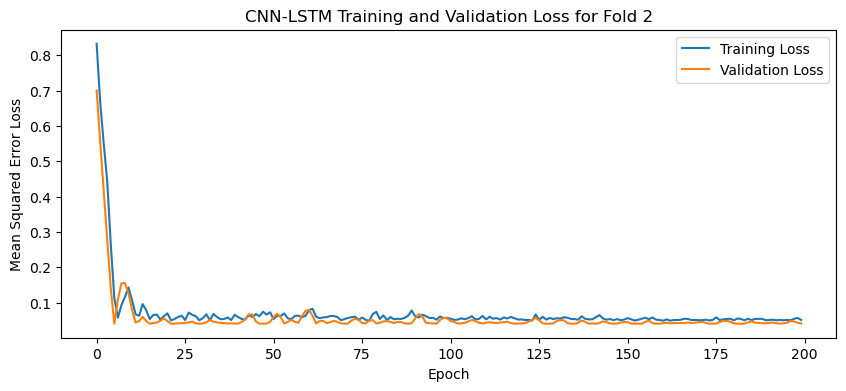

84
84
1


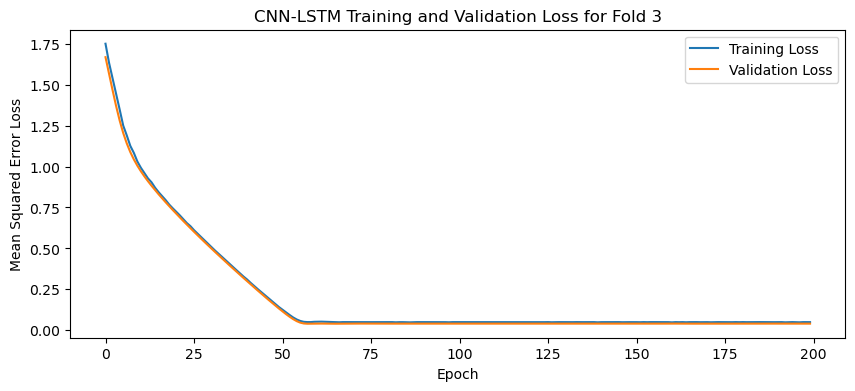

84
84
1


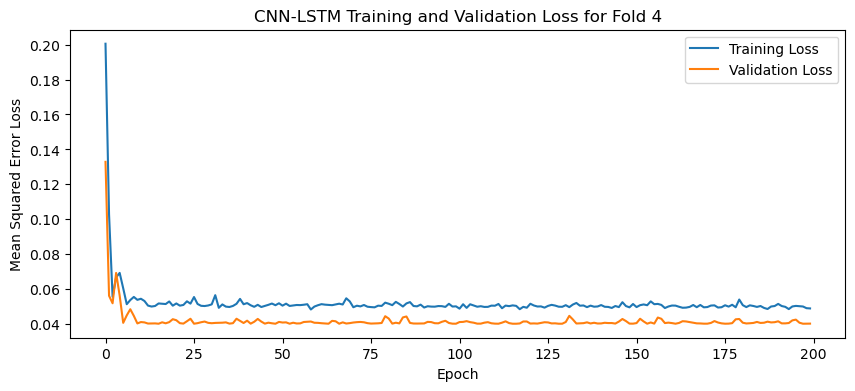

[I 2025-05-06 14:41:56,478] Trial 74 finished with value: 0.04082580655813217 and parameters: {'lr': 0.0011275510518297157, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.2789554140776941}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


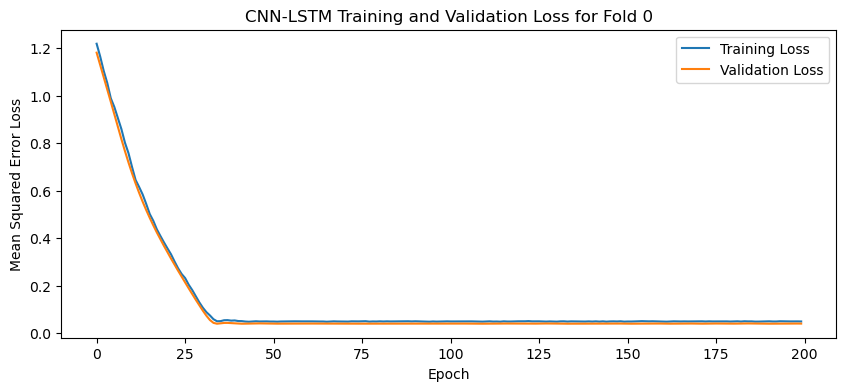

84
84
1


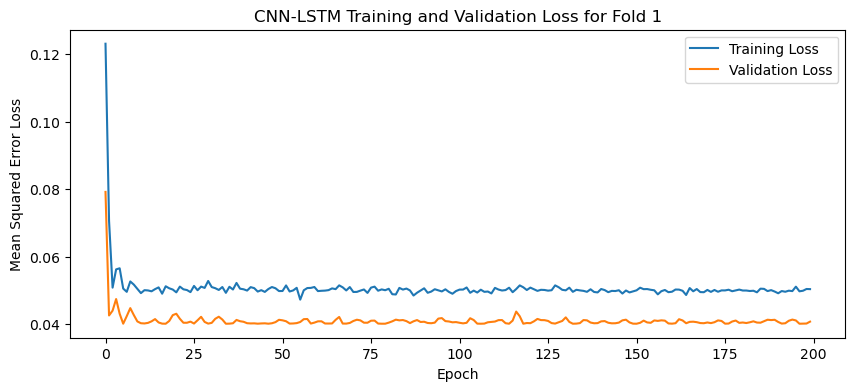

84
84
1


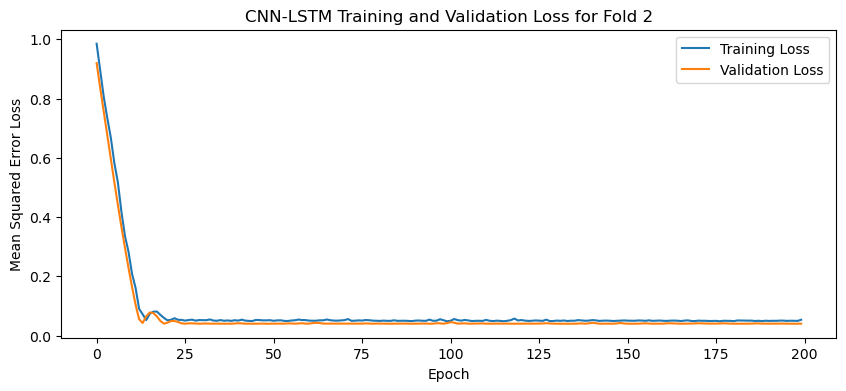

84
84
1


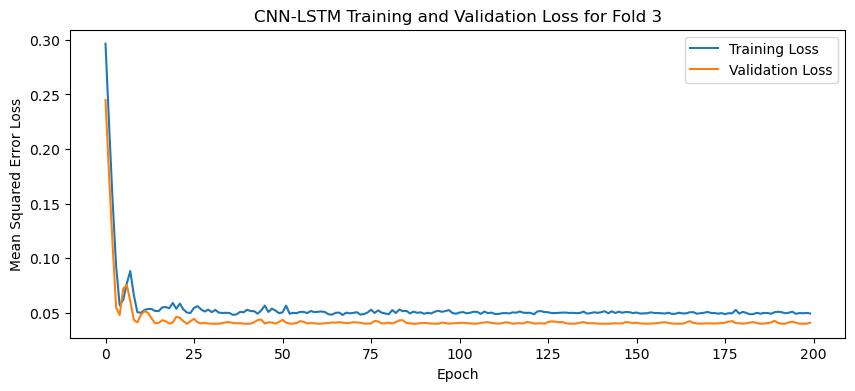

84
84
1


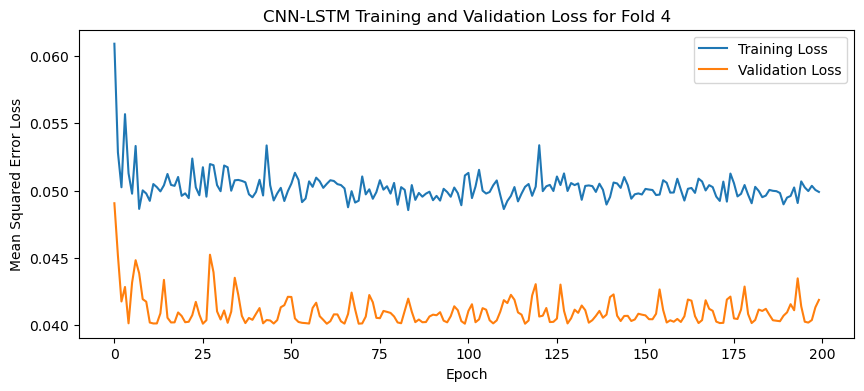

[I 2025-05-06 14:43:15,338] Trial 75 finished with value: 0.04088873714208603 and parameters: {'lr': 0.0012732066954480872, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 64, 'dropout_rate': 0.28502246463440223}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


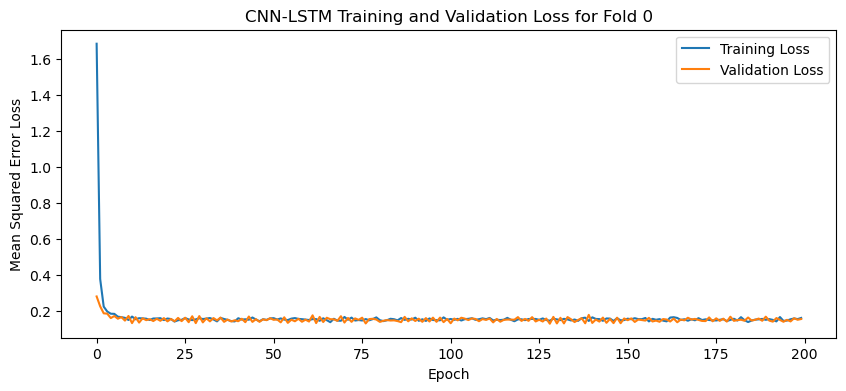

84
84
1


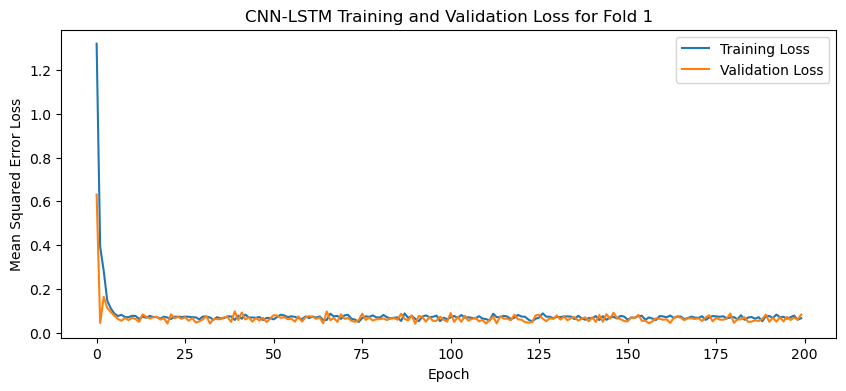

84
84
1


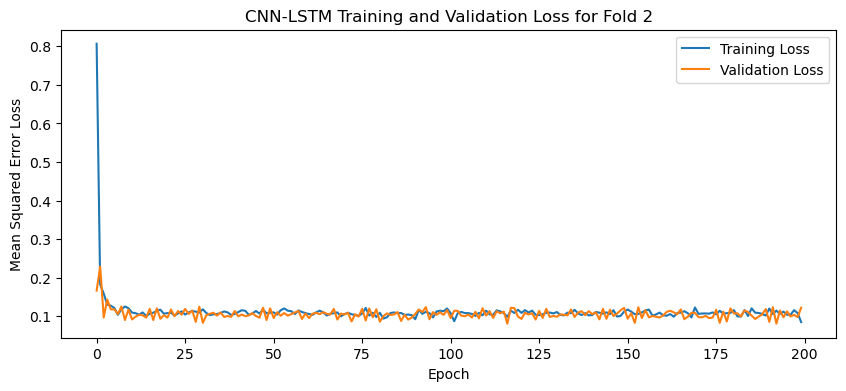

84
84
1


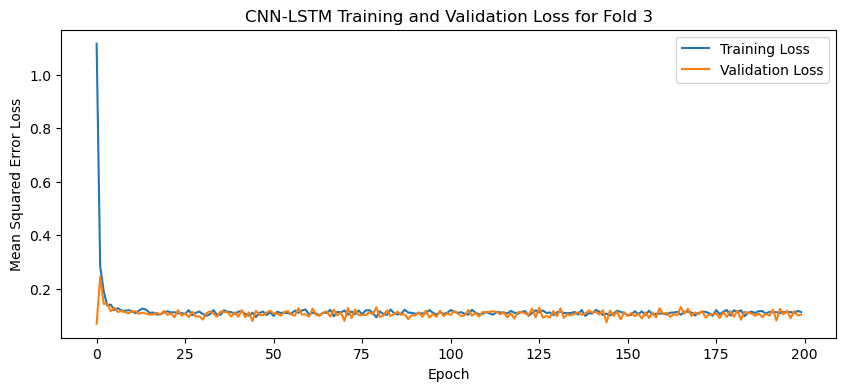

84
84
1


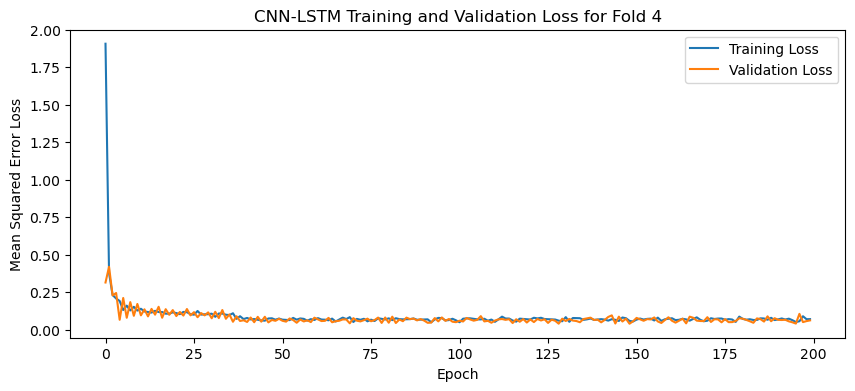

[I 2025-05-06 14:44:45,473] Trial 76 finished with value: 0.10502424612641334 and parameters: {'lr': 0.09663636494400794, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.36270910290967645}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


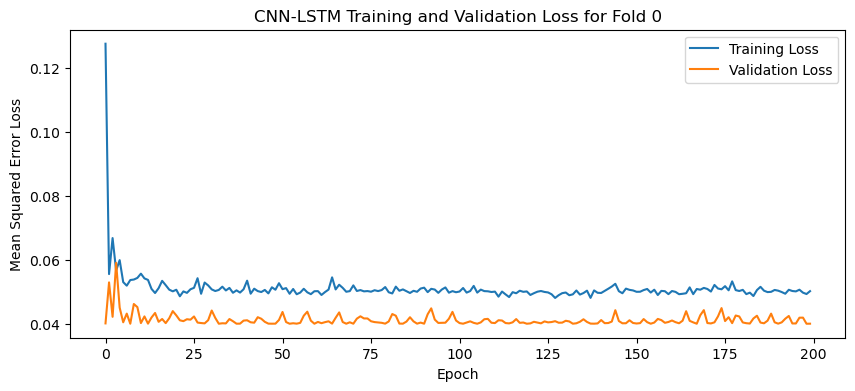

84
84
1


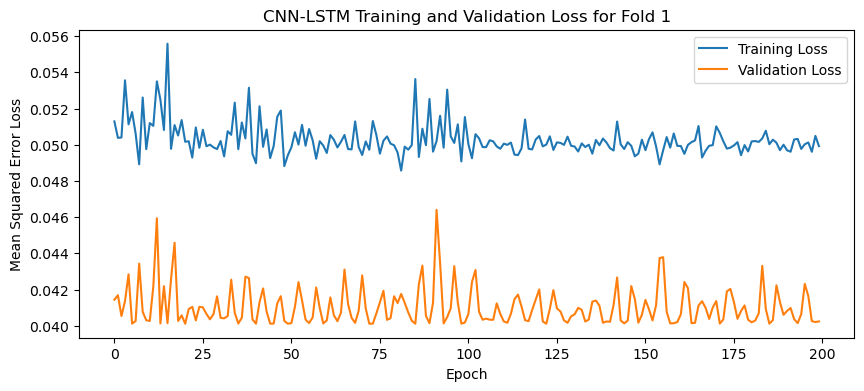

84
84
1


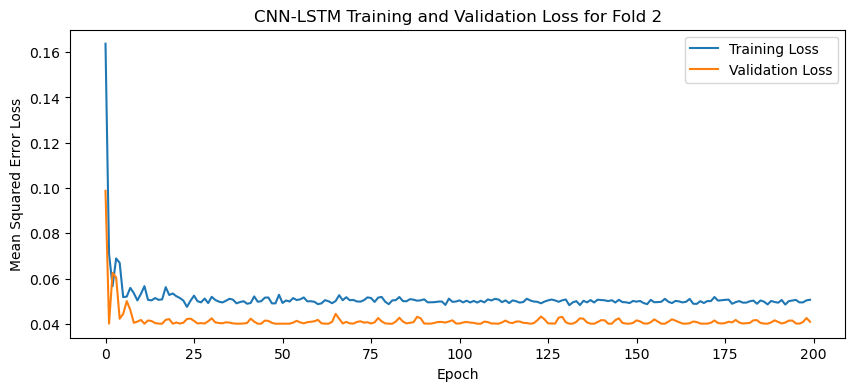

84
84
1


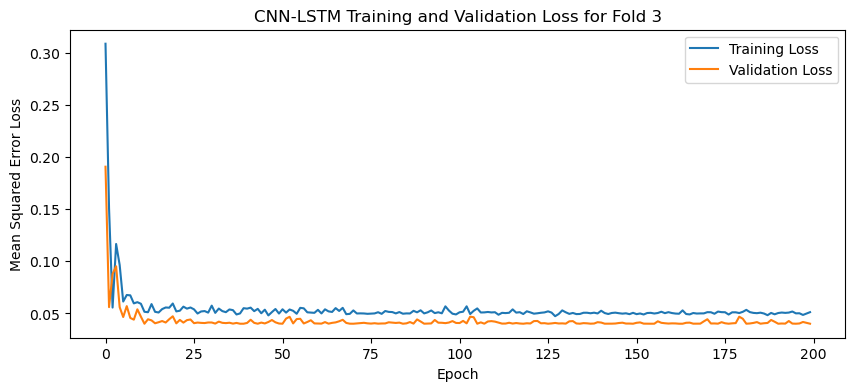

84
84
1


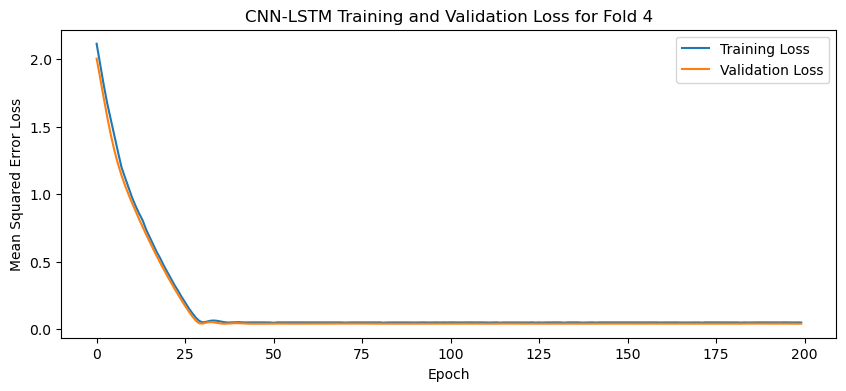

[I 2025-05-06 14:46:10,188] Trial 77 finished with value: 0.04035771191120148 and parameters: {'lr': 0.0015572188105955358, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.3225029904579691}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


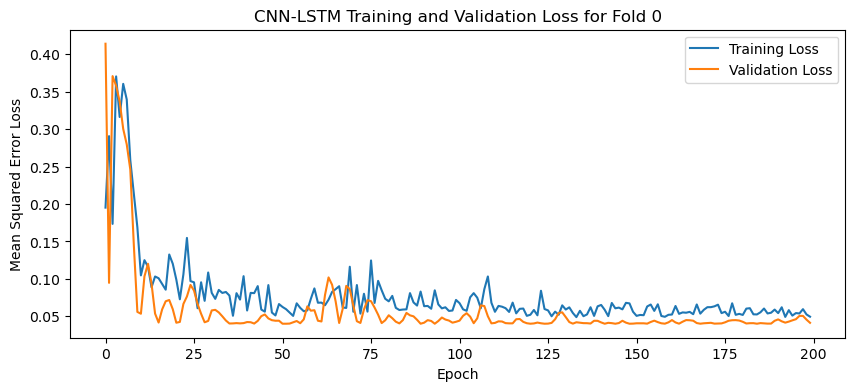

84
84
1


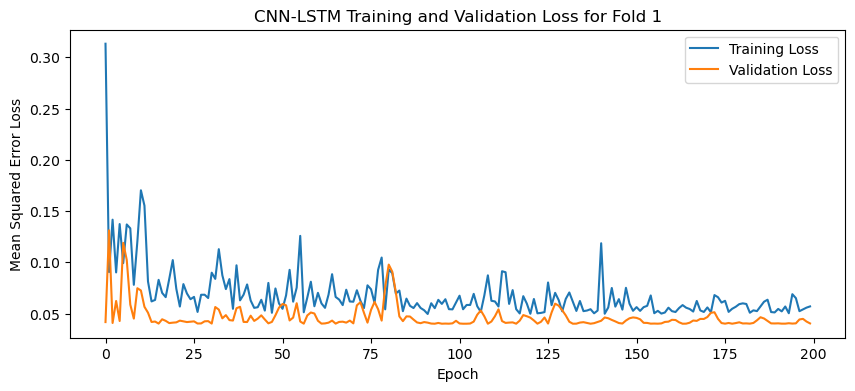

84
84
1


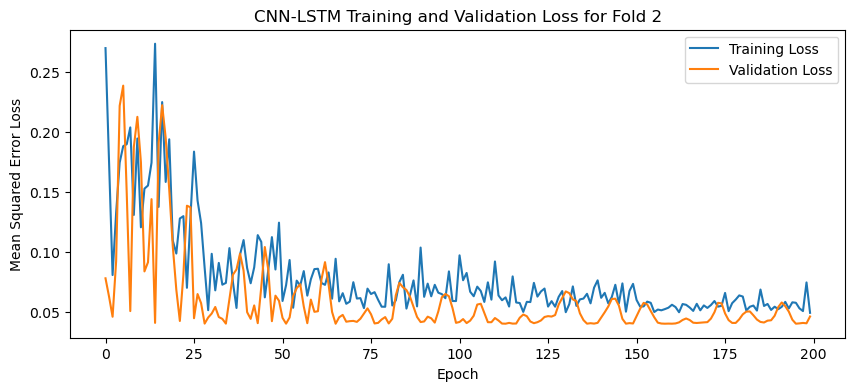

84
84
1


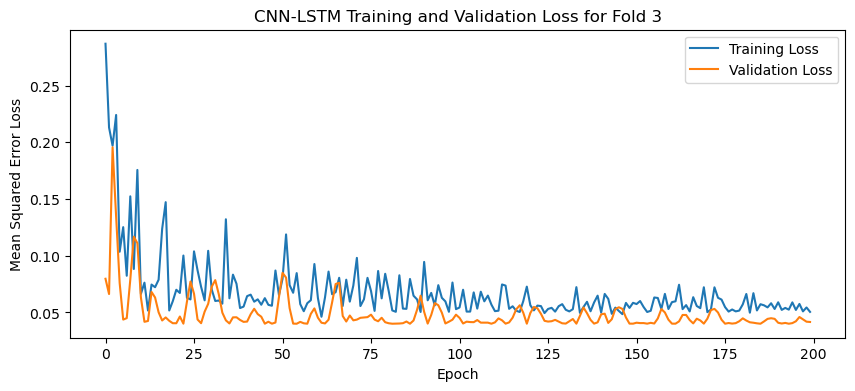

84
84
1


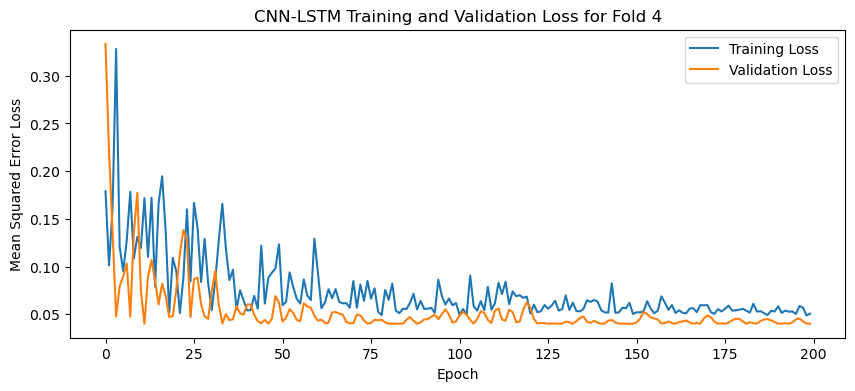

[I 2025-05-06 14:47:34,091] Trial 78 finished with value: 0.04193826466798782 and parameters: {'lr': 0.0015334039772517906, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 128, 'dropout_rate': 0.3857487431062289}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


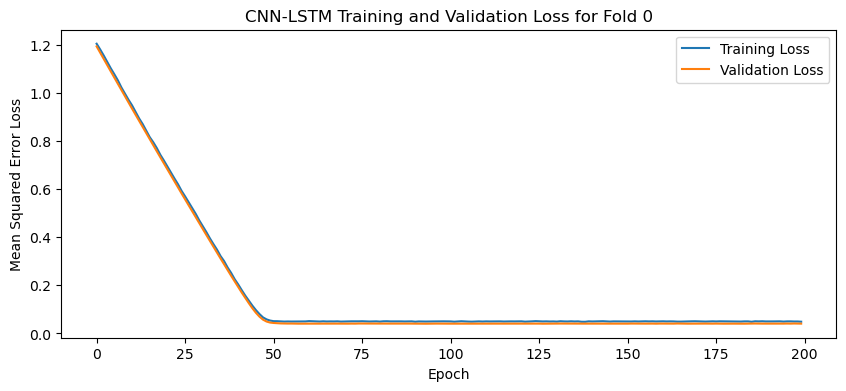

84
84
1


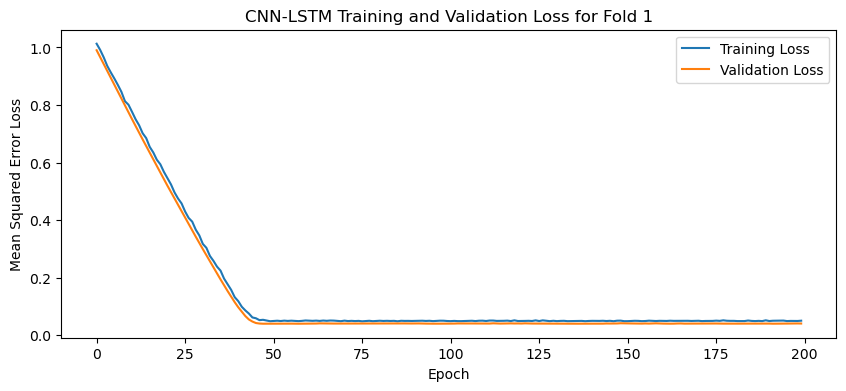

84
84
1


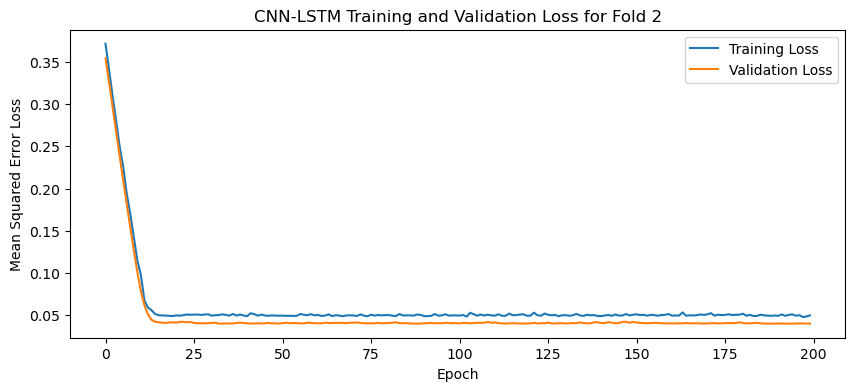

84
84
1


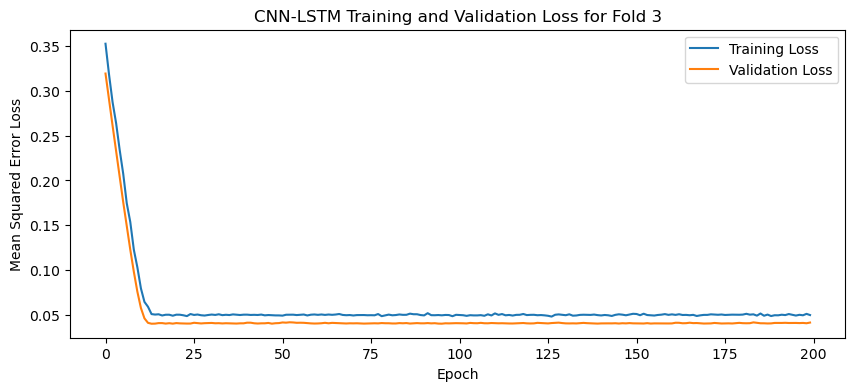

84
84
1


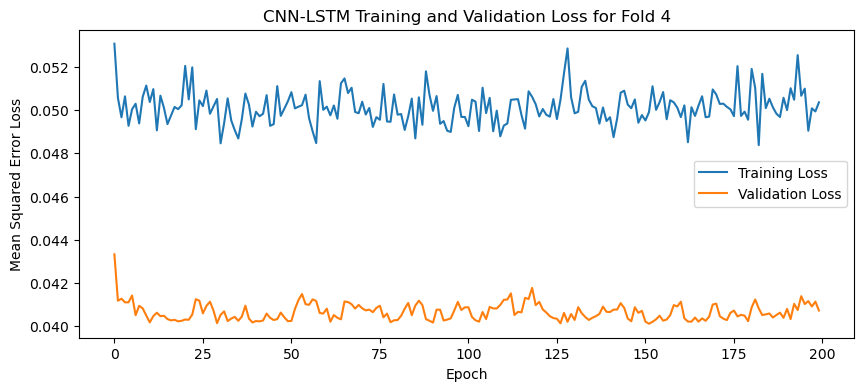

[I 2025-05-06 14:49:04,284] Trial 79 finished with value: 0.04079030379652977 and parameters: {'lr': 0.002621860234696929, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3271047233162423}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


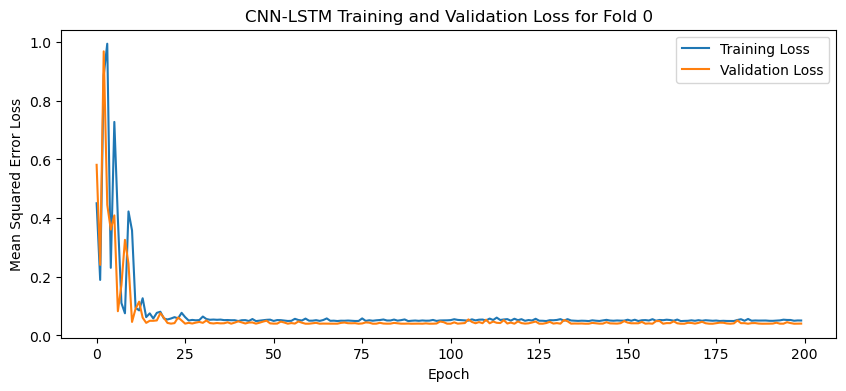

84
84
1


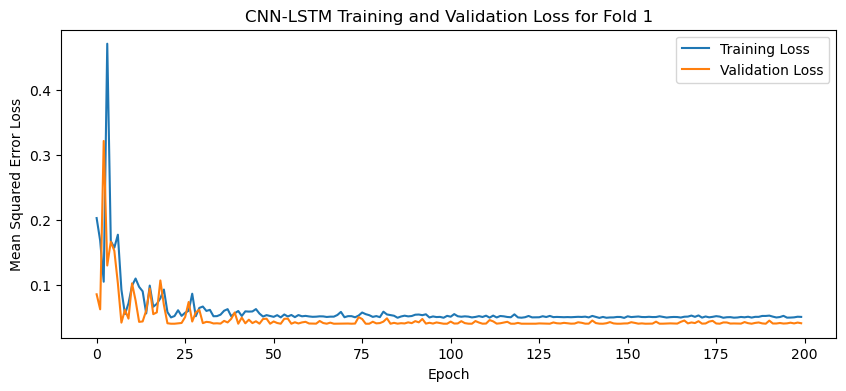

84
84
1


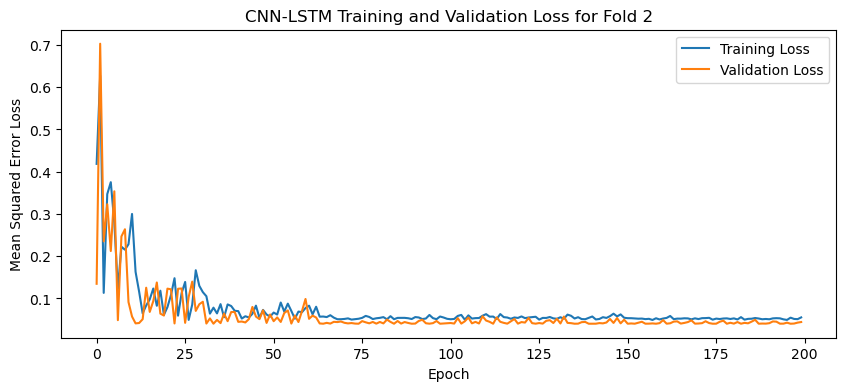

84
84
1


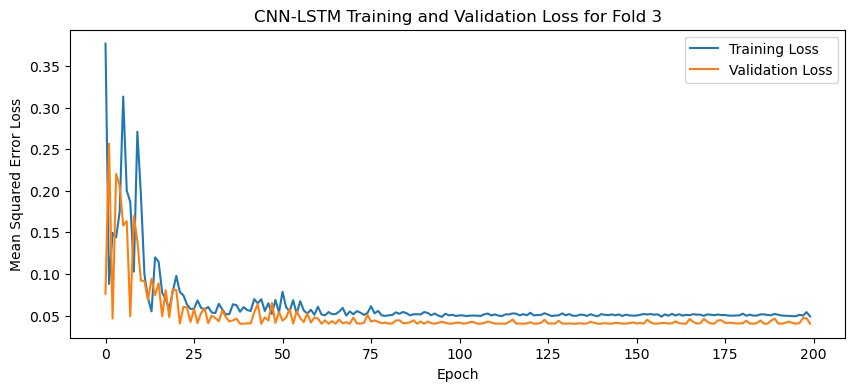

84
84
1


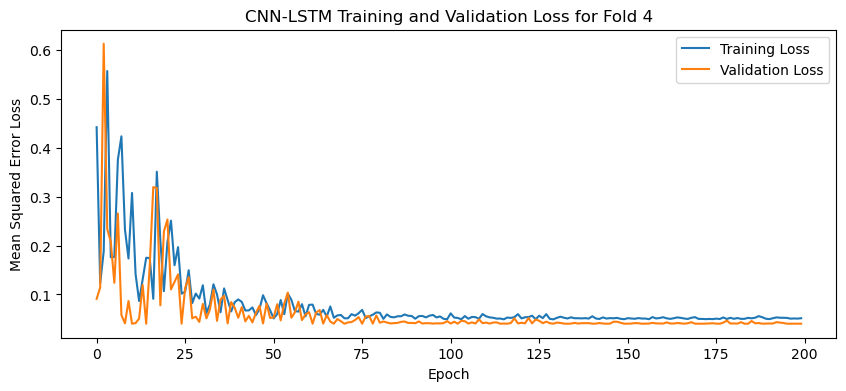

[I 2025-05-06 14:50:29,943] Trial 80 finished with value: 0.041173364222049716 and parameters: {'lr': 0.0037523034768446, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 128, 'dropout_rate': 0.34846558972412106}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


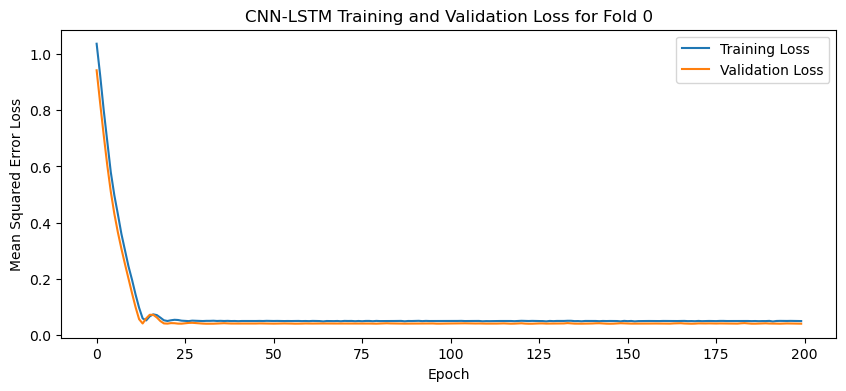

84
84
1


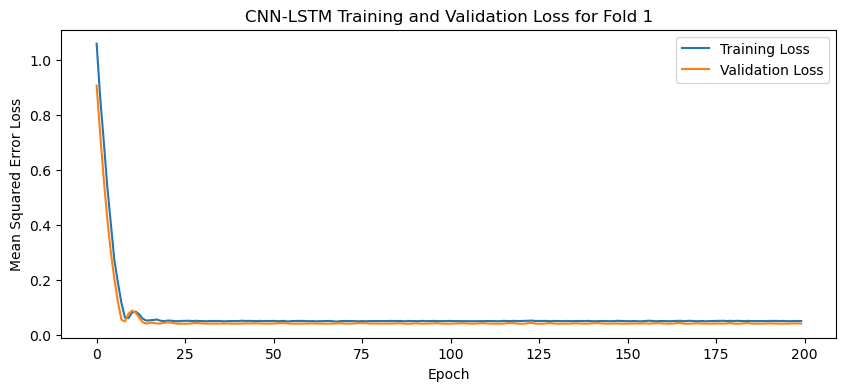

84
84
1


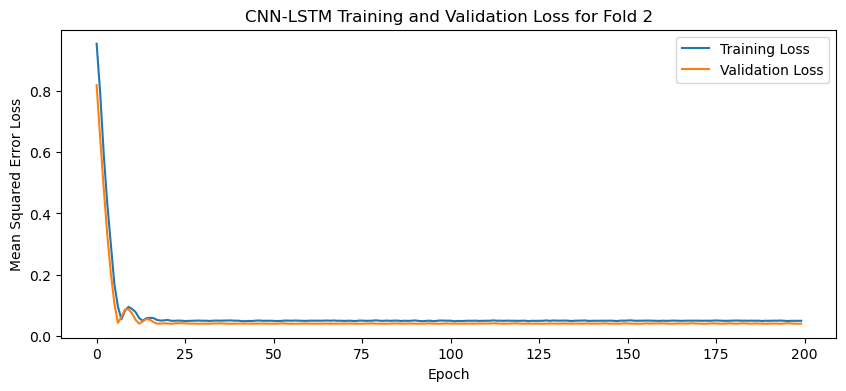

84
84
1


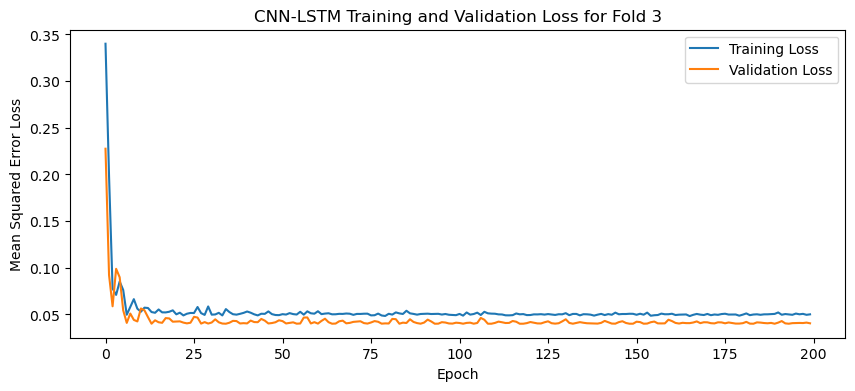

84
84
1


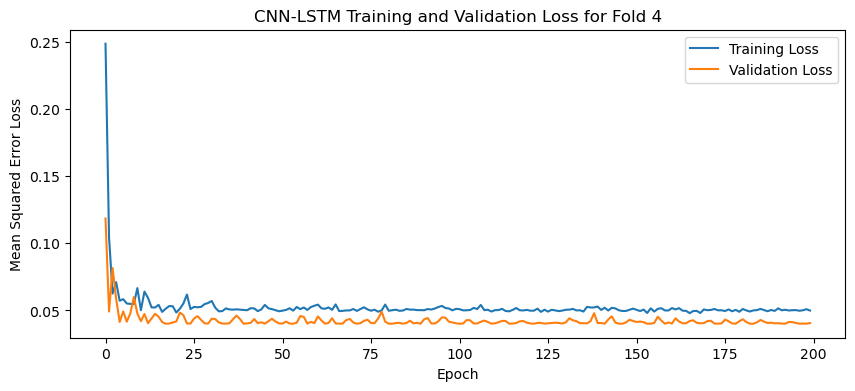

[I 2025-05-06 14:51:54,082] Trial 81 finished with value: 0.040402470529079436 and parameters: {'lr': 0.002121324802853354, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.3000921526414123}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


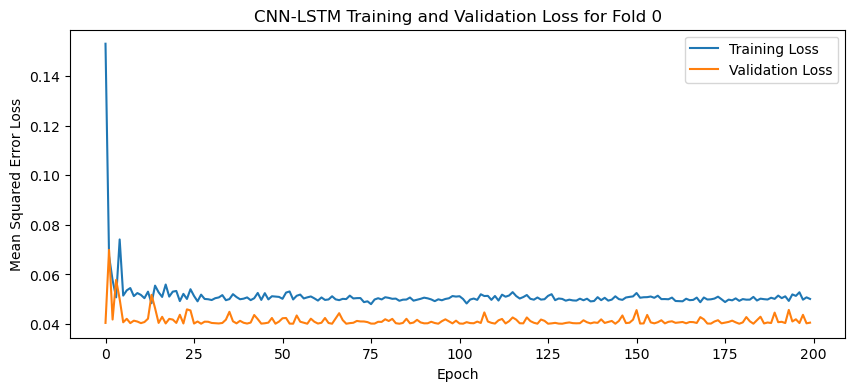

84
84
1


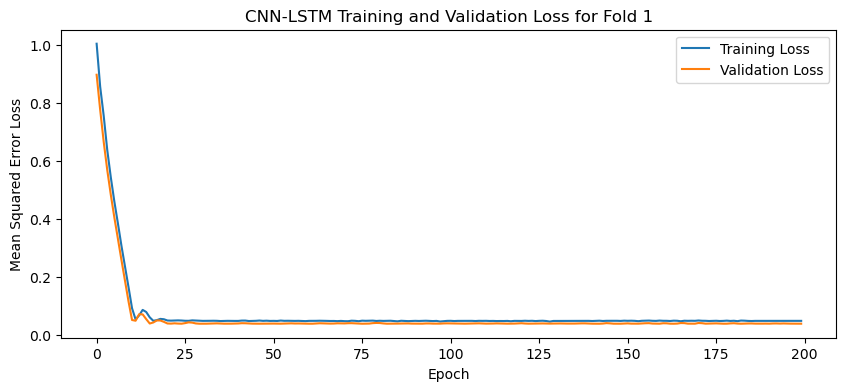

84
84
1


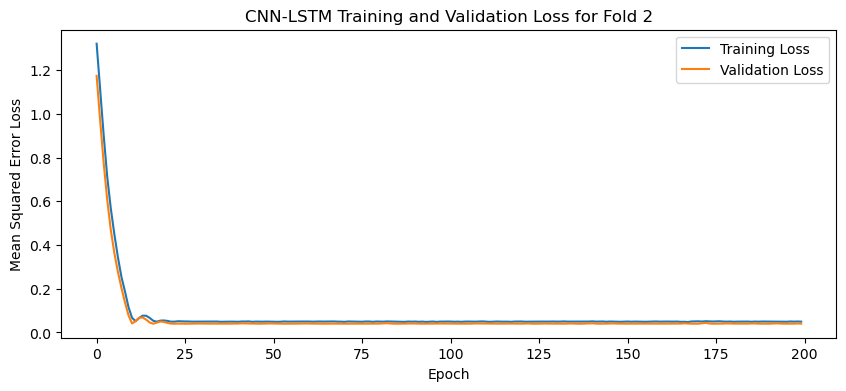

84
84
1


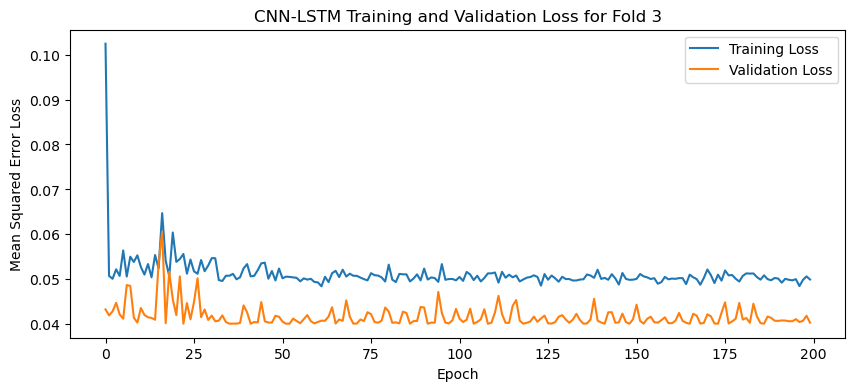

84
84
1


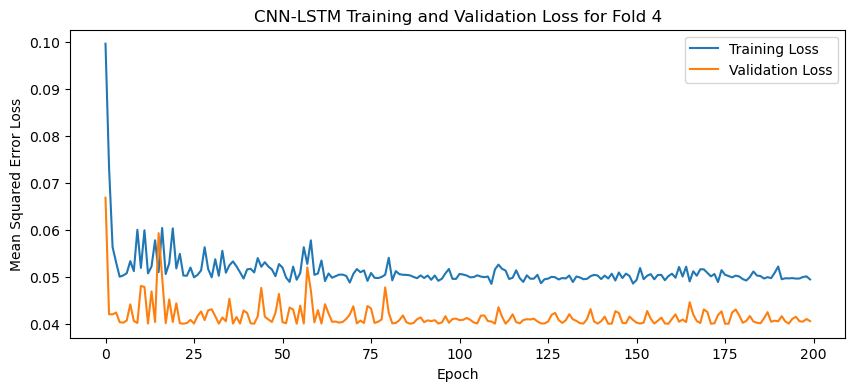

[I 2025-05-06 14:53:17,607] Trial 82 finished with value: 0.0404729887843132 and parameters: {'lr': 0.002189085153586058, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.2913742582939229}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


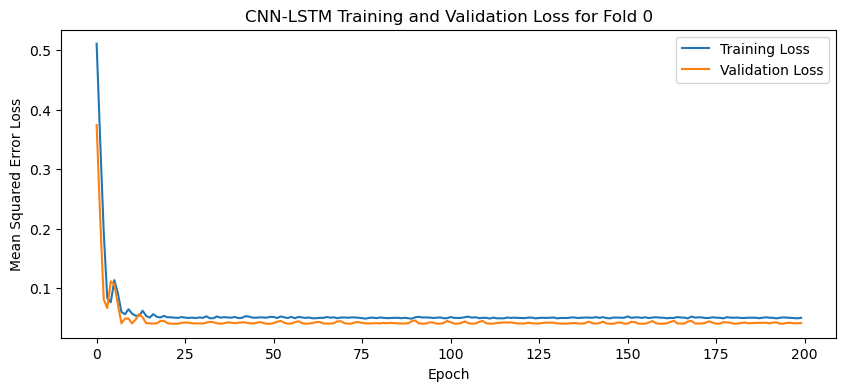

84
84
1


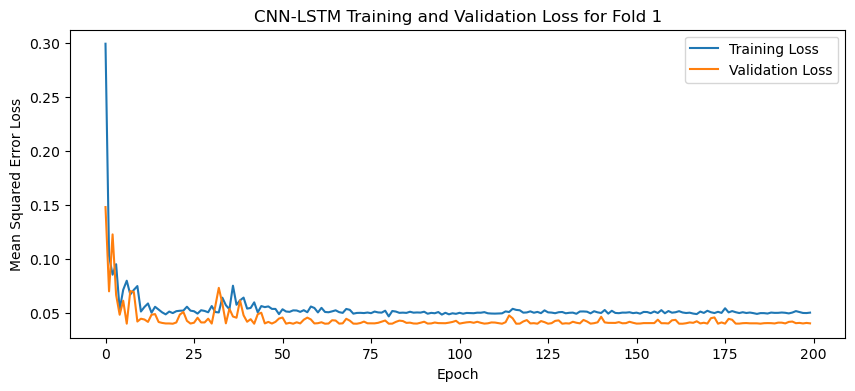

84
84
1


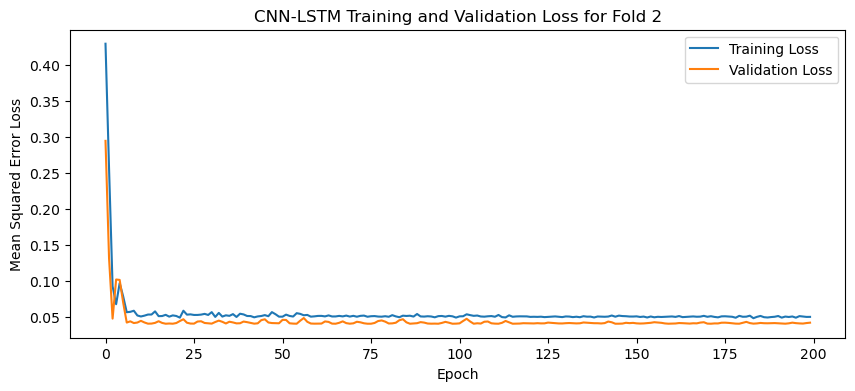

84
84
1


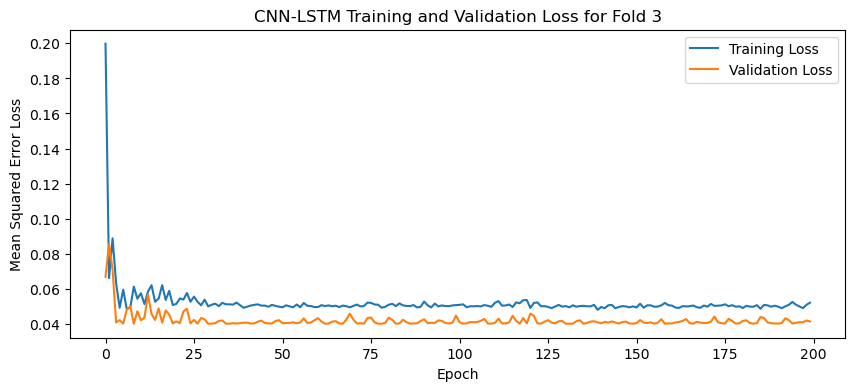

84
84
1


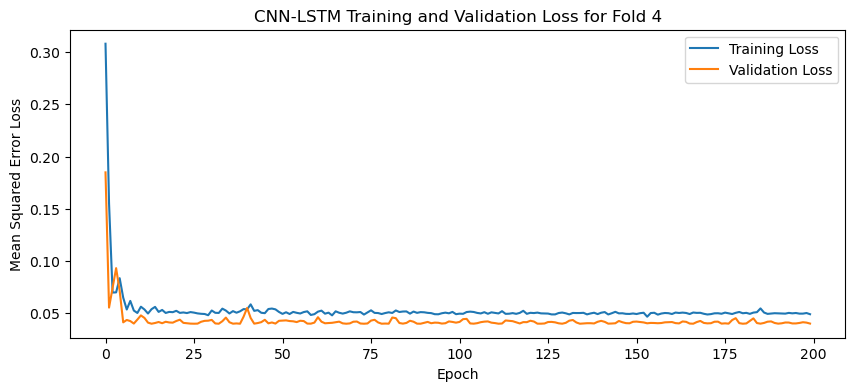

[I 2025-05-06 14:54:38,731] Trial 83 finished with value: 0.04096504524350166 and parameters: {'lr': 0.0022135346140192327, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.29943008643993935}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


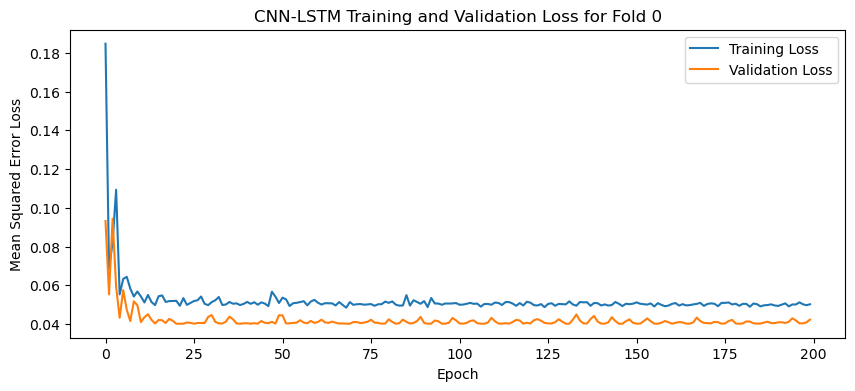

84
84
1


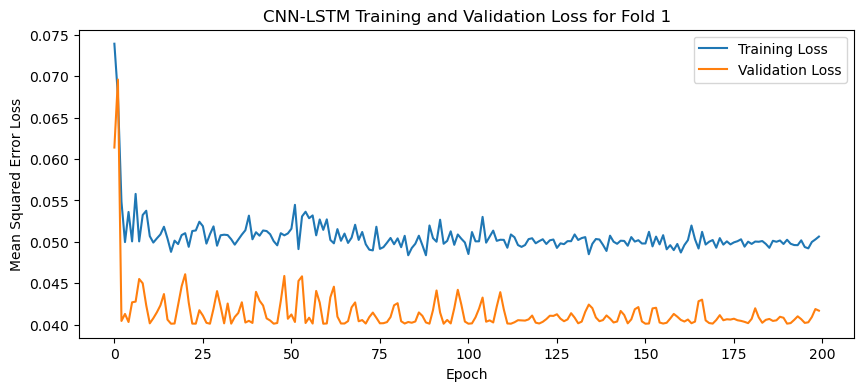

84
84
1


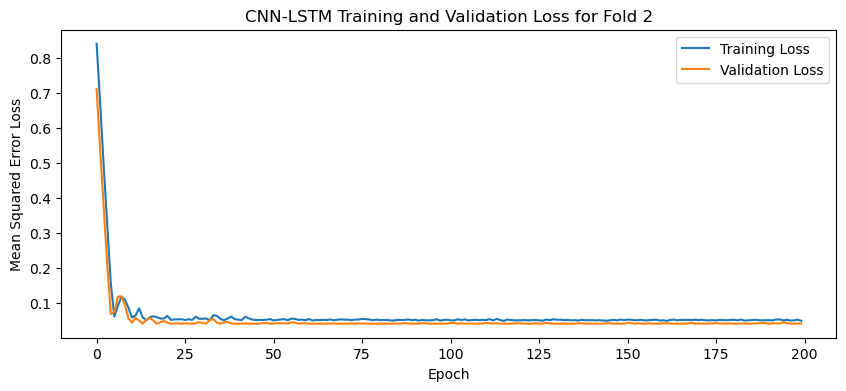

84
84
1


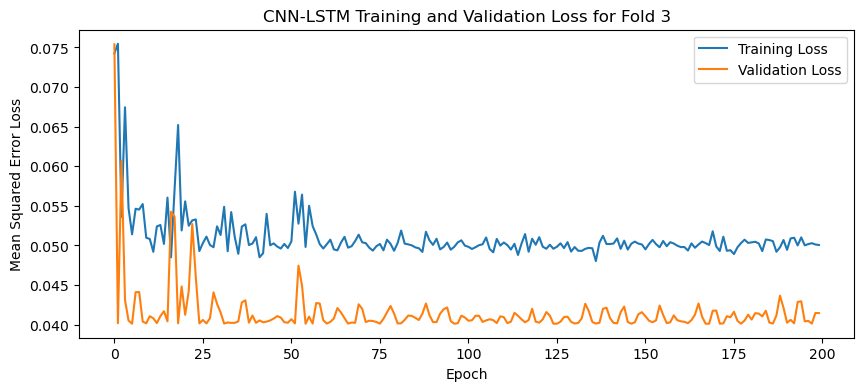

84
84
1


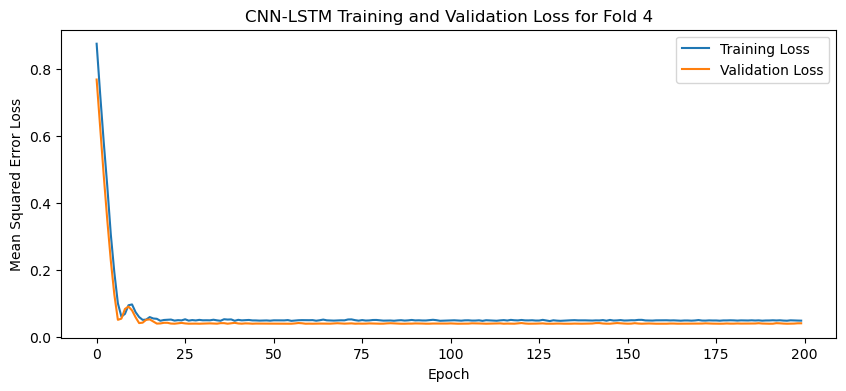

[I 2025-05-06 14:56:01,272] Trial 84 finished with value: 0.041487733274698256 and parameters: {'lr': 0.0017114654766958997, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.3185956173589849}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


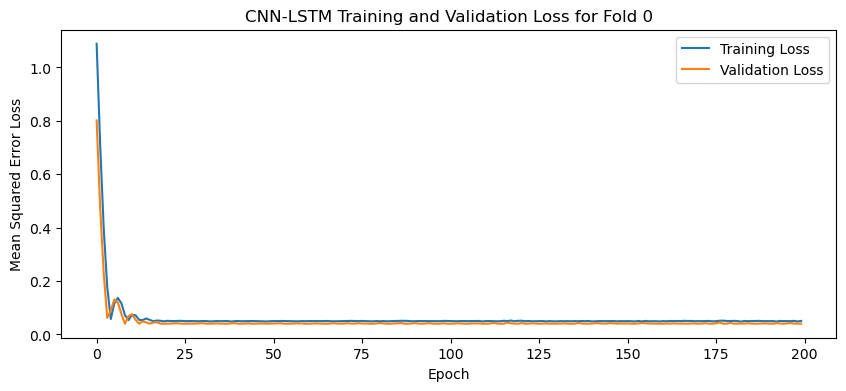

84
84
1


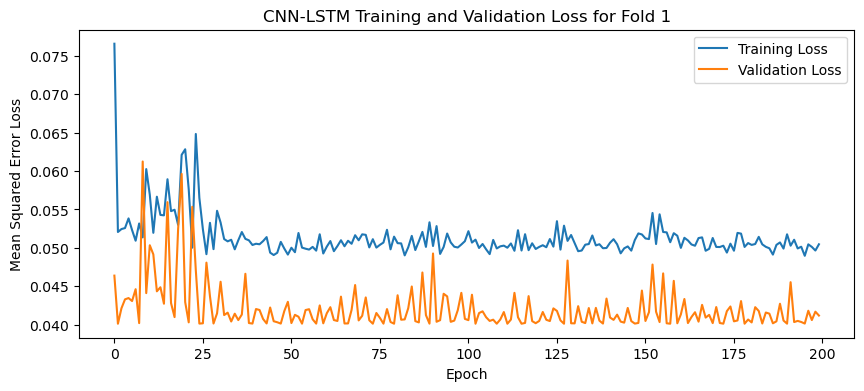

84
84
1


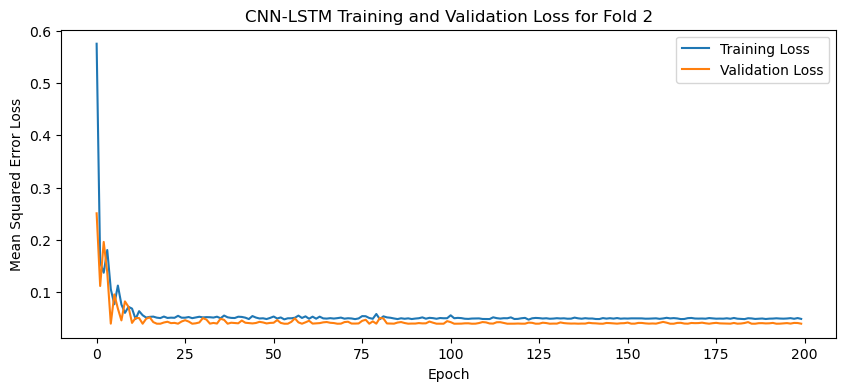

84
84
1


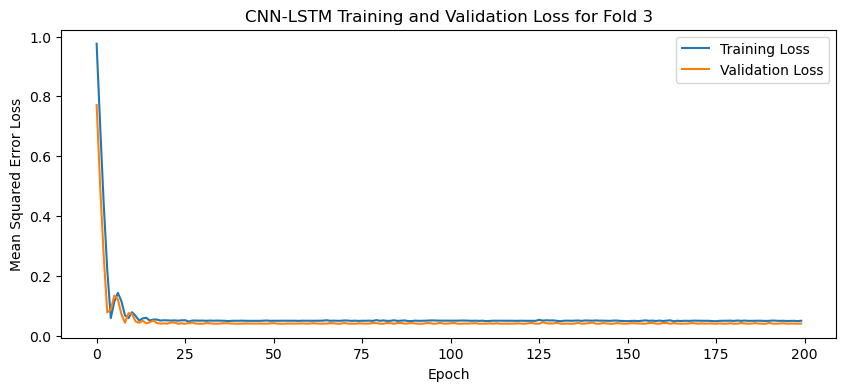

84
84
1


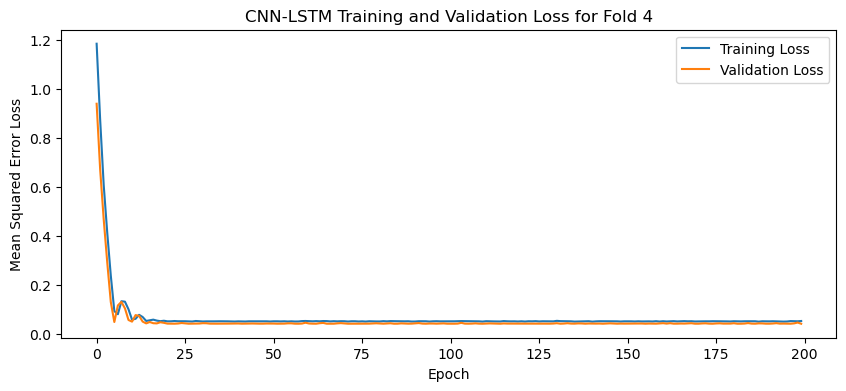

[I 2025-05-06 14:57:25,768] Trial 85 finished with value: 0.040558856725692746 and parameters: {'lr': 0.004449476059558998, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.26717611792289286}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


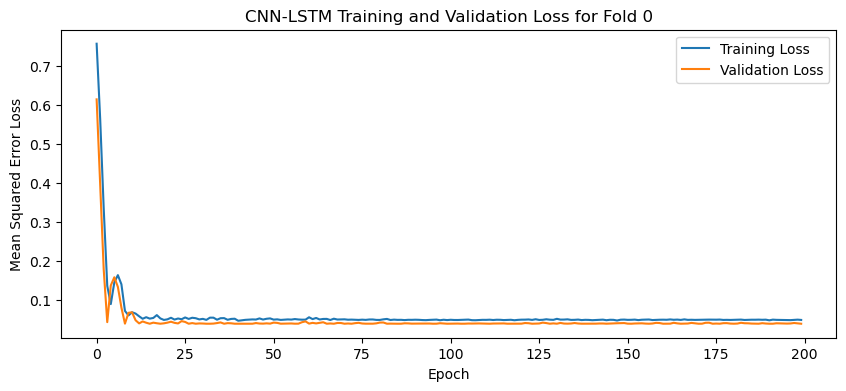

84
84
1


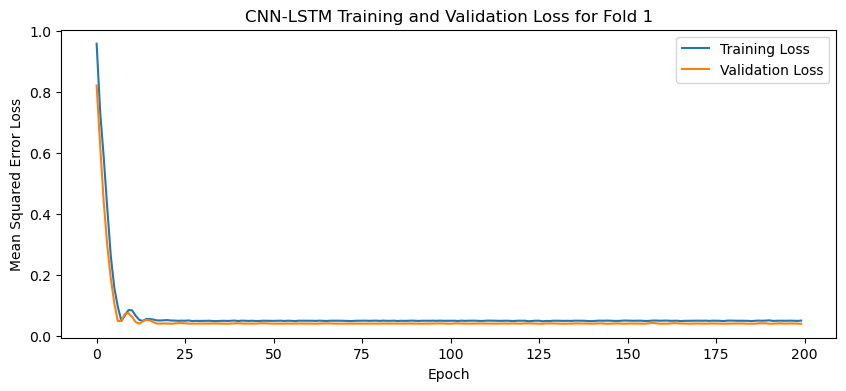

84
84
1


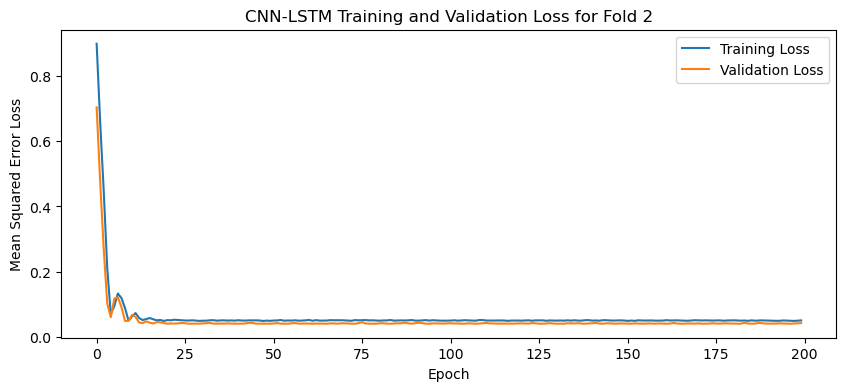

84
84
1


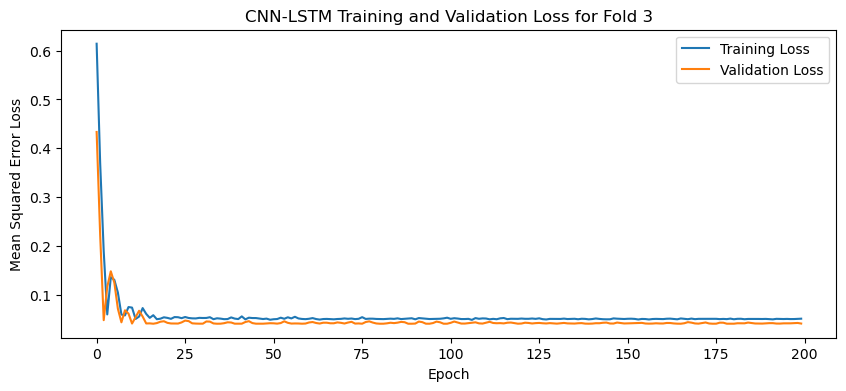

84
84
1


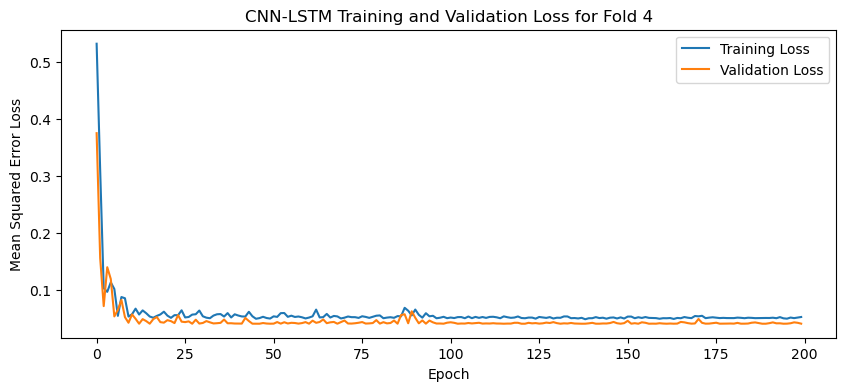

[I 2025-05-06 14:58:50,130] Trial 86 finished with value: 0.04062834680080414 and parameters: {'lr': 0.0025710221236202513, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 128, 'dropout_rate': 0.2880287669720816}. Best is trial 27 with value: 0.04027204588055611.


84
84
1


In [ ]:
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1e-1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    #filters = trial.suggest_categorical('filters', [64, 128, 256]) #Used for CNN-LSTM model later
    lstm_units = trial.suggest_categorical('lstm_units', [64, 128, 256])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    #model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(16, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(8, activation=activation_function))
    model.add(Dense(1))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model
    
def objective(trial):
    
    accuracies = []
        
    n_batch = 1
    nb_epoch = 100
    
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-1], train1[:, -1:]
        X_test, y_test = test1[:, 0:-1], test1[:, -1:]
        X_val, y_val = validation1[:, 0:-1], validation1[:, -1:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=200, verbose=0)

        accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        # fit network
        #for i in range(nb_epoch):
        #    history = model.fit(X_train, y_train, epochs=i, batch_size=n_batch, validation_data=(X_test, y_test), verbose=False, shuffle=False)
        #    model.reset_states()
        
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        plt.figure(figsize=(10, 4))
        plt.plot(history.history['loss'], label='Training Loss')
        plt.plot(history.history['val_loss'], label='Validation Loss')
        title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        plt.title(title1)
        plt.xlabel('Epoch')
        plt.ylabel('Mean Squared Error Loss')
        plt.legend()
        plt.show()
            
        accuracies.append(accuracy)
    
        #history = model.fit(X_train, y_train, epochs=100, batch_size=1, validation_data=(X_test, y_test), verbose=False, shuffle=False)
        #score = cross_val_score(model, X_train, y_train, cv=5, scoring=mean_quared_error)
        #return score
        
    return np.mean(accuracies)

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

In [ ]:
optuna.visualization.plot_optimization_history(study)
    
optuna.visualization.plot_parallel_coordinate(study)
    
optuna.visualization.plot_slice(study, params=['lr', 'optimizer', 'activation_function', 'lstm_units', 'dropout_rate'])
    
optuna.visualization.plot_param_importances(study)

best_params = study.best_params
print("Best hyperparameters: ", best_params)
best_model = create_model(optuna.trial.FixedTrial(best_params), y, n_lag, n_seq, n_batch, nb_epoch)
best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

# Plotting the training and validation loss
plt.figure(figsize=(10, 4))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
title1 = "LSTM Training and Validation Loss for Best Model"
plt.title(title1)
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error Loss')
plt.legend()
plt.show()

In [ ]:
# make one forecast with an LSTM,
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_batch):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, len(X))
    # make forecast
    forecast = model.predict(X, batch_size=n_batch)
    # convert to array
    return [x for x in forecast[0, :]]
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, n_batch, train, test, n_lag, n_seq):
    forecasts = list()
    for i in range(len(test)):
        X, y = test[i, 0:n_lag], test[i, n_lag:]
        # make forecast
        forecast = forecast_lstm(model, X, n_batch)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = array(forecasts[i])
        forecast = forecast.reshape(1, len(forecast))
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        print('t+%d RMSE: %f' % ((i+1), rmse))
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
# Predicting
y_pred = best_model.predict(X_test)
y_pred_rescaled = scaler.inverse_transform(y_pred)
y_test_rescaled = scaler.inverse_transform(y_test.reshape(-1, 1))
    
# Evaluating the model
mae = mean_absolute_error(y_test_rescaled, y_pred_rescaled)
mse = mean_squared_error(y_test_rescaled, y_pred_rescaled)
rmse = np.sqrt(mse)
r2 = r2_score(y_test_rescaled, y_pred_rescaled)
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Root Mean Squared Error (RMSE): {rmse:.4f}')
print(f'R-squared Score (R2): {r2:.4f}')

In [ ]:
# Plotting the learning curves
history = best_model.fit(X_train, y_train, epochs=100, batch_size=32,
validation_data=(X_test, y_test))
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train')
plt.plot(history.history['val_loss'], label='Test')
plt.title('LSTM Training and Validation Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()
    
# Extract the dates corresponding to the test set predictions
test_dates = df.index[-len(y_test_rescaled):]
    
# Create a DataFrame for plotting
results_df = pd.DataFrame({
'Date': test_dates,
'Actual': y_test_rescaled.flatten(),
'Predicted': y_pred_rescaled.flatten()
})
    
# Plotting the results
plt.figure(figsize=(15, 6))
plt.plot(results_df['Date'], results_df['Actual'], label='Actual Temp')
plt.plot(results_df['Date'], results_df['Predicted'], label='Predicted Temp', alpha=0.7)
plt.title('LSTM Model Comparison Temperature Prediction')
    
plt.xlabel('Date')
plt.ylabel('Temperature')
plt.legend()
plt.show()

In [ ]:
from tensorflow.keras.utils import plot_model
    
# Define the create_model function with the optimal parameters
best_model = create_model(optuna.trial.FixedTrial(best_params))
# Plot model architecture
plot_model(best_model, to_file='lstm_model_optimized.png', show_shapes=True, show_layer_names=True)
    
# make forecasts
forecasts = make_forecasts(model, n_batch, train, test, n_lag, n_seq)
# inverse transform forecasts and test
forecasts = inverse_transform(series, forecasts, scaler, n_test+2)
actual = [row[n_lag:] for row in test]
actual = inverse_transform(series, actual, scaler, n_test+2)
# evaluate forecasts
evaluate_forecasts(actual, forecasts, n_lag, n_seq)
# plot forecasts
plot_forecasts(series, forecasts, n_test+2)
model.summary()
    
print(forecasts)
    
print(model)